<a href="https://colab.research.google.com/github/Cyanjiner/CAPS/blob/main/academic_lang_transcript_EDA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Load Packages

In [ ]:
 # Colab workspace
from google.colab import drive
drive.mount('/content/drive')
import glob, re, os, copy
import pandas as pd
import numpy as np
!pip install num2words
!pip install textacy
!pip install pyreadr

## utilities
import sys, os, datetime, re, itertools, glob, gzip, tarfile, json, pickle, unicodedata, requests, urllib, string, math, shutil, html, warnings, logging, time, gc
import tqdm, sqlite3
from tqdm.auto import tqdm
import seaborn as sns
import pyreadr
import functools
import html.parser
import re
import sys
import unicodedata
from typing import Any, Dict, Pattern
import matplotlib.pyplot as plt
import statsmodels.api as sm
import statsmodels.formula.api as smf
import scipy.stats
from sklearn.preprocessing import MinMaxScaler
## Text structures
import textblob
import nltk
import spacy
spacy.prefer_gpu()
import textacy
import textacy.text_stats
import textacy.preprocessing
from typing import Literal
from bs4 import BeautifulSoup
from num2words import num2words
root_dir = "/content/drive/My Drive/transcript_analysis/"
data_dir = "data/engageNY/"
ROOT_FOLDER = "/content/drive/My Drive/transcript_analysis/"
DATA_FOLDER = ROOT_FOLDER + "data/"
ENY_FOLDER = "engageNY/"
RAW_FOLDER = DATA_FOLDER + "raw/"
CLEAN_FOLDER = DATA_FOLDER + "clean/"
R_FOLDER = DATA_FOLDER + "R/"

Mounted at /content/drive
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 125.2/125.2 kB 3.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for docopt: filename=docopt-0.6.2-py2.py3-none-any.whl size=13707 sha256=adfc99a0692930a1a047b785a518310f09305fa9ac41f377bb14e44432d1e0ab
  Stored in directory: /root/.cache/pip/wheels/fc/ab/d4/5da2067ac95b36618c629a5f93f809425700506f72c9732fac
Successfully built docopt
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 210.7/210.7 kB 5.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 34.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 314.7/314.7 kB 24.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 45.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2

# TODO
Check two things: 1) number of different students (a, B, C, etc.)
Check to see if we can identify the number of s in each class

Corpus expansion w Khan Academy Transcripts: scrape of all lesson transcripts

Check to see if rater times are consistent within Rubric chapter nums and (if they exist) across MQI and CLASS

Try removing trailing periods before looking for decimals etc.





Models to prepare:
1. Basic Gensim
2. BLEU comparison on ngrams
3. ROUGE comparison n-grams
4. Sentence-BERT w cosine similarity
5. USE w inner product bw corpora
6. Use mean of embeddings for JSD (Jensen Shannon Divergence) or KL divergence
    a. JSD is finite and smoothed, uses KL divergence




# Load all the data

## Load the corpora

In [ ]:
## CCSS text
ssdf = pd.read_csv(DATA_FOLDER + "ccss_text.csv")

## illustrative math
imdf = pd.read_csv(DATA_FOLDER + "IM_text.csv")

## illustrative math talk math
tdf = pd.read_csv(DATA_FOLDER + "talk_math.csv")

## CCSS glossary
gdf = pd.read_csv(DATA_FOLDER + "math_glossary.csv")

## engageNY
ldf = pd.read_csv(DATA_FOLDER + ENY_FOLDER + "full_lesson_text_extra_grades.csv")

## SFUSD math talks
sfdf = pd.read_csv(DATA_FOLDER + "SFUSD/sfusd_mathtalks.csv")

## Missing CK12


## Do we want to add the other transcripts from TalkMoves?

## Load the full Augmented transcript

In [ ]:
## transcripts
# df = pd.read_csv(DATA_FOLDER + "ncte_single_utterances.csv")
# df = pd.read_csv(DATA_FOLDER + "tscript_augment.csv")
# df = pd.read_pickle(DATA_FOLDER + "augmented_transcript.pkl")
# df = pd.read_pickle(DATA_FOLDER + "augmented_transcript_sents.pkl")

df = pd.read_pickle(DATA_FOLDER + "augmented_transcript_sents2.pkl")
v = pd.read_pickle(DATA_FOLDER + "obs_ratings_vam.pkl")

In [ ]:
# df.to_pickle(DATA_FOLDER + 'augmented_transcript_sents2.pkl')

In [ ]:
df.columns.tolist()

['speaker',
 'text',
 'year',
 'OBSID',
 'video_id',
 'cleaned_text',
 'num_words',
 'turn_idx',
 'comb_idx',
 't',
 'cum_words',
 't_words',
 's_words',
 't_cum_words',
 's_cum_words',
 'tt_cum_ratio',
 'st_cum_ratio',
 'talk_cum_pct',
 't_words_rolling',
 's_words_rolling',
 't_25_rolling',
 's_25_rolling',
 't_40_rolling',
 's_40_rolling',
 'all_40_rolling',
 'ts_cum_ratio',
 'NCTETID',
 'id_year',
 'scoreSTA',
 'scoreALT',
 'scoreSESTA',
 'scoreSEALT',
 'avgscoreSTA',
 'avgscoreALT',
 'avgscoreSESTA',
 'avgscoreSEALT',
 'has_timestamp',
 'timestamp',
 'has_work_comment',
 'ind_practice',
 'group_work',
 'adj_num_words',
 'adj_cum_words',
 'w_words',
 'w_cum_words',
 'w_words_rolling',
 'w_25_rolling',
 'w_40_rolling',
 'model_grade',
 'model_domain',
 'level_0_x',
 'level_0_y',
 'CLPC',
 'CLNC',
 'CLTS',
 'CLRSP',
 'CLBM',
 'CLPRDT',
 'CLILF',
 'CLCU',
 'CLAPS',
 'CLQF',
 'CLINSTD',
 'CLSTENG',
 'SEGMENT',
 'FORMAT_ACTIVE',
 'FORMAT_BOTH',
 'FORMAT_SMALLGRP',
 'DIRINST',
 'APLPROB'

# Quick Data Prep

In [ ]:
max_seq_len = 64
min_periods = 32
batch_size = 1024

y_cols = [ 'ORICHC', 'LINK',  'EXPL', 'MMETH','MLANG',
 'MGEN', 'ETCA',
 'OERRC',  'MAJERR', 'LANGIMP', 'LCP',
 ]

y_cols = ['ORICHC', 'MLANG',]

# y_cols = ['MAJERR', 'LANGIMP', 'LCP','OERRC']

y_cols = ['CLPC', 'CLNC',
       'CLTS', 'CLRSP', 'CLBM', 'CLPRDT', 'CLILF', 'CLCU', 'CLAPS', 'CLQF',
       'CLINSTD', 'CLSTENG',
       'FORMAT_ACTIVE', 'FORMAT_BOTH', 'FORMAT_SMALLGRP', 'DIRINST', 'APLPROB',
       'CWCM', 'WCDISS']

def roll_data(df, cols, window=max_seq_len, min_periods = min_periods, step = 9, closed ='both',center = True, func = np.nanmean):
  '''
  Function assumes data is already grouped
  '''
  if cols is None: rolling = df[cols].rolling(window=window,min_periods = min_periods, closed =closed,center = center)
  else: rolling = df[cols].rolling(window=window,min_periods = min_periods, closed =closed,center = center)
  # rolling = rolling[::step]
  indices = []
  for win in rolling:
    indices.append(win.index.tolist())
  rolling = rolling.apply(func)
  rolling['indices'] = indices
  return  rolling

## Make a transcript df
tdf = []
for ob in tqdm(df.OBSID.unique(),total=len(df.OBSID.unique())):
  tdf.append(roll_data(df[(df.OBSID == ob)],cols = y_cols + ['OBSID']))
tdf = pd.concat(tdf)
tdf.to_pickle(DATA_FOLDER + "indexed_Mar23_tdf_for_processing.pkl")

  0%|          | 0/1658 [00:00<?, ?it/s]

In [ ]:
tdf = pd.read_pickle(DATA_FOLDER + "indexed_Mar23_tdf_for_processing.pkl")
tdf.shape


(1412729, 21)

In [ ]:
tdf.columns.tolist()

['CLPC',
 'CLNC',
 'CLTS',
 'CLRSP',
 'CLBM',
 'CLPRDT',
 'CLILF',
 'CLCU',
 'CLAPS',
 'CLQF',
 'CLINSTD',
 'CLSTENG',
 'FORMAT_ACTIVE',
 'FORMAT_BOTH',
 'FORMAT_SMALLGRP',
 'DIRINST',
 'APLPROB',
 'CWCM',
 'WCDISS',
 'OBSID',
 'indices']

In [ ]:
tdf[['CLPC',
 'CLNC',
 'CLTS',
 'CLRSP',
 'CLBM',
 'CLPRDT',
 'CLILF',
 'CLCU',
 'CLAPS',
 'CLQF',
 'CLINSTD',
 'CLSTENG','OBSID',]].dropna().shape

(1313601, 13)

In [ ]:
df.groupby(['OBSID','CHAPNUM']).size().mean()

112.38000159096333

In [ ]:
df[df.num_words < 3].shape

(423768, 137)

In [ ]:
df.shape

(1412729, 137)

## Check on new df

In [ ]:
df = pd.read_csv(ROOT_FOLDER + "Copy of ncte_single_utterances.csv")

### Reconstruction Files

In [ ]:
vadf = pd.read_csv(DATA_FOLDER + "va_year.csv")
obs = pd.read_csv(DATA_FOLDER + "obs_times.csv")
# df = df.drop(columns = "Unnamed: 0")
# df = df[~df.OBSID.isin([4263,2065])]
vadf = pd.read_csv(DATA_FOLDER + "va_year.csv")
vadf['year'] = vadf.year.fillna(0)


classdf = pyreadr.read_r(R_FOLDER + "36095-0001-Data.rda")
classdf = classdf[list(classdf.keys())[0]]
classdf.NCTETID = classdf.NCTETID.astype(int)
classdf.OBSID = classdf.OBSID.astype(int)
classdf.SCHOOLYEAR_SP = classdf.SCHOOLYEAR_SP.astype(int)
classdf['id_year'] = classdf.NCTETID.apply(str) + "_" + classdf.SCHOOLYEAR_SP.apply(lambda x: str(int(x-2000)))
c1 = copy.deepcopy(classdf)
c2 = copy.deepcopy(classdf)
c1.CHAPNUM = (c1.CHAPNUM) * 2
c2.CHAPNUM = (c2.CHAPNUM-1) * 2 + 1
classdf = pd.concat([c1,c2])
obs_years = classdf.id_year.unique()

mqi = pyreadr.read_r(R_FOLDER + "36095-0002-Data.rda")
mqi = mqi[list(mqi.keys())[0]]
mqi.loc[(mqi.OBSID == 22) & (mqi.CHAPNUM == 13),'CHAPNUM'] = 9
mqi.NCTETID = mqi.NCTETID.astype(int)
mqi.OBSID = mqi.OBSID.astype(int)
mqi.SCHOOLYEAR_SP = mqi.SCHOOLYEAR_SP.astype(int)
mqi['id_year'] = mqi.NCTETID.apply(str) + "_" + mqi.SCHOOLYEAR_SP.apply(lambda x: str(int(x-2000)))
mqi

## Value added w the CLASS rubric
v = pd.merge(vadf,classdf,on='id_year',how="outer")
v = v.drop(columns = ["NCTETID_y"]).rename(columns = {"NCTETID_x":"NCTETID"})
v = pd.merge(v.drop(columns=['OBSYEAR', 'OBSMONTH', 'OBSDAY', 'CLASS_11', 'CLASS_12', 'CLASS_13','DISTRICT',]),
         mqi.drop(columns=['OBSYEAR', 'OBSMONTH', 'OBSDAY','MQI_11', 'MQI_12', 'MQI_13',]),
         how='outer',
         on=['NCTETID', 'id_year','SCHOOLYEAR_SP','OBSID','CHAPNUM'],
         suffixes=['_C','_M'])


In [ ]:
df = df[~df.OBSID.isin([4263,2065])] ## Removing observation without correct teacher labels
## Put everything in the df file for ease of working
asdf = {o:n for o, n in zip(classdf.drop_duplicates("OBSID").OBSID,classdf.drop_duplicates("OBSID").NCTETID)}
df['NCTETID'] = df.OBSID.apply(lambda x: asdf[x])
asdf = {OBS:NC for OBS, NC in zip(va.OBSID,va.id_year)}
df['id_year'] = df.OBSID.apply(lambda x: asdf[x])
asdf = {OBS:NC for OBS, NC in zip(va.OBSID,va.score.STA)}
df['scoreSTA'] = df.OBSID.apply(lambda x: asdf[x])
asdf = {OBS:NC for OBS, NC in zip(va.OBSID,va.score.ALT)}
df['scoreALT'] = df.OBSID.apply(lambda x: asdf[x])
asdf = {OBS:NC for OBS, NC in zip(va.OBSID,va.scoreSE.STA)}
df['scoreSESTA'] = df.OBSID.apply(lambda x: asdf[x])
asdf = {OBS:NC for OBS, NC in zip(va.OBSID,va.scoreSE.ALT)}
df['scoreSEALT'] = df.OBSID.apply(lambda x: asdf[x])

asdf = {OBS:NC for OBS, NC in zip(vadf[vadf.id_year.apply(lambda x: "_avg" in x)].NCTETID,vadf[(vadf.id_year.apply(lambda x: "_avg" in x)) & (vadf.va_type == 'STA')].score)}
df['avgscoreSTA'] = df.NCTETID.apply(lambda x: asdf[x] if x in asdf.keys() else np.nan)
asdf = {OBS:NC for OBS, NC in zip(vadf[vadf.id_year.apply(lambda x: "_avg" in x)].NCTETID,vadf[(vadf.id_year.apply(lambda x: "_avg" in x)) & (vadf.va_type == 'ALT')].score)}
df['avgscoreALT'] = df.NCTETID.apply(lambda x: asdf[x] if x in asdf.keys() else np.nan)
asdf = {OBS:NC for OBS, NC in zip(vadf[vadf.id_year.apply(lambda x: "_avg" in x)].NCTETID,vadf[(vadf.id_year.apply(lambda x: "_avg" in x)) & (vadf.va_type == 'STA')]['score.SE'])}
df['avgscoreSESTA'] = df.NCTETID.apply(lambda x: asdf[x] if x in asdf.keys() else np.nan)
asdf = {OBS:NC for OBS, NC in zip(vadf[vadf.id_year.apply(lambda x: "_avg" in x)].NCTETID,vadf[(vadf.id_year.apply(lambda x: "_avg" in x)) & (vadf.va_type == 'ALT')]['score.SE'])}
df['avgscoreSEALT'] = df.NCTETID.apply(lambda x: asdf[x] if x in asdf.keys() else np.nan)

In [ ]:
# df.columns.tolist()

# v.to_pickle(DATA_FOLDER + "obs_ratings_vam.pkl")

88298

### Quick save

In [ ]:

###
###
'''
https://medium.com/geekculture/let-us-extract-some-topics-from-text-data-part-ii-gibbs-sampling-dirichlet-multinomial-mixture-9e82d51b0fab
https://github.com/bicachu/short-text-topic-modeling-tutorial/blob/main/sttm_notebook.ipynb
https://www.kaggle.com/code/ptfrwrd/topic-modeling-guide-gsdm-lda-lsi
https://towardsdatascience.com/a-unique-approach-to-short-text-clustering-part-1-algorithmic-theory-4d4fad0882e1
'''



## EDA for Transcripts

In [ ]:
df['t'] = df.speaker.apply(lambda x: 1 if x == "teacher" else 0)
df.loc[201076,"speaker"] = "teacher" ## Correcting speaker label
df.loc[64366,"speaker"] = "teacher" ## correcting speaker label


In [ ]:
len(df[df.OBSID.isin([4263,2065])])

0

In [ ]:
print("\n".join(list(df[df.OBSID.isin([4263,2065])].speaker.apply(str) + ": " + df[df.OBSID.isin([4263,2065])].text)))

multiple students: No. Remember the data that I’m collecting today is actual useful data.  And you’ll know why in just a minute.  So, I want your honest answer, and you can only vote -
multiple students: Once. everyone get a sticky note?  Go ahead and write your name.
student: Thank You. collect and organize some data.  Right?  And how are we doing that?  By taking a -
multiple students: Survey [writing on chalkboard] we’re going to determine the median -
multiple students: The mode.
multiple students: And the range. very favorite nights at Harbins is coming up very soon. Anybody want to take a guess at what you think my very favorite night at Harbins is?
student: Relay for Life? spring.  Good guess.  Student L?
student: Movie Under the Stars? work it.  I don’t have to.  I want to.  So, I bring M with me.  And we come.  And we watch the movie.  Have popcorn. Have drinks.  Play on the playground.  We do all that fun stuff. In order to decide which movie they play, they actually ask you 

# Pipeline from Augmented to Sentence Parsed




## Estimate Markers for Unspoken Time

In [ ]:
import nltk
from nltk.tokenize.punkt import PunktSentenceTokenizer
sent_tokenizer = lambda s: PunktSentenceTokenizer().tokenize(s)

In [ ]:
df['text'] = df.text.apply(lambda x: sent_tokenizer (x))
df = df.explode('text')
df.shape

(1412729, 125)

In [ ]:
df.num_words = df.text.str.split().apply(len)

In [ ]:
df["cum_words"]=df.groupby(by= "OBSID").num_words.cumsum()
df['t_words'] = df.t * df.num_words
df['s_words'] = abs(df.t -1) * df.num_words
df["t_cum_words"]=df.groupby(by= "OBSID").t_words.cumsum()
df["s_cum_words"]=df.groupby(by= "OBSID").s_words.cumsum()
df['tt_cum_ratio'] = df["t_cum_words"]/df.cum_words
df['st_cum_ratio'] = df["s_cum_words"]/df.cum_words
df['talk_cum_pct'] = df.groupby(by="OBSID", sort = False).apply(lambda x: x.cum_words/x.num_words.sum()).values
df["t_words_rolling"] = df.groupby(by="OBSID",sort=False).t_words.rolling(7).mean().values
df["s_words_rolling"] = df.groupby(by="OBSID",sort=False).s_words.rolling(7).mean().values
df["t_25_rolling"] = df.groupby(by="OBSID",sort=False).t_words.rolling(25).mean().values
df["s_25_rolling"] = df.groupby(by="OBSID",sort=False).s_words.rolling(25).mean().values
df["t_40_rolling"] = df.groupby(by="OBSID",sort=False).t_words.rolling(40).mean().values
df["s_40_rolling"] = df.groupby(by="OBSID",sort=False).s_words.rolling(40).mean().values
df["all_40_rolling"] = df.groupby(by="OBSID",sort=False).num_words.rolling(40).mean().values
df["ts_cum_ratio"] = df["s_cum_words"] / df["t_cum_words"]
df

,speaker,text,year,OBSID,video_id,cleaned_text,num_words,turn_idx,comb_idx,t,...,TASKDEVMAT,ERRANN,WORLD,math_words,log_math_words,pct_math_words,s_pct_math_words,t_pct_math_words,s_math,t_math
0,teacher,"Friends, yesterday we started off by working o...",2,2119,706,friends yesterday we started off by working on...,13,0,2119_0,1,...,NaN,NaN,NaN,1,0.693147,0.076923,NaN,0.076923,0,1
1,student,Yes.,2,2119,706,yes,1,1,2119_1,0,...,NaN,NaN,NaN,0,0.000000,0.000000,0.0,NaN,0,0
2,teacher,"And yesterday towards the end of the period, y...",2,2119,706,and yesterday towards the end of the period yo...,38,2,2119_2,1,...,NaN,NaN,NaN,1,0.693147,0.026316,NaN,0.026316,0,1
3,multiple students,Yes.,2,2119,706,yes,1,3,2119_3,0,...,NaN,NaN,NaN,0,0.000000,0.000000,0.0,NaN,0,0
4,teacher,Some of you might be done.,2,2119,706,some of you might be done if you are finished ...,6,4,2119_4,1,...,NaN,NaN,NaN,0,0.000000,0.000000,NaN,0.000000,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
579974,teacher,Okay so let’s start over who wants to go first?,1,315,445,can you hit the mouse so we can see you should...,10,515,315_515,1,...,NaN,NaN,NaN,0,0.000000,0.000000,NaN,0.000000,0,0
579975,student,I’ll go first.,1,315,445,i ll go first,3,516,315_516,0,...,NaN,NaN,NaN,0,0.000000,0.000000,0.0,NaN,0,0
579976,teacher,What do you want to ask her if she has?,1,315,445,what do you want to ask her if she has,10,517,315_517,1,...,NaN,NaN,NaN,0,0.000000,0.000000,NaN,0.000000,0,0
579977,student,"If she has 5, 1.",1,315,445,if she has 5 1,5,518,315_518,0,...,NaN,NaN,NaN,0,0.000000,0.000000,0.0,NaN,0,0


### Old way (do not use, kept for original chart creation)

In [ ]:
wpm = pd.DataFrame(pd.DataFrame(df.groupby(by=['OBSID']).num_words.sum())['num_words'] / (pd.DataFrame(v.groupby(by=["OBSID"]).CHAPNUM.max())['CHAPNUM'] * 7.5))

## Find transcription comments about worktime
work_pat = re.compile("\[([^\]]*?[Ww]ork.*?|[^\]]*?[Ii]ndep.*?|[^\]]*?[Ii]ndivi.*?|[^\]]*?[Qq]uiz.*?|[^\]]*?[Cc]heck.*?|[^\]]*?[Gg]ame.*?|[^\]]*?[Pp]air.*?|[^\]]*?[Ss]ribbl.*?|[^\]]*?[Ww]alk.*?|[^\]]*?[Gg]roups.*?|[^\]]*?[Qq]uiet.*?|[^\]]*?[Ss]ilent.*?|[^\]]*?[Dd]iscus.*?)\]")  #[^\]]*?[Pp]roblem.*?
## Find teacher comments about worktime
work_t = re.compile("[Ww]ork.* on|[Dd]o[i ].* you|[Ww]ork.* wi|[Ii]ndepende|on your own|\[[^\]]*?[Ss]ilenc.*?")
# ['conversations','Crosstalk','student? but not Student X','yell','discuss','walk','noise','scribbling','whispering','chatter','side comment','pair','play..game| cards','students checking answers','quiz']
possible_langs = ['[Ff]rench','[Ss]panish','[Ff]oreign','[Pp]ortuguese','[Cc]reole','[Cc]hinese']
inaudible_pat = re.compile(f"\[([^\]]*?[Ii]ndiscern|[Uu]nintellig|[Ii]naudi|[Cc]ross[ -]?talk|{'|'.join(possible_langs)}.*?)\]")

df['has_work_comment'] = 0
df['adj_num_words'] = df.num_words
df['w_words'] = 0

for i, row in tqdm(df.iterrows(), total = len(df)):
  workm = len(work_pat.findall(row.text))
  workt = len(work_t.findall(row.text))
  inaudible = len(inaudible_pat.findall(row.text))
  words_per_min = wpm.loc[row.OBSID].values[0]
  df.loc[i,'has_work_comment'] = (workm) + (workt)
  df.loc[i,'w_words'] += ((workm) * 2 + (workt) * 0.25) * words_per_min
  df.loc[i,'adj_num_words'] += ((workm) * 2 + (workt) * 0.25 + (inaudible) * (0.09)) * words_per_min


df["adj_cum_words"]=df.groupby(by= "OBSID").adj_num_words.cumsum()
df["w_cum_words"]=df.groupby(by= "OBSID").w_words.cumsum()
df["w_words_rolling"] = df.groupby(by="OBSID",sort=False).w_words.rolling(7).mean().values
df["w_25_rolling"] = df.groupby(by="OBSID",sort=False).w_words.rolling(25).mean().values
df["w_40_rolling"] = df.groupby(by="OBSID",sort=False).w_words.rolling(40, closed = 'both').mean().values

  0%|          | 0/1412729 [00:00<?, ?it/s]

In [ ]:
df = df.reset_index(drop=True)


In [ ]:
added_words = df.adj_num_words - df.num_words

df.adj_cum_words = df.num_words + added_words

In [ ]:
gc.collect()

8624

<Axes: >

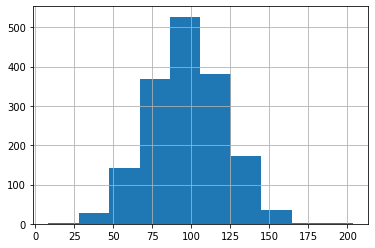

In [ ]:
wpm = pd.DataFrame(pd.DataFrame(df.groupby(by=['OBSID']).num_words.sum())['num_words'] / df.groupby(by=["OBSID"]).timestamp.max())
wpm[0].hist()

<Axes: >

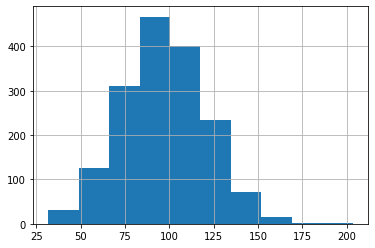

In [ ]:
wpm = pd.DataFrame(pd.DataFrame(df.groupby(by=['OBSID']).num_words.sum())['num_words'] / (pd.DataFrame(v.groupby(by=["OBSID"]).CHAPNUM.max())['CHAPNUM'] * 7.5))
wpm[0].hist()

# Updated (faster and more accurate) way

In [ ]:
wpm = pd.DataFrame(pd.DataFrame(df.groupby(by=['OBSID']).num_words.sum())['num_words'] / (pd.DataFrame(v.groupby(by=["OBSID"]).CHAPNUM.max())['CHAPNUM'] * 7.5))
wpm_dict = {}
for i, w in wpm.iterrows():
  wpm_dict[i] = w[0]

df['wpm'] = df.OBSID.apply(lambda x: wpm_dict[x])

In [ ]:
## Find transcription comments about worktime
work_pat = re.compile("\[([^\]]*?[Ww]ork.*?|[^\]]*?[Ii]ndep.*?|[^\]]*?[Ii]ndivi.*?|[^\]]*?[Qq]uiz.*?|[^\]]*?[Cc]heck.*?|[^\]]*?[Gg]ame.*?|[^\]]*?[Pp]air.*?|[^\]]*?[Ss]ribbl.*?|[^\]]*?[Ww]alk.*?|[^\]]*?[Gg]roups.*?|[^\]]*?[Qq]uiet.*?|[^\]]*?[Ss]ilent.*?|[^\]]*?[Dd]iscus.*?)\]")  #[^\]]*?[Pp]roblem.*?
## Find teacher comments about worktime
work_t = re.compile("[Ww]ork.* on|[Dd]o[i ].* you|[Ww]ork.* wi|[Ii]ndepende|on your own|\[[^\]]*?[Ss]ilenc.*?")
# ['conversations','Crosstalk','student? but not Student X','yell','discuss','walk','noise','scribbling','whispering','chatter','side comment','pair','play..game| cards','students checking answers','quiz']
possible_langs = ['[Ff]rench','[Ss]panish','[Ff]oreign','[Pp]ortuguese','[Cc]reole','[Cc]hinese']
inaudible_pat = re.compile(f"\[([^\]]*?[Ii]ndiscern|[Uu]nintellig|[Ii]naudi|[Cc]ross[ -]?talk|{'|'.join(possible_langs)}.*?)\]")


indices = []
workm = []
workt = []
inaudible = []
work_marker = []
work_comment = []
word_subs = []

for i,t in tqdm(enumerate(df.text), total=len(df)):
  indices.append(df.index[i])
  wm = work_pat.findall(t)
  wc = work_t.findall(t)
  ws = inaudible_pat.findall(t)
  workm.append(wm)
  workt.append(wc)
  inaudible.append(ws)
  work_marker.append(len(wm))
  work_comment.append(len(wc))
  word_subs.append(len(ws))


df['work_marker'] = work_marker
df['work_comment'] = work_comment
df['word_subs'] = word_subs
df['has_work_comment'] = df.work_marker + df.work_comment
df['w_words'] = (df.work_marker * 2 + df.work_comment * 0.25) * df.wpm
df['all_added_words'] = (df.work_marker * 2 +df.work_comment * 0.25 + df.word_subs * (0.09)) * df.wpm
df['adj_num_words'] = df.num_words + df.all_added_words

gc.collect()

  0%|          | 0/1412729 [00:00<?, ?it/s]

23

<Axes: >

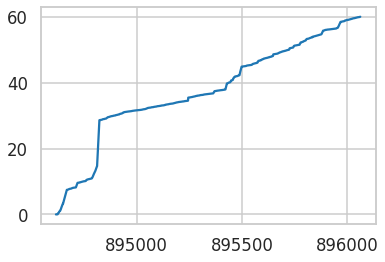

In [ ]:
df[df.OBSID == 736].timestamp.plot()

## Use Estimates to Create Timestamps

In [ ]:
gc.collect()

20

In [ ]:
total_time = pd.DataFrame(v.groupby(by=["OBSID"]).CHAPNUM.max() * 7.5)
total_time = total_time.to_dict()['CHAPNUM']


def add_timestamps(df, use_adjusted = True, custom_end_time = 0, check = False):
    """
    Adds a new column with HH:MM:SS timestamps to a grouped pd dataframe by
    'OBSID', starting at 00:00:00 for group_index 0 and ending at
    custom_end_time. Extracts available timestamps from the text and imputes
    timestamps for the rest of each group's rows using the weights found in
    'num_words'.

    Parameters:
    df (pd.DataFrame): grouped pd dataframe with a column of transcription text
        and a column of 'num_words' for each group
    custom_end_time (str): the custom end time for each group in the format
        'HH:MM:SS'

    Returns:
    pd.DataFrame: the same dataframe as input, with an additional column of
        timestamps
    """
    def numeric_time(hh=0, mm=0, ss=0):
      return float(hh)*60 + float(mm) + float(ss)/60.
    # convert custom_end_time to timedelta
    def get_custom_end(custom_end_time):
      # if isinstance(custom_end_time,str):
      #   hh, mm, ss = [float(x) for x in custom_end_time.split(":")]
      return numeric_time(hh, mm, ss)

    # define regex to extract timestamps from text
    regex = r'\[[^\]]*?(\d{1,2}):(\d{2})([:.]\d{2})?[^\]]*?\]|(\d{1,2}):(\d{2}):(\d{2})'

    # function to extract timestamp from text and return as timedelta
    def extract_timestamp(text):
        match = re.search(regex, text)
        if match:
            time_groups = list(match.groups())
            if all([not isinstance(x,str) for x in time_groups]):
              if all([isinstance(x,str) for x in time_groups[0]]) and (len(time_groups[0]) == 3): time_groups = time_groups[0]
            time_groups = [re.findall(r'\d+', str(x))[0] for x in time_groups if x != None]
            if int(time_groups[0]) >= 3:
              time_groups = [0] + time_groups
            if len(time_groups) <= 2:
              time_groups = [0] + time_groups
            if len(time_groups) > 3:
              time_groups = time_groups[:3]
            # print(time_groups)
            return numeric_time(*time_groups)
        else:
            return np.nan

    df['timestamp'] = df['text'].apply(extract_timestamp)
    df.loc[(df.turn_idx == 0) & (df.timestamp.isnull()), 'timestamp'] = 0 #pd.to_timedelta(f'{00}:{00}:{00}')
    if check:
      for m in ['akima','barycentric','slinear', 'quadratic', 'cubic','krogh', 'piecewise_polynomial',  'pchip', 'cubicspline']:
        g = df.copy()
        g['weights'] = df.adj_cum_words / df.adj_cum_words.max()
        g.loc[g.weights == 1.0,'timestamp'] = total_time[df.OBSID.iloc[0]]
        g = g.set_index('weights')
        g = g['timestamp']
        # print(g)
        # break
        timestamps = g.interpolate(method = m, limit_direction='both')
        plt.plot(timestamps)
        plt.show()
    else:
      for name, group in tqdm(df.groupby('OBSID'), total = len(df.groupby('OBSID'))):
        g = group.copy()
        if use_adjusted: g['weights'] = group.adj_cum_words / group.adj_cum_words.max()
        else: g['weights'] = group.cum_words / group.cum_words.max()
        if g.timestamp.max() > (total_time[name]):
          if int(g.timestamp.max()) == int(total_time[name]):
            g.iloc[np.argmax(g.timestamp),:].timestamp = total_time[name]
        else:
          g.loc[g.weights == 1.0,'timestamp'] = total_time[name]
        g = g.set_index('weights')
        g = g['timestamp']
        timestamps = g.interpolate(method = 'piecewise_polynomial', limit_direction='both')
        df.loc[df.OBSID == name,'timestamp'] = [0] + [x + timestamps.values[0] for x in timestamps.values][:-1]

    return df

add_timestamps(df)

maxchap = pd.DataFrame(v.groupby(by=["OBSID"]).CHAPNUM.max())
df['CHAPNUM'] = df.timestamp.apply(lambda x: ((15 + 2*x)//15))
for ob in df.OBSID.unique():
  if any(df[(df.OBSID == ob)].CHAPNUM > maxchap.loc[ob].values[0]):
    df.loc[(df.OBSID == ob) & (df.CHAPNUM > maxchap.loc[ob].values[0]),'CHAPNUM'] = maxchap.loc[ob].values[0]

  0%|          | 0/1658 [00:00<?, ?it/s]

<ipython-input-98-5219a5b4caff>:94: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  g.iloc[np.argmax(g.timestamp),:].timestamp = total_time[name]


,speaker,text,year,OBSID,video_id,cleaned_text,num_words,turn_idx,comb_idx,t,...,ORICHC,OWWSC,OERRC,OSPMMRC,SMALDISC,wpm,work_marker,work_comment,word_subs,all_added_words
0,teacher,"Friends, yesterday we started off by working o...",2,2119,706,friends yesterday we started off by working on...,13,0,2119_0,1,...,0.291667,0.583333,0.0,0.583333,0.5,123.466667,0,1,0,30.866667
1,student,Yes.,2,2119,706,yes,1,1,2119_1,0,...,0.291667,0.583333,0.0,0.583333,0.5,123.466667,0,0,0,0.000000
2,teacher,"And yesterday towards the end of the period, y...",2,2119,706,and yesterday towards the end of the period yo...,38,2,2119_2,1,...,0.291667,0.583333,0.0,0.583333,0.5,123.466667,0,0,0,0.000000
3,multiple students,Yes.,2,2119,706,yes,1,3,2119_3,0,...,0.291667,0.583333,0.0,0.583333,0.5,123.466667,0,0,0,0.000000
4,teacher,Some of you might be done.,2,2119,706,some of you might be done if you are finished ...,6,4,2119_4,1,...,0.291667,0.583333,0.0,0.583333,0.5,123.466667,0,0,0,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1412724,teacher,Okay so let’s start over who wants to go first?,1,315,445,can you hit the mouse so we can see you should...,10,515,315_515,1,...,NaN,NaN,NaN,NaN,NaN,104.973333,0,0,0,0.000000
1412725,student,I’ll go first.,1,315,445,i ll go first,3,516,315_516,0,...,NaN,NaN,NaN,NaN,NaN,104.973333,0,0,0,0.000000
1412726,teacher,What do you want to ask her if she has?,1,315,445,what do you want to ask her if she has,10,517,315_517,1,...,NaN,NaN,NaN,NaN,NaN,104.973333,0,0,0,0.000000
1412727,student,"If she has 5, 1.",1,315,445,if she has 5 1,5,518,315_518,0,...,NaN,NaN,NaN,NaN,NaN,104.973333,0,0,0,0.000000


#### Old corrections

In [ ]:
df[df.OBSID == 234].tail(7).timestamp

1065314    64.227351
1065315    64.232771
1065316    64.238192
1065317    64.259874
1065318    64.341183
1065319    64.368286
1065320    64.373707
Name: timestamp, dtype: float64

In [ ]:
df[df.OBSID == 234].adj_cum_words

426101        4.000000
426102        6.000000
426103        7.000000
426103       10.000000
426103       12.000000
              ...     
426631    10223.026667
426632    10238.026667
426633    10243.026667
426634    10244.026667
426635    10255.026667
Name: adj_cum_words, Length: 1170, dtype: float64

In [ ]:
df.loc[df.OBSID == 234,'timestamp'] = df[df.OBSID == 234].timestamp - 4.373707
df[df.OBSID == 234].timestamp

1064151    -4.373707
1064152     4.492960
1064153     4.503801
1064154     4.509221
1064155     4.525483
             ...    
1065316    59.864485
1065317    59.886167
1065318    59.967476
1065319    59.994579
1065320    60.000000
Name: timestamp, Length: 1170, dtype: float64

In [ ]:
df[df.OBSID == 234].timestamp

1064151     0.000000
1064152     8.866667
1064153     8.877508
1064154     8.882928
1064155     8.899190
             ...    
1065316    64.238192
1065317    64.259874
1065318    64.341183
1065319    64.368286
1065320    64.373707
Name: timestamp, Length: 1170, dtype: float64

In [ ]:
df.loc[1064151,'timestamp'] = 0

<Axes: >

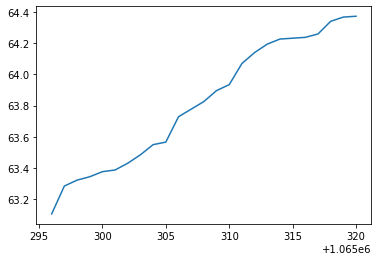

In [ ]:
df[df.OBSID == 234].timestamp[-25:].plot()

## Add Human Rater Information

In [ ]:
obs_rating_vars =  ['CLPC', 'CLNC',
       'CLTS', 'CLRSP', 'CLBM', 'CLPRDT', 'CLILF', 'CLCU', 'CLAPS', 'CLQF',
       'CLINSTD', 'CLSTENG', 'SEGMENT',
       'FORMAT_ACTIVE', 'FORMAT_BOTH', 'FORMAT_SMALLGRP', 'DIRINST', 'APLPROB',
       'CWCM', 'WCDISS', 'LINK', 'EXPL', 'MMETH', 'MGEN', 'MLANG', 'ORICH',
       'ORICH4', 'REMED', 'USEPROD', 'MATCON', 'OWWS', 'OWWS4', 'MAJERR',
       'LANGIMP', 'LCP', 'OERR', 'OERR4', 'STEXPL', 'SMQR', 'ETCA', 'OSPMMR',
       'OSPMMR4', 'STUCON', 'STUCOM', 'SMALDIS', 'MMSM', 'ORIENT', 'SUMM',
       'MQI_CHECK', 'DIFFINST', 'LLC', 'MQI3', 'MKT3', 'MQI5', 'MKT5',
       'TSTUDEA', 'TREMSTU', 'STUENG', 'CLMATINQ', 'LESSEFFIC', 'DENSMAT',
       'LATASK', 'LESSCLEAR', 'TASKDEVMAT', 'ERRANN', 'WORLD']

# obs_rating_vars =  ['CLPC', 'CLNC',
#        'CLTS', 'CLRSP', 'CLBM', 'CLPRDT', 'CLILF', 'CLCU', 'CLAPS', 'CLQF',
#        'CLINSTD', 'CLSTENG', 'SEGMENT',
#        'FORMAT_ACTIVE', 'FORMAT_BOTH', 'FORMAT_SMALLGRP', 'DIRINST', 'APLPROB',
#        'CWCM', 'WCDISS', 'LINK', 'EXPL', 'MMETH', 'MGEN', 'MLANG', 'ORICH',
#        'ORICH4', 'REMED', 'USEPROD', 'MATCON', 'OWWS', 'OWWS4', 'MAJERR',
#        'LANGIMP', 'LCP', 'OERR', 'OERR4', 'STEXPL', 'SMQR', 'ETCA', 'OSPMMR',
#        'OSPMMR4', 'STUCON', 'STUCOM', 'SMALDIS', 'MMSM']

### Old method (don't use)

In [ ]:
# for var in obs_rating_vars:
#   df[var] = np.nan


all_dfs = []

v = v.sort_values('CHAPNUM')
for obs, score in tqdm(v[v.OBSID.isin(df.OBSID.unique())].groupby(by='OBSID'), total = len(v[v.OBSID.isin(df.OBSID.unique())].groupby(by='OBSID'))):
  prev_start = 0
  prev_idx = 0
  for ch, rating in score.groupby(by='CHAPNUM'):
    idx = df.loc[(df.OBSID == obs) & (df.timestamp <= ch*7.5)].index[prev_start:] if prev_start else df.loc[(df.OBSID == obs) & (df.timestamp <= ch*7.5)].index
    OBS_len = len(df.loc[(df.OBSID == obs) & (df.timestamp <= ch*7.5)]) - prev_start
    # df.loc[(df.OBSID == obs) & (df.timestamp < ch*7.5) & (df[var].isnull()),obs_rating_vars]

    tmp = pd.DataFrame({var:[np.nanmean([float(x) if int(x) != -1 else np.nan for x in rating.loc[:,var].cat.codes])]*OBS_len for var in obs_rating_vars},index = [idx])
    # print(tmp)
    # break
    all_dfs.append(tmp)
    prev_start += OBS_len
    if len(idx): prev_idx = idx[-1]


all_dfs = pd.concat([x for x in all_dfs]).sort_index().reset_index()
# all_dfs = pd.concat([all_dfs.reset_index()['index'].apply(str).str.replace('(','').str.replace(')','').str.split(', ', expand=True).rename(columns = {0:'OBSID',1:'CHAPNUM'}),all_dfs],axis = 1)
# df = pd.merge(df, all_dfs.sort_index().reset_index(),
#               how='left',right_on='level_0',  left_index=True)


# make_class_heartbeat(2046)

  0%|          | 0/1658 [00:00<?, ?it/s]

<ipython-input-16-dfacd51a8f73>:37: RuntimeWarning: Mean of empty slice
  tmp = pd.DataFrame({var:[np.nanmean([float(x) if int(x) != -1 else np.nan for x in rating.loc[:,var].cat.codes])]*OBS_len for var in obs_rating_vars},index = [idx])
<ipython-input-16-dfacd51a8f73>:37: RuntimeWarning: Mean of empty slice
  tmp = pd.DataFrame({var:[np.nanmean([float(x) if int(x) != -1 else np.nan for x in rating.loc[:,var].cat.codes])]*OBS_len for var in obs_rating_vars},index = [idx])
<ipython-input-16-dfacd51a8f73>:37: RuntimeWarning: Mean of empty slice
  tmp = pd.DataFrame({var:[np.nanmean([float(x) if int(x) != -1 else np.nan for x in rating.loc[:,var].cat.codes])]*OBS_len for var in obs_rating_vars},index = [idx])
<ipython-input-16-dfacd51a8f73>:37: RuntimeWarning: Mean of empty slice
  tmp = pd.DataFrame({var:[np.nanmean([float(x) if int(x) != -1 else np.nan for x in rating.loc[:,var].cat.codes])]*OBS_len for var in obs_rating_vars},index = [idx])
<ipython-input-16-dfacd51a8f73>:37: RuntimeW

In [ ]:
gc.collect()

60

In [ ]:
all_dfs.to_pickle(DATA_FOLDER + "temp_timestamp_sent_transcript.pkl")

In [ ]:
all_dfs = pd.read_pickle(DATA_FOLDER + "temp_timestamp_sent_transcript.pkl")

In [ ]:
all_dfs

,level_0,CLPC,CLNC,CLTS,CLRSP,CLBM,CLPRDT,CLILF,CLCU,CLAPS,...,OERR4,STEXPL,SMQR,ETCA,OSPMMR,OSPMMR4,STUCON,STUCOM,SMALDIS,MMSM
0,0,2.0,0.0,3.0,3.0,6.0,5.0,4.0,4.0,1.0,...,0.0,1.0,0.0,0.5,1.0,2.0,NaN,NaN,NaN,NaN
1,1,2.0,0.0,3.0,3.0,6.0,5.0,4.0,4.0,1.0,...,0.0,1.0,0.0,0.5,1.0,2.0,NaN,NaN,NaN,NaN
2,2,2.0,0.0,3.0,3.0,6.0,5.0,4.0,4.0,1.0,...,0.0,1.0,0.0,0.5,1.0,2.0,NaN,NaN,NaN,NaN
3,3,2.0,0.0,3.0,3.0,6.0,5.0,4.0,4.0,1.0,...,0.0,1.0,0.0,0.5,1.0,2.0,NaN,NaN,NaN,NaN
4,4,2.0,0.0,3.0,3.0,6.0,5.0,4.0,4.0,1.0,...,0.0,1.0,0.0,0.5,1.0,2.0,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1411888,1412399,4.0,0.0,4.0,3.0,5.0,5.0,3.0,3.0,1.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1411889,1412400,4.0,0.0,4.0,3.0,5.0,5.0,3.0,3.0,1.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1411890,1412401,4.0,0.0,4.0,3.0,5.0,5.0,3.0,3.0,1.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1411891,1412402,4.0,0.0,4.0,3.0,5.0,5.0,3.0,3.0,1.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### Intermediate files

In [ ]:
df.to_pickle(DATA_FOLDER + 'augment_rerun.pkl')

In [ ]:
df = pd.read_pickle(DATA_FOLDER + 'augment_rerun.pkl')

### New Method

In [ ]:
## Convert ratings to numbers

for col in obs_rating_vars:
  v[col] = v[col].cat.codes
  v[col] = [float(x) if int(x) != -1 else np.nan for x in v[col]]

In [ ]:
## find the values to be imputed
val_lookup = {}
i = 0
for (ob, ch), g in tqdm(v[v.CHAPNUM.notnull()].groupby(by=['OBSID','CHAPNUM']), total = len(v[v.CHAPNUM.notnull()].groupby(by=['OBSID','CHAPNUM']))):
  val_lookup[(ob,ch)] = {col:np.nanmean(g[col]) for col in obs_rating_vars}

  0%|          | 0/13093 [00:00<?, ?it/s]

<ipython-input-44-49dbc2b6258d>:5: RuntimeWarning: Mean of empty slice
  val_lookup[(ob,ch)] = {col:np.nanmean(g[col]) for col in obs_rating_vars}


In [ ]:
## for each rating, construct a Series with an imputed value for every observation
newvals = {}
gc.collect()
for col in tqdm(obs_rating_vars,total= len(obs_rating_vars)):
  vals = []
  idx = []
  for k, group in tqdm(df.groupby(by=['OBSID','CHAPNUM']),total= len(df.groupby(by=['OBSID','CHAPNUM']))):
    howmany = len(group)
    vals.extend([val_lookup[k][col]]*howmany)
    idx.extend(group.index.tolist())

  newvals[col] = pd.DataFrame({col:vals},index=idx)
df.loc[:,obs_rating_vars] = pd.concat([v for k,v in newvals.items()], axis = 1).sort_index()


  0%|          | 0/46 [00:00<?, ?it/s]

  0%|          | 0/12571 [00:00<?, ?it/s]

  0%|          | 0/12571 [00:00<?, ?it/s]

  0%|          | 0/12571 [00:00<?, ?it/s]

  0%|          | 0/12571 [00:00<?, ?it/s]

  0%|          | 0/12571 [00:00<?, ?it/s]

  0%|          | 0/12571 [00:00<?, ?it/s]

  0%|          | 0/12571 [00:00<?, ?it/s]

  0%|          | 0/12571 [00:00<?, ?it/s]

  0%|          | 0/12571 [00:00<?, ?it/s]

  0%|          | 0/12571 [00:00<?, ?it/s]

  0%|          | 0/12571 [00:00<?, ?it/s]

  0%|          | 0/12571 [00:00<?, ?it/s]

  0%|          | 0/12571 [00:00<?, ?it/s]

  0%|          | 0/12571 [00:00<?, ?it/s]

  0%|          | 0/12571 [00:00<?, ?it/s]

  0%|          | 0/12571 [00:00<?, ?it/s]

  0%|          | 0/12571 [00:00<?, ?it/s]

  0%|          | 0/12571 [00:00<?, ?it/s]

  0%|          | 0/12571 [00:00<?, ?it/s]

  0%|          | 0/12571 [00:00<?, ?it/s]

  0%|          | 0/12571 [00:00<?, ?it/s]

  0%|          | 0/12571 [00:00<?, ?it/s]

  0%|          | 0/12571 [00:00<?, ?it/s]

  0%|          | 0/12571 [00:00<?, ?it/s]

  0%|          | 0/12571 [00:00<?, ?it/s]

  0%|          | 0/12571 [00:00<?, ?it/s]

  0%|          | 0/12571 [00:00<?, ?it/s]

  0%|          | 0/12571 [00:00<?, ?it/s]

  0%|          | 0/12571 [00:00<?, ?it/s]

  0%|          | 0/12571 [00:00<?, ?it/s]

  0%|          | 0/12571 [00:00<?, ?it/s]

  0%|          | 0/12571 [00:00<?, ?it/s]

  0%|          | 0/12571 [00:00<?, ?it/s]

  0%|          | 0/12571 [00:00<?, ?it/s]

  0%|          | 0/12571 [00:00<?, ?it/s]

  0%|          | 0/12571 [00:00<?, ?it/s]

  0%|          | 0/12571 [00:00<?, ?it/s]

  0%|          | 0/12571 [00:00<?, ?it/s]

  0%|          | 0/12571 [00:00<?, ?it/s]

  0%|          | 0/12571 [00:00<?, ?it/s]

  0%|          | 0/12571 [00:00<?, ?it/s]

  0%|          | 0/12571 [00:00<?, ?it/s]

  0%|          | 0/12571 [00:00<?, ?it/s]

  0%|          | 0/12571 [00:00<?, ?it/s]

  0%|          | 0/12571 [00:00<?, ?it/s]

  0%|          | 0/12571 [00:00<?, ?it/s]

In [ ]:
miss = v.groupby('OBSID')['ORIENT', 'SUMM',
       'MQI_CHECK', 'DIFFINST', 'LLC', 'MQI3', 'MKT3', 'MQI5', 'MKT5',
       'TSTUDEA', 'TREMSTU', 'STUENG', 'CLMATINQ', 'LESSEFFIC', 'DENSMAT',
       'LATASK', 'LESSCLEAR', 'TASKDEVMAT', 'ERRANN', 'WORLD']

asdf = miss.mean().reset_index()

ma = ['ORIENT', 'SUMM',
       'MQI_CHECK', 'DIFFINST', 'LLC', 'MQI3', 'MKT3', 'MQI5', 'MKT5',
       'TSTUDEA', 'TREMSTU', 'STUENG', 'CLMATINQ', 'LESSEFFIC', 'DENSMAT',
       'LATASK', 'LESSCLEAR', 'TASKDEVMAT', 'ERRANN', 'WORLD']

for ob in df.OBSID.unique():
  for m in ma:
    df.loc[(df.OBSID == ob),m] = asdf.loc[(asdf.OBSID == ob),m].item()

<ipython-input-116-98f4379b33b8>:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  miss = v.groupby('OBSID')['ORIENT', 'SUMM',


## Add Scaling

In [ ]:
# rating_cols = df.loc[:,'CLPC':'MMSM'].columns.tolist() + df.loc[:,'ORIENT':'WORLD'].columns.tolist()
scaler = MinMaxScaler()

for col in obs_rating_vars:
  df[col] = scaler.fit_transform(df.loc[:,[col]]).squeeze()

# List of column pairs
column_pairs = [('ORICH', 'ORICH4'), ('OWWS', 'OWWS4'),('OERR','OERR4'),('OSPMMR','OSPMMR4'),('SMALDIS','FORMAT_SMALLGRP')]

# Iterate over column pairs
for pair in column_pairs:
    # Compute the mean of the columns
    mean_col = np.nanmean(df[list(pair)], axis=1)
    # Create new column with combined mean
    new_col_name = pair[0] + 'C'
    df[new_col_name] = mean_col
    # Remove old columns
    # df = df.drop(list(pair), axis=1)

df.SMALDISC

<ipython-input-129-051b7b50e85f>:13: RuntimeWarning: Mean of empty slice
  mean_col = np.nanmean(df[list(pair)], axis=1)
<ipython-input-129-051b7b50e85f>:13: RuntimeWarning: Mean of empty slice
  mean_col = np.nanmean(df[list(pair)], axis=1)
<ipython-input-129-051b7b50e85f>:13: RuntimeWarning: Mean of empty slice
  mean_col = np.nanmean(df[list(pair)], axis=1)
<ipython-input-129-051b7b50e85f>:13: RuntimeWarning: Mean of empty slice
  mean_col = np.nanmean(df[list(pair)], axis=1)
<ipython-input-129-051b7b50e85f>:13: RuntimeWarning: Mean of empty slice
  mean_col = np.nanmean(df[list(pair)], axis=1)


0          0.5
1          0.5
2          0.5
3          0.5
4          0.5
          ... 
1412724    NaN
1412725    NaN
1412726    NaN
1412727    NaN
1412728    NaN
Name: SMALDISC, Length: 1412729, dtype: float64

#### Check values and Sanity checks

In [ ]:
df.WORLD.value_counts()

0.000000    114301
0.333333     67940
1.000000     53743
0.666667     52480
0.500000      2508
0.250000      2422
0.750000       909
Name: WORLD, dtype: int64

In [ ]:
df.CLAPS.value_counts()

0.333333    626931
0.500000    283571
0.166667    216233
0.666667    120420
0.000000     67127
0.833333     14986
1.000000       696
0.416667       312
Name: CLAPS, dtype: int64

## Create Heartbeat Charts

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler

def make_class_heartbeat(ob, first_axis_vars = ['t_words','s_words','w_words'],
                         second_axis_vars = ['CLAPS','FORMAT_SMALLGRP'],
                         xvar = 'timestamp',
                         xinrolling = True, legend = True, scale = False, scale1 = False, scale2 = False,
                         fix_y2 = False,
                         window = 64):
  # set the style and context of the plot
  sns.set_style('whitegrid')
  sns.set_context('talk')

  ## make a tmp dataframe
  tdf = df[first_axis_vars + second_axis_vars + [xvar]]
  if scale | scale1:
    scaler = MinMaxScaler()
    tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])
    # for v in first_axis_vars:
    #   tdf[v] = scaler.fit_transform(tdf[[v]])

  if scale | scale2:
    scaler = MinMaxScaler()
    tdf[second_axis_vars] = scaler.fit_transform(tdf[second_axis_vars])
    # for v in second_axis_vars:
    #   tdf[v] = scaler.fit_transform(tdf[[v]])

  if xinrolling:
    tdf = tdf[df.OBSID == ob].rolling(window=window,min_periods = 10, closed = 'both', center=True).mean()
  else:
    tdf = tdf[df.OBSID == ob] #[first_axis_vars + second_axis_vars + [xvar]]
    tdf[first_axis_vars + second_axis_vars] = tdf[first_axis_vars + second_axis_vars].rolling(window=window,min_periods = 10, closed = 'both', center=True).mean()

  # create a figure and axis object
  fig, ax1 = plt.subplots(figsize=(12,8))

  # plot the first three variables on the primary y-axis
  for v in first_axis_vars:
    sns.lineplot(data=tdf, x='timestamp', y=v, ax=ax1, label=v) if legend else sns.lineplot(data=tdf, x='timestamp', y=v, ax=ax1)
  ax1.set_xlabel('Timestamp')

  # create a second y-axis object
  ax2 = ax1.twinx()

  cols = {0:'tab:red',1:'tab:purple',2:'tab:cyan',3:'magenta'}
  # plot the last two variables on the secondary y-axis
  for i,v in enumerate(second_axis_vars):
    sns.lineplot(data=tdf, x='timestamp', y=v, ax=ax2, label=v, color=cols[i]) if legend else sns.lineplot(data=tdf, x='timestamp', y=v, ax=ax2, color=cols[i])

  # set the range of the secondary y-axis to 0 to 1
  if fix_y2: ax2.set_ylim(0, 1)

  # add legends to the axes
  if legend:
    ax1.legend(loc='upper left',)
    ax2.legend(loc='upper right')

  # show the plot
  plt.show()

make_class_heartbeat(450, legend=True)

# Original Pacing EDA

Note: 115.45 with sd(24.7) is avg wpm

## Loading Observation Rubric Data

In [ ]:
vadf = pd.read_csv(DATA_FOLDER + "va_year.csv")
vadf['year'] = vadf.year.fillna(0)


classdf = pyreadr.read_r(R_FOLDER + "36095-0001-Data.rda")
classdf = classdf[list(classdf.keys())[0]]
classdf.NCTETID = classdf.NCTETID.astype(int)
classdf.OBSID = classdf.OBSID.astype(int)
classdf.SCHOOLYEAR_SP = classdf.SCHOOLYEAR_SP.astype(int)
classdf['id_year'] = classdf.NCTETID.apply(str) + "_" + classdf.SCHOOLYEAR_SP.apply(lambda x: str(int(x-2000)))
c1 = copy.deepcopy(classdf)
c2 = copy.deepcopy(classdf)
c1.CHAPNUM = (c1.CHAPNUM) * 2
c2.CHAPNUM = (c2.CHAPNUM-1) * 2 + 1
classdf = pd.concat([c1,c2])
obs_years = classdf.id_year.unique()

mqi = pyreadr.read_r(R_FOLDER + "36095-0002-Data.rda")
mqi = mqi[list(mqi.keys())[0]]
mqi.loc[(mqi.OBSID == 22) & (mqi.CHAPNUM == 13),'CHAPNUM'] = 9
mqi.NCTETID = mqi.NCTETID.astype(int)
mqi.OBSID = mqi.OBSID.astype(int)
mqi.SCHOOLYEAR_SP = mqi.SCHOOLYEAR_SP.astype(int)
mqi['id_year'] = mqi.NCTETID.apply(str) + "_" + mqi.SCHOOLYEAR_SP.apply(lambda x: str(int(x-2000)))
mqi

## Value added w the CLASS rubric
v = pd.merge(vadf,classdf,on='id_year',how="outer")
v = v.drop(columns = ["NCTETID_y"]).rename(columns = {"NCTETID_x":"NCTETID"})
v = pd.merge(v.drop(columns=['OBSYEAR', 'OBSMONTH', 'OBSDAY', 'CLASS_11', 'CLASS_12', 'CLASS_13','DISTRICT',]),
         mqi.drop(columns=['OBSYEAR', 'OBSMONTH', 'OBSDAY','MQI_11', 'MQI_12', 'MQI_13',]),
         how='outer',
         on=['NCTETID', 'id_year','SCHOOLYEAR_SP','OBSID','CHAPNUM'],
         suffixes=['_C','_M'])

# ## Value added w the MQI rubric
# vq = vadf[vadf.id_year.isin(mqi.id_year.unique())]
# vq = pd.merge(vq,mqi,on='id_year')
# vq = vq.drop(columns = ["NCTETID_y"]).rename(columns = {"NCTETID_x":"NCTETID"})
# vq

# ## Value add lookup
# va = v.drop_duplicates(['id_year','OBSID','va_type','year']).pivot(index = ['OBSID','id_year','NCTETID','year'], columns = 'va_type', values = ['score','score.SE']).reset_index().rename(columns = {'score.SE':'scoreSE'})

# avgva = vadf[vadf.id_year.apply(lambda x: "_avg" in x)]
# avgva['year'] = 0
# avgva['OBSID'] = 0
# va = pd.concat([va,avgva.pivot(index = ['OBSID','id_year','NCTETID','year'], columns = 'va_type', values = ['score','score.SE']).reset_index().rename(columns = {'score.SE':'scoreSE'})])
# va = va.drop(columns = va.columns[8]).drop(columns = va.columns[5])
# va


## Combine Observation Rubric Data to Transcript

In [ ]:
# pd.merge(vadf
v = pd.merge(v.drop(columns=['OBSYEAR', 'OBSMONTH', 'OBSDAY', 'CLASS_11', 'CLASS_12', 'CLASS_13','DISTRICT',]),
         mqi.drop(columns=['OBSYEAR', 'OBSMONTH', 'OBSDAY','MQI_11', 'MQI_12', 'MQI_13',]),
         how='outer',
         on=['NCTETID', 'id_year','SCHOOLYEAR_SP','OBSID','CHAPNUM'],
         suffixes=['_C','_M'])
v.columns

Index(['NCTETID', 'score', 'score.SE', 'year', 'va_type', 'id_year',
       'SCHOOLYEAR_SP', 'OBSID', 'RATERID_C', 'CHAPNUM', 'CLPC', 'CLNC',
       'CLTS', 'CLRSP', 'CLBM', 'CLPRDT', 'CLILF', 'CLCU', 'CLAPS', 'CLQF',
       'CLINSTD', 'CLSTENG', 'DISTRICT', 'RATERID_M', 'SEGMENT',
       'FORMAT_ACTIVE', 'FORMAT_BOTH', 'FORMAT_SMALLGRP', 'DIRINST', 'APLPROB',
       'CWCM', 'WCDISS', 'LINK', 'EXPL', 'MMETH', 'MGEN', 'MLANG', 'ORICH',
       'ORICH4', 'REMED', 'USEPROD', 'MATCON', 'OWWS', 'OWWS4', 'MAJERR',
       'LANGIMP', 'LCP', 'OERR', 'OERR4', 'STEXPL', 'SMQR', 'ETCA', 'OSPMMR',
       'OSPMMR4', 'STUCON', 'STUCOM', 'SMALDIS', 'MMSM', 'ORIENT', 'SUMM',
       'MQI_CHECK', 'DIFFINST', 'LLC', 'MQI3', 'MKT3', 'MQI5', 'MKT5',
       'TSTUDEA', 'TREMSTU', 'STUENG', 'CLMATINQ', 'LESSEFFIC', 'DENSMAT',
       'LATASK', 'LESSCLEAR', 'TASKDEVMAT', 'ERRANN', 'WORLD'],
      dtype='object')

In [ ]:
df['CLPC'] = np.nan
for i, row in df[['OBSID','timestamp']].iterrows():
  subset = v.loc[v.OBSID == row.OBSID,['CLPC','CHAPNUM']]

Index(['speaker', 'text', 'year', 'OBSID', 'video_id', 'cleaned_text',
       'num_words', 'turn_idx', 'comb_idx', 't', 'cum_words', 't_words',
       's_words', 't_cum_words', 's_cum_words', 'tt_cum_ratio', 'st_cum_ratio',
       'talk_cum_pct', 't_words_rolling', 's_words_rolling', 't_25_rolling',
       's_25_rolling', 't_40_rolling', 's_40_rolling', 'all_40_rolling',
       'ts_cum_ratio', 'NCTETID', 'id_year', 'scoreSTA', 'scoreALT',
       'scoreSESTA', 'scoreSEALT', 'avgscoreSTA', 'avgscoreALT',
       'avgscoreSESTA', 'avgscoreSEALT', 'has_timestamp', 'timestamp',
       'has_work_comment', 'ind_practice', 'group_work', 'adj_num_words',
       'adj_cum_words', 'w_words', 'w_cum_words', 'w_words_rolling',
       'w_25_rolling', 'w_40_rolling', 'model_grade', 'model_domain'],
      dtype='object')

In [ ]:
df = df.drop(columns = obs_rating_vars)

In [ ]:
obs_rating_vars =  ['CLPC', 'CLNC',
       'CLTS', 'CLRSP', 'CLBM', 'CLPRDT', 'CLILF', 'CLCU', 'CLAPS', 'CLQF',
       'CLINSTD', 'CLSTENG', 'SEGMENT',
       'FORMAT_ACTIVE', 'FORMAT_BOTH', 'FORMAT_SMALLGRP', 'DIRINST', 'APLPROB',
       'CWCM', 'WCDISS', 'LINK', 'EXPL', 'MMETH', 'MGEN', 'MLANG', 'ORICH',
       'ORICH4', 'REMED', 'USEPROD', 'MATCON', 'OWWS', 'OWWS4', 'MAJERR',
       'LANGIMP', 'LCP', 'OERR', 'OERR4', 'STEXPL', 'SMQR', 'ETCA', 'OSPMMR',
       'OSPMMR4', 'STUCON', 'STUCOM', 'SMALDIS', 'MMSM', 'ORIENT', 'SUMM',
       'MQI_CHECK', 'DIFFINST', 'LLC', 'MQI3', 'MKT3', 'MQI5', 'MKT5',
       'TSTUDEA', 'TREMSTU', 'STUENG', 'CLMATINQ', 'LESSEFFIC', 'DENSMAT',
       'LATASK', 'LESSCLEAR', 'TASKDEVMAT', 'ERRANN', 'WORLD']

obs_rating_vars =  ['CLPC', 'CLNC',
       'CLTS', 'CLRSP', 'CLBM', 'CLPRDT', 'CLILF', 'CLCU', 'CLAPS', 'CLQF',
       'CLINSTD', 'CLSTENG', 'SEGMENT',
       'FORMAT_ACTIVE', 'FORMAT_BOTH', 'FORMAT_SMALLGRP', 'DIRINST', 'APLPROB',
       'CWCM', 'WCDISS', 'LINK', 'EXPL', 'MMETH', 'MGEN', 'MLANG', 'ORICH',
       'ORICH4', 'REMED', 'USEPROD', 'MATCON', 'OWWS', 'OWWS4', 'MAJERR',
       'LANGIMP', 'LCP', 'OERR', 'OERR4', 'STEXPL', 'SMQR', 'ETCA', 'OSPMMR',
       'OSPMMR4', 'STUCON', 'STUCOM', 'SMALDIS', 'MMSM']

# for var in obs_rating_vars:
#   df[var] = np.nan


all_dfs = []

v = v.sort_values('CHAPNUM')
for obs, score in tqdm(v[v.OBSID.isin(df.OBSID.unique())].groupby(by='OBSID'), total = len(v[v.OBSID.isin(df.OBSID.unique())].groupby(by='OBSID'))):
  prev_start = 0
  prev_idx = 0
  for ch, rating in score.groupby(by='CHAPNUM'):
    idx = df.loc[(df.OBSID == obs) & (df.timestamp <= ch*7.5)].index[prev_start:] if prev_start else df.loc[(df.OBSID == obs) & (df.timestamp <= ch*7.5)].index
    OBS_len = len(df.loc[(df.OBSID == obs) & (df.timestamp <= ch*7.5)]) - prev_start
    # df.loc[(df.OBSID == obs) & (df.timestamp < ch*7.5) & (df[var].isnull()),obs_rating_vars]

    tmp = pd.DataFrame({var:[np.nanmean([float(x) if int(x) != -1 else np.nan for x in rating.loc[:,var].cat.codes])]*OBS_len for var in obs_rating_vars},index = [idx])
    # print(tmp)
    # break
    all_dfs.append(tmp)
    prev_start += OBS_len
    if len(idx): prev_idx = idx[-1]


all_dfs = pd.concat([x for x in all_dfs])
# all_dfs = pd.concat([all_dfs.reset_index()['index'].apply(str).str.replace('(','').str.replace(')','').str.split(', ', expand=True).rename(columns = {0:'OBSID',1:'CHAPNUM'}),all_dfs],axis = 1)
# df = pd.merge(df, all_dfs.sort_index().reset_index(),
#               how='left',right_on='level_0',  left_index=True)


# make_class_heartbeat(2046)

  0%|          | 0/1658 [00:00<?, ?it/s]

<ipython-input-12-afa49ad21e83>:37: RuntimeWarning: Mean of empty slice
  tmp = pd.DataFrame({var:[np.nanmean([float(x) if int(x) != -1 else np.nan for x in rating.loc[:,var].cat.codes])]*OBS_len for var in obs_rating_vars},index = [idx])
<ipython-input-12-afa49ad21e83>:37: RuntimeWarning: Mean of empty slice
  tmp = pd.DataFrame({var:[np.nanmean([float(x) if int(x) != -1 else np.nan for x in rating.loc[:,var].cat.codes])]*OBS_len for var in obs_rating_vars},index = [idx])
<ipython-input-12-afa49ad21e83>:37: RuntimeWarning: Mean of empty slice
  tmp = pd.DataFrame({var:[np.nanmean([float(x) if int(x) != -1 else np.nan for x in rating.loc[:,var].cat.codes])]*OBS_len for var in obs_rating_vars},index = [idx])
<ipython-input-12-afa49ad21e83>:37: RuntimeWarning: Mean of empty slice
  tmp = pd.DataFrame({var:[np.nanmean([float(x) if int(x) != -1 else np.nan for x in rating.loc[:,var].cat.codes])]*OBS_len for var in obs_rating_vars},index = [idx])
<ipython-input-12-afa49ad21e83>:37: RuntimeW

In [ ]:
all_dfs = all_dfs.sort_index().reset_index()

In [ ]:
all_dfs.to_pickle(DATA_FOLDER + "temp_timestamp_sent_transcript.pkl")

In [ ]:
all_dfs.columns

Index(['level_0', 'CLPC', 'CLNC', 'CLTS', 'CLRSP', 'CLBM', 'CLPRDT', 'CLILF',
       'CLCU', 'CLAPS', 'CLQF', 'CLINSTD', 'CLSTENG', 'SEGMENT',
       'FORMAT_ACTIVE', 'FORMAT_BOTH', 'FORMAT_SMALLGRP', 'DIRINST', 'APLPROB',
       'CWCM', 'WCDISS', 'LINK', 'EXPL', 'MMETH', 'MGEN', 'MLANG', 'ORICH',
       'ORICH4', 'REMED', 'USEPROD', 'MATCON', 'OWWS', 'OWWS4', 'MAJERR',
       'LANGIMP', 'LCP', 'OERR', 'OERR4', 'STEXPL', 'SMQR', 'ETCA', 'OSPMMR',
       'OSPMMR4', 'STUCON', 'STUCOM', 'SMALDIS', 'MMSM'],
      dtype='object')

In [ ]:
df.tail(20)

,speaker,text,year,OBSID,video_id,cleaned_text,num_words,turn_idx,comb_idx,t,...,OERR4,STEXPL,SMQR,ETCA,OSPMMR,OSPMMR4,STUCON,STUCOM,SMALDIS,MMSM
1412384,teacher,Shhh.,1,315,445,hey i think you guys need to start over you ca...,1,511,315_511,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1412385,teacher,"3, 2, 1.",1,315,445,hey i think you guys need to start over you ca...,3,511,315_511,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1412386,teacher,I want all eyes on me.,1,315,445,hey i think you guys need to start over you ca...,6,511,315_511,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1412387,teacher,Boys and girls you’re working nicely all I hea...,1,315,445,hey i think you guys need to start over you ca...,14,511,315_511,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1412388,teacher,But your voices are too loud.,1,315,445,hey i think you guys need to start over you ca...,6,511,315_511,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1412389,teacher,I can barely hear the person I’m talking to be...,1,315,445,hey i think you guys need to start over you ca...,17,511,315_511,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1412390,teacher,If we all use soft voices we’ll all be able to...,1,315,445,hey i think you guys need to start over you ca...,24,511,315_511,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1412391,teacher,Okay.,1,315,445,hey i think you guys need to start over you ca...,1,511,315_511,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1412392,teacher,And I’m gonna be watching and listening I’m go...,1,315,445,hey i think you guys need to start over you ca...,25,511,315_511,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1412393,teacher,Can we do that?,1,315,445,hey i think you guys need to start over you ca...,4,511,315_511,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
all_dfs.level_0

0                0
1                1
2                2
3                3
4                4
            ...   
1404134    1412395
1404135    1412396
1404136    1412397
1404137    1412398
1404138    1412399
Name: level_0, Length: 1404139, dtype: int64

In [ ]:
gc.collect()

3427

In [ ]:
# all_dfs = pd.concat([x for x in all_dfs])
# all_dfs = pd.concat([all_dfs.reset_index()['index'].apply(str).str.replace('(','').str.replace(')','').str.split(', ', expand=True).rename(columns = {0:'OBSID',1:'CHAPNUM'}),all_dfs],axis = 1)
df = pd.merge(df.drop(columns = obs_rating_vars), all_dfs,
              how='left',right_on='level_0',  left_index=True)




In [ ]:
[float(x) if int(x) != -1 else np.nan for x in v[v.OBSID == 450]['MLANG'].cat.codes ]

[1.0,
 2.0,
 1.0,
 2.0,
 1.0,
 2.0,
 1.0,
 2.0,
 2.0,
 1.0,
 2.0,
 1.0,
 2.0,
 1.0,
 2.0,
 1.0,
 2.0,
 1.0,
 2.0,
 1.0,
 1.0,
 2.0,
 1.0,
 2.0,
 2.0,
 2.0,
 1.0,
 1.0,
 2.0,
 1.0,
 2.0,
 1.0,
 nan,
 nan]

In [ ]:
# all_dfs.loc['OBSID'] = all_dfs.reset_index()['index'].apply(lambda x: x[0])
# all_dfs.loc['CHAPNUM'] = all_dfs.reset_index()['index'].apply(lambda x: x[1])
# all_dfs = all_dfs.iloc[:-2,:] ,all_dfs],axis = 1)
# all_dfs.loc[:,['OBSID','CHAPNUM']] =
all_dfs.reset_index()['index'].apply(str).str.replace('(','').str.replace(')','').str.split(', ', expand=True).rename(columns = {0:'OBSID',1:'CHAPNUM'})
# all_dfs

<ipython-input-43-6189707489b7>:5: FutureWarning: The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.
  all_dfs.reset_index()['index'].apply(str).str.replace('(','').str.replace(')','').str.split(', ', expand=True).rename(columns = {0:'OBSID',1:'CHAPNUM'}).numpy()


AttributeError: ignored

In [ ]:
all_dfs.sort_index().reset_index()

,level_0,CLPC,CLNC,CLTS,CLRSP,CLBM,CLPRDT,CLILF,CLCU,CLAPS,...,TREMSTU,STUENG,CLMATINQ,LESSEFFIC,DENSMAT,LATASK,LESSCLEAR,TASKDEVMAT,ERRANN,WORLD
0,0,2.0,0.0,3.0,3.0,6.0,5.0,4.0,4.0,1.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,2.0,0.0,3.0,3.0,6.0,5.0,4.0,4.0,1.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2,2.0,0.0,3.0,3.0,6.0,5.0,4.0,4.0,1.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3,2.0,0.0,3.0,3.0,6.0,5.0,4.0,4.0,1.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,4,2.0,0.0,3.0,3.0,6.0,5.0,4.0,4.0,1.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
575156,580399,4.0,0.0,4.0,3.0,5.0,5.0,3.0,3.0,1.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
575157,580400,4.0,0.0,4.0,3.0,5.0,5.0,3.0,3.0,1.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
575158,580401,4.0,0.0,4.0,3.0,5.0,5.0,3.0,3.0,1.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
575159,580402,4.0,0.0,4.0,3.0,5.0,5.0,3.0,3.0,1.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
# df = df.drop(columns = obs_rating_vars)
df.head()

,speaker,text,year,OBSID,video_id,cleaned_text,num_words,turn_idx,comb_idx,t,...,TREMSTU,STUENG,CLMATINQ,LESSEFFIC,DENSMAT,LATASK,LESSCLEAR,TASKDEVMAT,ERRANN,WORLD
0.0,teacher,"Friends, yesterday we started off by working o...",2,2119,706,friends yesterday we started off by working on...,13,0,2119_0,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1.0,student,Yes.,2,2119,706,yes,1,1,2119_1,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2.0,teacher,"And yesterday towards the end of the period, y...",2,2119,706,and yesterday towards the end of the period yo...,38,2,2119_2,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3.0,multiple students,Yes.,2,2119,706,yes,1,3,2119_3,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4.0,teacher,Some of you might be done. If you are finishe...,2,2119,706,some of you might be done if you are finished ...,106,4,2119_4,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
df[obs_rating_vars]

,CLPC,CLNC,CLTS,CLRSP,CLBM,CLPRDT,CLILF,CLCU,CLAPS,CLQF,...,TREMSTU,STUENG,CLMATINQ,LESSEFFIC,DENSMAT,LATASK,LESSCLEAR,TASKDEVMAT,ERRANN,WORLD
0.0,2.0,0.0,3.0,3.0,6.0,5.0,4.0,4.0,1.0,2.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1.0,2.0,0.0,3.0,3.0,6.0,5.0,4.0,4.0,1.0,2.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2.0,2.0,0.0,3.0,3.0,6.0,5.0,4.0,4.0,1.0,2.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3.0,2.0,0.0,3.0,3.0,6.0,5.0,4.0,4.0,1.0,2.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4.0,2.0,0.0,3.0,3.0,6.0,5.0,4.0,4.0,1.0,2.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
575160.0,4.0,0.0,4.0,3.0,5.0,5.0,3.0,3.0,1.0,2.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
df.shape

(579979, 125)

In [ ]:
df.loc[(df.OBSID == 450)].where(df.timestamp <= ch*7.5).shape

(405, 116)

In [ ]:
all_df.groupby(by = 'OBSID')

In [ ]:
df.groupby(by= 'OBSID').timestamp.max()

OBSID
3       58.631636
4       67.448279
5       59.365760
7       44.979460
8       52.484013
          ...    
4758    42.554142
4759    29.978922
4760    59.989820
4762    36.816853
4763    59.481736
Name: timestamp, Length: 1658, dtype: float64

In [ ]:
obs_rating_vars =  ['CLPC', 'CLNC',
       'CLTS', 'CLRSP', 'CLBM', 'CLPRDT', 'CLILF', 'CLCU', 'CLAPS', 'CLQF',
       'CLINSTD', 'CLSTENG', 'SEGMENT',
       'FORMAT_ACTIVE', 'FORMAT_BOTH', 'FORMAT_SMALLGRP', 'DIRINST', 'APLPROB',
       'CWCM', 'WCDISS', 'LINK', 'EXPL', 'MMETH', 'MGEN', 'MLANG', 'ORICH',
       'ORICH4', 'REMED', 'USEPROD', 'MATCON', 'OWWS', 'OWWS4', 'MAJERR',
       'LANGIMP', 'LCP', 'OERR', 'OERR4', 'STEXPL', 'SMQR', 'ETCA', 'OSPMMR',
       'OSPMMR4', 'STUCON', 'STUCOM', 'SMALDIS', 'MMSM', 'ORIENT', 'SUMM',
       'MQI_CHECK', 'DIFFINST', 'LLC', 'MQI3', 'MKT3', 'MQI5', 'MKT5',
       'TSTUDEA', 'TREMSTU', 'STUENG', 'CLMATINQ', 'LESSEFFIC', 'DENSMAT',
       'LATASK', 'LESSCLEAR', 'TASKDEVMAT', 'ERRANN', 'WORLD']

transformed = {x:[] for x in obs_rating_vars}




for (obs,ch), g in v.groupby(by=['OBSID','CHAPNUM']):
  for col in obs_rating_vars:

    print(np.mean([float(x) if x != -1 else np.nan for x in g.loc[:,col].cat.codes]))

    # print(g.loc[:,col])
break


(3.0, 1.0)
3.0
(3.0, 1.0)
0.0
(3.0, 1.0)
3.0
(3.0, 1.0)
4.0
(3.0, 1.0)
4.0
(3.0, 1.0)
5.0
(3.0, 1.0)
5.0
(3.0, 1.0)
4.0
(3.0, 1.0)
4.0
(3.0, 1.0)
5.0
(3.0, 1.0)
4.0
(3.0, 1.0)
4.0
(3.0, 1.0)
1.0
(3.0, 1.0)
1.0
(3.0, 1.0)
0.0
(3.0, 1.0)
0.0
(3.0, 1.0)
2.0
(3.0, 1.0)
0.5
(3.0, 1.0)
1.0
(3.0, 1.0)
0.0
(3.0, 1.0)
0.5
(3.0, 1.0)
1.0
(3.0, 1.0)
1.0
(3.0, 1.0)
0.0
(3.0, 1.0)
1.0
(3.0, 1.0)
1.0
(3.0, 1.0)
nan
(3.0, 1.0)
0.0
(3.0, 1.0)
0.5
(3.0, 1.0)
nan
(3.0, 1.0)
0.5
(3.0, 1.0)
nan
(3.0, 1.0)
0.0
(3.0, 1.0)
0.0
(3.0, 1.0)
0.0
(3.0, 1.0)
0.0
(3.0, 1.0)
nan
(3.0, 1.0)
1.0
(3.0, 1.0)
0.5
(3.0, 1.0)
1.0
(3.0, 1.0)
1.0
(3.0, 1.0)
nan
(3.0, 1.0)
nan
(3.0, 1.0)
nan
(3.0, 1.0)
nan
(3.0, 1.0)
nan
(3.0, 1.0)
nan
(3.0, 1.0)
nan
(3.0, 1.0)
nan
(3.0, 1.0)
nan
(3.0, 1.0)
nan
(3.0, 1.0)
nan
(3.0, 1.0)
nan
(3.0, 1.0)
nan
(3.0, 1.0)
nan
(3.0, 1.0)
nan
(3.0, 1.0)
nan
(3.0, 1.0)
nan
(3.0, 1.0)
nan
(3.0, 1.0)
nan
(3.0, 1.0)
nan
(3.0, 1.0)
nan
(3.0, 1.0)
nan
(3.0, 1.0)
nan
(3.0, 1.0)
nan
(3.0, 1.0)
nan


In [ ]:
v.CHAPNUM.value_counts()

4.0     3285
3.0     3285
2.0     3281
1.0     3281
6.0     3076
5.0     3076
8.0     2074
7.0     2074
10.0     297
9.0      297
12.0      34
11.0      34
14.0       2
16.0       2
13.0       2
15.0       2
Name: CHAPNUM, dtype: int64

In [ ]:
mqi.CHAPNUM.value_counts()

1.0     3398
2.0     3398
3.0     3392
4.0     3381
5.0     3296
6.0     3045
7.0     2550
8.0     1793
9.0      546
10.0     206
11.0      72
12.0      21
13.0       3
Name: CHAPNUM, dtype: int64

In [ ]:
v.head()

,NCTETID,score,score.SE,year,va_type,id_year,DISTRICT,CLASS_11,CLASS_12,CLASS_13,...,CLTS,CLRSP,CLBM,CLPRDT,CLILF,CLCU,CLAPS,CLQF,CLINSTD,CLSTENG
0,11001.0,-0.132015,0.097312,0.0,STA,11001_avg,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,11001.0,-0.013656,0.107535,0.0,ALT,11001_avg,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,11002.0,-0.141363,0.104867,0.0,STA,11002_avg,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,11002.0,-0.060862,0.093326,0.0,ALT,11002_avg,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,11003.0,0.219373,0.083661,0.0,STA,11003_avg,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
classdf.columns

Index(['NCTETID', 'DISTRICT', 'CLASS_11', 'CLASS_12', 'CLASS_13',
       'SCHOOLYEAR_SP', 'OBSID', 'RATERID', 'OBSYEAR', 'OBSMONTH', 'OBSDAY',
       'CHAPNUM', 'CLPC', 'CLNC', 'CLTS', 'CLRSP', 'CLBM', 'CLPRDT', 'CLILF',
       'CLCU', 'CLAPS', 'CLQF', 'CLINSTD', 'CLSTENG', 'id_year'],
      dtype='object')

#### Adjusting and adding corrected data

## Initial over-time graphs

/usr/local/lib/python3.8/dist-packages/pandas/plotting/_matplotlib/core.py:345: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/usr/local/lib/python3.8/dist-packages/pandas/plotting/_matplotlib/core.py:345: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/usr/local/lib/python3.8/dist-packages/pandas/plotting/_matplotlib/core.py:345: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) a

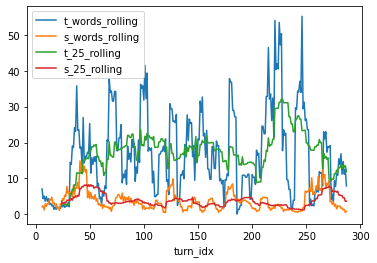

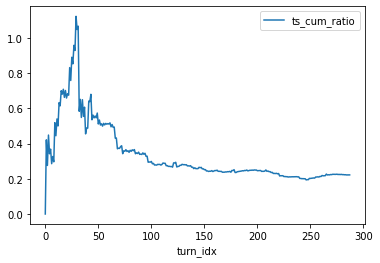

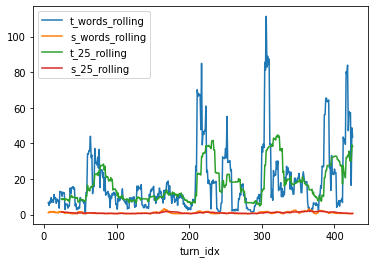

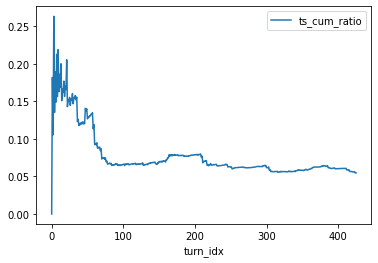

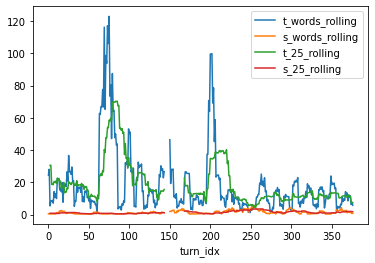

...

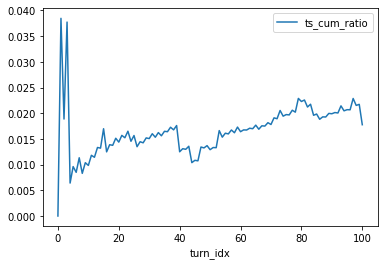

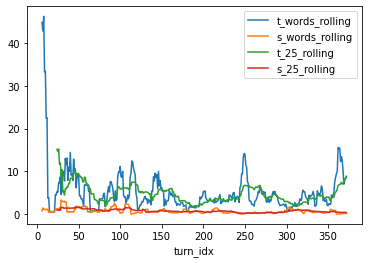

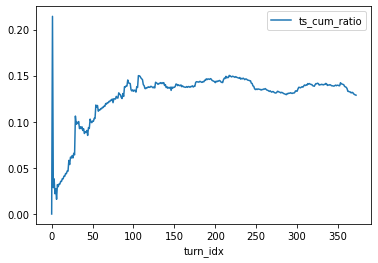

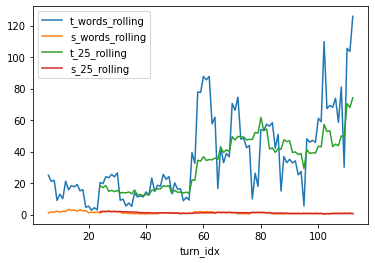

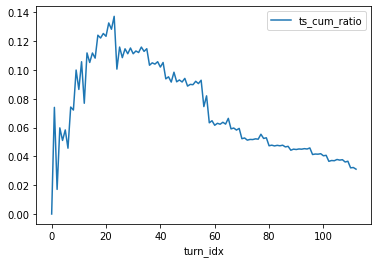

In [ ]:
OBs = df.OBSID.sample(50)
# df.t_words.rolling(7).mean()
for ob in OBs:
  df[df.OBSID == ob].plot.line(x = "turn_idx", y = ["t_words_rolling","s_words_rolling","t_25_rolling","s_25_rolling"])
  df[df.OBSID == ob].plot.line(x = "turn_idx", y = ["ts_cum_ratio"])

/usr/local/lib/python3.8/dist-packages/pandas/plotting/_matplotlib/core.py:345: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/usr/local/lib/python3.8/dist-packages/pandas/plotting/_matplotlib/core.py:345: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/usr/local/lib/python3.8/dist-packages/pandas/plotting/_matplotlib/core.py:345: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) a

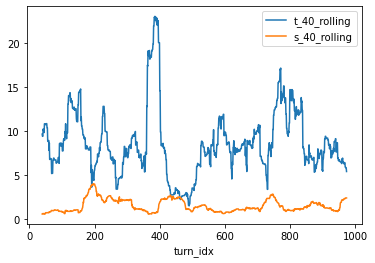

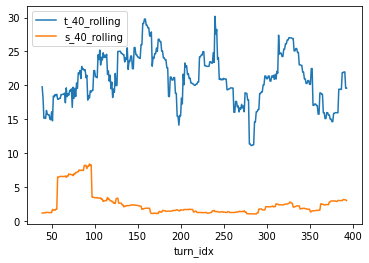

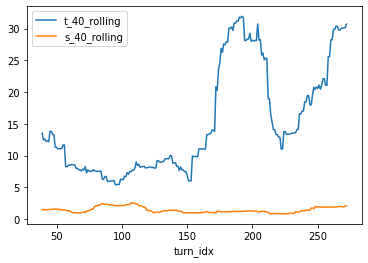

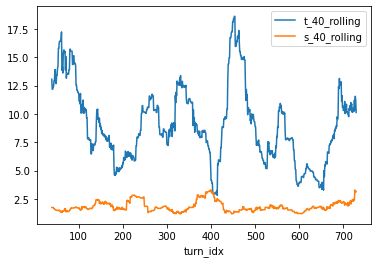

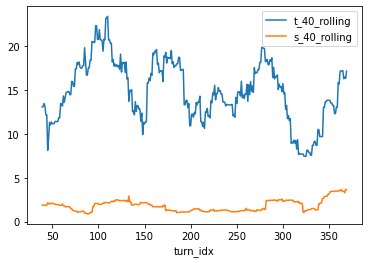

...

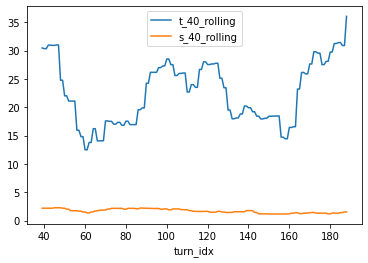

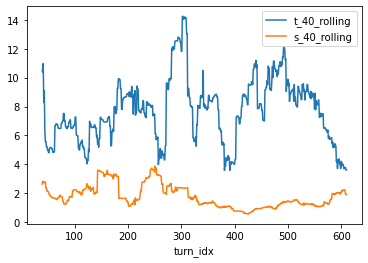

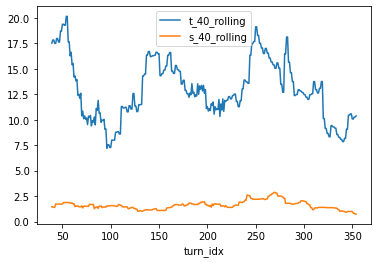

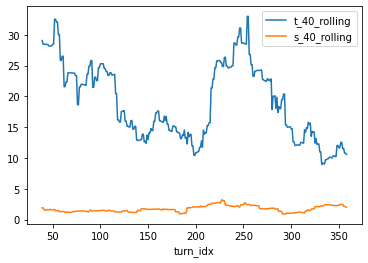

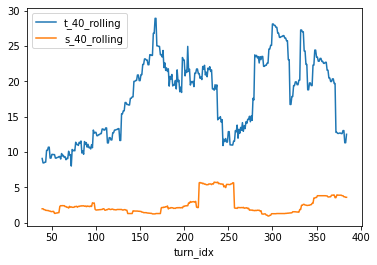

In [ ]:
OBs = df.OBSID.sample(50)
# df.t_words.rolling(7).mean()
for ob in OBs:
  df[df.OBSID == ob].plot.line(x = "turn_idx", y = ["t_40_rolling","s_40_rolling"])
  # df[df.OBSID == ob].plot.line(x = "turn_idx", y = ["ts_cum_ratio"])

### Time and word aggregates

<AxesSubplot:>

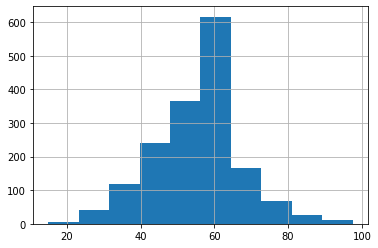

In [ ]:
times = mqi.groupby(by=["OBSID"]).CHAPNUM.nunique().reset_index()
times["minutes"] = times["CHAPNUM"] *7.5
times = pd.merge(df.groupby(by=['OBSID']).num_words.sum().reset_index(),times,on="OBSID")
times['NCTETID'] = times.OBSID.apply(lambda x: classdf[classdf.OBSID == x].NCTETID.unique()[0])
times['year'] = times.OBSID.apply(lambda x: classdf[classdf.OBSID == x].SCHOOLYEAR_SP.unique()[0])
times['id_year'] = times.OBSID.apply(lambda x: classdf[classdf.OBSID == x].id_year.unique()[0])
times['STA'] = times.id_year.apply(lambda x: v[(v.id_year == x) & (v.va_type == "STA")].score.values)
times['ALT'] = times.id_year.apply(lambda x: v[(v.id_year == x) & (v.va_type == "ALT")].score.values)
times['STA'] = times.STA.apply(lambda x: x[0] if len(x) > 0 else np.nan)
times['ALT'] = times.ALT.apply(lambda x: x[0] if len(x) > 0  else np.nan)
times.minutes.hist()

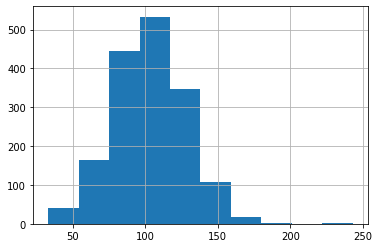

In [ ]:
times['wpm'] = times.num_words / times.minutes
times.wpm.hist()

In [ ]:
times.sort_values("wpm")

,OBSID,num_words,CHAPNUM,minutes,wpm
1268,2962,1983,8,60.0,33.050000
695,1166,1995,8,60.0,33.250000
1147,2700,2087,8,60.0,34.783333
99,137,2147,8,60.0,35.783333
810,2135,2256,8,60.0,37.600000
...,...,...,...,...,...
237,361,7693,6,45.0,170.955556
954,2404,16588,12,90.0,184.311111
112,155,6955,5,37.5,185.466667
296,508,12414,7,52.5,236.457143


In [ ]:
total_time.loc[22]

CHAPNUM    1.125
Name: 22.0, dtype: float64

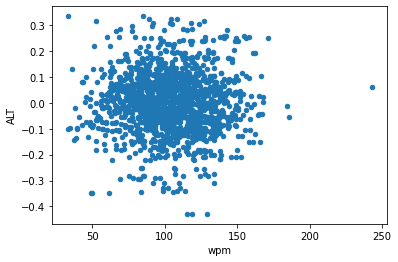

In [ ]:
times.plot.scatter(x="wpm",y="ALT")


### Initial T survey

In [ ]:
mqi['wpm'] = mqi.OBSID.apply(lambda x: times.loc[times.OBSID == x, "wpm"].iloc[0] if x in times.OBSID.unique() else np.nan)
for c in mqi.columns[6:]:
  if mqi[c].dtype == "category":
    print(mqi.groupby(c).wpm.mean())

SEGMENT
(0) Lesson     103.068312
(1) Segment    103.069449
Name: wpm, dtype: float64
FORMAT_ACTIVE
(0) No     101.723370
(1) Yes    105.269837
Name: wpm, dtype: float64
FORMAT_BOTH
(0) No     103.919239
(1) Yes    102.258488
Name: wpm, dtype: float64
FORMAT_SMALLGRP
(0) No     104.009250
(1) Yes    100.846895
Name: wpm, dtype: float64
DIRINST
(1) None         94.249407
(2) Some        100.767689
(3) Most/All    105.544173
Name: wpm, dtype: float64
APLPROB
(1) None        102.256935
(2) Some        105.311605
(3) Most/All    106.755681
Name: wpm, dtype: float64
CWCM
(0) No     101.830086
(1) Yes    103.133621
Name: wpm, dtype: float64
WCDISS
(1) None        102.930651
(2) Some        106.322867
(3) Most/All    102.578091
Name: wpm, dtype: float64
LINK
(1) Low     101.921747
(2) Mid     105.531058
(3) High    107.764412
Name: wpm, dtype: float64
EXPL
(1) Low     101.768148
(2) Mid     106.667135
(3) High    108.319276
Name: wpm, dtype: float64
MMETH
(1) Low     102.724370
(2) Mid     10

In [ ]:
for c in mqi.columns[6:]:
  if mqi[c].dtype == "category":

    print(pd.merge(pd.merge(pd.merge(mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.mean(),
                   mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.mean()/mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.max(),left_index=True, right_index=True),
                   mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.median(),left_index=True, right_index=True),
                   mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.std(),left_index=True, right_index=True),)

<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a MergeError in a future version.
  print(pd.merge(pd.merge(pd.merge(mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.mean(),
<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a MergeError in a future version.
  print(pd.merge(pd.merge(pd.merge(mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.mean(),
<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a MergeError in a future version.
  print(pd.merge(pd.merge(pd.merge(mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.mean(),


             CHAPNUM_x  CHAPNUM_y  CHAPNUM_x  CHAPNUM_y
SEGMENT                                                
(0) Lesson         NaN        NaN        NaN        NaN
(1) Segment   4.338273   0.333713        4.0   2.344687
               CHAPNUM_x  CHAPNUM_y  CHAPNUM_x  CHAPNUM_y
FORMAT_ACTIVE                                            
(0) No          4.782629   0.398552        5.0   2.142337
(1) Yes         3.812185   0.293245        3.0   2.454497
             CHAPNUM_x  CHAPNUM_y  CHAPNUM_x  CHAPNUM_y
FORMAT_BOTH                                            
(0) No        4.255104   0.327316        4.0   2.406738
(1) Yes       4.489132   0.374094        4.0   2.201121


<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a MergeError in a future version.
  print(pd.merge(pd.merge(pd.merge(mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.mean(),
<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a MergeError in a future version.
  print(pd.merge(pd.merge(pd.merge(mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.mean(),
<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a MergeError in a future version.
  print(pd.merge(pd.merge(pd.merge(mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.mean(),


                 CHAPNUM_x  CHAPNUM_y  CHAPNUM_x  CHAPNUM_y
FORMAT_SMALLGRP                                            
(0) No            4.095766   0.315059        4.0   2.375209
(1) Yes           5.265117   0.438760        5.0   1.948455
              CHAPNUM_x  CHAPNUM_y  CHAPNUM_x  CHAPNUM_y
DIRINST                                                 
(1) None       5.179092   0.431591        5.0   2.266406
(2) Some       4.690143   0.360780        5.0   2.217574
(3) Most/All   4.074155   0.313397        4.0   2.366972
              CHAPNUM_x  CHAPNUM_y  CHAPNUM_x  CHAPNUM_y
APLPROB                                                 
(1) None       4.290091   0.330007        4.0   2.361974
(2) Some       4.085303   0.371391        4.0   2.343271
(3) Most/All   4.644684   0.357283        5.0   2.233323
         CHAPNUM_x  CHAPNUM_y  CHAPNUM_x  CHAPNUM_y
CWCM                                               
(0) No    4.280514   0.356709        4.0   2.672714
(1) Yes   4.341679   0.333975     

<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a MergeError in a future version.
  print(pd.merge(pd.merge(pd.merge(mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.mean(),
<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a MergeError in a future version.
  print(pd.merge(pd.merge(pd.merge(mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.mean(),
<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a MergeError in a future version.
  print(pd.merge(pd.merge(pd.merge(mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.mean(),


              CHAPNUM_x  CHAPNUM_y  CHAPNUM_x  CHAPNUM_y
WCDISS                                                  
(1) None       4.354614   0.334970        4.0   2.343086
(2) Some       3.966361   0.305105        3.0   2.378022
(3) Most/All   4.238710   0.353226        4.0   2.210024
          CHAPNUM_x  CHAPNUM_y  CHAPNUM_x  CHAPNUM_y
LINK                                                
(1) Low    4.422919   0.340225        4.0   2.384620
(2) Mid    4.145178   0.345431        4.0   2.241444
(3) High   4.008071   0.364370        4.0   2.153241
          CHAPNUM_x  CHAPNUM_y  CHAPNUM_x  CHAPNUM_y
EXPL                                                
(1) Low    4.393922   0.337994        4.0   2.354283
(2) Mid    4.203576   0.350298        4.0   2.300733
(3) High   3.908197   0.325683        3.0   2.362424
          CHAPNUM_x  CHAPNUM_y  CHAPNUM_x  CHAPNUM_y
MMETH                                               
(1) Low    4.349595   0.334584        4.0   2.356879
(2) Mid    4.284827   0.32

<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a MergeError in a future version.
  print(pd.merge(pd.merge(pd.merge(mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.mean(),
<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a MergeError in a future version.
  print(pd.merge(pd.merge(pd.merge(mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.mean(),
<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a MergeError in a future version.
  print(pd.merge(pd.merge(pd.merge(mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.mean(),
<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a M

          CHAPNUM_x  CHAPNUM_y  CHAPNUM_x  CHAPNUM_y
MLANG                                               
(1) Low    4.618113   0.355239        5.0   2.329835
(2) Mid    4.050548   0.311581        4.0   2.316975
(3) High   3.511913   0.319265        3.0   2.243818
          CHAPNUM_x  CHAPNUM_y  CHAPNUM_x  CHAPNUM_y
ORICH                                               
(1) Low    4.403240   0.338711        4.0   2.358692
(2) Mid    4.189648   0.322281        4.0   2.290090
(3) High   3.980769   0.361888        4.0   2.306540
             CHAPNUM_x  CHAPNUM_y  CHAPNUM_x  CHAPNUM_y
ORICH4                                                 
(1) Low       4.646786   0.387232        5.0   2.412597
(2) Low/Mid   4.157226   0.377930        4.0   2.279595
(3) Mid       4.093785   0.341149        4.0   2.255668
(4) High      3.850136   0.350012        3.0   2.148044
          CHAPNUM_x  CHAPNUM_y  CHAPNUM_x  CHAPNUM_y
REMED                                               
(1) Low    4.226269   0.3250

<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a MergeError in a future version.
  print(pd.merge(pd.merge(pd.merge(mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.mean(),
<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a MergeError in a future version.
  print(pd.merge(pd.merge(pd.merge(mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.mean(),
<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a MergeError in a future version.
  print(pd.merge(pd.merge(pd.merge(mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.mean(),
<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a M

          CHAPNUM_x  CHAPNUM_y  CHAPNUM_x  CHAPNUM_y
USEPROD                                             
(1) Low    4.376834   0.364736        4.0   2.341393
(2) Mid    4.156239   0.319711        4.0   2.328441
(3) High   4.032761   0.336063        4.0   2.361247
                 CHAPNUM_x  CHAPNUM_y  CHAPNUM_x  CHAPNUM_y
MATCON                                                     
(1) Not Present   4.782007   0.434728        5.0   2.511457
(2) Low           4.363174   0.396652        4.0   2.293584
(3) Mid           3.982487   0.362044        4.0   2.292703
(4) High          3.700000   0.411111        3.0   2.048688
          CHAPNUM_x  CHAPNUM_y  CHAPNUM_x  CHAPNUM_y
OWWS                                                
(1) Low    4.297415   0.358118        4.0   2.373186
(2) Mid    4.427964   0.340613        4.0   2.261524
(3) High   4.318182   0.392562        4.0   2.288390
             CHAPNUM_x  CHAPNUM_y  CHAPNUM_x  CHAPNUM_y
OWWS4                                                 

<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a MergeError in a future version.
  print(pd.merge(pd.merge(pd.merge(mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.mean(),
<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a MergeError in a future version.
  print(pd.merge(pd.merge(pd.merge(mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.mean(),
<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a MergeError in a future version.
  print(pd.merge(pd.merge(pd.merge(mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.mean(),
<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a M

          CHAPNUM_x  CHAPNUM_y  CHAPNUM_x  CHAPNUM_y
MAJERR                                              
(1) Low    4.371476   0.336267        4.0   2.346890
(2) Mid    3.852824   0.321069        3.0   2.263279
(3) High   3.648305   0.364831        3.0   2.119624
          CHAPNUM_x  CHAPNUM_y  CHAPNUM_x  CHAPNUM_y
LANGIMP                                             
(1) Low    4.426603   0.340508        4.0   2.357877
(2) Mid    3.839042   0.319920        4.0   2.214221
(3) High   3.956332   0.439592        4.0   2.085416
          CHAPNUM_x  CHAPNUM_y  CHAPNUM_x  CHAPNUM_y
LCP                                                 
(1) Low    4.383413   0.337186        4.0   2.355439
(2) Mid    3.868852   0.322404        4.0   2.193464
(3) High   4.170306   0.417031        4.0   2.119622
          CHAPNUM_x  CHAPNUM_y  CHAPNUM_x  CHAPNUM_y
OERR                                                
(1) Low    4.471050   0.343927        4.0   2.360908
(2) Mid    3.884708   0.323726        4.0   2.

<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a MergeError in a future version.
  print(pd.merge(pd.merge(pd.merge(mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.mean(),
<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a MergeError in a future version.
  print(pd.merge(pd.merge(pd.merge(mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.mean(),
<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a MergeError in a future version.
  print(pd.merge(pd.merge(pd.merge(mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.mean(),
<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a M

             CHAPNUM_x  CHAPNUM_y  CHAPNUM_x  CHAPNUM_y
OERR4                                                  
(1) Low       4.515834   0.376319        4.0   2.379185
(2) Low/Mid   3.943618   0.328635        4.0   2.230001
(3) Mid       3.851626   0.350148        4.0   2.175031
(4) High      4.044944   0.404494        4.0   2.063457
          CHAPNUM_x  CHAPNUM_y  CHAPNUM_x  CHAPNUM_y
STEXPL                                              
(1) Low    4.404248   0.338788        4.0   2.345301
(2) Mid    4.101373   0.315490        4.0   2.315116
(3) High   3.532203   0.294350        3.0   2.364307
          CHAPNUM_x  CHAPNUM_y  CHAPNUM_x  CHAPNUM_y
SMQR                                                
(1) Low    4.400088   0.338468        4.0   2.364161
(2) Mid    4.112583   0.316353        4.0   2.224260
(3) High   3.776699   0.290515        3.0   2.294799
          CHAPNUM_x  CHAPNUM_y  CHAPNUM_x  CHAPNUM_y
ETCA                                                
(1) Low    4.280942   0.3293

<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a MergeError in a future version.
  print(pd.merge(pd.merge(pd.merge(mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.mean(),
<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a MergeError in a future version.
  print(pd.merge(pd.merge(pd.merge(mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.mean(),
<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a MergeError in a future version.
  print(pd.merge(pd.merge(pd.merge(mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.mean(),
<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a M

          CHAPNUM_x  CHAPNUM_y  CHAPNUM_x  CHAPNUM_y
OSPMMR                                              
(1) Low    4.331373   0.333183        4.0   2.367947
(2) Mid    4.384483   0.337268        4.0   2.269853
(3) High   4.087719   0.340643        4.0   2.198669
             CHAPNUM_x  CHAPNUM_y  CHAPNUM_x  CHAPNUM_y
OSPMMR4                                                
(1) Low       4.457715   0.371476        4.0   2.427653
(2) Low/Mid   4.298779   0.358232        4.0   2.251242
(3) Mid       4.234390   0.352866        4.0   2.235870
(4) High      4.043796   0.449311        4.0   1.984809
                 CHAPNUM_x  CHAPNUM_y  CHAPNUM_x  CHAPNUM_y
STUCON                                                     
(1) Not Present   4.297814   0.390710        4.0   2.387853
(2) Low           4.469751   0.406341        4.0   2.256681
(3) Mid           4.624378   0.420398        5.0   2.212119
(4) High          4.555556   0.506173        5.0   2.179230
                 CHAPNUM_x  CHAPNUM_y  

<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a MergeError in a future version.
  print(pd.merge(pd.merge(pd.merge(mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.mean(),
<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a MergeError in a future version.
  print(pd.merge(pd.merge(pd.merge(mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.mean(),
<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a MergeError in a future version.
  print(pd.merge(pd.merge(pd.merge(mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.mean(),
<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a M

                 CHAPNUM_x  CHAPNUM_y  CHAPNUM_x  CHAPNUM_y
SMALDIS                                                    
(1) Not Present   4.186396   0.380581        4.0   2.431727
(2) Low           4.658228   0.465823        5.0   2.148681
(3) Mid           4.734807   0.473481        5.0   2.085715
(4) High          5.008824   0.500882        5.0   1.985919
                 CHAPNUM_x  CHAPNUM_y  CHAPNUM_x  CHAPNUM_y
MMSM                                                       
(1) Not Present   4.566866   0.415170        4.0   2.476453
(2) Low           4.279444   0.389040        4.0   2.323292
(3) Mid           4.240031   0.424003        4.0   2.227884
(4) High          3.890728   0.432303        4.0   2.045491
                 CHAPNUM_x  CHAPNUM_y  CHAPNUM_x  CHAPNUM_y
ORIENT                                                     
(0) Not Present        NaN        NaN        NaN        NaN
(1) Present            NaN        NaN        NaN        NaN
                 CHAPNUM_x  CHAPNUM_y  C

<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a MergeError in a future version.
  print(pd.merge(pd.merge(pd.merge(mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.mean(),
<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a MergeError in a future version.
  print(pd.merge(pd.merge(pd.merge(mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.mean(),
<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a MergeError in a future version.
  print(pd.merge(pd.merge(pd.merge(mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.mean(),
<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a M

                 CHAPNUM_x  CHAPNUM_y  CHAPNUM_x  CHAPNUM_y
MQI_CHECK                                                  
(0) Not Present        NaN        NaN        NaN        NaN
(1) Present            NaN        NaN        NaN        NaN
                 CHAPNUM_x  CHAPNUM_y  CHAPNUM_x  CHAPNUM_y
DIFFINST                                                   
(0) Not Present        NaN        NaN        NaN        NaN
(1) Present            NaN        NaN        NaN        NaN
          CHAPNUM_x  CHAPNUM_y  CHAPNUM_x  CHAPNUM_y
LLC                                                 
(1) Low         NaN        NaN        NaN        NaN
(2) Mid         NaN        NaN        NaN        NaN
(3) High        NaN        NaN        NaN        NaN
          CHAPNUM_x  CHAPNUM_y  CHAPNUM_x  CHAPNUM_y
MQI3                                                
(1) Low         NaN        NaN        NaN        NaN
(2) Mid         NaN        NaN        NaN        NaN
(3) High        NaN        NaN        NaN  

<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a MergeError in a future version.
  print(pd.merge(pd.merge(pd.merge(mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.mean(),
<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a MergeError in a future version.
  print(pd.merge(pd.merge(pd.merge(mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.mean(),
<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a MergeError in a future version.
  print(pd.merge(pd.merge(pd.merge(mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.mean(),
<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a M

          CHAPNUM_x  CHAPNUM_y  CHAPNUM_x  CHAPNUM_y
MKT3                                                
(1) Low         NaN        NaN        NaN        NaN
(2) Mid         NaN        NaN        NaN        NaN
(3) High        NaN        NaN        NaN        NaN
          CHAPNUM_x  CHAPNUM_y  CHAPNUM_x  CHAPNUM_y
MQI5                                                
(1) Low         NaN        NaN        NaN        NaN
(2) 2           NaN        NaN        NaN        NaN
(3) Mid         NaN        NaN        NaN        NaN
(4) 4           NaN        NaN        NaN        NaN
(5) High        NaN        NaN        NaN        NaN
          CHAPNUM_x  CHAPNUM_y  CHAPNUM_x  CHAPNUM_y
MKT5                                                
(1) Low         NaN        NaN        NaN        NaN
(2) 2           NaN        NaN        NaN        NaN
(3) Mid         NaN        NaN        NaN        NaN
(4) 4           NaN        NaN        NaN        NaN
(5) High        NaN        NaN        NaN     

<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a MergeError in a future version.
  print(pd.merge(pd.merge(pd.merge(mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.mean(),
<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a MergeError in a future version.
  print(pd.merge(pd.merge(pd.merge(mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.mean(),
<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a MergeError in a future version.
  print(pd.merge(pd.merge(pd.merge(mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.mean(),
<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a M

                               CHAPNUM_x  CHAPNUM_y  CHAPNUM_x  CHAPNUM_y
TREMSTU                                                                  
(1) Not at all true of lesson        NaN        NaN        NaN        NaN
(2) 2                                NaN        NaN        NaN        NaN
(3) (Default)                        NaN        NaN        NaN        NaN
(4) 4                                NaN        NaN        NaN        NaN
(5) Very true of lesson              NaN        NaN        NaN        NaN
                               CHAPNUM_x  CHAPNUM_y  CHAPNUM_x  CHAPNUM_y
STUENG                                                                   
(1) Not at all true of lesson        NaN        NaN        NaN        NaN
(2) 2                                NaN        NaN        NaN        NaN
(3) (Default)                        NaN        NaN        NaN        NaN
(4) 4                                NaN        NaN        NaN        NaN
(5) Very true of lesson              N

<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a MergeError in a future version.
  print(pd.merge(pd.merge(pd.merge(mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.mean(),
<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a MergeError in a future version.
  print(pd.merge(pd.merge(pd.merge(mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.mean(),
<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a MergeError in a future version.
  print(pd.merge(pd.merge(pd.merge(mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.mean(),
<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a M

                               CHAPNUM_x  CHAPNUM_y  CHAPNUM_x  CHAPNUM_y
DENSMAT                                                                  
(1) Not at all true of lesson        NaN        NaN        NaN        NaN
(2) 2                                NaN        NaN        NaN        NaN
(3) (Default)                        NaN        NaN        NaN        NaN
(4) 4                                NaN        NaN        NaN        NaN
(5) Very true of lesson              NaN        NaN        NaN        NaN
                               CHAPNUM_x  CHAPNUM_y  CHAPNUM_x  CHAPNUM_y
LATASK                                                                   
(1) Not at all true of lesson        NaN        NaN        NaN        NaN
(2) 2                                NaN        NaN        NaN        NaN
(3) (Default)                        NaN        NaN        NaN        NaN
(4) 4                                NaN        NaN        NaN        NaN
(5) Very true of lesson              N

<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a MergeError in a future version.
  print(pd.merge(pd.merge(pd.merge(mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.mean(),
<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a MergeError in a future version.
  print(pd.merge(pd.merge(pd.merge(mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.mean(),
<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a MergeError in a future version.
  print(pd.merge(pd.merge(pd.merge(mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.mean(),
<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a M

                 CHAPNUM_x  CHAPNUM_y  CHAPNUM_x  CHAPNUM_y
ERRANN                                                     
(0) Not Present        NaN        NaN        NaN        NaN
(1) Present            NaN        NaN        NaN        NaN
                 CHAPNUM_x  CHAPNUM_y  CHAPNUM_x  CHAPNUM_y
WORLD                                                      
(0) Not Present        NaN        NaN        NaN        NaN
(1) Present            NaN        NaN        NaN        NaN


<ipython-input-109-f4b2a9b2d051>:4: FutureWarning: Passing 'suffixes' which cause duplicate columns {'CHAPNUM_x'} in the result is deprecated and will raise a MergeError in a future version.
  print(pd.merge(pd.merge(pd.merge(mqi[mqi.CHAPNUM.notnull()].groupby(c).CHAPNUM.mean(),


## Text comparisons

### Simple Sanity checks (basic worktime vals)

In [ ]:
s_words_after_q = []
s_words = []
for i, row in df.iterrows():
  if i == df.shape[0]-1:
    break
  if row.speaker and str(row.speaker) == "teacher" and row.turn_idx < df.turn_idx.loc[i+1]:
    if "?" in row.text:
      s_words_after_q.append(df.num_words.loc[i+1])
    else:
      s_words.append(df.num_words.loc[i+1])

print(np.mean(s_words_after_q))
print(np.mean(s_words))

5.269572057250967
8.178669107591865


In [ ]:
s_words_after_q = []
s_words = []
for i, row in df.iterrows():
  if i == df.shape[0]-1:
    break
  if row.speaker and str(row.speaker) == "teacher" and row.turn_idx < df.turn_idx.loc[i+1]:
    if "roblem " in row.text:
      s_words_after_q.append(df.num_words.loc[i+1])
    else:
      s_words.append(df.num_words.loc[i+1])



print(np.mean(s_words_after_q))
print(np.mean(s_words))

8.9697472026523
6.1467531263152635


In [ ]:
s_words_after_work = []
s_words3 = []
for i, row in df.iterrows():
  if i == df.shape[0]-1:
    break
  if row.speaker and str(row.speaker) == "teacher" and row.turn_idx < df.turn_idx.loc[i+1]:
    if " work" in row.text:
      s_words_after_work.append(df.num_words.loc[i+1])
    else:
      s_words3.append(df.num_words.loc[i+1])



print(np.mean(s_words_after_work))
print(np.mean(s_words3))

8.699526765410853
6.042957492460499


In [ ]:
df.speaker.value_counts(dropna=False)

teacher              286562
student              255268
multiple students     38566
NaN                      12
Name: speaker, dtype: int64

In [ ]:
df.loc[201076,"text"]

' Teacher:   You see that?  Thank you.  All right, guys.  Today we are going to continue on talking about fractions like we’ve been doing for a long time.  We’re going to do an activity where you have to really do some thinking, and it’s kind of like a math exemplar but way easier kind of thing, and you’re going to see – have a posed situation, work in groups, but everybody is going to get their own sheet.  You’re going to work in groups to share the manipulatives, but then you can record it on your individual sheets.  What’s going to happen is everybody is going to get into groups according to our slap bracelets.  We’re hoping to have groups of four, small groups of three or four.  That’s my plan. Every group will have a box of square tiles, different color square tiles.  Every group will also have a sheet of paper that’s going to tell you in your pattern you should have one third red tiles, or one sixth green tiles, or one eighth red tiles, something like that.  So it’s going to be a

In [ ]:
df[df.speaker.isnull()]

,speaker,text,year,OBSID,video_id,cleaned_text,num_words,turn_idx,comb_idx,t,...,st_cum_ratio,talk_cum_pct,t_words_rolling,s_words_rolling,t_25_rolling,s_25_rolling,t_40_rolling,s_40_rolling,all_40_rolling,ts_cum_ratio
20764,NaN,record button but don’t hit the [Inaudible] b...,2,2190,421,record button but don t hit the inaudible button,9,0,2190_0,0,...,1.0,0.002070,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inf
49242,NaN,you can leave. That should be enough.,2,2278,742,you can leave that should be enough,7,0,2278_0,0,...,1.0,0.000845,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inf
64366,NaN,"Teacher: All right ladies and gentlemen, we...",2,2800,318,teacher all right ladies and gentlemen we re g...,55,0,2800_0,0,...,1.0,0.006180,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inf
120960,NaN,stop just press the record button.,2,2218,824,stop just press the record button,6,0,2218_0,0,...,1.0,0.000693,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inf
201076,NaN,Teacher: You see that? Thank you. All rig...,3,4265,752,teacher you see that thank you all right guys ...,246,0,4265_0,0,...,1.0,0.037267,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inf
224085,NaN,"get all – Okay, camera three. Oh, okay. The...",3,4263,698,get all okay camera three oh okay there it is ...,17,0,4263_0,0,...,1.0,0.003070,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inf
252594,NaN,"back minus a foot tomorrow, okay?",3,4200,789,back minus a foot tomorrow okay,6,0,4200_0,0,...,1.0,0.000910,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inf
360805,NaN,difficult to hear student comments.],1,301,731,difficult to hear student comments,5,0,301_0,0,...,1.0,0.000977,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inf
426530,NaN,[Audio starts at 0:04:26],1,234,784,audio starts at 0 04 26,6,0,234_0,0,...,1.0,0.000840,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inf
432934,NaN,[Side conversation],1,392,748,side conversation,2,0,392_0,0,...,1.0,0.000252,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inf


### Rolling average of word features

/usr/local/lib/python3.8/dist-packages/pandas/plotting/_matplotlib/core.py:345: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/usr/local/lib/python3.8/dist-packages/pandas/plotting/_matplotlib/core.py:345: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/usr/local/lib/python3.8/dist-packages/pandas/plotting/_matplotlib/core.py:345: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) a

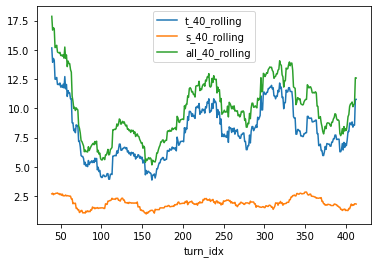

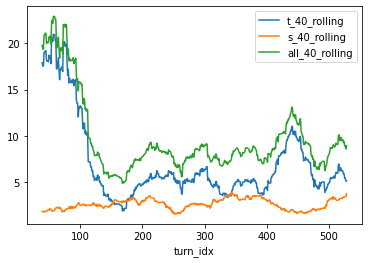

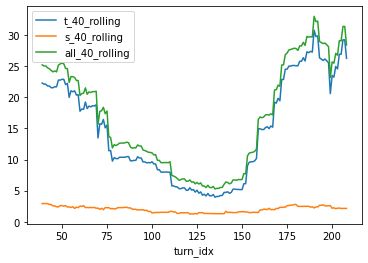

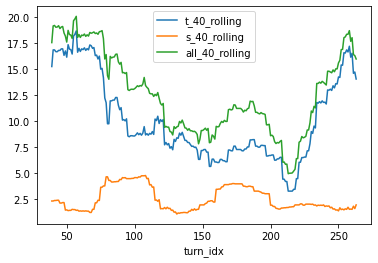

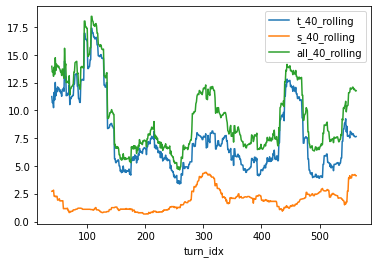

...

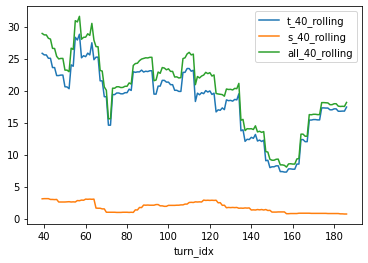

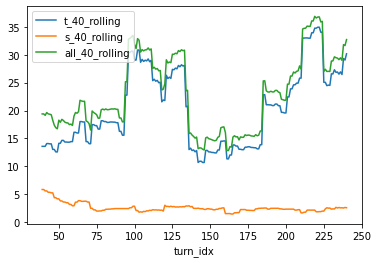

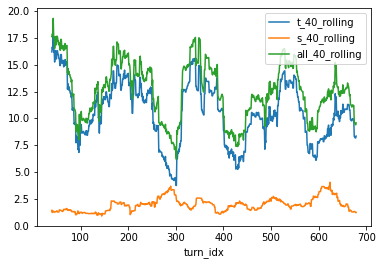

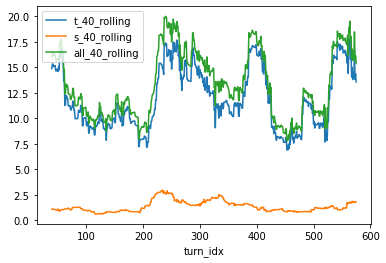

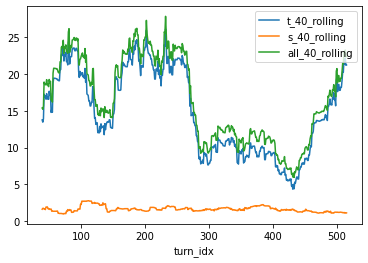

In [ ]:
n = 100
top = v.sort_values(by = 'score',ascending=False).OBSID.iloc[:n].unique()
bottom = v.sort_values(by = 'score',ascending=False).OBSID.iloc[-n:].unique()

OBs = df.OBSID.sample(50)
OBs = top
# df.t_words.rolling(7).mean()
for ob in OBs:
  df[df.OBSID == ob].plot.line(x = "turn_idx", y = ["t_40_rolling","s_40_rolling","all_40_rolling"])
  # df[df.OBSID == ob].plot.line(x = "turn_idx", y = ['tt_cum_ratio', 'st_cum_ratio'])

/usr/local/lib/python3.8/dist-packages/pandas/plotting/_matplotlib/core.py:345: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/usr/local/lib/python3.8/dist-packages/pandas/plotting/_matplotlib/core.py:345: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/usr/local/lib/python3.8/dist-packages/pandas/plotting/_matplotlib/core.py:345: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) a

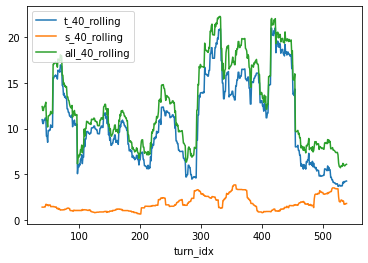

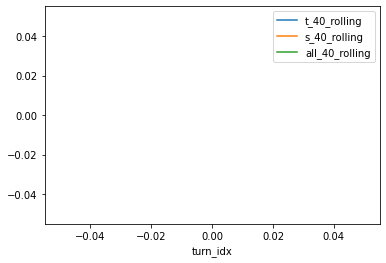

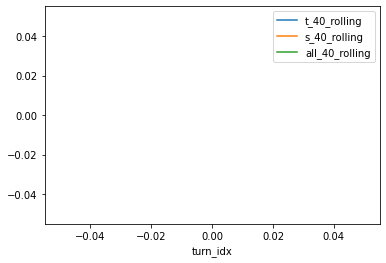

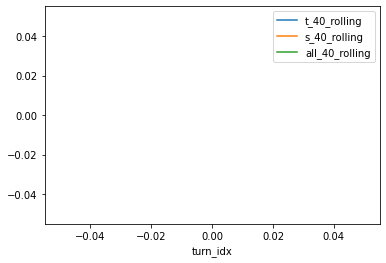

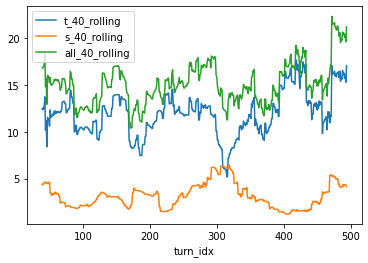

...

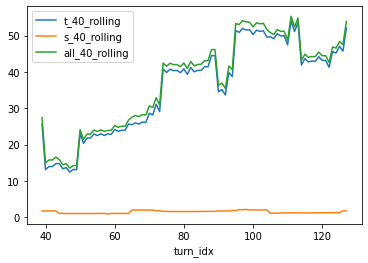

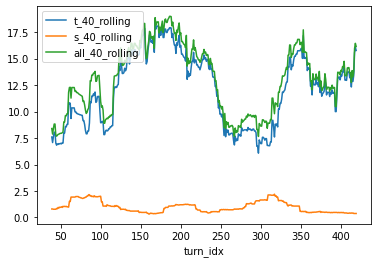

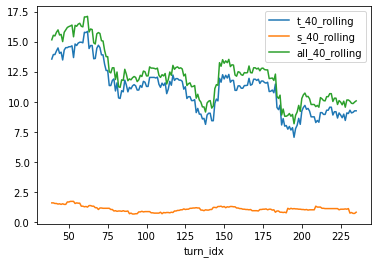

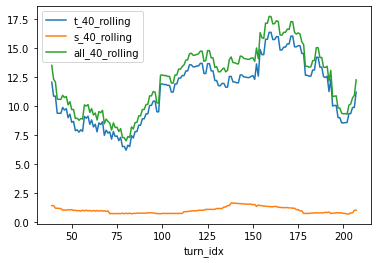

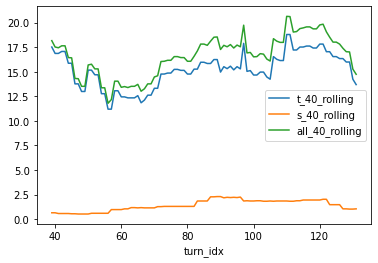

In [ ]:
n = 100
top = v.sort_values(by = 'score',ascending=False).OBSID.iloc[:n].unique()
bottom = v.sort_values(by = 'score',ascending=False).OBSID.iloc[-n:].unique()

OBs = df.OBSID.sample(50)
OBs = bottom

for ob in OBs:
  df[df.OBSID == ob].plot.line(x = "turn_idx", y = ["t_40_rolling","s_40_rolling","all_40_rolling"])
  # df[df.OBSID == ob].plot.line(x = "turn_idx", y = ['tt_cum_ratio', 'st_cum_ratio'])

/usr/local/lib/python3.8/dist-packages/pandas/plotting/_matplotlib/core.py:345: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/usr/local/lib/python3.8/dist-packages/pandas/plotting/_matplotlib/core.py:345: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/usr/local/lib/python3.8/dist-packages/pandas/plotting/_matplotlib/core.py:345: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) a

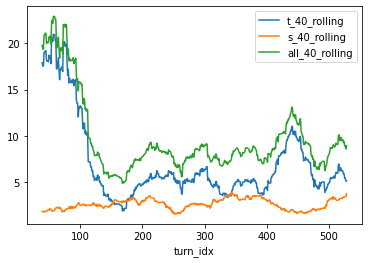

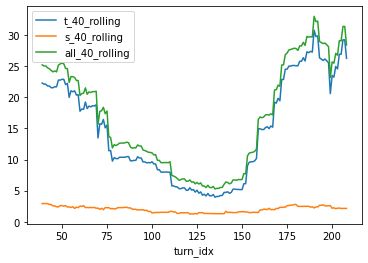

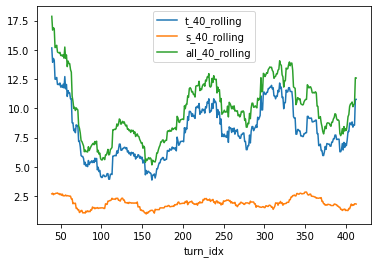

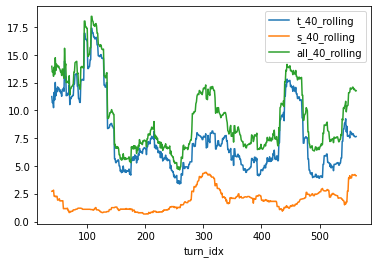

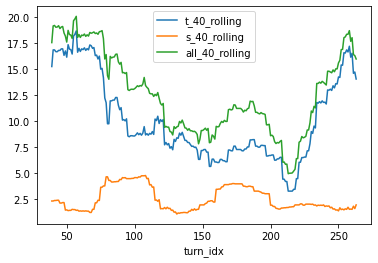

...

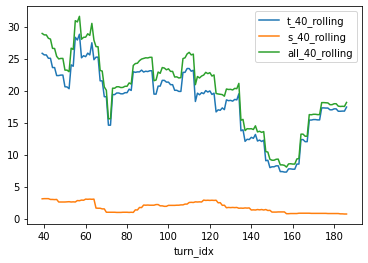

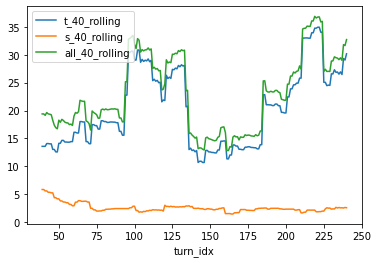

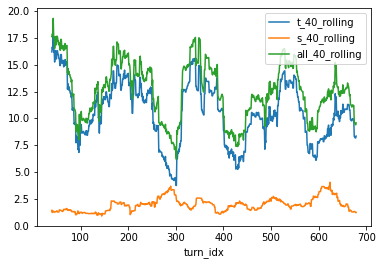

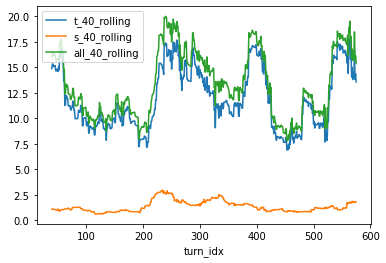

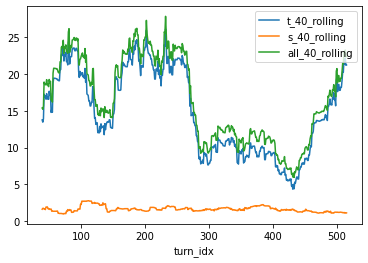

In [ ]:
n = 100
ts = v[v.va_type == "STA"].sort_values(by = 'score',ascending=False).OBSID.iloc[:n].unique()
bs = v[v.va_type == "STA"].sort_values(by = 'score',ascending=False).OBSID.iloc[-n:].unique()

ta = v[v.va_type == "ALT"].sort_values(by = 'score',ascending=False).OBSID.iloc[:n].unique()
ba = v[v.va_type == "ALT"].sort_values(by = 'score',ascending=False).OBSID.iloc[-n:].unique()

OBs = df.OBSID.sample(50)
OBs = ts
# df.t_words.rolling(7).mean()
for ob in OBs:
  df[df.OBSID == ob].plot.line(x = "turn_idx", y = ["t_40_rolling","s_40_rolling","all_40_rolling"])

# print('*'*500)
# print('ALT')
# print('*'*500)
# OBs = ta
# for ob in OBs:
#   df[df.OBSID == ob].plot.line(x = "turn_idx", y = ["t_40_rolling","s_40_rolling","all_40_rolling"])

In [ ]:
len(bs)

28

In [ ]:
n = 100
top = v.sort_values(by = 'score',ascending=False).OBSID.iloc[:n].unique()
bottom = v.sort_values(by = 'score',ascending=False).OBSID.iloc[-n:].unique()

OBs = df.OBSID.sample(50)
OBs = top
# df.t_words.rolling(7).mean()
for ob in OBs:
  df[df.OBSID == ob].plot.line(x = "turn_idx", y = ["t_40_rolling","s_40_rolling","all_40_rolling"])
  # df[df.OBSID == ob].plot.line(x = "turn_idx", y = ['tt_cum_ratio', 'st_cum_ratio'])

### Sanity checks on Individual Teachers

########################################################################################################################################################################################################
NID: 11067
********************************************************************************************************************************************************************************************************
NID: 2011
********************************************************************************************************************************************************************************************************
NID: 2012
1. obs 2299 in yr 2012


/usr/local/lib/python3.9/dist-packages/pandas/core/frame.py:3678: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[col] = igetitem(value, i)


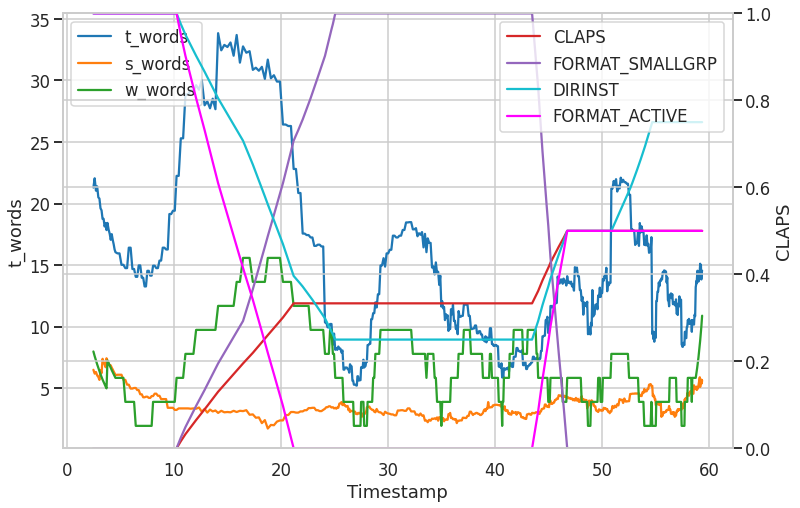

2. obs 2585 in yr 2012


/usr/local/lib/python3.9/dist-packages/pandas/core/frame.py:3678: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[col] = igetitem(value, i)


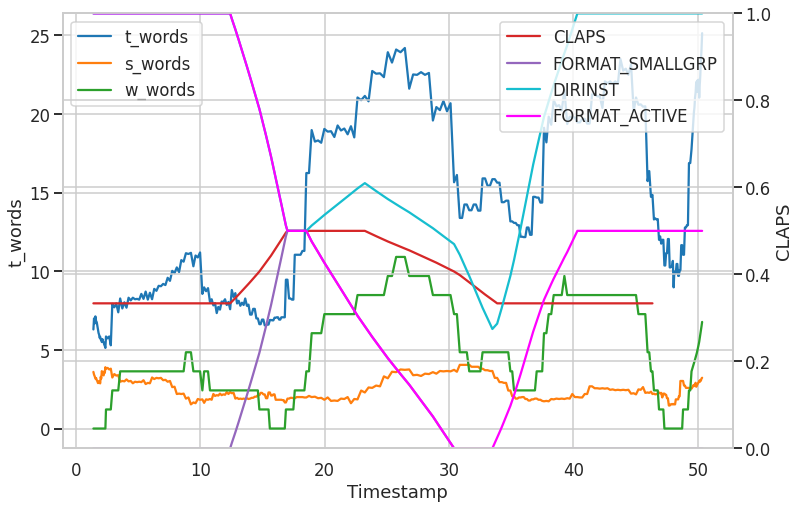

3. obs 2851 in yr 2012


/usr/local/lib/python3.9/dist-packages/pandas/core/frame.py:3678: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[col] = igetitem(value, i)


KeyError: ignored

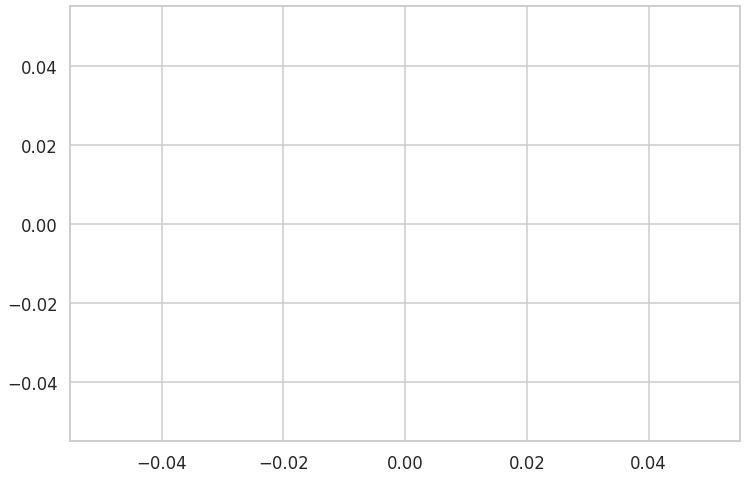

In [ ]:
n = 100
ts = v[v.va_type == "STA"].sort_values(by = 'score',ascending=False).OBSID.iloc[:n].unique()
bs = v[v.va_type == "STA"].sort_values(by = 'score',ascending=False).OBSID.iloc[-n:].unique()

ta = v[v.va_type == "ALT"].sort_values(by = 'score',ascending=False).OBSID.iloc[:n].unique()
ba = v[v.va_type == "ALT"].sort_values(by = 'score',ascending=False).OBSID.iloc[-n:].unique()

OBs = df.OBSID.sample(50)
OBs = ts

NID = [11035,11067,11068,12009,13081,14035,14038] # either year's SE
NID = [11067,11068,13081,14035,14038] # preceding year's SE
# NID = [12015,13040,14053] # on the alt exam
# NID = [14103] # Consistently > 0.2 all 3 years ##TODO LOOK AT THIS ONE

# NID = [14030] ## above SE all three ALT
# NID = []


# NID = [13081,14035,14038]

for nid in NID:
  print("#"*200)
  print(f"NID: {nid}")
  for y in [2011,2012,2013]:
    print("*"*200)
    print(f"NID: {y}")
    OBs = classdf[(classdf.SCHOOLYEAR_SP == y) & (classdf.NCTETID ==nid)].OBSID.unique()
    for i,ob in enumerate(OBs):
      print(f"{i+1}. obs {ob} in yr {y}")
      # df[df.OBSID == ob].plot.line(x = "turn_idx", y = ["t_40_rolling","s_40_rolling"])
      make_class_heartbeat(ob, second_axis_vars=['CLAPS','FORMAT_SMALLGRP','DIRINST','FORMAT_ACTIVE'], xinrolling=True, window = 40)
  break


########################################################################################################################################################################################################
NID: 12015
********************************************************************************************************************************************************************************************************
NID: 2011
obs 0 in yr 2011
obs 1 in yr 2011
obs 2 in yr 2011
********************************************************************************************************************************************************************************************************
NID: 2012
obs 0 in yr 2012
obs 1 in yr 2012
obs 2 in yr 2012
********************************************************************************************************************************************************************************************************
NID: 2013
obs 0 in yr 2013
obs 1 in yr 2013
obs 2 in yr 2013


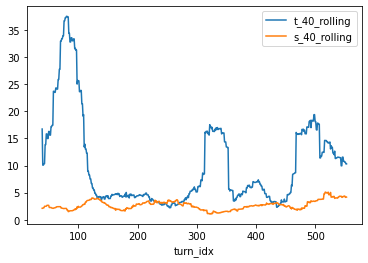

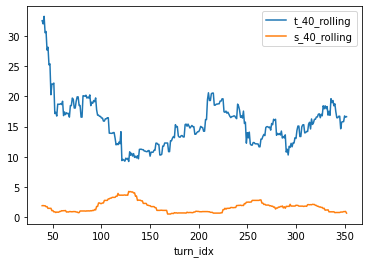

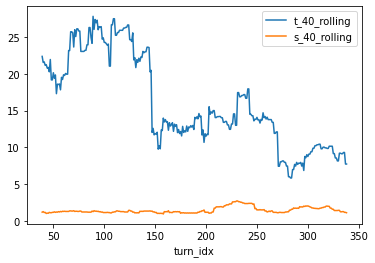

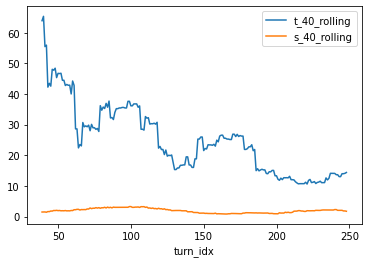

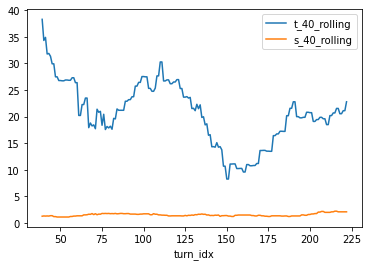

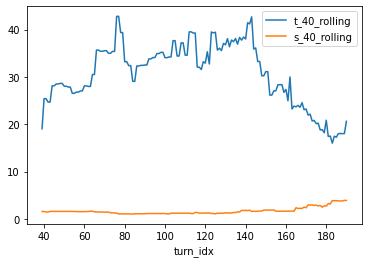

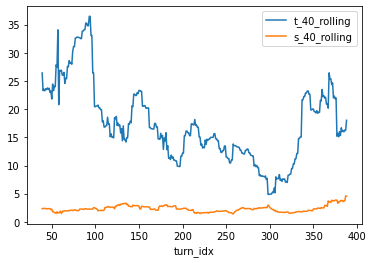

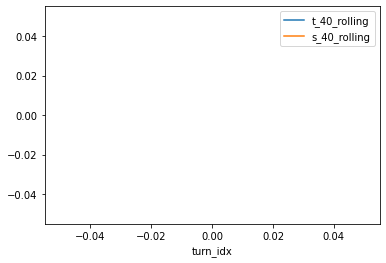

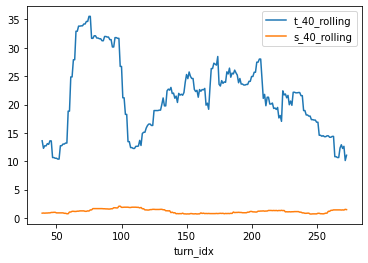

In [ ]:
NID = [14035,14038]
NID = [11035,11067,11068,12009,13081,14035,14038] # either year's SE
NID = [11067,11068,13081,14035,14038] # preceding year's SE
NID = [12015,13040,14053] # on the alt exam



for nid in NID:
  print("#"*200)
  print(f"NID: {nid}")
  for y in [2011,2012,2013]:
    print("*"*200)
    print(f"NID: {y}")
    OBs = classdf[(classdf.SCHOOLYEAR_SP == y) & (classdf.NCTETID ==nid)].OBSID.unique()
    for i,ob in enumerate(OBs):
      print(f"{i+1}. obs {ob} in yr {y}")
      df[df.OBSID == ob].plot.line(x = "turn_idx", y = ["t_40_rolling","s_40_rolling"])
  break

#### Checking Worktime Markers

########################################################################################################################################################################################################
NID: 14103
********************************************************************************************************************************************************************************************************
Year: 2011
********************************************************************************************************************************************************************************************************
Year: 2012
1. obs 2046 in yr 2012
2. obs 2219 in yr 2012
3. obs 2767 in yr 2012


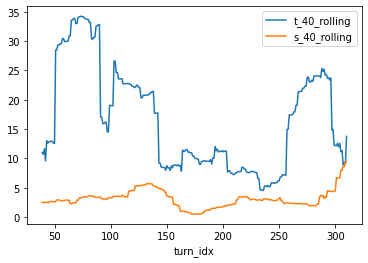

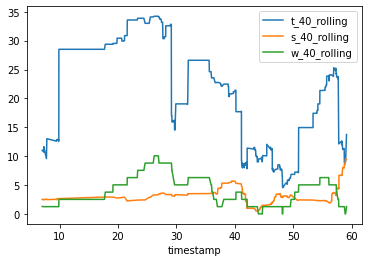

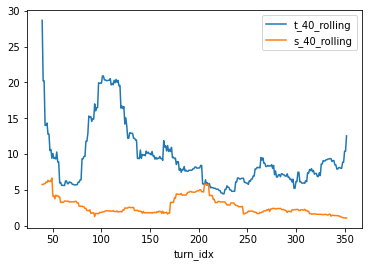

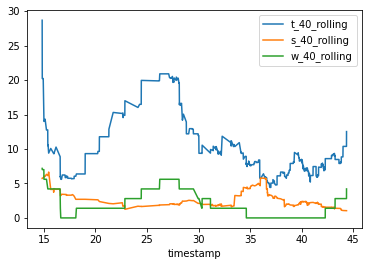

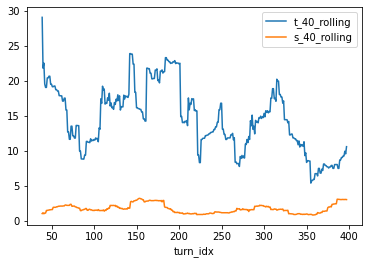

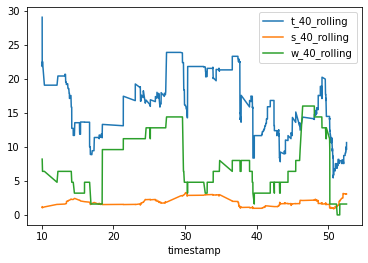

In [ ]:
n = 100
ts = v[v.va_type == "STA"].sort_values(by = 'score',ascending=False).OBSID.iloc[:n].unique()
bs = v[v.va_type == "STA"].sort_values(by = 'score',ascending=False).OBSID.iloc[-n:].unique()

ta = v[v.va_type == "ALT"].sort_values(by = 'score',ascending=False).OBSID.iloc[:n].unique()
ba = v[v.va_type == "ALT"].sort_values(by = 'score',ascending=False).OBSID.iloc[-n:].unique()

OBS = df.OBSID.sample(50)
OBS = ts

NID = [11035,11067,11068,12009,13081,14035,14038] # either year's SE
NID = [11067,11068,13081,14035,14038] # preceding year's SE
NID = [12015,13040,14053] # on the alt exam
NID = [14103] # Consistently > 0.2 all 3 years ##TODO LOOK AT THIS ONE

# NID = [11001]
# OBS = [33]

# NID = [14030] ## above SE all three ALT
# NID = []


# NID = [13081,14035,14038]

for nid in NID:
  print("#"*200)
  print(f"NID: {nid}")
  for y in [2011,2012]:
    print("*"*200)
    print(f"Year: {y}")
    OBS = classdf[(classdf.SCHOOLYEAR_SP == y) & (classdf.NCTETID ==nid)].OBSID.unique()
    for i,ob in enumerate(OBS):
      print(f"{i+1}. obs {ob} in yr {y}")
      df[df.OBSID == ob].plot.line(x = "turn_idx", y = ["t_40_rolling","s_40_rolling"])
      df[df.OBSID == ob].plot.line(x = "timestamp", y = ["t_40_rolling","s_40_rolling","w_40_rolling"])
  break


In [ ]:
print("\n".join(df[df.OBSID == 33].speaker + ":" + df[df.OBSID == 33].text))

teacher:Okay, so we have been working with mostly these larger numbers, and so today we are going to aim to solve this final problem, 13 x 8.  How we’re going to do that is we’re going to work in clusters.  So clusters are a few sets of number equations that are related, but they’re not really related to each other.  Because is 3 x 8 related to 13 x 4?
student:No.
teacher:Not really.  But both of these equations are related to our final problem.  You are going to be solving multiplication clusters after we do this activity.  So we’re going to do it together as a class with this example, then you’re going to go back to your seats or your groups, your partners, and you’re going to work together to solve your own sets, and then you’re going to make a poster.  So that’s the whole big picture.  And we’re going to figure out how to solve this equation. What’s 13 x 2, Student M?
student:26.
teacher:13 x 4? Student K?
student:52.
teacher:3 x 8, Student K or A?
student:24.
teacher:What’s a way 

In [ ]:
df[df.OBSID == 33].scoreSTA

530519   -0.108979
530520   -0.108979
530521   -0.108979
530522   -0.108979
530523   -0.108979
            ...   
530676   -0.108979
530677   -0.108979
530678   -0.108979
530679   -0.108979
530680   -0.108979
Name: scoreSTA, Length: 162, dtype: float64

## MQI and CLASS breakdowns

In [ ]:
for c in v.filter(regex="^C").columns:
  print(v[v.score > 0.2][c].value_counts()/v[v.score > 0.2][c].count())
  print(v[v.score < -0.2][c].value_counts()/v[v.score < -0.2][c].count())

(1) Yes    0.921569
(0) No     0.078431
Name: CLASS_11, dtype: float64
(1) Yes    0.829227
(0) No     0.170773
Name: CLASS_11, dtype: float64
(1) Yes    0.868984
(0) No     0.131016
Name: CLASS_12, dtype: float64
(1) Yes    0.803738
(0) No     0.196262
Name: CLASS_12, dtype: float64
(0) No     0.508913
(1) Yes    0.491087
Name: CLASS_13, dtype: float64
(0) No     0.567545
(1) Yes    0.432455
Name: CLASS_13, dtype: float64
1.0    0.271836
2.0    0.271836
3.0    0.252228
4.0    0.171123
5.0    0.029412
6.0    0.003565
Name: CHAPNUM, dtype: float64
1.0    0.276975
2.0    0.272727
3.0    0.260833
4.0    0.162277
5.0    0.025489
6.0    0.001699
Name: CHAPNUM, dtype: float64
(5) Mid Range (5)     0.387792
(4) Mid Range (4)     0.245961
(6) High Range (6)    0.185817
(3) Mid Range (3)     0.104129
(7) High Range (7)    0.056553
(2) Low Range (2)     0.019749
(1) Low Range (1)     0.000000
Name: CLPC, dtype: float64
(5) Mid Range (5)     0.333618
(4) Mid Range (4)     0.254063
(6) High Range (

In [ ]:
v[v.score < -0.2].CLAPS.value_counts()/v[v.score < -0.2].CLAPS.count()

(3) Mid Range (3)     0.459760
(4) Mid Range (4)     0.203767
(2) Low Range (2)     0.160959
(5) Mid Range (5)     0.094178
(1) Low Range (1)     0.070205
(6) High Range (6)    0.011130
(7) High Range (7)    0.000000
Name: CLAPS, dtype: float64

In [ ]:
v.CLAPS.value_counts()/v.CLAPS.count()

(3) Mid Range (3)     0.468252
(4) Mid Range (4)     0.210432
(2) Low Range (2)     0.164408
(5) Mid Range (5)     0.089747
(1) Low Range (1)     0.054036
(6) High Range (6)    0.012614
(7) High Range (7)    0.000511
Name: CLAPS, dtype: float64

In [ ]:
v[v.OBSID.isin(v.sort_values(by = 'score',ascending=False).OBSID.iloc[:n].unique())].CLAPS.value_counts()

In [ ]:
v.OBSID.nunique()

1637

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7fc0eb0e1ac0>,
      dtype=object)

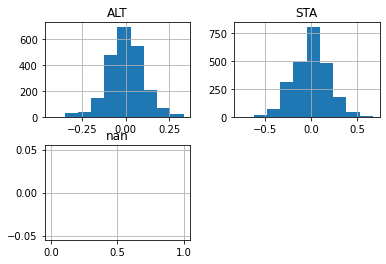

In [ ]:
va.score.hist()

In [ ]:
va.columns

MultiIndex([('NCTETID',    ''),
            (  'OBSID',    ''),
            ('id_year',    ''),
            (  'score', 'ALT'),
            (  'score', 'STA'),
            (  'score',   nan),
            ('scoreSE', 'ALT'),
            ('scoreSE', 'STA'),
            ('scoreSE',   nan),
            (   'year',    '')],
           names=[None, 'va_type'])

NCTETID OBSID    id_year     score             scoreSE            \
va_type                                 ALT       STA       ALT       STA   
0        11001.0   NaN   11001_12       NaN  0.001507       NaN  0.106415   
1        11001.0   NaN   11001_13       NaN -0.337306       NaN  0.108718   
2        11001.0   NaN  11001_avg -0.013656 -0.132015  0.107535  0.097312   
3        11002.0   NaN  11002_avg -0.060862 -0.141363  0.093326  0.104867   
4        11003.0   NaN   11003_11       NaN  0.177795       NaN  0.102084   
..           ...   ...        ...       ...       ...       ...       ...   
309      14132.0   0.0  14132_avg -0.042185 -0.188781  0.106712  0.087214   
310      14134.0   0.0  14134_avg  0.007259 -0.029637  0.106712  0.081039   
311      14136.0   0.0  14136_avg -0.052666 -0.047358  0.104782  0.110298   
312      14140.0   0.0  14140_avg -0.106090 -0.086104  0.106712  0.134734   
313      14141.0   0.0  14141_avg  0.014722  0.076910  0.109007  0.113289   

         year  
va_type        
0        12.0  
1        13.0  
2         0.0  
3         0.0  
4        11.0  
..        ...  
309       0.0  
310       0.0  
311       0.0  
312       0.0  
313       0.0  

[2501 rows x 8 columns]

In [ ]:
va.score.drop(index = 2, axis =0)

va_type,ALT,STA,NaN
0,NaN,0.001507,NaN
1,NaN,-0.337306,NaN
3,-0.060862,-0.141363,NaN
4,NaN,0.177795,NaN
5,0.037911,0.219373,NaN
...,...,...,...
309,-0.042185,-0.188781,NaN
310,0.007259,-0.029637,NaN
311,-0.052666,-0.047358,NaN
312,-0.106090,-0.086104,NaN


In [ ]:
va[va.scoreSE.iloc[:,2].notnull()]

Empty DataFrame
Columns: [(NCTETID, ), (OBSID, ), (id_year, ), (score, ALT), (score, STA), (score, nan), (scoreSE, ALT), (scoreSE, STA), (scoreSE, nan), (year, )]
Index: []

In [ ]:
pat = re.compile("^.{0,2}\[[Ii][Nn]audible\].{0,2}$")
df[df.text.apply(lambda x: bool(pat.search(x)))]

155     207
910     147
1013    143
4666    142
998     140
       ... 
4063      1
633       1
4004      1
4040      1
315       1
Name: OBSID, Length: 1583, dtype: int64

/usr/local/lib/python3.8/dist-packages/pandas/plotting/_matplotlib/core.py:345: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/usr/local/lib/python3.8/dist-packages/pandas/plotting/_matplotlib/core.py:345: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)
/usr/local/lib/python3.8/dist-packages/pandas/plotting/_matplotlib/core.py:345: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) a

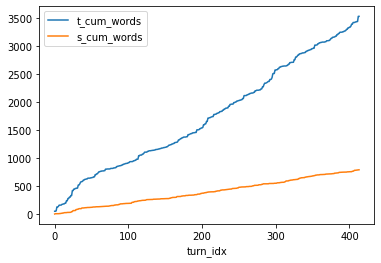

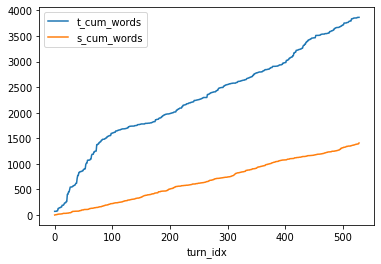

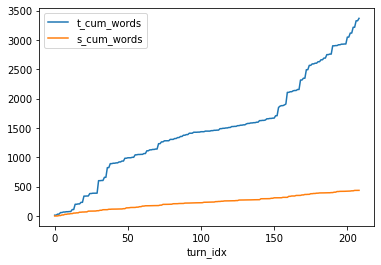

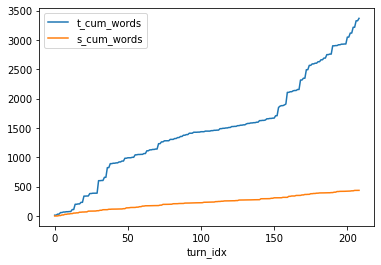

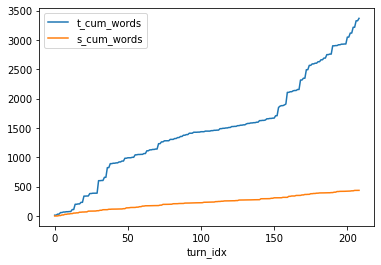

...

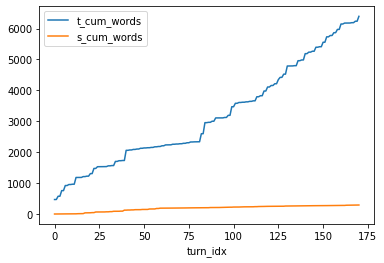

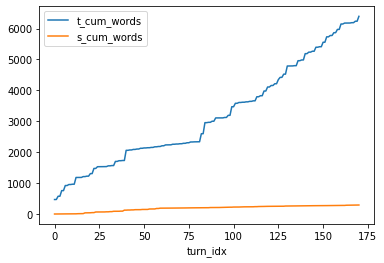

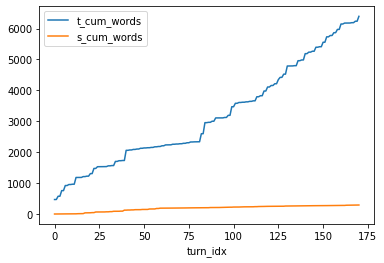

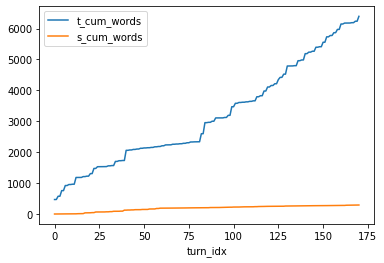

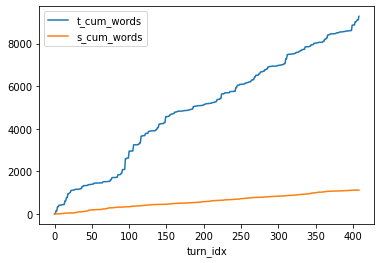

In [ ]:
OBs = df.OBSID.sample(50)
OBs = top.unique()
# df.t_words.rolling(7).mean()
for ob in OBs:
  df[df.OBSID == ob].plot.line(x = "turn_idx", y = ["t_cum_words","s_cum_words"])

In [ ]:
for c in vq.loc[:,'FORMAT_ACTIVE':].columns:
  print(vq[vq.score > 0.2][c].value_counts()/vq[vq.score > 0.2][c].count())
  print(vq[vq.score < -0.2][c].value_counts()/vq[vq.score < -0.2][c].count())

(0) No     0.542394
(1) Yes    0.457606
Name: FORMAT_ACTIVE, dtype: float64
(0) No     0.524049
(1) Yes    0.475951
Name: FORMAT_ACTIVE, dtype: float64
(0) No     0.664339
(1) Yes    0.335661
Name: FORMAT_BOTH, dtype: float64
(0) No     0.672123
(1) Yes    0.327877
Name: FORMAT_BOTH, dtype: float64
(0) No     0.793267
(1) Yes    0.206733
Name: FORMAT_SMALLGRP, dtype: float64
(0) No     0.803828
(1) Yes    0.196172
Name: FORMAT_SMALLGRP, dtype: float64
(3) Most/All    0.633982
(2) Some        0.302645
(1) None        0.063373
Name: DIRINST, dtype: float64
(3) Most/All    0.644763
(2) Some        0.289527
(1) None        0.065710
Name: DIRINST, dtype: float64
(1) None        0.749188
(3) Most/All    0.158631
(2) Some        0.092181
Name: APLPROB, dtype: float64
(1) None        0.751766
(3) Most/All    0.154894
(2) Some        0.093340
Name: APLPROB, dtype: float64
(1) Yes    0.959535
(0) No     0.040465
Name: CWCM, dtype: float64
(1) Yes    0.937842
(0) No     0.062158
Name: CWCM, dtype

In [ ]:
a1 = vq[vq.score > 0.2][c].value_counts()/vq[vq.score > 0.2][c].count()
a1 = vq[vq.score > 0.2][c].value_counts()/vq[vq.score > 0.2][c].count()
a1 = vq[vq.score > 0.2][c].value_counts()/vq[vq.score > 0.2][c].count()
aas =  vq[vq.score < -0.2][c].value_counts()/vq[vq.score < -0.2][c].count()
asdf

(0) Not Present    0.568182
(1) Present        0.431818
Name: WORLD, dtype: float64

In [ ]:
metrics = []
for c in vq.loc[:,'FORMAT_ACTIVE':].columns:
  a1 = vq[vq.score >= 0.2][c].value_counts()/vq[vq.score >= 0.2][c].count()
  a2 = vq[(vq.score >= 0.075) & (vq.score < 0.2)][c].value_counts()/vq[(vq.score >= 0.075) & (vq.score < 0.2)][c].count()
  a3 = vq[(vq.score < 0.075) & (vq.score >= -0.0725)][c].value_counts()/vq[(vq.score < 0.075) & (vq.score >= -0.0725)][c].count()
  a4 = vq[(vq.score >= -0.2) & (vq.score < -0.0725)][c].value_counts()/vq[(vq.score >= -0.2) & (vq.score < -0.0725)][c].count()
  a5 =  vq[vq.score < -0.2][c].value_counts()/vq[vq.score < -0.2][c].count()
  a = pd.merge(pd.DataFrame(a1),
         pd.DataFrame(a2),left_index = True, right_index=True,
         suffixes=("Q1","Q2")).merge(pd.DataFrame(a3),
                                     left_index = True, right_index=True,
                                     suffixes=("","Q3")).merge(pd.DataFrame(a4),
                                                               left_index = True, right_index=True,
                                                               suffixes=("","Q4")).merge(pd.DataFrame(a5),left_index = True, right_index=True, suffixes=("","Q5"))

  metrics.append(a.sort_index())

metrics

[         FORMAT_ACTIVEQ1  FORMAT_ACTIVEQ2  FORMAT_ACTIVE  FORMAT_ACTIVEQ4  \
 (0) No          0.542394         0.551268       0.537662         0.524893   
 (1) Yes         0.457606         0.448732       0.462338         0.475107   
 
          FORMAT_ACTIVEQ5  
 (0) No          0.524049  
 (1) Yes         0.475951  ,
          FORMAT_BOTHQ1  FORMAT_BOTHQ2  FORMAT_BOTH  FORMAT_BOTHQ4  \
 (0) No        0.664339       0.658298     0.660327       0.682152   
 (1) Yes       0.335661       0.341702     0.339673       0.317848   
 
          FORMAT_BOTHQ5  
 (0) No        0.672123  
 (1) Yes       0.327877  ,
          FORMAT_SMALLGRPQ1  FORMAT_SMALLGRPQ2  FORMAT_SMALLGRP  \
 (0) No            0.793267           0.790433         0.802011   
 (1) Yes           0.206733           0.209567         0.197989   
 
          FORMAT_SMALLGRPQ4  FORMAT_SMALLGRPQ5  
 (0) No            0.792955           0.803828  
 (1) Yes           0.207045           0.196172  ,
               DIRINSTQ1  DIRINSTQ2  

In [ ]:
metrics = []
for c in vq.loc[:,'FORMAT_ACTIVE':].columns:
  a1 = vq[vq.score >= 0.2][c].value_counts()
  a2 = vq[(vq.score >= 0.075) & (vq.score < 0.2)][c].value_counts()
  a3 = vq[(vq.score < 0.075) & (vq.score >= -0.0725)][c].value_counts()
  a4 = vq[(vq.score >= -0.2) & (vq.score < -0.0725)][c].value_counts()
  a5 =  vq[vq.score < -0.2][c].value_counts()
  a = pd.merge(pd.DataFrame(a1),
         pd.DataFrame(a2),left_index = True, right_index=True,
         suffixes=("Q1","Q2")).merge(pd.DataFrame(a3),
                                     left_index = True, right_index=True,
                                     suffixes=("","Q3")).merge(pd.DataFrame(a4),
                                                               left_index = True, right_index=True,
                                                               suffixes=("","Q4")).merge(pd.DataFrame(a5),left_index = True, right_index=True, suffixes=("","Q5"))

  metrics.append(a.sort_index())

metrics

[         FORMAT_ACTIVEQ1  FORMAT_ACTIVEQ2  FORMAT_ACTIVE  FORMAT_ACTIVEQ4  \
 (0) No              2175             4172           7859             3785   
 (1) Yes             1835             3396           6758             3426   
 
          FORMAT_ACTIVEQ5  
 (0) No              2081  
 (1) Yes             1890  ,
          FORMAT_BOTHQ1  FORMAT_BOTHQ2  FORMAT_BOTH  FORMAT_BOTHQ4  \
 (0) No            2664           4982         9652           4919   
 (1) Yes           1346           2586         4965           2292   
 
          FORMAT_BOTHQ5  
 (0) No            2669  
 (1) Yes           1302  ,
          FORMAT_SMALLGRPQ1  FORMAT_SMALLGRPQ2  FORMAT_SMALLGRP  \
 (0) No                3181               5982            11723   
 (1) Yes                829               1586             2894   
 
          FORMAT_SMALLGRPQ4  FORMAT_SMALLGRPQ5  
 (0) No                5718               3192  
 (1) Yes               1493                779  ,
               DIRINSTQ1  DIRINSTQ2  

In [ ]:
a.sort_index()

,WORLDQ1,WORLDQ2,WORLD,WORLDQ4,WORLDQ5
(0) Not Present,0.568182,0.646526,0.622951,0.61859,0.651899
(1) Present,0.431818,0.353474,0.377049,0.38141,0.348101


In [ ]:
vq.loc[:,'FORMAT_ACTIVE':]

,FORMAT_ACTIVE,FORMAT_BOTH,FORMAT_SMALLGRP,DIRINST,APLPROB,CWCM,WCDISS,LINK,EXPL,MMETH,...,TREMSTU,STUENG,CLMATINQ,LESSEFFIC,DENSMAT,LATASK,LESSCLEAR,TASKDEVMAT,ERRANN,WORLD
0,(1) Yes,(0) No,(0) No,(3) Most/All,(1) None,(1) Yes,(1) None,(3) High,(2) Mid,(3) High,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,(0) No,(1) Yes,(0) No,(3) Most/All,(1) None,(1) Yes,(1) None,(3) High,(2) Mid,(3) High,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,(0) No,(1) Yes,(0) No,(3) Most/All,(1) None,(1) Yes,(1) None,(2) Mid,(2) Mid,(2) Mid,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,(0) No,(0) No,(1) Yes,(2) Some,(1) None,(1) Yes,(1) None,(3) High,(2) Mid,(2) Mid,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,(0) No,(0) No,(1) Yes,(2) Some,(1) None,(1) Yes,(1) None,(2) Mid,(2) Mid,(2) Mid,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
54646,(1) Yes,(0) No,(0) No,(3) Most/All,(1) None,(1) Yes,(1) None,(1) Low,(1) Low,(1) Low,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
54647,(0) No,(1) Yes,(0) No,(3) Most/All,(1) None,(1) Yes,(1) None,(1) Low,(1) Low,(1) Low,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
54648,(0) No,(1) Yes,(0) No,(2) Some,(1) None,(1) Yes,(1) None,(1) Low,(1) Low,(1) Low,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
54649,(1) Yes,(0) No,(0) No,(3) Most/All,(1) None,(1) Yes,(1) None,(1) Low,(1) Low,(1) Low,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
mqi.groupby(by="OBSID").RATERID.nunique().value_counts()

2    1333
3     349
4      12
Name: RATERID, dtype: int64

In [ ]:
mqi.groupby(by="OBSID").RATERID.nunique()

In [ ]:
mqi.groupby(by="OBSID").SEGMENT.nunique().value_counts()

2    1694
Name: SEGMENT, dtype: int64

In [ ]:
mqi.columns

Index(['NCTETID', 'DISTRICT', 'MQI_11', 'MQI_12', 'MQI_13', 'OBSID', 'RATERID',
       'SEGMENT', 'SCHOOLYEAR_SP', 'OBSYEAR', 'OBSMONTH', 'OBSDAY', 'CHAPNUM',
       'FORMAT_ACTIVE', 'FORMAT_BOTH', 'FORMAT_SMALLGRP', 'DIRINST', 'APLPROB',
       'CWCM', 'WCDISS', 'LINK', 'EXPL', 'MMETH', 'MGEN', 'MLANG', 'ORICH',
       'ORICH4', 'REMED', 'USEPROD', 'MATCON', 'OWWS', 'OWWS4', 'MAJERR',
       'LANGIMP', 'LCP', 'OERR', 'OERR4', 'STEXPL', 'SMQR', 'ETCA', 'OSPMMR',
       'OSPMMR4', 'STUCON', 'STUCOM', 'SMALDIS', 'MMSM', 'ORIENT', 'SUMM',
       'MQI_CHECK', 'DIFFINST', 'LLC', 'MQI3', 'MKT3', 'MQI5', 'MKT5',
       'TSTUDEA', 'TREMSTU', 'STUENG', 'CLMATINQ', 'LESSEFFIC', 'DENSMAT',
       'LATASK', 'LESSCLEAR', 'TASKDEVMAT', 'ERRANN', 'WORLD', 'id_year'],
      dtype='object')

In [ ]:
# mqi.SEGMENT
# for c in v.filter(regex="^C").columns:
#   print(v[v.score > 0.2][c].value_counts()/v[v.score > 0.2][c].count())
#   print(v[v.score < -0.2][c].value_counts()/v[v.score < -0.2][c].count())

0        (1) Segment
1        (1) Segment
2        (1) Segment
3         (0) Lesson
4        (1) Segment
            ...     
28845    (1) Segment
28846    (1) Segment
28847    (1) Segment
28848    (1) Segment
28849     (0) Lesson
Name: SEGMENT, Length: 28850, dtype: category
Categories (2, object): ['(0) Lesson', '(1) Segment']

# Corpus Pre-processing Functions

In [ ]:
!pip install clean-text
!pip install unidecode
!pip install num2words
!pip install contractions

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
from num2words import num2words
from cleantext import clean
import contractions # for expanding contractions
import nltk
from nltk.tokenize.punkt import PunktSentenceTokenizer
sent_tokenizer = lambda s: PunktSentenceTokenizer().tokenize(s)

In [ ]:
replace_dict = {".":3,"?":3,"!?":1,"a":3,"A":3,"i":3,"num ":1}

pat = re.compile("[^ \t\n\r\f\va-zA-Z0-9_.]")
num_pat = re.compile("\d+,*\d*\.{0,1}\d*")


RE_NUMBER: Pattern = re.compile(
    r"(?:^|(?<=[^\w,.]))[+–-]?"
    r"(([1-9]\d{0,2}(,\d{3})+(\.\d*)?)|([1-9]\d{0,2}([ .]\d{3})+(,\d*)?)|(\d*?[.,]\d+)|\d+)"
    r"(?:$|(?=\b))"
)

symbols = ['&', '¼', ';', ',', 'ē', '–', '½', '%', '”', '>', "'", '}', '<', '+',
           'à', '?', '@', '°', '$', '—', '’', '“', '³', '`', '/', ']', '#', '(',
           '®', '−', ':', '…', '\xa0', '=', '-', '[', 'ĕ', '!', '‘', ')',
           'é', '{', '¾', '"', '\\']
c_symbols = {'°', 'ĕ', '¼', 'ē', '®', '½', '−', 'é', '¾', '³', 'à'}

syms = ['}']


preproc = textacy.preprocessing.make_pipeline(textacy.preprocessing.normalize.unicode,
                                              textacy.preprocessing.remove.accents,
                                              textacy.preprocessing.normalize.bullet_points,
                                              textacy.preprocessing.normalize.quotation_marks,
                                              textacy.preprocessing.normalize.whitespace,
                                              )
def process_spaces(story):
    return story.replace(
        ' ,', ',').replace(
        ' .', '.').replace(
        ' ?', '?').replace(
        ' !', '!').replace(
        ' ;', ';').replace(
        ' \'', '\'').replace(
        ' ’ ', '\'').replace(
        ' :', ':').replace(
        '<newline>', '\n').replace(
        '`` ', '"').replace(
        ' \'\'', '"').replace(
        '\'\'', '"').replace(
        '.. ', '... ').replace(
        ' )', ')').replace(
        '( ', '(').replace(
        ' n\'t', 'n\'t').replace(
        ' i ', ' I ').replace(
        ' i\'', ' I\'').replace(
        '\\\'', '\'').replace(
        '\n ', '\n').strip()


def repl_colons(text):
  # remove time stamps
  obs_timestamp_pat = re.compile('\[\d+:\d+:*\d*\]')
  #get ratios and time
  tim_pat = re.compile('[01]*\d+:[012345]\d')
  ratio_pat = re.compile('\d+:\d+')
  text = obs_timestamp_pat.sub("",text)
  if bool(ratio_pat.search(obs_timestamp_pat.sub("",text))) and not bool(tim_pat.search(obs_timestamp_pat.sub("",text))): text = text.replace(":"," to ")
  if bool(tim_pat.search(obs_timestamp_pat.sub("",text))): text = " ".join([num2words(x) for x in text.split(":")])
  return text


def symbol2word(text):
  symbol_dict = {"%":" percent","=":" is equal to ",">":" is greater than ",
                 "<":" is less than ","+":" plus ",'¼':" and one fourth",'½':" and one half",
                 '¾':" and three fourths",'°':" degrees",'³': " cubed",'#':"number ",
                 }
  words = text.replace("%"," percent").replace("="," is equal to ").replace(">"," is greater than ").replace("<"," is less than ").replace("+"," plus ")
  return words


def adj_num2words(numeric_text,to ='ordinal'):
  if numeric_text.strip()[0] == "$": return num2words(numeric_text[1:], to = "currency", currency = 'USD').replace(",","and")
  words = numeric_text.split(".")
  if len(words) == 1:
    return num2words(numeric_text, to ='ordinal')
  if len(words) == 2:
    whole = num2words(words[0])
    connector = " and " if int(words[0]) else ""
    decim = words[1]
    dec_base = " " + num2words(10**len(decim),to ='ordinal')
    dec_base = dec_base + "s" if int(words[1]) != 1 else dec_base
    return (whole + connector + num2words(words[1]) + dec_base).replace(",","").split(" ")[-1]
  else: return numeric_text

def prep(text):
  text = preproc(text).replace("{","[").replace("}","]")
  text = repl_colons(text)
  for k,v in replace_dict.items():
    text = textacy.preprocessing.normalize.repeating_chars(text, chars = k,maxn=v)
  return text

# print(set(pat.findall("\n".join(list(df.cleaned_text.apply(str))))))

def student_markers(text):
  spat = r"[Student] \w\W"
  return spat.sub("[student]",text)

# df[df.text.apply(lambda x: any([i in syms for i in x]))].text.values
math_pat = re.compile(' ?[0-9]+ ?[−+/=x<>-] ?\$?[0-9]+')
math_pat = re.compile(' ?[0-9]+ ?[−-] ?\$?[0-9]+')
math_pat = re.compile(' ?[0-9]+ ?[/] ?\$?[0-9]+')
math_pat = re.compile(' ?[0-9]+ ?over ?\$?[0-9]+')
math_pat = re.compile('')

# math_pat = re.compile(' *[0-9]+ ?[−+/=x<>-] ?\$?[0-9]+(?<! *odds)')
# df[df.text.apply(lambda x: bool(ratio_pat.search(obs_timestamp_pat.sub("",x))) and not bool(tim_pat.search(obs_timestamp_pat.sub("",x))))].text
# nums = df[df.text.apply(lambda x: bool(math_pat.search(textacy.preprocessing.normalize.whitespace(x))))].text
nums = df[df.text.apply(lambda x: bool(math_pat.search(x)))].text
print(nums.values)

['Friends, yesterday we started off by working on some word problems together, yes?'
 'Yes.'
 'And yesterday towards the end of the period, you got a word problem given to you that you had to draw a picture to show it, and you had to do the math problem to show it, yes?'
 ... 'What do you want to ask her if she has?' 'If she has 5, 1.'
 'So we would record it on here if she has it on here.']


# Extract Linguistic Features

## Collect Math terms

In [ ]:
find_some_math_words = ['equal','equiva', 'greater than', 'less than', 'estimat','expression',
                       'fraction','decimal','whole number', 'place value', 'quotient','product','addend',
                       'pemdas|pmdas|gemdas|gmdas', 'model', 'umber line','mixed number','formula',
                       ' graph','negative','number','divide','coordinates','subtract','rounded',
                       'operations','regroup','how many more','wholes','halves', 'solve','solution',
                      #  ' units?[^a-zA-Z0-9_]',
                       'interpret','classif', 'ratios ',' units','yards','polygon','minus',
                       'remainder', 'factor','numerator','denominator','word problem','propert',
                       'digit','volume','composite','acute','obtuse','protractor','grouping',
                       'strategy','algorithm',
                      #  '[ \t\n\r-]ax[ei]s',
                       ' angle','degree', 'perimeter', 'triangles','nearest','tiles','corresponding',
                       'square','length','cubes','median',' mean ','cubic','prism','centimeter',
                       'story problem',
                      #  '[−+/=x<>-×]',
                       'measure','distance','decompose','composi',' figure',
                       'rectang','multipl',
                       ] + [adj_num2words(str(x)) + 's' for x in list(range(3,9)) + [0.1, 0.01, 0.001]]

# + [num2words(str(x)).split(" ")[-1] + "s" for x in [10,100,1000]]
# '[ \t\n\r-]area', 'cubic',

pat = re.compile("|".join(find_some_math_words))

math_words = []
for t in tqdm(df.cleaned_text, total = len(df)):
  math_words.append(len(pat.findall(str(t).lower())))
  # print(pat.findall(str(t).lower()))
  # break

df['math_words'] = math_words
df['log_math_words'] = np.log(df['math_words'] + 1)

df['pct_math_words']= df['math_words'] / df.num_words
df['s_pct_math_words']= np.nan
df.loc[df.s_words >0,'s_pct_math_words']= df.loc[df.s_words >0,'math_words'] / df.loc[df.s_words >0,'s_words']
df['t_pct_math_words']= np.nan
df.loc[df.t_words >0,'t_pct_math_words'] = df.loc[df.t_words >0,'math_words'] / df.loc[df.t_words >0,'t_words']
df['s_math'] = 0
df['t_math'] =0


for n, group in df.groupby('OBSID'):
  df.loc[df.OBSID==n, 's_math'] = ((group.t != True) * group.math_words)
  df.loc[df.OBSID==n,'t_math'] = (group.t * group.math_words)

  0%|          | 0/1412729 [00:00<?, ?it/s]

In [ ]:
mdf = df.groupby('OBSID').sum('math_words').reset_index()
# mdf['density'] = mdf.math_words / mdf.
maxdf = df.groupby('OBSID').max().reset_index()

<ipython-input-121-6f63d2e1f78f>:3: FutureWarning: Dropping invalid columns in DataFrameGroupBy.max is deprecated. In a future version, a TypeError will be raised. Before calling .max, select only columns which should be valid for the function.
  maxdf = df.groupby('OBSID').max().reset_index()


In [ ]:
vo = v.groupby('OBSID').mean().reset_index()
vo

,OBSID,NCTETID,score,score.SE,year,SCHOOLYEAR_SP,RATERID_C,CHAPNUM,CLPC,CLNC,...,TREMSTU,STUENG,CLMATINQ,LESSEFFIC,DENSMAT,LATASK,LESSCLEAR,TASKDEVMAT,ERRANN,WORLD
0,3.0,11024.0,0.006185,0.116100,11.0,2011.0,7.0,4.500000,3.000000,0.00,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,4.0,11054.0,0.277847,0.105888,11.0,2011.0,14.0,4.764706,3.750000,0.50,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,5.0,11011.0,-0.443548,0.104932,11.0,2011.0,14.0,4.266667,2.733333,1.00,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,6.0,11063.0,0.037162,0.111369,11.0,2011.0,14.0,4.500000,4.000000,0.75,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,7.0,11050.0,0.314487,0.126882,11.0,2011.0,18.0,3.500000,2.666667,3.00,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1716,4758.0,12035.0,-0.255992,0.110886,13.0,2013.0,4.0,3.500000,3.000000,0.00,...,2.000000,2.000000,0.666667,2.000000,1.333333,2.000000,1.666667,1.666667,0.0,0.000000
1717,4759.0,13092.0,-0.190092,0.106158,13.0,2013.0,9.0,2.500000,2.000000,0.00,...,2.000000,3.000000,0.666667,2.666667,1.333333,1.333333,2.000000,1.333333,0.0,0.000000
1718,4760.0,12014.0,-0.193608,0.087623,13.0,2013.0,4.0,4.500000,3.000000,0.00,...,2.333333,3.333333,2.666667,3.000000,2.666667,2.000000,3.666667,2.333333,0.0,1.000000
1719,4762.0,12039.0,NaN,NaN,NaN,2013.0,9.0,2.857143,3.000000,0.50,...,1.666667,2.666667,2.333333,1.666667,2.000000,1.666667,2.666667,2.000000,0.0,0.000000


In [ ]:
odf = mdf

In [ ]:
odf['lsi_dense'] =  mdf.math_words / maxdf.cum_words

In [ ]:
# mdf.columns.tolist()

In [ ]:
odf = odf[['OBSID', 'math_words',
 'log_math_words',
 'pct_math_words',
 's_pct_math_words',
 't_pct_math_words',
 's_math',
 't_math',
 'CHAPNUM', 'scoreSTA',
 'scoreALT',
 'scoreSESTA',
 'scoreSEALT',
 'avgscoreSTA',
 'avgscoreALT',
 'avgscoreSESTA',
 'avgscoreSEALT',
 'lsi_dense']]

In [ ]:
odf = pd.merge(odf, vo, how='inner',left_on='OBSID',right_on='OBSID',suffixes =["_",""])

In [ ]:
maxdf.cum_words

,OBSID,text,year,video_id,num_words,turn_idx,comb_idx,t,cum_words,t_words,...,ERRANN,WORLD,math_words,log_math_words,pct_math_words,s_pct_math_words,t_pct_math_words,s_math,t_math,CHAPNUM
0,3,[inaudible] do anything on this?,1,329,257,249,3_99,1,4925,257,...,NaN,NaN,6,1.945910,0.250000,0.200000,0.250000,2,6,8.0
1,4,"‘Cause you did make it in half, but what did y...",1,327,211,464,4_99,1,8156,211,...,NaN,NaN,7,2.079442,0.666667,0.500000,0.666667,3,7,9.0
2,5,’Cause they know how to play.,1,326,193,590,5_99,1,6849,193,...,NaN,NaN,9,2.302585,1.000000,1.000000,0.500000,2,9,8.0
3,7,yes.,1,341,120,522,7_99,1,5859,120,...,NaN,NaN,7,2.079442,1.000000,1.000000,1.000000,4,7,6.0
4,8,’Cause you could say the bottom is?,1,350,204,467,8_99,1,6674,204,...,NaN,NaN,13,2.639057,0.500000,0.250000,0.500000,3,13,7.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1653,4758,[Side Conversation] Take out your math notebo...,3,428,322,126,4758_99,1,3013,322,...,NaN,NaN,14,2.708050,0.666667,0.666667,0.200000,7,14,6.0
1654,4759,[Throws dice].,3,537,90,410,4759_99,1,3055,90,...,NaN,NaN,6,1.945910,0.500000,0.500000,0.500000,3,6,4.0
1655,4760,"“Student D,” - this one’s a little more compli...",3,441,255,998,4760_998,1,8266,255,...,NaN,NaN,6,1.945910,1.000000,1.000000,1.000000,2,6,8.0
1656,4762,“‘B’ explain two ways that quadrilaterals are -,3,444,196,389,4762_99,1,4535,196,...,NaN,NaN,9,2.302585,0.500000,0.500000,0.333333,1,9,5.0


In [ ]:
odf = df.groupby('OBSID').sum('math_words')

In [ ]:
odf['lsi_dense'] =  mdf.math_words / maxdf.adj_cum_words

In [ ]:
odf = pd.merge(odf,densmat,how='inner',left_index = True, right_index = True, suffixes=["_",""])
odf

,year_,video_id,num_words,turn_idx,t,cum_words,t_words,s_words,t_cum_words,s_cum_words,...,TREMSTU,STUENG,CLMATINQ,LESSEFFIC,DENSMAT,LATASK,LESSCLEAR,TASKDEVMAT,ERRANN,WORLD
OBSID,,,,,,,,,,,,,,,,,,,,,
3.0,676,222404,39377,82131,544,1654899,38357,1020,1402280,252619,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4.0,1142,373434,63118,256691,909,4968744,62049,1069,4389405,579339,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5.0,1303,424778,39499,369815,988,4946335,38663,836,4464583,481752,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7.0,1062,362142,25781,276014,789,3200873,23781,2000,2428812,772061,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8.0,902,315700,30835,199688,653,3188170,29404,1431,2623246,564924,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4758.0,1401,199876,56735,36984,396,730187,56001,734,682656,47531,...,2.000000,2.000000,0.666667,2.000000,1.333333,2.000000,1.666667,1.666667,0.0,0.000000
4759.0,2271,406509,14156,146694,429,1265099,12303,1853,973837,291262,...,2.000000,3.000000,0.666667,2.666667,1.333333,1.333333,2.000000,1.333333,0.0,0.000000
4760.0,4695,690165,29669,776361,959,6561280,27344,2325,5288659,1272621,...,2.333333,3.333333,2.666667,3.000000,2.666667,2.000000,3.666667,2.333333,0.0,1.000000


In [ ]:
mod = smf.ols(formula='scoreSTA ~ lsi_dense', data=odf)
res = mod.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:               scoreSTA   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.001
Method:                 Least Squares   F-statistic:                   0.02803
Date:                Wed, 22 Mar 2023   Prob (F-statistic):              0.867
Time:                        00:04:33   Log-Likelihood:                -10920.
No. Observations:                1658   AIC:                         2.184e+04
Df Residuals:                    1656   BIC:                         2.185e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      3.3619      5.534      0.607      0.544      -7.493      14.217
lsi_dense      1.6818     10.045      0.167      0.867     -18.021      21.384
==============================================================================
Omnibus:                       50.648   Durbin-Watson:                   1.831
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              123.856
Skew:                          -0.070   Prob(JB):                     1.27e-27
Kurtosis:                       4.332   Cond. No.                         2.66
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [ ]:
mod = smf.ols(formula='scoreSTA ~ DENSMAT', data=odf)
res = mod.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:               scoreSTA   R-squared:                       0.008
Model:                            OLS   Adj. R-squared:                  0.005
Method:                 Least Squares   F-statistic:                     2.696
Date:                Wed, 22 Mar 2023   Prob (F-statistic):              0.102
Time:                        00:05:02   Log-Likelihood:                -2204.7
No. Observations:                 346   AIC:                             4413.
Df Residuals:                     344   BIC:                             4421.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept    -47.0743     23.890     -1.970      0.050     -94.063      -0.085
DENSMAT       20.0953     12.238      1.642      0.102      -3.976      44.167
==============================================================================
Omnibus:                       26.974   Durbin-Watson:                   1.876
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               37.797
Skew:                          -0.564   Prob(JB):                     6.20e-09
Kurtosis:                       4.162   Cond. No.                         7.58
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

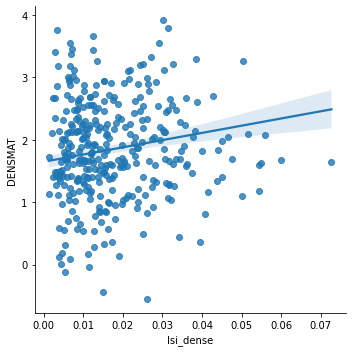

In [ ]:
sns.lmplot(data = odf, x = 'lsi_dense',y = 'DENSMAT',y_jitter=True)

In [ ]:
odf[['lsi_dense','DENSMAT']].corr()

,lsi_dense,DENSMAT
lsi_dense,1.000000,0.224773
DENSMAT,0.224773,1.000000


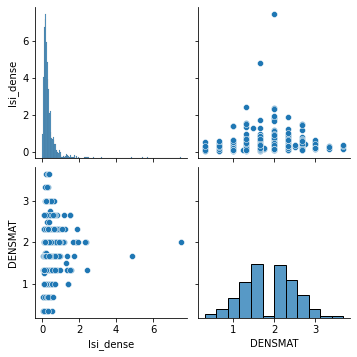

In [ ]:
sns.pairplot(data=odf[['lsi_dense','DENSMAT']])

In [ ]:
odf['DENSMAT'] = densmat.DENSMAT

In [ ]:
densmat

,NCTETID,score,score.SE,year,SCHOOLYEAR_SP,RATERID_C,CHAPNUM,CLPC,CLNC,CLTS,...,TREMSTU,STUENG,CLMATINQ,LESSEFFIC,DENSMAT,LATASK,LESSCLEAR,TASKDEVMAT,ERRANN,WORLD
OBSID,,,,,,,,,,,,,,,,,,,,,
3.0,11024.0,0.006185,0.116100,11.0,2011.0,7.0,4.500000,3.000000,0.00,3.250000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4.0,11054.0,0.277847,0.105888,11.0,2011.0,14.0,4.764706,3.750000,0.50,3.750000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5.0,11011.0,-0.443548,0.104932,11.0,2011.0,14.0,4.266667,2.733333,1.00,2.266667,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6.0,11063.0,0.037162,0.111369,11.0,2011.0,14.0,4.500000,4.000000,0.75,3.250000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7.0,11050.0,0.314487,0.126882,11.0,2011.0,18.0,3.500000,2.666667,3.00,3.000000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4758.0,12035.0,-0.255992,0.110886,13.0,2013.0,4.0,3.500000,3.000000,0.00,3.333333,...,2.000000,2.000000,0.666667,2.000000,1.333333,2.000000,1.666667,1.666667,0.0,0.000000
4759.0,13092.0,-0.190092,0.106158,13.0,2013.0,9.0,2.500000,2.000000,0.00,6.000000,...,2.000000,3.000000,0.666667,2.666667,1.333333,1.333333,2.000000,1.333333,0.0,0.000000
4760.0,12014.0,-0.193608,0.087623,13.0,2013.0,4.0,4.500000,3.000000,0.00,3.750000,...,2.333333,3.333333,2.666667,3.000000,2.666667,2.000000,3.666667,2.333333,0.0,1.000000


In [ ]:
odf = odf.reset_index()
odf['lsi_dense']  = lsi_dense
odf

,OBSID,DENSMAT,lsi_dense
0,3.0,NaN,0.119594
1,4.0,NaN,0.120525
2,5.0,NaN,0.102205
3,6.0,NaN,0.095238
4,7.0,NaN,0.142194
...,...,...,...
1716,4758.0,1.333333,NaN
1717,4759.0,1.333333,NaN
1718,4760.0,2.666667,NaN
1719,4762.0,2.000000,NaN


<Axes: >

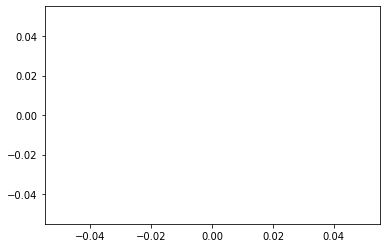

In [ ]:
sns.scatterplot(odf, x= 'lsi_dense',y='DENSMAT')

In [ ]:
densmat = v.groupby('OBSID').mean()

lsi_dense = mdf.math_words / maxdf.cum_words

sns.scatterplot(pd.DataFrame(lsi_dense,densmat))

In [ ]:
df.head(40)

,speaker,text,year,OBSID,video_id,cleaned_text,num_words,turn_idx,comb_idx,t,...,ERRANN,WORLD,math_words,log_math_words,pct_math_words,s_pct_math_words,t_pct_math_words,s_math,t_math,CHAPNUM
0,teacher,"Friends, yesterday we started off by working o...",2,2119,706,friends yesterday we started off by working on...,13,0,2119_0,1,...,NaN,NaN,1,0.693147,0.076923,NaN,0.076923,0,1,1.0
1,student,Yes.,2,2119,706,yes,1,1,2119_1,0,...,NaN,NaN,0,0.000000,0.000000,0.0,NaN,0,0,1.0
2,teacher,"And yesterday towards the end of the period, y...",2,2119,706,and yesterday towards the end of the period yo...,38,2,2119_2,1,...,NaN,NaN,1,0.693147,0.026316,NaN,0.026316,0,1,1.0
3,multiple students,Yes.,2,2119,706,yes,1,3,2119_3,0,...,NaN,NaN,0,0.000000,0.000000,0.0,NaN,0,0,1.0
4,teacher,Some of you might be done.,2,2119,706,some of you might be done if you are finished ...,106,4,2119_4,1,...,NaN,NaN,0,0.000000,0.000000,NaN,0.000000,0,0,1.0
4,teacher,"If you are finished, then you can just look ov...",2,2119,706,some of you might be done if you are finished ...,106,4,2119_4,1,...,NaN,NaN,0,0.000000,0.000000,NaN,0.000000,0,0,1.0
4,teacher,"And if you are not done, now is your time to g...",2,2119,706,some of you might be done if you are finished ...,106,4,2119_4,1,...,NaN,NaN,0,0.000000,0.000000,NaN,0.000000,0,0,1.0
4,teacher,I'm gonna set about ten minutes on my timer.,2,2119,706,some of you might be done if you are finished ...,106,4,2119_4,1,...,NaN,NaN,0,0.000000,0.000000,NaN,0.000000,0,0,1.0
4,teacher,"And if we need less time than that, then we wi...",2,2119,706,some of you might be done if you are finished ...,106,4,2119_4,1,...,NaN,NaN,0,0.000000,0.000000,NaN,0.000000,0,0,1.0
4,teacher,But I'm gonna give you at least ten minutes to...,2,2119,706,some of you might be done if you are finished ...,106,4,2119_4,1,...,NaN,NaN,0,0.000000,0.000000,NaN,0.000000,0,0,1.0


<AxesSubplot:>

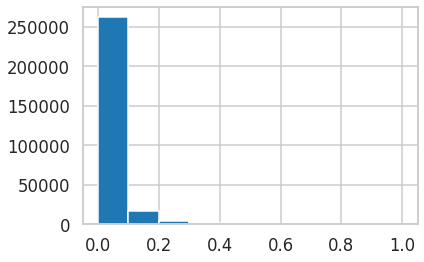

In [ ]:
df['t_pct_math_words'].hist()

In [ ]:
math_words = []
for t in tqdm(df.cleaned_text, total = len(df)):
  math_words.append(len(pat.findall(str(t).lower())))

  0%|          | 0/579979 [00:00<?, ?it/s]

In [ ]:
df['math_words'] = math_words
df['log_math_words'] = np.log(df['math_words'] + 1)

<Axes: >

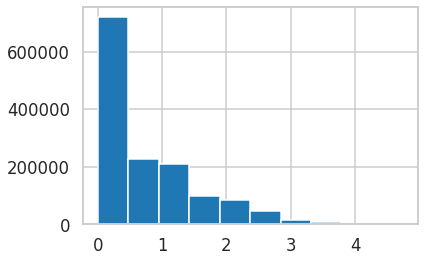

In [ ]:
(np.log(df['math_words'] + 1)).hist()

In [ ]:
pat = re.compile("^.{0,2}\[[Ii][Nn]audible\].{0,2}$")
df[df.text.apply(lambda x: bool(pat.search(x)))]

In [ ]:
## It appears that number of words are lost as cleaning happens. About one per every other turn.
pat = re.compile('(?=\d)')
(df.text.apply(lambda x: len(pat.sub(" ",str(x)).strip().replace("  "," ").split(" "))) - df.cleaned_text.apply(lambda x: len(pat.sub(" ",str(x)).strip().replace("  "," ").split(" ")))).mean()



-0.5398047580322808

In [ ]:
asdf = '2. Destroyer 34.5 you’re gonna label it D'
pat = re.compile('(?=\d)')
pat.sub(" ",asdf)

' 2. Destroyer  3 4. 5 you’re gonna label it D'

In [ ]:
df[df.OBSID == 4133].speaker + "_"

In [ ]:
tjuxt = []
sjuxt = []
prv = 0
prt = 0
tlongest = 0
slongest = 0
tcurr = 0
scurr = 0
t_long_obs = 0
s_long_obs = 0
for i,row in df.iterrows():
  if prt == row.OBSID and not row.OBSID.isin([219,308,2959]):  ##219 and 308 have a lot of missing student ['inaudible'] or failed choral calls
    if row.t:
      scurr = 0
      if prv == row.t:
        tjuxt.append(i)
        tcurr +=1
    else:
      tcurr = 0
      if prv == row.t:
        sjuxt.append(i)
        scurr +=1
  if tcurr > tlongest:
    tlongest = tcurr
    t_long_obs = row.OBSID
  if scurr > slongest:
    slongest = scurr
    s_long_obs = row.OBSID
  prv= row.t
  prt= row.OBSID

print(f"len:{len(tjuxt)}, longest:{tlongest}, OBS:{t_long_obs}")
print(f"len:{len(sjuxt)}, longest:{slongest},OBS:{s_long_obs}")

len:20781, longest:25, OBS:2143
len:29110, longest:37,OBS:459


In [ ]:
len(tjuxt)/sum(df.t)

0.07323746078496376

In [ ]:
df.OBSID.nunique()

1658

In [ ]:
df[(df.OBSID == 2065 )& (df.t ==1)].text.iloc[0]

'Student E, you can put it in your math folder, if you’re finished.  Sounds like an elephant.'

In [ ]:
print("\n".join(list(df[df.OBSID == 4133].speaker.apply(str) + ": " + df[df.OBSID == 4133].text)))

teacher: Don’t get up as long as we’re doing this.  Just sit right there.  If you finish the test, you can click finish, if you get through, after you’ve gone through everything on here.  Then you can go to something else, but don’t make any noise with it.  Don’t do anything.  Just sit here.  I’ll give you a book.  All right.  Okay.  This afternoon boys and girls I’d like you to open your Little House in the Big Woods book to page 78.  We have been reading about the different adventures Laura has had, and today we’re going to be looking at a passage on page 178 of an event that takes place when the neighbors finally come to the big woods.  Now remember they haven’t had any, and all of the sudden they have some people that have moved down the road.  Beginning back on page 177, it says, “Sometimes Ma let’s Laura and me go across the road and down the hill to see Ms. Peterson.”  Ms. Peterson’s family is the one that just recently moved into the big woods.  The Petersons had just moved in.

In [ ]:
print("\n".join(list(df[df.OBSID == 459].speaker.apply(str) + ": " + df[df.OBSID == 459].text)))

teacher: Okay.  Good morning boys and girls.
multiple students: Good morning Mrs. G.
teacher: We've been working really hard on our new unit, and we've done our fractions.  We've done our decimals, and now we're starting our new big umbrella topic, and what is it?
student: Geometry.
teacher: Which is the study of shapes.  Before we get into our new geometry lesson, we're going to go back to calendar math, and a walk in the park, and buzz, our morning routines, and then we'll see how much fun we can have today.  First of all, today is what date Student L?
student: The 2nd.
teacher: The 2nd of—
student: March.
teacher: And it happens to be Student L's birthday.  Say Happy Birthday Student L.
multiple students: Happy Birthday Student L.
teacher: We'll sing to her later today, and we look forward to that. Okay.  March 2nd.  We need our student number two to come up to the calendar which is Student E.  Okay.  So yesterday was March 1st and we had a number on the top bigger than the number o

In [ ]:
print("\n".join(list(df[df.OBSID == 2959].speaker.apply(str) + ": " + df[df.OBSID == 2959].text)))


teacher: Then that will be your purpose when you create your script.  In
student: Are we going to be able to choose our groups or are you going to choose our groups for us?
teacher: I’m going to choose your groups.  They have already been chosen.  Again, we’ll go over all of that just a little bit later.  The important thing is you know what to do when you create your script.  How many of you created your script last year in third grade?  So everyone has?  So you’re familiar with doing this and I get that from what I see in your performance at the D.C. Theater Café.  Okay.  So take about two minutes. Pull out your scripts and I think yes, we have a script for you.  Once you have your script out, then look it over.  Have a seat, Student A.  That wasn’t too smart.  If you are going to get your script, then you can get it.  If you have it in your desk, pull it out.  Yes, Student L?
student: [Inaudible].
teacher: Excuse me?  Yes.  It’s a phrase people have used.  I’m going to give it to yo

In [ ]:
v[v.OBSID == 2065].score.iloc[0]

v[(v.OBSID == 459) & (v.va_type == "STA")].describe()



,NCTETID_x,score,score.SE,year,NCTETID_y,DISTRICT,SCHOOLYEAR_SP,OBSID,RATERID,OBSYEAR,OBSMONTH,OBSDAY,CHAPNUM
count,4.0,4.000000,4.000000,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.000000
mean,14038.0,-0.193988,0.108166,11.0,14038.0,14.0,2011.0,459.0,19.0,2011.0,3.0,2.0,2.500000
std,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.290994
min,14038.0,-0.193988,0.108166,11.0,14038.0,14.0,2011.0,459.0,19.0,2011.0,3.0,2.0,1.000000
25%,14038.0,-0.193988,0.108166,11.0,14038.0,14.0,2011.0,459.0,19.0,2011.0,3.0,2.0,1.750000
50%,14038.0,-0.193988,0.108166,11.0,14038.0,14.0,2011.0,459.0,19.0,2011.0,3.0,2.0,2.500000
75%,14038.0,-0.193988,0.108166,11.0,14038.0,14.0,2011.0,459.0,19.0,2011.0,3.0,2.0,3.250000
max,14038.0,-0.193988,0.108166,11.0,14038.0,14.0,2011.0,459.0,19.0,2011.0,3.0,2.0,4.000000


In [ ]:
v[v.OBSID == 459].score

3466   -0.193988
3467   -0.193988
3468   -0.193988
3469   -0.193988
3478   -0.152167
3479   -0.152167
3480   -0.152167
3481   -0.152167
Name: score, dtype: float64

## Transcriber Adjustments

###  Checking Use of a number's word (e.g., "two") vs it's symbol (e.g., "2") in transcript

In [ ]:
## bottom vs denominator
# top vs numerator
#
mat_pats = [re.compile(' ?[Zz]ero[ .]{1,2}'),re.compile(' {1,2}0[ .]{1,2}(?!<\d)'),
            re.compile(' ?[Oo]ne[ .]{1,2}'),re.compile(' {1,2}1[ .]{1,2}(?!<\d)'),
            re.compile(' ?[Tt]wo[ .]{1,2}'),re.compile(' {1,2}2[ .]{1,2}(?!<\d)'),
            re.compile(' ?[Tt]hree[ .]{1,2}'),re.compile(' {1,2}3[ .]{1,2}(?!<\d)'),
            re.compile(' ?[Ff]our[ .]{1,2}'),re.compile(' {1,2}4[ .]{1,2}(?!<\d)'),
            re.compile(' ?[Ff]ive[ .]{1,2}'),re.compile(' {1,2}5[ .]{1,2}(?!<\d)'),
            re.compile(' ?[Ss]ix[ .]{1,2}'),re.compile(' {1,2}6[ .]{1,2}(?!<\d)'),
            re.compile(' ?[Ss]even[ .]{1,2}'),re.compile(' {1,2}7[ .]{1,2}(?!<\d)'),
            re.compile(' ?[Ee]ight[ .]{1,2}'),re.compile(' {1,2}8[ .]{1,2}(?!<\d)'),
            re.compile(' ?[Nn]ine[ .]{1,2}'), re.compile(' {1,2}9[ .]{1,2}(?!<\d)')]

for i, m in enumerate(mat_pats):
  print(f'Number {i//2}: {len(df[df.text.apply(lambda x: bool(m.search(x)))].text.values)}')
  # print(f'Number {i//2}: {len(df[df.text.apply(lambda x: bool(m.search(x)))].text.values)}')



Number 0: 6356
Number 0: 2108
Number 1: 68206
Number 1: 5834
Number 2: 33843
Number 2: 8217
Number 3: 23207
Number 3: 7937
Number 4: 18405
Number 4: 7790
Number 5: 15683
Number 5: 5762
Number 6: 11655
Number 6: 6139
Number 7: 6270
Number 7: 3085
Number 8: 10752
Number 8: 4717
Number 9: 4993
Number 9: 2875


In [ ]:
# Checking for fraction notations


mat_pats = [re.compile(' ?[Zz]ero[ .]{1,2}'),re.compile(' {1,2}0[ .]{1,2}(?!<\d)'),
            re.compile(' ?[Oo]ne[ .]{1,2}'),re.compile(' {1,2}1[ .]{1,2}(?!<\d)'),
            re.compile(' ?[Tt]wo[ .]{1,2}'),re.compile(' {1,2}2[ .]{1,2}(?!<\d)'),
            re.compile(' ?[Tt]hree[ .]{1,2}'),re.compile(' {1,2}3[ .]{1,2}(?!<\d)'),
            re.compile(' ?[Ff]our[ .]{1,2}'),re.compile(' {1,2}4[ .]{1,2}(?!<\d)'),
            re.compile(' ?[Ff]ive[ .]{1,2}'),re.compile(' {1,2}5[ .]{1,2}(?!<\d)'),
            re.compile(' ?[Ss]ix[ .]{1,2}'),re.compile(' {1,2}6[ .]{1,2}(?!<\d)'),
            re.compile(' ?[Ss]even[ .]{1,2}'),re.compile(' {1,2}7[ .]{1,2}(?!<\d)'),
            re.compile(' ?[Ee]ight[ .]{1,2}'),re.compile(' {1,2}8[ .]{1,2}(?!<\d)'),
            re.compile(' ?[Nn]ine[ .]{1,2}'), re.compile(' {1,2}9[ .]{1,2}(?!<\d)')]

mat_pats = [re.compile(' ?[/] ?[4]'), re.compile(' over 4{0,1}(four){0,1}'),
            re.compile(' over 4|(four)'),re.compile(' over 4'),re.compile(' over four'),
            re.compile('[ -]?fourths?')]

for i, m in enumerate(mat_pats):
  print(f'Number {i//2}: {len(df[df.text.apply(lambda x: bool(m.search(x)))].text.values)}')
  # print(f'Number {i//2}: {len(df[df.text.apply(lambda x: bool(m.search(x)))].text.values)}')



## relative requency of transcription "/" vs "over #" vs

# math_pat = re.compile(' ?[0-9]+ ?[/] ?\$?[0-9]+')
# math_pat = re.compile(' ?[0-9]+ ?over ?\$?[0-9]+')



Number 0: 224
Number 0: 13078
Number 1: 25274
Number 1: 110
Number 2: 98
Number 2: 8550


'four'

## Comparison of Transcription tendencies in words and ordinals

In [ ]:
find_all_math_words = ['equal','perimeter',' angle','degree', 'greater than', 'less than',
                       'pemdas|pmdas|gemdas|gmdas',
                       'order of operations','regroup','how many more','wholes','halves',
                       'remainder', 'factor','numerator','denominator','word problem',
                       'story problem', '[−+/=x<>-]',
                       ] + [f'[ -]{num2words(x,to="ordinal")}s')}} for x in list(range(3,9)) + [0.1, 0.01, 10,100,1000]]

#### Fractional Language

In [ ]:
NF_dict = {x:{'slash':{'pat':re.compile(f'[0-9 -]*[/] ?{x}\D'),},
                    'overnum':{'pat':re.compile(f'[ -]over {x}\D')},
                    'over':{'pat':re.compile(f'[ -]over {num2words(x)}')},
                    'ordinal':{'pat':re.compile(f'[ -]{num2words(x,to="ordinal")}s?')}} for x in list(range(1,11)) + [12,15,20,100,1000]}

NF_dict[1]['ordinal']['pat'] = re.compile('[ -]wholes?')
NF_dict[2]['ordinal']['pat'] = re.compile('[ -]halves|[ -]halfs')
NF_dict[100]['over']['pat'] = re.compile('[ -]over a hundred|[ -]over one[ -]hundred')
NF_dict[1000]['slash']['pat'] = re.compile(f'[0-9 -][/] ?1,?000\D')
NF_dict[1000]['overnum']['pat'] = re.compile(f'[ -]over ?1,?000\D')
NF_dict[1000]['over']['pat'] = re.compile('[ -]over a thousand|[ -]over one[ -]thousand')


# NBT_dict =

matlangdf = pd.DataFrame(columns = ['slash','over','overnum','ordinal'])

NF_dict
for n,style in NF_dict.items():
  for s,p in style.items():
    p['examples'] = df[df.text.apply(lambda x: bool(p['pat'].search(x)))][['speaker','text','OBSID','NCTETID','scoreSTA','scoreALT']]
    p['count'] = p['examples'].text.apply(lambda x: len(p['pat'].findall(x)))
    # print(f"{n} as {s}: {p['count']}")
  # matlangdf = pd.concat([matlangdf,pd.DataFrame({s:p['count'] for s, p in style.items()},index = [n])])


cols = ['speaker','text','OBSID','NCTETID','style','number','count','scoreSTA','scoreALT']
fraclangdf = pd.DataFrame(columns = cols)
for n,style in NF_dict.items():
  for s,p in style.items():
    new_df = p['examples']
    new_df['style'] = s
    new_df['number'] = n
    new_df['count'] = p['count']
    fraclangdf = pd.concat([fraclangdf,new_df])
fraclangdf= fraclangdf.reset_index()
fraclangdf.shape

(56704, 10)

In [ ]:
# NF_dict

In [ ]:
# reduced_dict = {i:{k:{m:[] for m,n in v.items()} for k,v in j.items()} for i,j in mat_lang_dict.items()}
# matlangdf = matlangdf[['slash', 'over', 'overnum', 'ordinal']]


,slash,over,overnum,ordinal
1,703,265,608,12131
2,213,229,266,995
3,295,89,131,6449
4,224,98,110,8546
5,282,95,98,3238
6,248,82,72,4235
7,19,18,17,548
8,302,70,50,4631
9,41,30,26,593
10,474,77,310,7815


In [ ]:
fraclangdf[fraclangdf['style'] == 'ordinal'].sort_values(by='count', ascending=False)

,index,speaker,text,OBSID,NCTETID,style,number,count,scoreSTA,scoreALT
46210,99706,teacher,Just keep it. All right. I’m going to show y...,2527,14003,ordinal,10,49,-0.024338,0.097331
48802,282641,teacher,"How many times? Three. You guys, I wonder if...",4046,14033,ordinal,10,26,0.303802,-0.000043
32910,440493,teacher,Good. And that's how I can turn an improper f...,184,14001,ordinal,5,23,0.375135,0.228094
40415,141852,teacher,If one fourth is actually the same as two eigh...,2759,11077,ordinal,8,23,-0.015078,0.022197
49105,298346,teacher,It could have two zeros. It could have one ze...,4032,14118,ordinal,10,22,0.135680,0.064608
...,...,...,...,...,...,...,...,...,...,...
20856,564005,teacher,Can you do one of those two as well as stackin...,256,11063,ordinal,3,1,0.059727,0.014597
20857,564277,student,The perimeter’s are multiples are of 4. I thin...,521,12020,ordinal,3,1,-0.066275,-0.150242
20858,564279,teacher,Yes they are that’s an observation we made yes...,521,12020,ordinal,3,1,-0.066275,-0.150242
20859,564385,teacher,A 1 by 30 would give me a perimeter of 30ft? I...,521,12020,ordinal,3,1,-0.066275,-0.150242


In [ ]:
fraclangdf

,index,speaker,text,OBSID,NCTETID,style,number,count,scoreSTA,scoreALT
0,111209,teacher,Because we only have $1.00. These are the who...,2708,14070,slash,1,5,-0.237289,-0.068773
1,157137,teacher,"1. To make any whole number into a fraction, ...",2950,12056,slash,1,5,0.005839,-0.003893
2,157241,teacher,"1,000 divided by 1 is 1,000. I put it over 1....",2950,12056,slash,1,5,0.005839,-0.003893
3,422625,teacher,"Thank you, sir. Okay let’s take a look. Numb...",358,14055,slash,1,5,0.064787,-0.068392
4,1754,teacher,5. So we’re gonna go down. Here’s 10. They’...,2089,14003,overnum,1,173,-0.024338,0.097331
...,...,...,...,...,...,...,...,...,...,...
56699,549645,teacher,"Multiplied by 10, okay, and I know some of you...",80,11029,ordinal,1000,60,0.150125,0.085660
56700,549657,teacher,"Does it matter whether it's one tenth, ten hun...",80,11029,ordinal,1000,60,0.150125,0.085660
56701,549719,teacher,Right. I actually have one hundredth one thou...,80,11029,ordinal,1000,60,0.150125,0.085660
56702,554431,teacher,"All right, so let’s do another one. Nine thou...",935,13054,ordinal,1000,60,-0.169738,-0.092705


In [ ]:
# fraclangdf.iloc[56703].text

"Bigger.  Right.  And each of these is ten times, right? There's a difference of ten in each of these.  These are ten times smaller, ten times bigger.  Okay?  Notice they kind of mirror tenths, hundredths, thousandths, ten thousandths.  Notice the fractional equivalent and the decimal equivalent.  So you can find out what a number is and how to say it by how many places it is from the decimal point either to the right or the left.  Right?  And we always read the place as the last place when we're reading a decimal number, so this is one tenth, this is one hundredth – you can join in with me – one thousandths.  And it's hard to say some time and one ten thousandths."

In [ ]:
# fraclangdf['examples'] = 0
# fraclangdf['count'] = 0
# for i, row in tqdm(fraclangdf.iterrows(),total=len(fraclangdf)):
#   exs = [x for x in NF_dict[row.number][row.style]['pat'].findall(row.text)]
#   fraclangdf['examples'].loc[i] = [exs]
#   fraclangdf.loc[i,'count'] = len(exs)
# fraclangdf[fraclangdf.speaker == 'teacher']

# fraclangdf['count'] = fraclangdf.text.apply()
# for i, row in tqdm(fraclangdf.iterrows(),total=len(fraclangdf)):
#   fraclangdf.loc[i,'count'] = len(NF_dict[row.number][row.style]['pat'].findall(row.text))
# fraclangdf[fraclangdf.speaker == 'teacher']

fds = fraclangdf.pivot_table(values='count',index = ['NCTETID','scoreSTA'],columns='style',aggfunc=sum).reset_index()
fds = fds.fillna(0)
fds

style,NCTETID,scoreSTA,ordinal,over,overnum,slash
0,11001,-0.108979,142.0,0.0,0.0,0.0
1,11002,-0.244433,198.0,4.0,0.0,0.0
2,11002,0.078820,201.0,2.0,6.0,0.0
3,11003,0.181092,358.0,21.0,0.0,0.0
4,11003,0.188724,190.0,0.0,1.0,0.0
...,...,...,...,...,...,...
546,14132,0.025408,166.0,16.0,0.0,0.0
547,14134,0.049638,575.0,1.0,7.0,0.0
548,14136,0.102108,140.0,0.0,17.0,0.0
549,14140,-0.171394,10.0,0.0,0.0,0.0


In [ ]:
fd = pd.merge(dcs, fds, how="outer",on=['NCTETID','scoreSTA'])
fd = fd.fillna(0)
fd['totmathlang'] = fd.cardinal + fd.numeric + fd.ordinal + fd.over + fd.overnum + fd.slash + fd.point
fd['mathlang'] = fd.totcar + fd.ordinal + fd.over + fd.slash
fd['matrate'] = fd.mathlang / fd.totmathlang

In [ ]:
pd.merge(fd, times, how='left',on=['OBSID'])

,NCTETID_x,OBSID,scoreSTA,cardinal,numeric,point,totcar,totpo,tot,carrate,...,matrate,num_words,CHAPNUM,minutes,NCTETID_y,year,id_year,STA,ALT,wpm
0,11002,4250.0,0.078820,0.0,1.0,0.0,1.0,1.0,1.0,1.500000,...,0.971429,7152.0,8.0,60.0,11002.0,2013.0,11002_13,0.078820,0.023127,119.200000
1,11002,4678.0,0.078820,5.0,30.0,0.0,36.0,1.0,35.0,36.972973,...,0.979508,5049.0,9.0,67.5,11002.0,2013.0,11002_13,0.078820,0.023127,74.800000
2,11004,2393.0,0.076549,0.0,1.0,0.0,1.0,1.0,1.0,1.500000,...,1.000000,10355.0,10.0,75.0,11004.0,2012.0,11004_12,0.076549,-0.216995,138.066667
3,11004,2571.0,0.076549,0.0,2.0,0.0,1.0,1.0,2.0,1.500000,...,0.997024,10339.0,10.0,75.0,11004.0,2012.0,11004_12,0.076549,-0.216995,137.853333
4,11005,2773.0,-0.003093,0.0,3.0,0.0,1.0,1.0,3.0,1.500000,...,0.641509,3738.0,8.0,60.0,11005.0,2012.0,11005_12,-0.003093,0.032366,62.300000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
755,14126,0.0,-0.081140,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,...,0.993289,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
756,14126,0.0,0.030062,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,...,1.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
757,14127,0.0,0.149063,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,...,0.993333,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
758,14134,0.0,0.049638,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,...,0.987993,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


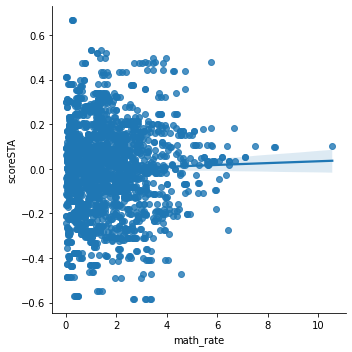

In [ ]:
asdf = pd.merge(fd, times, how='left',left_on=['NCTETID','scoreSTA'], right_on=['NCTETID','STA']) #.groupby(['NCTETID','STA']).sum().reset_index()
asdf['math_rate'] = (asdf.totmathlang / asdf.num_words) * asdf.minutes
sns.lmplot(data=asdf, x = 'math_rate',y='scoreSTA')

In [ ]:
pd.merge(fd, times, how='left',left_on=['NCTETID','scoreSTA'], right_on=['NCTETID','STA']) #.groupby(['NCTETID','STA'])

,NCTETID,OBSID_x,scoreSTA,cardinal,numeric,point,totcar,totpo,tot,carrate,...,matrate,OBSID_y,num_words,CHAPNUM,minutes,year,id_year,STA,ALT,wpm
0,11002,4250.0,0.078820,0.0,1.0,0.0,1.0,1.0,1.0,1.500000,...,0.971429,4250,7152,8,60.0,2013,11002_13,0.078820,0.023127,119.200000
1,11002,4250.0,0.078820,0.0,1.0,0.0,1.0,1.0,1.0,1.500000,...,0.971429,4599,5859,8,60.0,2013,11002_13,0.078820,0.023127,97.650000
2,11002,4250.0,0.078820,0.0,1.0,0.0,1.0,1.0,1.0,1.500000,...,0.971429,4678,5049,9,67.5,2013,11002_13,0.078820,0.023127,74.800000
3,11002,4678.0,0.078820,5.0,30.0,0.0,36.0,1.0,35.0,36.972973,...,0.979508,4250,7152,8,60.0,2013,11002_13,0.078820,0.023127,119.200000
4,11002,4678.0,0.078820,5.0,30.0,0.0,36.0,1.0,35.0,36.972973,...,0.979508,4599,5859,8,60.0,2013,11002_13,0.078820,0.023127,97.650000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2208,14134,0.0,0.049638,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,...,0.987993,4016,8468,9,67.5,2013,14134_13,0.049638,0.049487,125.451852
2209,14134,0.0,0.049638,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,...,0.987993,4096,7729,8,60.0,2013,14134_13,0.049638,0.049487,128.816667
2210,14134,0.0,0.049638,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,...,0.987993,4388,6520,8,60.0,2013,14134_13,0.049638,0.049487,108.666667
2211,14134,0.0,0.049638,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,...,0.987993,4751,7095,8,60.0,2013,14134_13,0.049638,0.049487,118.250000


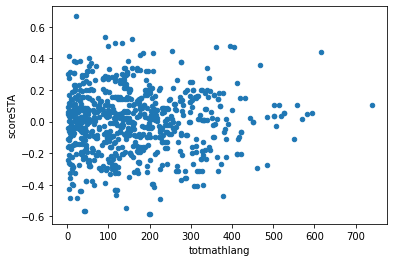

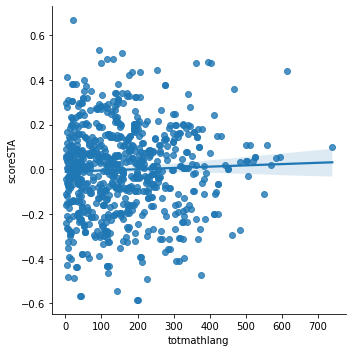

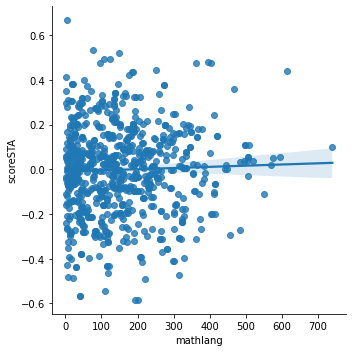

In [ ]:
fd.plot.scatter(x='totmathlang',y='scoreSTA')
sns.lmplot(data=fd, x = 'totmathlang',y='scoreSTA')
sns.lmplot(data=fd, x = 'mathlang',y='scoreSTA')

In [ ]:
fraclangdf['NCTETID'] = 0

for i, row in fraclangdf.iterrows():
  fraclangdf.NCTETID.iloc[i] = classdf[classdf.OBSID == row.OBSID]['NCTETID'].iloc[0]
fraclangdf

/usr/local/lib/python3.8/dist-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)


,index,speaker,text,OBSID,style,number,examples,count,NCTETID
0,111209,teacher,Because we only have $1.00. These are the who...,2708,slash,1,"[[ 1/1,]]",1,14070
1,157137,teacher,"1. To make any whole number into a fraction, ...",2950,slash,1,"[[ 100/1?, 100/1.]]",2,12056
2,157241,teacher,"1,000 divided by 1 is 1,000. I put it over 1....",2950,slash,1,[[ 500/1.]],1,12056
3,422625,teacher,"Thank you, sir. Okay let’s take a look. Numb...",358,slash,1,"[[700/1,]]",1,14055
4,1754,teacher,5. So we’re gonna go down. Here’s 10. They’...,2089,overnum,1,"[[ over 1,]]",1,14003
...,...,...,...,...,...,...,...,...,...
56641,549645,teacher,"Multiplied by 10, okay, and I know some of you...",80,ordinal,1000,[[ one thousandths]],1,11029
56642,549657,teacher,"Does it matter whether it's one tenth, ten hun...",80,ordinal,1000,[[ one thousandths]],1,11029
56643,549719,teacher,Right. I actually have one hundredth one thou...,80,ordinal,1000,[[ one thousandths]],1,11029
56644,554431,teacher,"All right, so let’s do another one. Nine thou...",935,ordinal,1000,[[ one thousandths]],1,13054


In [ ]:
frac_count = fraclangdf[(fraclangdf.number < 100) & ~(fraclangdf.number.isin([1,2,10])) & (fraclangdf.speaker == 'teacher')].pivot_table("count",index="NCTETID",columns="style",aggfunc="sum").reset_index()
frac_count = frac_count.fillna(0)
frac_count['va'] = frac_count.NCTETID.apply(lambda x: vadf[(vadf.year.isna()) & (vadf.NCTETID == x)].score.iloc[0] if not vadf[(vadf.year.isna()) & (vadf.NCTETID == x)].empty else np.nan)

frac_count[(frac_count.over + frac_count.overnum >= (frac_count.ordinal)//2)]
frac_count[frac_count.ordinal < 5]
frac_count['total'] = frac_count.ordinal + frac_count.over + frac_count.overnum - frac_count.slash
frac_count['total']=frac_count['total'].apply(lambda x: 0 if x <0 else x)
frac_count.plot.scatter(x = 'total',y='va')

style,NCTETID,ordinal,over,overnum,slash
0,2501,1.0,0.0,0.0,0.0
25,11026,2.0,0.0,0.0,0.0
35,11036,4.0,0.0,0.0,0.0
49,11051,2.0,0.0,0.0,0.0
76,12003,1.0,0.0,0.0,0.0
122,12052,1.0,0.0,0.0,0.0
127,12057,1.0,0.0,0.0,0.0
130,13002,3.0,0.0,0.0,0.0
137,13016,2.0,0.0,0.0,0.0
139,13019,1.0,1.0,3.0,0.0


In [ ]:
frac_count[(frac_count.over + frac_count.overnum >= (frac_count.ordinal)//3) & (frac_count.slash >= 0)]

style,NCTETID,ordinal,over,overnum,slash
146,13030,40.0,16.0,36.0,13.0
253,14078,85.0,25.0,8.0,9.0


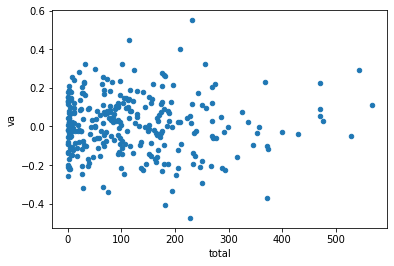

In [ ]:
frac_count[frac_count.total < 2000].plot.scatter(x = 'total',y='va')

In [ ]:
frac_count.sort_values("va").tail(50).describe()

style,NCTETID,ordinal,over,overnum,slash,va,total
count,50.000000,50.00000,50.000000,50.000000,50.00000,40.000000,50.000000
mean,12251.380000,119.40000,2.980000,1.900000,4.76000,0.251039,129.040000
std,1950.139785,116.87059,8.296766,5.690128,21.23874,0.077107,118.344354
min,2501.000000,1.00000,0.000000,0.000000,0.00000,0.174331,1.000000
25%,11041.750000,31.25000,0.000000,0.000000,0.00000,0.205034,32.250000
50%,12025.000000,91.50000,0.000000,0.000000,0.00000,0.229052,101.500000
75%,14022.000000,175.75000,1.000000,1.000000,0.00000,0.279736,181.250000
max,14108.000000,542.00000,47.000000,37.000000,137.00000,0.549854,542.000000


In [ ]:
frac_count.sort_values("va").head(50).describe()

style,NCTETID,ordinal,over,overnum,slash,va,total
count,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000
mean,12754.100000,134.320000,0.860000,1.020000,9.600000,-0.219220,145.800000
std,1262.101071,98.173408,1.484752,2.171147,33.008966,0.071492,104.851693
min,11002.000000,0.000000,0.000000,0.000000,0.000000,-0.474693,1.000000
25%,12002.500000,40.250000,0.000000,0.000000,0.000000,-0.230541,47.000000
50%,13015.000000,141.000000,0.000000,0.000000,0.000000,-0.207193,153.000000
75%,14049.500000,203.000000,1.000000,1.000000,0.000000,-0.168475,241.500000
max,14132.000000,364.000000,6.000000,11.000000,167.000000,-0.141363,372.000000


In [ ]:
frac_count[frac_count.ordinal.isna()]

style,NCTETID,ordinal,over,overnum,slash
164,13084,NaN,5.0,NaN,NaN
288,14113,NaN,NaN,2.0,NaN


In [ ]:
frac_count[frac_count.ordinal == 1]

style,NCTETID,ordinal,over,overnum,slash
0,2501,1.0,NaN,NaN,NaN
76,12003,1.0,NaN,NaN,NaN
122,12052,1.0,NaN,NaN,NaN
127,12057,1.0,NaN,NaN,NaN
139,13019,1.0,1.0,3.0,NaN
140,13021,1.0,NaN,NaN,NaN
148,13042,1.0,NaN,2.0,NaN
149,13043,1.0,NaN,NaN,NaN
151,13054,1.0,NaN,NaN,NaN
163,13083,1.0,NaN,NaN,NaN


In [ ]:
frac_count['va'] = frac_count.NCTETID.apply(lambda x: vadf[(vadf.year.isna()) & (vadf.NCTETID == x)].score.iloc[0] if not vadf[(vadf.year.isna()) & (vadf.NCTETID == x)].empty else np.nan)

# vadf[(vadf.year.isna()) & ]

In [ ]:
print("\n".join(fraclangdf[(fraclangdf.NCTETID==13084)  & (fraclangdf['speaker'] == 'teacher')].text))

So if we do ten minus one over five, we get nine over five.  Is that equal to one?
Five.  So five over five equals one.  I do not want to see anyone making fans right now.  So put them away.  It’s hot but doing that’s going to make it more hot.
I want all eyes up here.  Sit up.  Sit up.  Push in your chair. Push it in.  You too.  Put that away.  You don’t need it right now.  All right, so here X—an X over seven, Student E, what operation are we gonna use if—for X over seven? What does that mean?  Division.  So to find our answer, Student H, what’s the opposite of division?


In [ ]:
v[v.NCTETID_x == 13019].score.unique()

array([-0.0011243, -0.1324688])

In [ ]:
fraclangdf.text.apply(lambda x: mat_lang_dict[row.number][row.style]['pat'].search(x))

AttributeError: ignored

In [ ]:
fraclangdf.text.iloc[0]

'So we could almost say that 0.333 would be equal to what is this, the tens place, the hundreds place and the thousandths place?  So we could say that’s 333/1000 which would look like this over 1000.  So that would be 1/3. So these are equivalents, these fractions that we’re doing that we see are equivalent to the decimals.  They are worth the same.  So what you’re going to do right now, and we’re not going to do some certain ones here.  We’re not gonna do number 7, we’re not going to do 9 and we’re not gonna do 11 today.  Then we’re going to see certain patterns.  So let’s take a look.  Let’s start doing some of the and remember let’s see what you can come up with. So if we did 1 the numerator divided by 1 the denominator, what’s our number?'

In [ ]:
df.text.loc[557576]



'3-4/3.  Do it.  3-4/3.  I mean 3-2/3.  Not four thirds.  3-2/3.'

#### Decimal NBT language

In [ ]:
counting_nums = list(range(100))
word_nums = [num2words(x) for x in counting_nums] + [str(x) for x in list(range(10))]
NBTs = [num2words(x,'ordinal').split(' ')[-1] + "s?" for x in [10,100,1000,10000]]

pat = re.compile(f'({"|".join(word_nums)}) point ({"|".join(word_nums)})')
# pat = re.compile('\d+\.\d+')

dec_list = df[df.text.apply(lambda x: bool(pat.findall(x)))]
dec_list['type'] = 'point'
dec_list['count'] = dec_list.text.apply(lambda x: len(pat.findall(x)))

## find all decimals
pat = re.compile('(?<!\$)\b\d+\.\d+')
# pat = re.compile('[^$]\d+\.\d+')
pat = re.compile('[ \t\n\r\f\v-]\d+\.\d+')
symb = df[df.text.apply(lambda x: bool(pat.findall(x)))]
symb['type'] = 'numeric'
symb['count'] = symb.text.apply(lambda x: len(pat.findall(x)))

## find all cardinatliy

pat = re.compile(f'({"|".join(word_nums)}) and ({"|".join(word_nums)})[ -]({"|".join(NBTs)})')

ord = df[df.text.apply(lambda x: bool(pat.findall(x)))]
ord['type'] = 'cardinal'
ord['count'] = ord.text.apply(lambda x: len(pat.findall(x)))

dec_list = pd.concat([dec_list,symb,ord])
dec_list.groupby(by='type').sum()




In [ ]:
re.compile(f'({"|".join(word_nums)}) and ({"|".join(word_nums)})[ -]({"|".join(NBTs)})')

re.compile(r'(zero|one|two|three|four|five|six|seven|eight|nine|ten|eleven|twelve|thirteen|fourteen|fifteen|sixteen|seventeen|eighteen|nineteen|twenty|twenty-one|twenty-two|twenty-three|twenty-four|twenty-five|twenty-six|twenty-seven|twenty-eight|twenty-nine|thirty|thirty-one|thirty-two|thirty-three|thirty-four|thirty-five|thirty-six|thirty-seven|thirty-eight|thirty-nine|forty|forty-one|forty-two|forty-three|forty-four|forty-five|forty-six|forty-seven|forty-eight|forty-nine|fifty|fifty-one|fifty-two|fifty-three|fifty-four|fifty-five|fifty-six|fifty-seven|fifty-eight|fifty-nine|sixty|sixty-one|sixty-two|sixty-three|sixty-four|sixty-five|sixty-six|sixty-seven|sixty-eight|sixty-nine|seventy|seventy-one|seventy-two|seventy-three|seventy-four|seventy-five|seventy-six|seventy-seven|seventy-eight|seventy-nine|eighty|eighty-one|eighty-two|eighty-three|eighty-four|eighty-five|eighty-six|eighty-seven|eighty-eight|eighty-nine|ninety|ninety-one|ninety-two|ninety-three|ninety-four|ninety-five|ninet

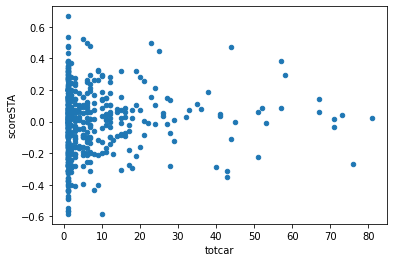

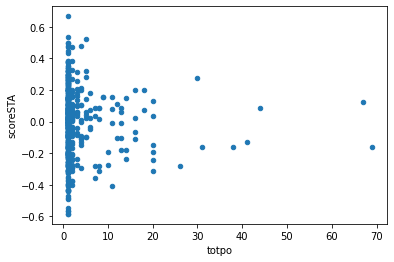

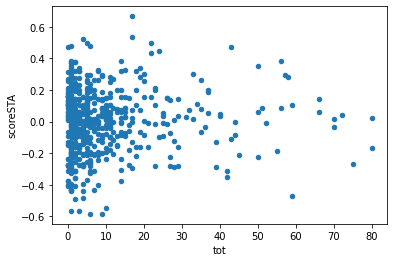

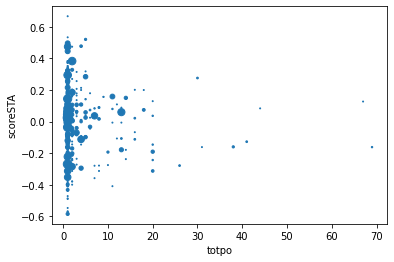

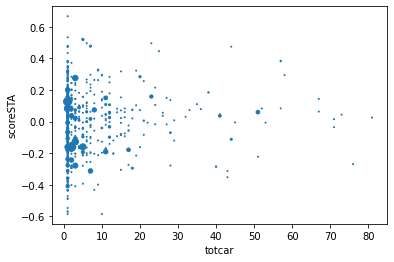

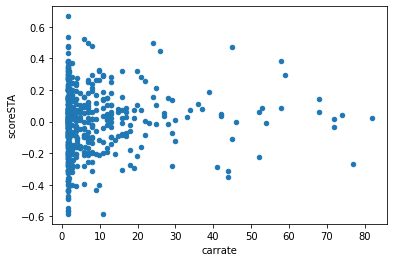

In [ ]:
# dcs = dec_list.pivot_table(values='count',index = 'NCTETID',columns='type',aggfunc=sum).reset_index()
dcs = dec_list.pivot_table(values='count',index = ['NCTETID','OBSID','scoreSTA'],columns='type',aggfunc=sum).reset_index()
dcs = dcs.fillna(0)
dcs['totcar'] = dcs.cardinal + 1
dcs['totpo'] = dcs.point + 1
dcs['tot'] = dcs.cardinal + dcs.numeric
# dcs.loc[(dcs.point >= dcs.cardinal) & (dcs.point > 0),'totcar']

dcs.loc[(dcs.point < dcs.cardinal),'totcar'] = dcs.loc[(dcs.point < dcs.cardinal)].totcar + dcs.loc[(dcs.point < dcs.cardinal)].numeric
dcs.loc[(dcs.point > dcs.cardinal),'totpo'] = dcs.loc[dcs.point >= dcs.cardinal].totpo + dcs.loc[dcs.point >= dcs.cardinal].numeric

dcs['carrate'] = (dcs.totcar - 1 / (dcs.totcar + dcs.totpo))+1

dcs.plot.scatter(x='totcar',y='scoreSTA',)
dcs.plot.scatter(x='totpo',y='scoreSTA',)
dcs.plot.scatter(x='tot',y='scoreSTA',)
dcs.plot.scatter(x='totpo',y='scoreSTA',s ='totcar')
dcs.plot.scatter(x='totcar',y='scoreSTA',s ='totpo')
dcs.plot.scatter(x='carrate',y='scoreSTA',)



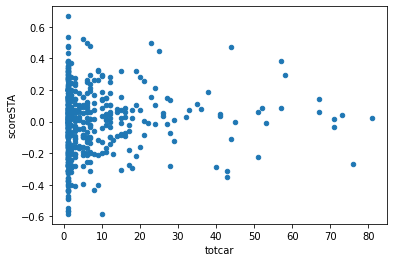

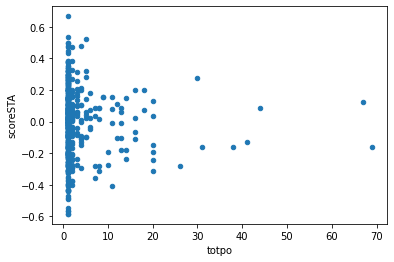

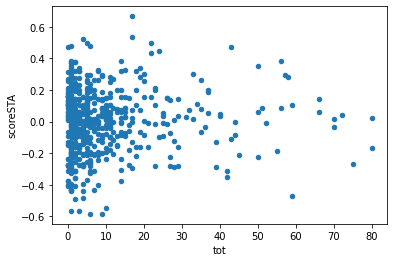

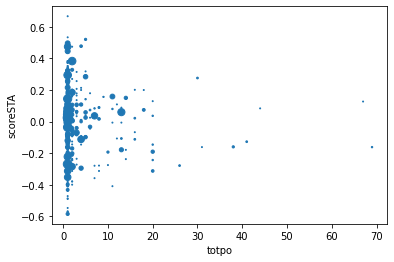

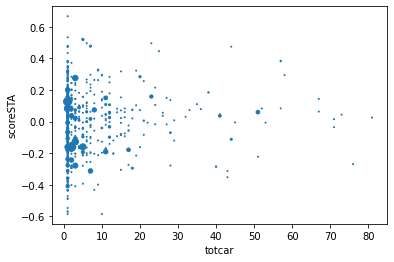

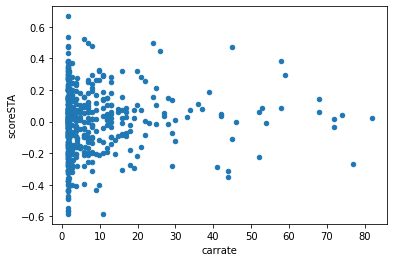

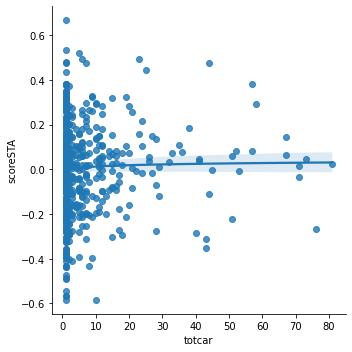

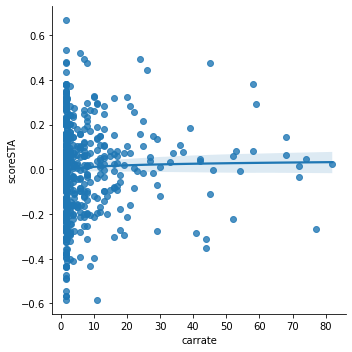

In [ ]:
sns.lmplot(data = dcs, x = 'totcar',y='scoreSTA',logx=True)
sns.lmplot(data = dcs, x = 'carrate',y='scoreSTA',logx=True)

In [ ]:
dec_list.pivot_table(values='count',index = ['OBSID','scoreSTA'],columns='type',aggfunc=sum).reset_index().

type,OBSID,scoreSTA,cardinal,numeric,point
0,11,0.007188,NaN,1.0,NaN
1,20,0.178393,NaN,NaN,2.0
2,34,0.479692,NaN,1.0,NaN
3,36,0.164609,NaN,NaN,1.0
4,54,-0.235710,NaN,NaN,1.0
...,...,...,...,...,...
557,4695,0.003365,NaN,4.0,NaN
558,4724,0.103625,NaN,NaN,1.0
559,4738,0.021098,5.0,NaN,NaN
560,4740,-0.011364,NaN,3.0,NaN


In [ ]:
pat.findall("eleven point three asdfasdfasd a sfda four and one and more and there's another fourteen point five")

[('eleven', 'three'), ('fourteen', 'five')]

In [ ]:


# pat = re.compile('(?<!\$)\b\d+\.\d+\b')
# print(sum(df.text.apply(lambda x: bool(pat.findall(x)))))


# pat = re.compile('(?<!\$)\b\d+\.\d+')
# print(sum(df.text.apply(lambda x: bool(pat.findall(x)))))


pat = re.compile('(?<!\$)\d+\.\d+')
print(sum(df.text.apply(lambda x: bool(pat.findall(x)))))

pat = re.compile('\$\d+\.\d+')
print(sum(df.text.apply(lambda x: bool(pat.findall(x)))))

pat = re.compile('[ \t\n\r\f\v-]\d+\.\d+')
print(sum(df.text.apply(lambda x: bool(pat.findall(x)))))

pat = re.compile('[^$]\d+\.\d+')
print(sum(df.text.apply(lambda x: bool(pat.findall(x)))))

4723
2321
2490
4013


In [ ]:
!pip install word2number
from word2number import w2n

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Preparing metadata (setup.py) ... done
  Created wheel for word2number: filename=word2number-1.1-py3-none-any.whl size=5582 sha256=0530e722b6c40625e5cd9befc853befd0a0853f1113bedc9e8baab24a71cf4cd
  Stored in directory: /root/.cache/pip/wheels/cb/f3/5a/d88198fdeb46781ddd7e7f2653061af83e7adb2a076d8886d6
Successfully built word2number


,speaker,text,year,OBSID,video_id,cleaned_text,num_words,turn_idx,comb_idx,t,...,NCTETID,id_year,scoreSTA,scoreALT,scoreSESTA,scoreSEALT,avgscoreSTA,avgscoreALT,avgscoreSESTA,avgscoreSEALT
6264,student,"All right. Being today is February 1st, in on...",2,2627,772,all right being today is february 1st in one m...,154,1,2627_1,0,...,14055,14055_12,-0.278155,0.060446,0.111130,0.106924,-0.111135,0.053980,0.083276,0.081635
6608,student,"The area? It’s um, radius squared, times thre...",2,2627,772,the area it s um radius squared times three po...,12,345,2627_345,0,...,14055,14055_12,-0.278155,0.060446,0.111130,0.106924,-0.111135,0.053980,0.083276,0.081635
9716,teacher,Because we don't have any tenths or hundredths...,2,2523,820,because we don t have any tenths or hundredths...,102,165,2523_165,1,...,14113,14113_12,0.074457,-0.123041,0.113736,0.102228,0.078775,0.022385,0.112063,0.095483
10469,teacher,Because zero means what? So here I have two p...,2,2019,764,because zero means what so here i have two poi...,28,67,2019_67,1,...,14035,14035_12,-0.033161,0.056533,0.092197,0.094437,-0.052460,-0.074007,0.093801,0.087186
10540,teacher,"It’s not 890. They’re individual, so it’s 11 ...",2,2019,764,it s not 890 they re individual so it s 11 poi...,50,138,2019_138,1,...,14035,14035_12,-0.033161,0.056533,0.092197,0.094437,-0.052460,-0.074007,0.093801,0.087186
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
569459,teacher,"You don’t say twelve point one. Remember, you...",1,955,415,you don t say twelve point one remember you sa...,31,240,955_240,1,...,12043,12043_11,0.213317,0.236981,0.108166,0.116719,-0.093766,-0.159181,0.085287,0.100580
570168,teacher,"Okay, before we start doing the division, I wa...",1,308,711,okay before we start doing the division i want...,101,63,308_63,1,...,14068,14068_11,-0.145291,-0.025382,0.112880,0.125730,-0.008187,-0.084752,0.080965,0.094015
570345,teacher,"Okay, can you just skip that for now and then ...",1,308,711,okay can you just skip that for now and then i...,105,240,308_240,1,...,14068,14068_11,-0.145291,-0.025382,0.112880,0.125730,-0.008187,-0.084752,0.080965,0.094015
570351,teacher,"Okay, we need the zero. That’s important. So...",1,308,711,okay we need the zero that s important so numb...,19,246,308_246,1,...,14068,14068_11,-0.145291,-0.025382,0.112880,0.125730,-0.008187,-0.084752,0.080965,0.094015


In [ ]:
dec_list.mean()

<ipython-input-188-09e5533a59f5>:1: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  dec_list.mean()


year               1.618467e+00
OBSID              1.703343e+03
video_id           6.492509e+02
num_words          4.236237e+01
turn_idx           2.286446e+02
comb_idx                    inf
t                  6.515679e-01
cum_words          3.221916e+03
t_words            3.769512e+01
s_words            4.667247e+00
t_cum_words        2.760059e+03
s_cum_words        4.618571e+02
tt_cum_ratio       8.582018e-01
st_cum_ratio       1.417982e-01
talk_cum_pct       5.144826e-01
t_words_rolling    1.547526e+01
s_words_rolling    2.541487e+00
t_25_rolling       1.244552e+01
s_25_rolling       2.258072e+00
t_40_rolling       1.236928e+01
s_40_rolling       2.185707e+00
all_40_rolling     1.455499e+01
ts_cum_ratio       1.800458e-01
NCTETID            1.335184e+04
id_year                     inf
scoreSTA          -1.182233e-02
scoreALT           6.352844e-05
scoreSESTA         1.103482e-01
scoreSEALT         1.053322e-01
avgscoreSTA       -3.399052e-03
avgscoreALT        4.209565e-03
avgscore

-0.01

In [ ]:
dec_list[dec_list.apply(lambda x: x != [])]
# dec_list[dec_list != []]
# asdf = list(dec_list)
# asdf.remove([])
# asdf

259       [100.00]
262       [100.00]
263       [100.00]
492         [9.95]
494        [99.99]
            ...   
578209      [4.50]
578221      [1.50]
579393       [2.5]
579394       [2.5]
579802      [12.1]
Name: text, Length: 5750, dtype: object

#### Student Markers

In [ ]:
def student_markers(text):
  spat = re.compile("[Ss]tudent [A-Z0-9]")
  return spat.sub("[student]",text)

student_markers(" So then she could also move it 1/8.  Do you understand, Student S? Okay, let’s take a look at our fraction track.  Tell Student C what you think she should do, what you and your teams discussed.")

' So then she could also move it 1/8.  Do you understand, [student]? Okay, let’s take a look at our fraction track.  Tell [student] what you think she should do, what you and your teams discussed.'

In [ ]:
stref = re.compile("[Ss]tudent [A-Z0-9]")

st_list = df[df.text.apply(lambda x: bool(stref.findall(x)))]
st_list['sref_count'] = st_list.text.apply(lambda x: len(stref.findall(x)))
st_list['all_sref_s'] = st_list.text.apply(lambda x: [stref.findall(x)])
st_list['unique_s'] = st_list.text.apply(lambda x: set([i[-1] for i in stref.findall(x)]))



st_list[st_list.speaker == 'teacher'].groupby(by=['OBSID']).sref_count.transform(lambda x: len(set(x))).hist()

# st_list


17        3
23        3
28        2
32        3
35        3
         ..
580342    6
580346    6
580359    1
580360    1
580362    1
Name: sref_count, Length: 71031, dtype: int64

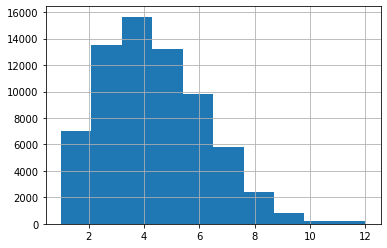

In [ ]:
st_list[st_list.speaker == 'teacher'].groupby(by=['OBSID']).sref_count.transform(lambda x: len(set(x))).hist()

['Friends, yesterday we started off by working on some word problems together, yes?',
 'Yes.',
 'And yesterday towards the end of the period, you got a word problem given to you that you had to draw a picture to show it, and you had to do the math problem to show it, yes?',
 'Yes.',
 "Some of you might be done.  If you are finished, then you can just look over it to make sure that you are happy with the way that it is.  And if you are not done, now is your time to get it done.  I'm gonna set about ten minutes on my timer.  And if we need less time than that, then we will take less time.  But I'm gonna give you at least ten minutes to finish it up.  And then we're gonna start something new.  So my timer is set for ten minutes.  You get ten minutes to finish it up.",
 'Can we find new ways to check it or [inaudible]?',
 "Well, the best way to check it is going to be to draw the picture and do the math part of it.  So let's look at what you have.  A lawn mower holds three fourths a gallon

In [ ]:
"".split(".")

['']

In [ ]:
nums = ["24.653.4365", "145.2", "$25.2", "234.5243", "22"]
for n in nums:
  print(adj_num2words(n))


24.653.4365
one hundred and forty-five and two tenths
twenty-five dollarsand twenty cents
two hundred and thirty-four and five thousand two hundred and forty-three ten thousandths
twenty-two


## Checking for Temporal Markers

In [ ]:
pat = re.compile("[Ww]ork.{0,3} on")
df['has_work_text'] = np.nan

for i, row in df.iterrows():
  asdf = pat.findall(row.text)
  if len(asdf) > 0:
    df.loc[i,'has_work_text'] = 1


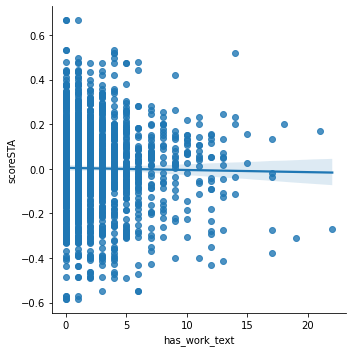

In [ ]:
sns.lmplot(x = 'has_work_text', y = 'scoreSTA', data = pd.concat([df[df.speaker == 'teacher'].groupby(by = 'OBSID').has_work_text.sum(), df[df.speaker == 'teacher'].groupby(by = 'OBSID').scoreSTA.mean()], axis =1))

<AxesSubplot:xlabel='turn_idx', ylabel='scoreSTA'>

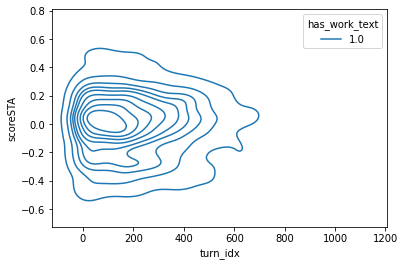

In [ ]:
sns.kdeplot(x = 'turn_idx',
           y = 'scoreSTA',
           hue = 'has_work_text',
           data = df[(df.speaker == 'teacher') & (df.has_work_text == 1)])

In [ ]:
pd.cut(df[(df.speaker == 'teacher') & (df.has_work_text == 1)].scoreSTA, bins = 5,include_lowest = True).unique()


[(-0.334, -0.0838], (-0.0838, 0.166], (0.166, 0.416], (0.416, 0.666], (-0.586, -0.334], NaN]
Categories (5, interval[float64, right]): [(-0.586, -0.334] < (-0.334, -0.0838] < (-0.0838, 0.166] <
                                           (0.166, 0.416] < (0.416, 0.666]]

  0%|          | 0/580408 [00:00<?, ?it/s]

<AxesSubplot:xlabel='before_work', ylabel='after_work'>

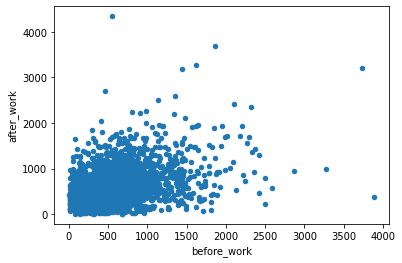

In [ ]:
# df['t_before_work'] = np.nan
# df['t_after_work'] = np.nan
# df['s_before_work'] = np.nan
# df['s_after_work'] = np.nan
df['before_work'] = np.nan
df['after_work'] = np.nan


turn_window_size = 20

for i, row in tqdm(df.iterrows(),total=len(df)):
  if row.has_work_text == 1:
    max_turns = df[df.OBSID == row.OBSID].turn_idx.max()
    df.loc[i,'before_work'] = df.loc[(df.OBSID == row.OBSID) & (df.turn_idx.between(max(0,row.turn_idx-turn_window_size),row.turn_idx)),'num_words'].sum()
    df.loc[i,'after_work'] = df.loc[(df.OBSID == row.OBSID) & (df.turn_idx.between(row.turn_idx,min(row.turn_idx+turn_window_size,max_turns))),'num_words'].sum()
    # df.loc[max(0,i-turn_window_size):min(i+turn_window_size,max_turns),'num_words']
    # df.loc[max(0,i-turn_window_size):min(i+turn_window_size,max_turns),'num_words']
    # df.loc[i,'t_before_work'] = df[(df.speaker == 'teacher')]

df.plot.scatter(x='before_work', y='after_work')

In [ ]:
df.to_pickle(DATA_FOLDER + "tempdf.pkl")

<AxesSubplot:xlabel='before_work', ylabel='after_work'>

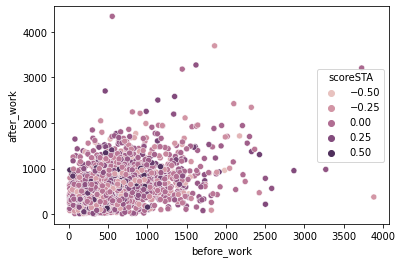

In [ ]:
sns.scatterplot(x = 'before_work',y='after_work', hue='scoreSTA',data =df)

<AxesSubplot:xlabel='avgscoreSTA', ylabel='cum_words'>

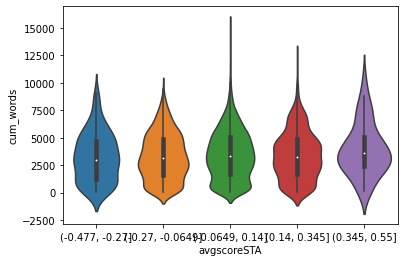

In [ ]:
# pd.cut(df.scoreSTA, bins = 5)

sns.violinplot(x = pd.cut(df[(df.speaker == 'teacher') & (df.has_work_text == 1)].scoreSTA, bins = 5,include_lowest = True),
               y = df[(df.speaker == 'teacher') & (df.has_work_text == 1)].turn_idx)

# sns.histplot(data=df[(df.speaker == 'teacher') & (df.has_work_text == 1)], x="turn_idx", color="skyblue", label="Sepal Length", kde=True)
# sns.histplot(data=df[(df.speaker == 'teacher') & (df.has_work_text == 1)], x="turn_idx", color="red", label="Sepal Width", kde=True)

# plt.legend()
# plt.show()

<AxesSubplot:xlabel='turn_idx', ylabel='cum_words'>

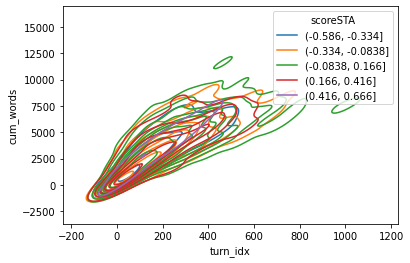

In [ ]:
sns.kdeplot(x = df[(df.speaker == 'teacher') & (df.has_work_text == 1)].turn_idx,
            y = df[(df.speaker == 'teacher') & (df.has_work_text == 1)].cum_words,
            hue = pd.cut(df[(df.speaker == 'teacher') & (df.has_work_text == 1)].scoreSTA, bins = 5,include_lowest = True))

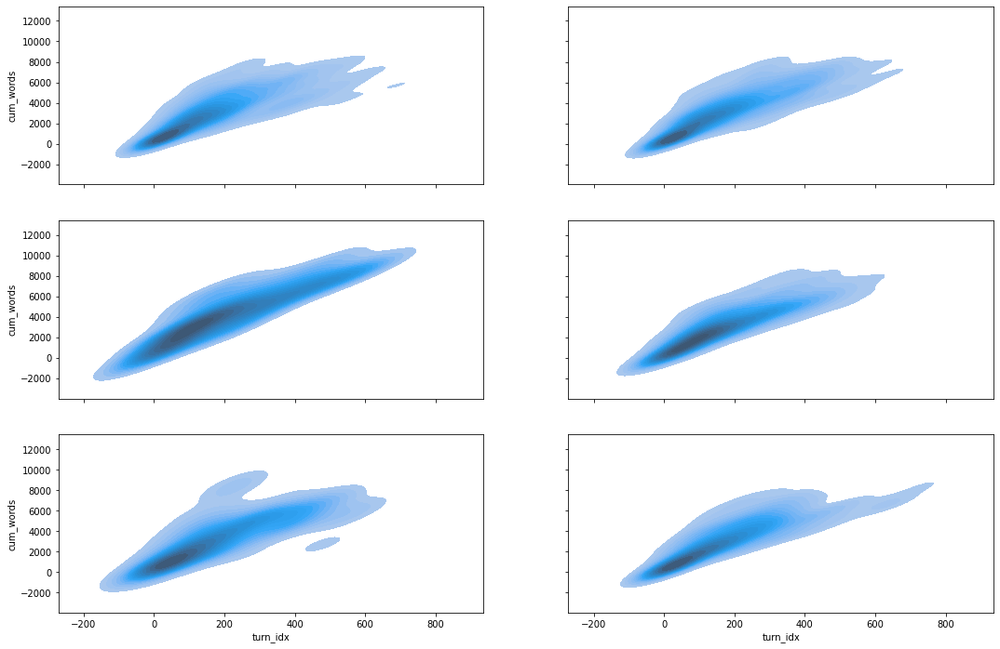

In [ ]:

f, axes = plt.subplots(3, 2, figsize=(18, 12), sharex=True, sharey=True)
for ax, s in zip(axes.flat, pd.cut(df[(df.speaker == 'teacher') & (df.has_work_text == 1)].scoreSTA, bins = 6,include_lowest = True).unique()):
  sns.kdeplot(x = 'turn_idx',
              y = 'cum_words',
            #  hue = 'scoreSTA',
            data = df[(df.cum_words < 10000) & (df.turn_idx < 800) & (df.speaker == 'teacher') & (df.has_work_text == 1) & (pd.cut(df[(df.speaker == 'teacher') & (df.has_work_text == 1)].scoreSTA, bins = 6 ,include_lowest = True) == s)],
              levels = 20,
              fill = True,
              ax = ax,
              label = str(s)
              )



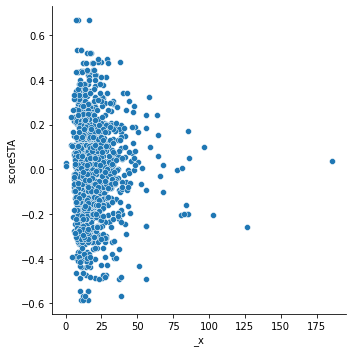

In [ ]:
sns.relplot( x= df.groupby(by = 'OBSID').t_cum_words.max() / df.groupby(by = 'OBSID').turn_idx.max(), y = df.groupby(by = 'OBSID').scoreSTA.mean())

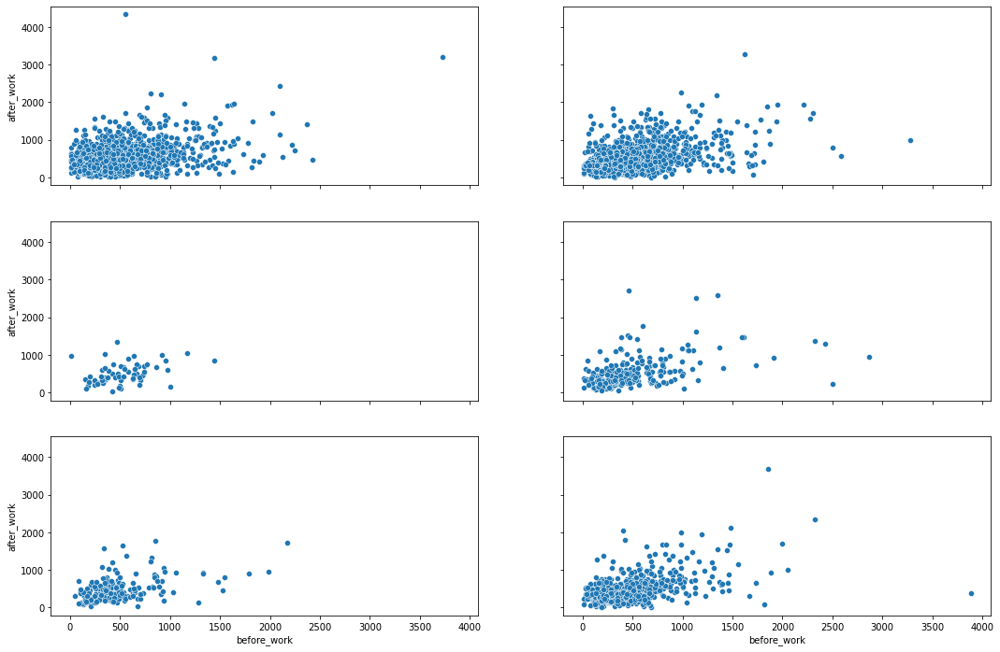

In [ ]:
f, axes = plt.subplots(3, 2, figsize=(18, 12), sharex=True, sharey=True)
for ax, s in zip(axes.flat, pd.cut(df.scoreSTA, bins = 6,include_lowest = True).unique()):
  sns.scatterplot(x = 'before_work',
              y = 'after_work',
            #  hue = 'scoreSTA',
            data = df[(pd.cut(df.scoreSTA, bins = 6, include_lowest = True) == s)],
            # data = df[(pd.cut(df[(df.speaker == 'teacher') & (df.has_work_text == 1)].scoreSTA, bins = 6, include_lowest = True) == s)],
              # levels = 20,
              # fill = True,
              ax = ax,
              # label = str(s)
              )
  ax.plot([0, 0], [4000, 4000])

In [ ]:
df[(pd.cut(df.scoreSTA, bins = 6, include_lowest = True) == s)]

,speaker,text,year,OBSID,video_id,cleaned_text,num_words,turn_idx,comb_idx,t,...,scoreALT,scoreSESTA,scoreSEALT,avgscoreSTA,avgscoreALT,avgscoreSESTA,avgscoreSEALT,has_work_text,before_work,after_work
5050,teacher,"Okay, boys and girls. We are going to review ...",2,2738,780,okay boys and girls we are going to review geo...,11,0,2738_0,1,...,-0.022010,0.111130,0.099421,-0.059291,0.022625,0.088641,0.108479,NaN,NaN,NaN
5051,multiple students,Benchmark.,2,2738,780,benchmark,1,1,2738_1,0,...,-0.022010,0.111130,0.099421,-0.059291,0.022625,0.088641,0.108479,NaN,NaN,NaN
5052,teacher,Your benchmark test. So we want to review eve...,2,2738,780,your benchmark test so we want to review every...,89,2,2738_2,1,...,-0.022010,0.111130,0.099421,-0.059291,0.022625,0.088641,0.108479,NaN,NaN,NaN
5053,student,[Inaudible].,2,2738,780,inaudible,1,3,2738_3,0,...,-0.022010,0.111130,0.099421,-0.059291,0.022625,0.088641,0.108479,NaN,NaN,NaN
5054,teacher,Length times width is the formula for the area...,2,2738,780,length times width is the formula for the area...,28,4,2738_4,1,...,-0.022010,0.111130,0.099421,-0.059291,0.022625,0.088641,0.108479,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
580403,teacher,Can you hit the mouse so we can see. You shoul...,1,315,445,can you hit the mouse so we can see you should...,32,515,315_515,1,...,-0.112478,0.102084,0.112883,0.147574,0.034162,0.084976,0.083317,NaN,NaN,NaN
580404,student,I’ll go first.,1,315,445,i ll go first,4,516,315_516,0,...,-0.112478,0.102084,0.112883,0.147574,0.034162,0.084976,0.083317,NaN,NaN,NaN
580405,teacher,What do you want to ask her if she has?,1,315,445,what do you want to ask her if she has,10,517,315_517,1,...,-0.112478,0.102084,0.112883,0.147574,0.034162,0.084976,0.083317,NaN,NaN,NaN
580406,student,"If she has 5, 1.",1,315,445,if she has 5 1,5,518,315_518,0,...,-0.112478,0.102084,0.112883,0.147574,0.034162,0.084976,0.083317,NaN,NaN,NaN


## Extract info for **timestamps**

Note, this OLD also found at the beginning of the document

### OLD USE METHOD EARLIER IN DOC Get worktime markers

In [ ]:
import pandas as pd
import numpy as np
import re
import scipy

wpm = pd.DataFrame(pd.DataFrame(df.groupby(by=['OBSID']).num_words.sum())['num_words'] / (pd.DataFrame(v.groupby(by=["OBSID"]).CHAPNUM.max())['CHAPNUM'] * 7.5))


## Find transcription comments about worktime
work_pat = re.compile("\[([^\]]*?[Ww]ork.*?|[^\]]*?[Ii]ndep.*?|[^\]]*?[Ii]ndivi.*?|[^\]]*?[Qq]uiz.*?|[^\]]*?[Cc]heck.*?|[^\]]*?[Gg]ame.*?|[^\]]*?[Pp]air.*?|[^\]]*?[Ss]ribbl.*?|[^\]]*?[Ww]alk.*?|[^\]]*?[Gg]roups.*?|[^\]]*?[Qq]uiet.*?|[^\]]*?[Ss]ilent.*?|[^\]]*?[Dd]iscus.*?)\]")  #[^\]]*?[Pp]roblem.*?
## Find teacher comments about worktime
work_t = re.compile("[Ww]ork.* on|[Dd]o[i ].* you|[Ww]ork.* wi|[Ii]ndepende|on your own|\[[^\]]*?[Ss]ilenc.*?")
# ['conversations','Crosstalk','student? but not Student X','yell','discuss','walk','noise','scribbling','whispering','chatter','side comment','pair','play..game| cards','students checking answers','quiz']
possible_langs = ['[Ff]rench','[Ss]panish','[Ff]oreign','[Pp]ortuguese','[Cc]reole','[Cc]hinese']
inaudible_pat = re.compile(f"\[([^\]]*?[Ii]ndiscern|[Uu]nintellig|[Ii]naudi|[Cc]ross[ -]?talk|{'|'.join(possible_langs)}.*?)\]")



# ['Indiscernible','unintelligible']


df['has_work_comment'] = 0
# df['ind_practice'] = 0
df['adj_num_words'] = df.num_words
df['w_words'] = 0

for i, row in tqdm(df.iterrows(), total = len(df)):
  workm = len(work_pat.findall(row.text))
  workt = len(work_t.findall(row.text))
  inaudible = len(inaudible_pat.findall(row.text))
  words_per_min = wpm.loc[row.OBSID].values[0]
  df.loc[i,'has_work_comment'] = (workm) + (workt)
  df.loc[i,'w_words'] += ((workm) * 2 + (workt) * 0.25) * words_per_min
  df.loc[i,'adj_num_words'] += ((workm) * 2 + (workt) * 0.25 + (inaudible) * (0.09)) * words_per_min

  # if len(workm) > 0:
  #   df.loc[i,'has_work_comment'] = len(workm)
  #   df.loc[i,'w_words'] += len(workm) * (2) * words_per_min
  #   df.loc[i,'adj_num_words'] += len(workm) * (2) * words_per_min
  # if len(workt) > 0:
  #   df.loc[i,'has_work_comment'] = len(workt)
  #   df.loc[i,'w_words'] += len(workt) * (0.5) * words_per_min
  #   df.loc[i,'adj_num_words'] += len(workt) * (0.5) * words_per_min
  # if len(inaudible) > 0:
  #   df.loc[i,'adj_num_words'] += len(inaudible) * (0.09) * words_per_min
df["adj_cum_words"]=df.groupby(by= "OBSID").adj_num_words.cumsum()
df["w_cum_words"]=df.groupby(by= "OBSID").w_words.cumsum()
df["w_words_rolling"] = df.groupby(by="OBSID",sort=False).w_words.rolling(7).mean().values
df["w_25_rolling"] = df.groupby(by="OBSID",sort=False).w_words.rolling(25).mean().values
df["w_40_rolling"] = df.groupby(by="OBSID",sort=False).w_words.rolling(40, closed = 'both').mean().values

  0%|          | 0/1412404 [00:00<?, ?it/s]

### Check plots

<AxesSubplot:xlabel='turn_idx'>

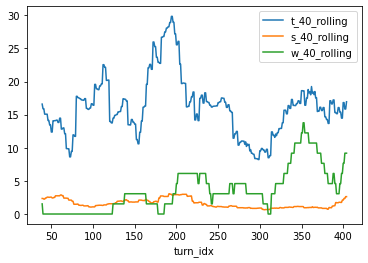

In [ ]:
ob = 450

df[df.OBSID == ob].plot.line(x = "turn_idx", y = ["t_40_rolling","s_40_rolling", "w_40_rolling"])

<AxesSubplot:xlabel='turn_idx'>

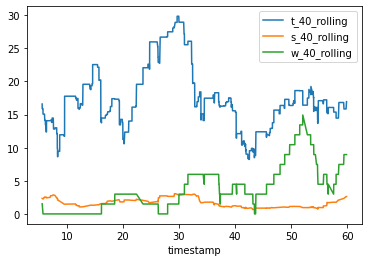

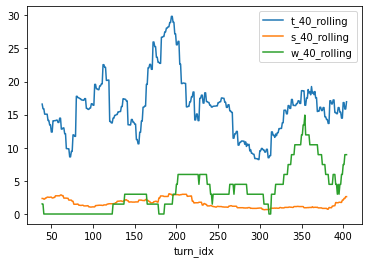

In [ ]:
ob = 450

df[df.OBSID == ob].plot.line(x = "timestamp", y = ["t_40_rolling","s_40_rolling", "w_40_rolling"])
df[df.OBSID == ob].plot.line(x = "turn_idx", y = ["t_40_rolling","s_40_rolling", "w_40_rolling"])

<Axes: xlabel='timestamp'>

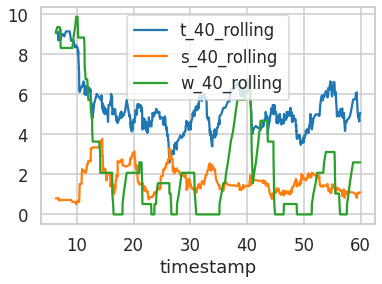

In [ ]:
ob = 500

df[df.OBSID == ob].plot.line(x = "timestamp", y = ["t_40_rolling","s_40_rolling", "w_40_rolling"])

In [ ]:
df.columns

Index(['speaker', 'text', 'year', 'OBSID', 'video_id', 'cleaned_text',
       'num_words', 'turn_idx', 'comb_idx', 't',
       ...
       'TREMSTU', 'STUENG', 'CLMATINQ', 'LESSEFFIC', 'DENSMAT', 'LATASK',
       'LESSCLEAR', 'TASKDEVMAT', 'ERRANN', 'WORLD'],
      dtype='object', length=117)

<AxesSubplot:xlabel='timestamp'>

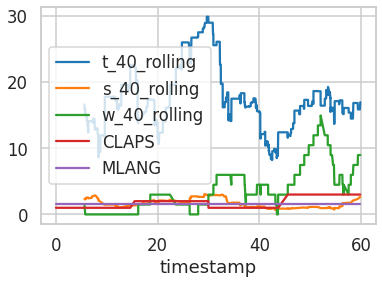

In [ ]:
ob = 450

df[df.OBSID == ob].plot.line(x = "timestamp", y = ["t_40_rolling","s_40_rolling", "w_40_rolling","CLAPS","MLANG"])

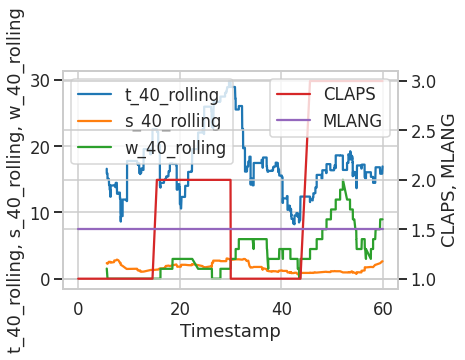

In [ ]:
import matplotlib.pyplot as plt

# create a figure and axis object
fig, ax1 = plt.subplots()

# plot the first three variables on the primary y-axis
ax1.plot(df[df.OBSID == ob]['timestamp'], df[df.OBSID == ob]['t_40_rolling'], label='t_40_rolling')
ax1.plot(df[df.OBSID == ob]['timestamp'], df[df.OBSID == ob]['s_40_rolling'], label='s_40_rolling')
ax1.plot(df[df.OBSID == ob]['timestamp'], df[df.OBSID == ob]['w_40_rolling'], label='w_40_rolling')
ax1.set_xlabel('Timestamp')
ax1.set_ylabel('t_40_rolling, s_40_rolling, w_40_rolling')

# create a second y-axis object
ax2 = ax1.twinx()

# plot the last two variables on the secondary y-axis
ax2.plot(df[df.OBSID == ob]['timestamp'], df[df.OBSID == ob]['CLAPS'], label='CLAPS', color='tab:red')
ax2.plot(df[df.OBSID == ob]['timestamp'], df[df.OBSID == ob]['MLANG'], label='MLANG', color='tab:purple')
ax2.set_ylabel('CLAPS, MLANG')

# add legends to the axes
ax1.legend(loc='upper left')
ax2.legend(loc='upper right')

# show the plot
plt.show()

In [ ]:
a = df[df.OBSID == 450].rolling(window=45,min_periods = 20, closed = 'both', center=True)
a.apply(lambda x:[list(x.index)])

<ipython-input-39-13c304e4cd0c>:2: FutureWarning: Dropping of nuisance columns in rolling operations is deprecated; in a future version this will raise TypeError. Select only valid columns before calling the operation. Dropped columns were Index(['APLPROB', 'CHAPNUM', 'CLAPS', 'CLBM', 'CLCU', 'CLILF', 'CLINSTD',
       'CLNC', 'CLPC', 'CLPRDT', 'CLQF', 'CLRSP', 'CLSTENG', 'CLTS', 'CWCM',
       'DIRINST', 'ETCA', 'EXPL', 'FORMAT_ACTIVE', 'FORMAT_BOTH',
       'FORMAT_SMALLGRP', 'LANGIMP', 'LCP', 'LINK', 'MAJERR', 'MGEN', 'MLANG',
       'MMETH', 'NCTETID', 'OBSID', 'OERR', 'OERRC', 'ORICH', 'ORICHC',
       'OSPMMR', 'OSPMMRC', 'OWWS', 'OWWSC', 'REMED', 'SEGMENT', 'SMALDISC',
       'SMQR', 'STEXPL', 'USEPROD', 'WCDISS', 'adj_cum_words', 'adj_num_words',
       'all_40_rolling', 'avgscoreALT', 'avgscoreSEALT', 'avgscoreSESTA',
       'avgscoreSTA', 'cleaned_text', 'comb_idx', 'cum_words', 'group_work',
       'has_timestamp', 'has_work_comment', 'id_year', 'ind_practice',
       'level

,ORIENT,SUMM,MQI_CHECK,DIFFINST,LLC,MQI3,MKT3,MQI5,MKT5,TSTUDEA,...,s_pct_math_words,ORICH4,MATCON,OWWS4,OERR4,OSPMMR4,STUCON,STUCOM,SMALDIS,MMSM
1046585,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1046586,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1046587,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1046588,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1046589,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1047675,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1047676,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1047677,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1047678,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
# for f in a:
#   print(list(f.index))

# Create Class Heartbeat Charts

<ipython-input-180-fe9c15cb6a6f>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])
<ipython-input-180-fe9c15cb6a6f>:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[second_axis_vars] = scaler.fit_transform(tdf[second_axis_vars])


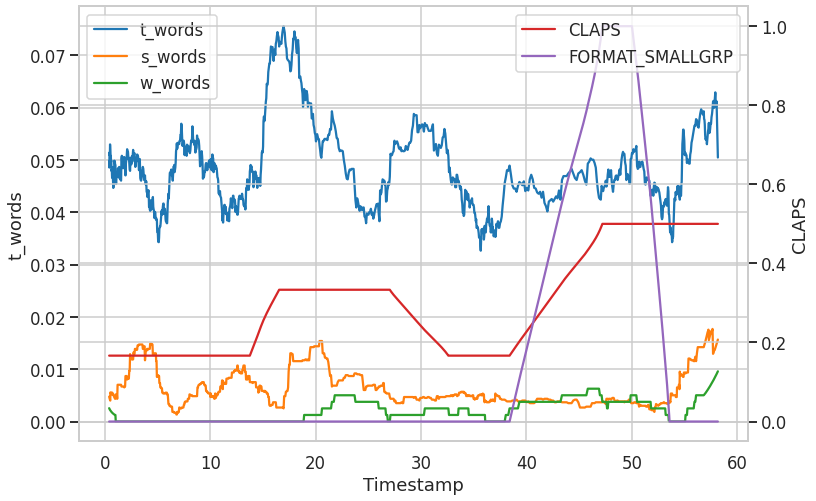

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler

def make_class_heartbeat(ob, first_axis_vars = ['t_words','s_words','w_words'],
                         second_axis_vars = ['CLAPS','FORMAT_SMALLGRP'],
                         xvar = 'timestamp',
                         xinrolling = True, legend = True, scale = False, scale1 = False, scale2 = False,
                         fix_y2 = False,
                         window = 64):
  # set the style and context of the plot
  sns.set_style('whitegrid')
  sns.set_context('talk')

  ## make a tmp dataframe
  tdf = df[first_axis_vars + second_axis_vars + [xvar]]
  if scale | scale1:
    scaler = MinMaxScaler()
    tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])
    # for v in first_axis_vars:
    #   tdf[v] = scaler.fit_transform(tdf[[v]])

  if scale | scale2:
    scaler = MinMaxScaler()
    tdf[second_axis_vars] = scaler.fit_transform(tdf[second_axis_vars])
    # for v in second_axis_vars:
    #   tdf[v] = scaler.fit_transform(tdf[[v]])

  if xinrolling:
    tdf = tdf[df.OBSID == ob].rolling(window=window,min_periods = 10, closed = 'both', center=True).mean()
  else:
    tdf = tdf[df.OBSID == ob] #[first_axis_vars + second_axis_vars + [xvar]]
    tdf[first_axis_vars + second_axis_vars] = tdf[first_axis_vars + second_axis_vars].rolling(window=window,min_periods = 10, closed = 'both', center=True).mean()

  # create a figure and axis object
  fig, ax1 = plt.subplots(figsize=(12,8))

  # plot the first three variables on the primary y-axis
  for v in first_axis_vars:
    sns.lineplot(data=tdf, x='timestamp', y=v, ax=ax1, label=v) if legend else sns.lineplot(data=tdf, x='timestamp', y=v, ax=ax1)
  ax1.set_xlabel('Timestamp')

  # create a second y-axis object
  ax2 = ax1.twinx()

  cols = {0:'tab:red',1:'tab:purple',2:'tab:cyan',3:'magenta'}
  # plot the last two variables on the secondary y-axis
  for i,v in enumerate(second_axis_vars):
    sns.lineplot(data=tdf, x='timestamp', y=v, ax=ax2, label=v, color=cols[i]) if legend else sns.lineplot(data=tdf, x='timestamp', y=v, ax=ax2, color=cols[i])

  # set the range of the secondary y-axis to 0 to 1
  if fix_y2: ax2.set_ylim(0, 1)

  # add legends to the axes
  if legend:
    ax1.legend(loc='upper left',)
    ax2.legend(loc='upper right')

  # show the plot
  plt.show()

make_class_heartbeat(450, legend=True)

## Sanity checks

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler


def make_class_heartbeat(ob, first_axis_vars = ['t_words','s_words','w_words'],
                         second_axis_vars = ['CLAPS','FORMAT_SMALLGRP'],
                         xvar = 'timestamp',
                         xinrolling = True, legend = True, scale = False, scale1 = False, scale2 = False,
                         fix_y2 = False,
                         window = 40):
  # set the style and context of the plot
  sns.set_style('whitegrid')
  sns.set_context('talk')


  ## make a tmp dataframe
  tdf = df[first_axis_vars + second_axis_vars + [xvar]]
  if scale | scale1:
    scaler = MinMaxScaler()
    tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])

  if scale | scale2:
    scaler = MinMaxScaler()
    tdf[second_axis_vars] = scaler.fit_transform(df[second_axis_vars])

  if xinrolling:
    tdf = tdf[df.OBSID == ob].rolling(window=window,min_periods = 10, closed = 'both', center=True).mean()
  else:
    tdf = tdf[df.OBSID == ob] #[first_axis_vars + second_axis_vars + [xvar]]
    tdf[first_axis_vars + second_axis_vars] = tdf[first_axis_vars + second_axis_vars].rolling(window=window,min_periods = 10, closed = 'both', center=True).mean()

  # create a figure and axis object
  fig, ax1 = plt.subplots(figsize=(12,8))

  # plot the first three variables on the primary y-axis
  for v in first_axis_vars:
    sns.lineplot(data=tdf, x='timestamp', y=v, ax=ax1, label=v) if legend else sns.lineplot(data=tdf, x='timestamp', y=v, ax=ax1)
  ax1.set_xlabel('Timestamp')

  # create a second y-axis object
  ax2 = ax1.twinx()

  cols = {0:'tab:red',1:'tab:purple',2:'tab:cyan',3:'magenta'}
  # plot the last two variables on the secondary y-axis
  for i,v in enumerate(second_axis_vars):
    sns.lineplot(data=tdf, x='timestamp', y=v, ax=ax2, label=v, color=cols[i]) if legend else sns.lineplot(data=tdf, x='timestamp', y=v, ax=ax2, color=cols[i])

  # set the range of the secondary y-axis to 0 to 1
  if fix_y2: ax2.set_ylim(0, 1)

  # add legends to the axes
  if legend:
    ax1.legend(loc='upper left',)
    ax2.legend(loc='upper right')

  # show the plot
  plt.show()

make_class_heartbeat(450, legend=True)

In [ ]:
asdf = df[['OBSID','math_words','adj_num_words']].groupby('OBSID').rolling(window = 60, min_periods=10, closed = 'both',center = True).sum().reset_index()

In [ ]:
df['density'] = asdf.math_words / (asdf.adj_num_words)


In [ ]:
#  df['density'] = df.math_words / (df.adj_num_words)

In [ ]:
gc.collect()

65121

In [ ]:
df.DENSMAT.value_counts()

0.400    63931
0.500    58795
0.600    43221
0.300    36989
0.700    28789
0.200    25952
0.800    11847
0.100     9053
0.000     4582
0.900     3323
1.000     2865
0.425     1427
0.650     1322
0.725      976
0.275      816
0.350      415
Name: DENSMAT, dtype: int64

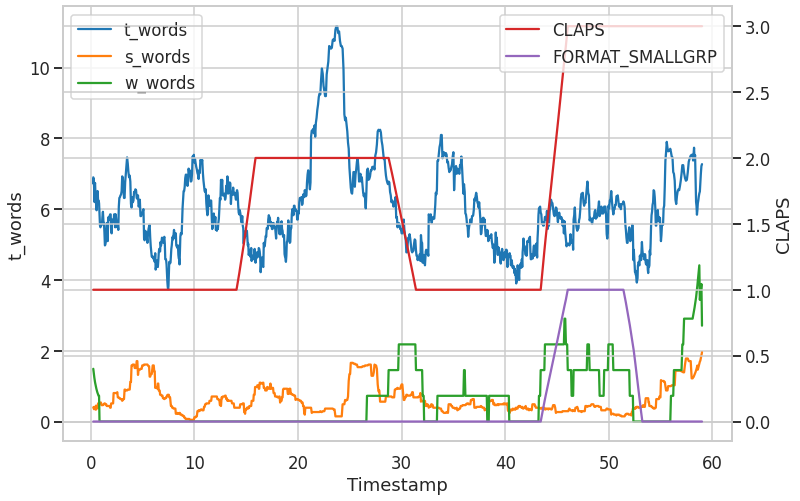

In [ ]:
make_class_heartbeat(450, legend=True)

In [ ]:
df[df.OBSID == 450]

,speaker,text,year,OBSID,video_id,cleaned_text,num_words,turn_idx,comb_idx,t,...,OERR4,STEXPL,SMQR,ETCA,OSPMMR,OSPMMR4,STUCON,STUCOM,SMALDIS,MMSM
1046585,teacher,All right everybody.,1,450,328,all right everybody so yesterday we started ou...,3,0,450_0,1,...,NaN,0.25,0.25,0.0,0.5,NaN,NaN,NaN,NaN,NaN
1046586,teacher,"So, yesterday we started our new unit on fract...",1,450,328,all right everybody so yesterday we started ou...,22,0,450_0,1,...,NaN,0.25,0.25,0.0,0.5,NaN,NaN,NaN,NaN,NaN
1046587,teacher,Who can remind me of the two fractions we talk...,1,450,328,all right everybody so yesterday we started ou...,12,0,450_0,1,...,NaN,0.25,0.25,0.0,0.5,NaN,NaN,NaN,NaN,NaN
1046588,teacher,Two of them?,1,450,328,all right everybody so yesterday we started ou...,3,0,450_0,1,...,NaN,0.25,0.25,0.0,0.5,NaN,NaN,NaN,NaN,NaN
1046589,teacher,<UNK> what was one fraction?,1,450,328,all right everybody so yesterday we started ou...,5,0,450_0,1,...,NaN,0.25,0.25,0.0,0.5,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1047675,teacher,When you shade in seven eighths there’s only o...,1,450,328,absolutely so when you filled in one eighth th...,12,404,450_404,1,...,NaN,0.25,0.25,0.5,0.5,NaN,NaN,NaN,NaN,NaN
1047676,teacher,One eighth plus seven eighths equals eight eig...,1,450,328,absolutely so when you filled in one eighth th...,8,404,450_404,1,...,NaN,0.25,0.25,0.5,0.5,NaN,NaN,NaN,NaN,NaN
1047677,teacher,That gives you your whole.,1,450,328,absolutely so when you filled in one eighth th...,5,404,450_404,1,...,NaN,0.25,0.25,0.5,0.5,NaN,NaN,NaN,NaN,NaN
1047678,teacher,Right?,1,450,328,absolutely so when you filled in one eighth th...,1,404,450_404,1,...,NaN,0.25,0.25,0.5,0.5,NaN,NaN,NaN,NaN,NaN


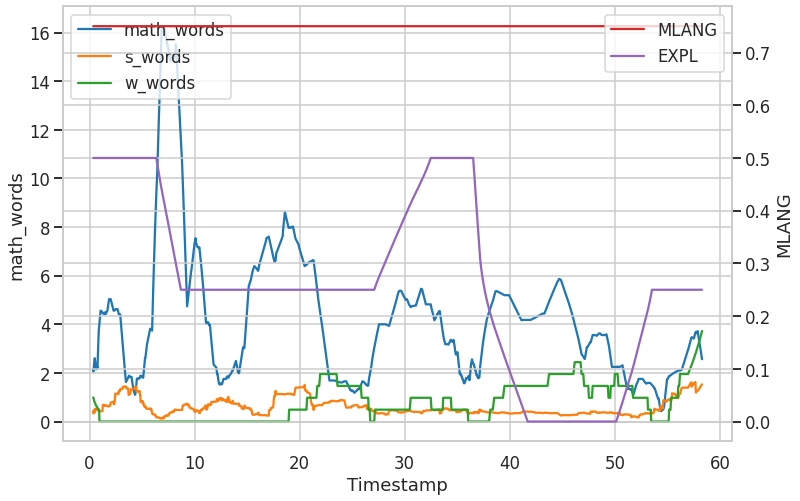

In [ ]:
ob = 450
make_class_heartbeat(ob, first_axis_vars = ['math_words','s_words','w_words'],
                         second_axis_vars = ['MLANG','EXPL'],
                         xvar = 'timestamp',
                         xinrolling = True, legend = True,
                         window = 60)

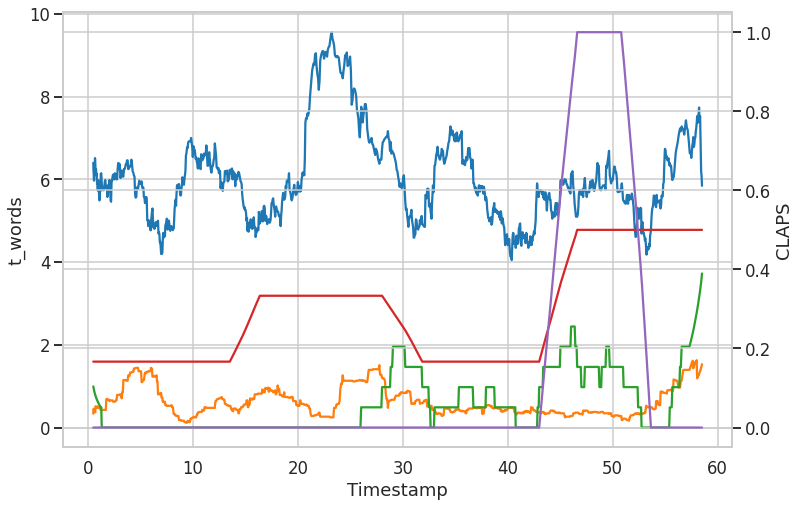

In [ ]:
ob = 450
make_class_heartbeat(ob, first_axis_vars = ['t_words','s_words','w_words'],
                         second_axis_vars = ['CLAPS','FORMAT_SMALLGRP'],
                         xvar = 'timestamp',
                         xinrolling = True, legend = False,
                         window = 60)

### Old (to compare w new)

<ipython-input-113-f880ec7d981f>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[second_axis_vars] = scaler.fit_transform(df[second_axis_vars])


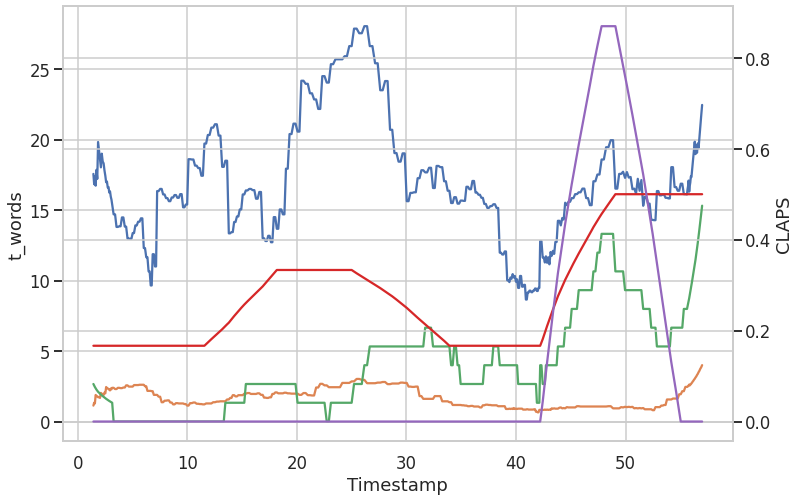

In [ ]:
ob = 450
make_class_heartbeat(ob, first_axis_vars = ['t_words','s_words','w_words'],
                         second_axis_vars = ['CLAPS','FORMAT_SMALLGRP'],
                         xvar = 'timestamp',
                         xinrolling = True, legend = False,
                         window = 45)

### New

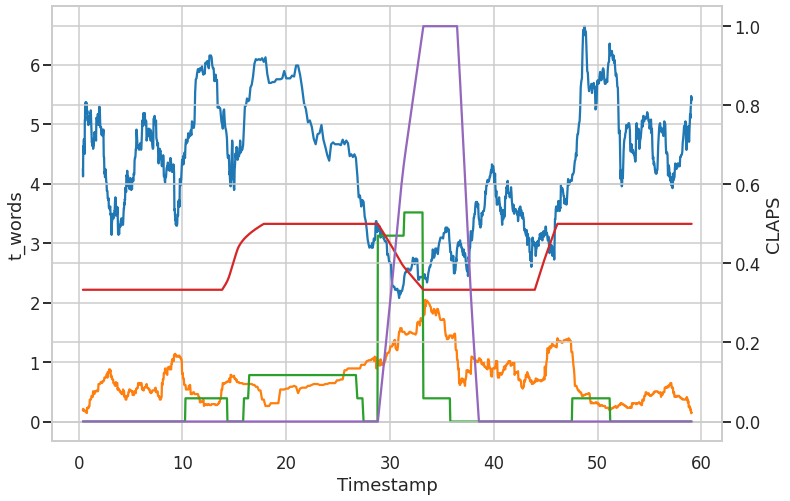

In [ ]:
ob = 737
make_class_heartbeat(ob, first_axis_vars = ['t_words','s_words','w_words'],
                         second_axis_vars = ['CLAPS','FORMAT_SMALLGRP'],
                         xvar = 'timestamp',
                         xinrolling = True, legend = False,
                         window = 64)

### trends across ratings sanity checks

In [ ]:
mod = smf.ols('scoreSTA ~ math_words + MLANG + DENSMAT', data = df)

ValueError: ignored

In [ ]:
df.density

0          0.022796
1          0.000000
2          0.026316
3          0.000000
4          0.000000
             ...   
1412724    0.000000
1412725    0.000000
1412726    0.000000
1412727    0.000000
1412728    0.000000
Name: density, Length: 1412729, dtype: float64

In [ ]:
for ob in df.OBSID.unique():
  if ob in v.OBSID.unique():
    df.loc[df.OBSID==ob,"DENSMAT"] = v.loc[v.OBSID == ob,'DENSMAT'].max()

In [ ]:
gc.collect()

104473

In [ ]:
asdf = df.groupby('OBSID').mean().reset_index()[['OBSID','DENSMAT','density','scoreSTA','scoreALT','MLANG','EXPL','math_words','t_math','s_math','avgscoreSTA','avgscoreALT']]
asdf['DENSMAT']

0       NaN
1       NaN
2       NaN
3       NaN
4       NaN
       ... 
1653    2.0
1654    2.0
1655    3.0
1656    2.0
1657    2.0
Name: DENSMAT, Length: 1658, dtype: float64

In [ ]:
vals = v.groupby('OBSID').mean()['DENSMAT']

In [ ]:
asdf['DENSMAT'] = vals[vals.index.isin(asdf.OBSID.unique())].reset_index()['DENSMAT']

In [ ]:
v.DENSMAT.value_counts()

2.0    559
1.0    298
3.0    154
0.0     42
4.0     33
Name: DENSMAT, dtype: int64

In [ ]:
asdf = df.groupby('OBSID').mean().reset_index()[['density','DENSMAT','scoreSTA','scoreALT','MLANG','s_math','avgscoreSTA','avgscoreALT']]

In [ ]:
asdf['DENSROUN'] = asdf.DENSMAT.round()

In [ ]:
asdf.shape

(1658, 8)

In [ ]:
asdf.DENSROUN.value_counts()

1.0    175
0.0    171
Name: DENSROUN, dtype: int64

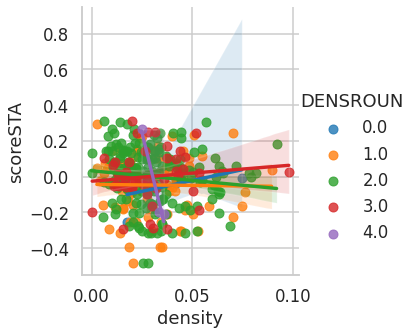

In [ ]:
sns.lmplot(data= asdf, x = 'density',y='scoreSTA',hue = 'DENSROUN', figs)

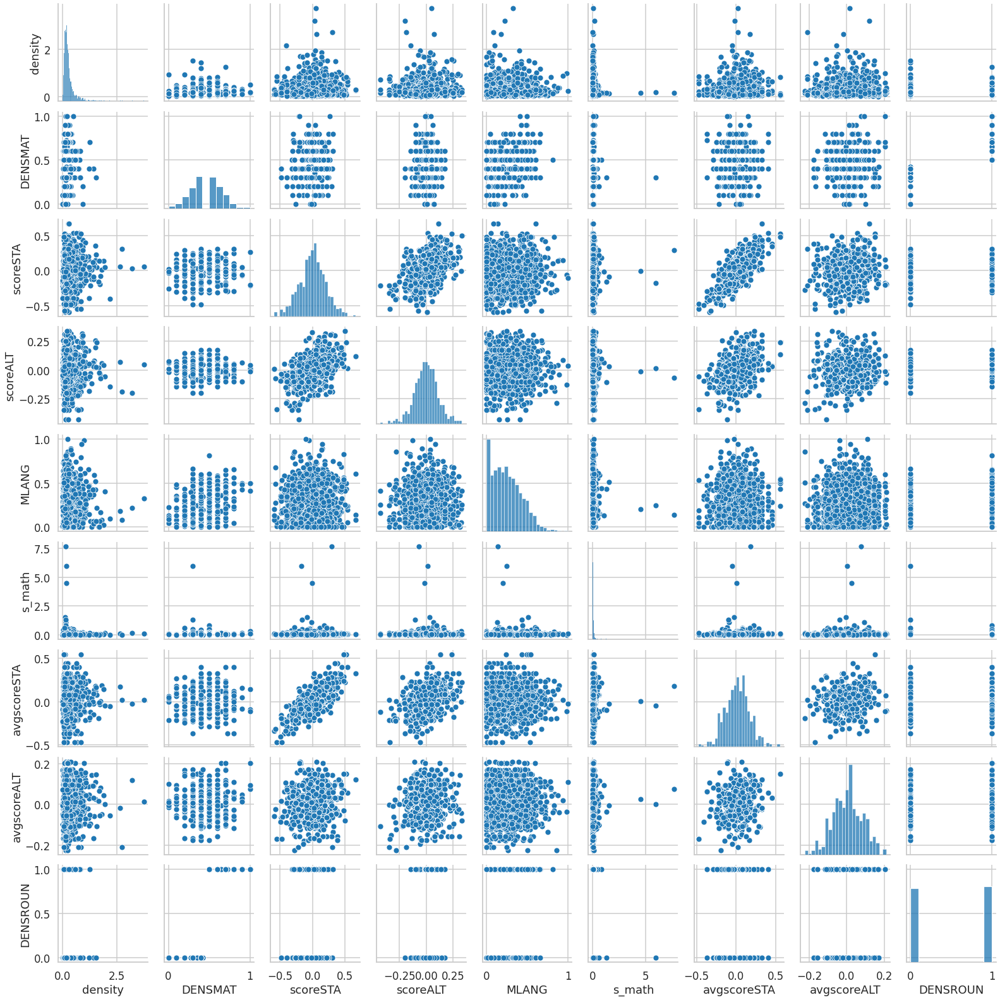

In [ ]:
sns.pairplot(data=asdf)

In [ ]:
# sns.heatmap(data=asdf[['density','DENSROUN','DENSMAT','scoreSTA','scoreALT','MLANG','s_math']])

In [ ]:
mod = smf.ols('scoreSTA ~ density', data=asdf)
res = mod.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:               scoreSTA   R-squared:                       0.001
Model:                            OLS   Adj. R-squared:                  0.000
Method:                 Least Squares   F-statistic:                     1.772
Date:                Fri, 24 Mar 2023   Prob (F-statistic):              0.183
Time:                        00:40:13   Log-Likelihood:                 314.78
No. Observations:                1577   AIC:                            -625.6
Df Residuals:                    1575   BIC:                            -614.8
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept     -0.0052      0.007     -0.729      0.466      -0.019       0.009
density        0.0234      0.018      1.331      0.183      -0.011       0.058
==============================================================================
Omnibus:                        2.775   Durbin-Watson:                   1.764
Prob(Omnibus):                  0.250   Jarque-Bera (JB):                2.779
Skew:                          -0.059   Prob(JB):                        0.249
Kurtosis:                       3.169   Cond. No.                         3.85
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [ ]:
mod = smf.ols('avgscoreSTA ~ density', data=asdf)
res = mod.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:            avgscoreSTA   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.000
Method:                 Least Squares   F-statistic:                    0.4938
Date:                Fri, 24 Mar 2023   Prob (F-statistic):              0.482
Time:                        00:40:23   Log-Likelihood:                 755.34
No. Observations:                1612   AIC:                            -1507.
Df Residuals:                    1610   BIC:                            -1496.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.0096      0.005      1.770      0.077      -0.001       0.020
density        0.0094      0.013      0.703      0.482      -0.017       0.036
==============================================================================
Omnibus:                       12.042   Durbin-Watson:                   1.941
Prob(Omnibus):                  0.002   Jarque-Bera (JB):               16.837
Skew:                           0.050   Prob(JB):                     0.000221
Kurtosis:                       3.491   Cond. No.                         3.86
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [ ]:
mod = smf.ols('avgscoreSTA ~ DENSMAT ', data=asdf)
res = mod.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:            avgscoreSTA   R-squared:                       0.003
Model:                            OLS   Adj. R-squared:                  0.000
Method:                 Least Squares   F-statistic:                     1.056
Date:                Fri, 24 Mar 2023   Prob (F-statistic):              0.305
Time:                        00:32:08   Log-Likelihood:                 184.02
No. Observations:                 343   AIC:                            -364.0
Df Residuals:                     341   BIC:                            -356.4
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept     -0.0116      0.020     -0.576      0.565      -0.051       0.028
DENSMAT        0.0420      0.041      1.028      0.305      -0.038       0.122
==============================================================================
Omnibus:                        0.456   Durbin-Watson:                   2.075
Prob(Omnibus):                  0.796   Jarque-Bera (JB):                0.582
Skew:                          -0.050   Prob(JB):                        0.747
Kurtosis:                       2.824   Cond. No.                         6.48
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [ ]:
mod = smf.ols('scoreSTA ~ DENSMAT', data=asdf)
res = mod.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:               scoreSTA   R-squared:                       0.014
Model:                            OLS   Adj. R-squared:                  0.011
Method:                 Least Squares   F-statistic:                     4.554
Date:                Fri, 24 Mar 2023   Prob (F-statistic):             0.0336
Time:                        00:32:13   Log-Likelihood:                 141.34
No. Observations:                 331   AIC:                            -278.7
Df Residuals:                     329   BIC:                            -271.1
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept     -0.0578      0.023     -2.565      0.011      -0.102      -0.013
DENSMAT        0.0979      0.046      2.134      0.034       0.008       0.188
==============================================================================
Omnibus:                        8.350   Durbin-Watson:                   1.828
Prob(Omnibus):                  0.015   Jarque-Bera (JB):                8.664
Skew:                          -0.386   Prob(JB):                       0.0131
Kurtosis:                       2.818   Cond. No.                         6.39
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [ ]:
mod = smf.ols('scoreALT ~ MLANG + DENSMAT + density', data=asdf)
res = mod.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:               scoreALT   R-squared:                       0.007
Model:                            OLS   Adj. R-squared:                 -0.003
Method:                 Least Squares   F-statistic:                    0.6982
Date:                Fri, 24 Mar 2023   Prob (F-statistic):              0.554
Time:                        00:32:27   Log-Likelihood:                 422.74
No. Observations:                 320   AIC:                            -837.5
Df Residuals:                     316   BIC:                            -822.4
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept     -0.0151      0.012     -1.299      0.195      -0.038       0.008
MLANG          0.0099      0.023      0.435      0.664      -0.035       0.055
DENSMAT        0.0188      0.020      0.930      0.353      -0.021       0.059
density        0.0175      0.018      0.950      0.343      -0.019       0.054
==============================================================================
Omnibus:                        2.227   Durbin-Watson:                   1.972
Prob(Omnibus):                  0.328   Jarque-Bera (JB):                1.940
Skew:                          -0.168   Prob(JB):                        0.379
Kurtosis:                       3.179   Cond. No.                         7.88
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [ ]:
mod = smf.ols('scoreSTA ~ MLANG + DENSMAT + density', data=asdf)
res = mod.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:               scoreSTA   R-squared:                       0.016
Model:                            OLS   Adj. R-squared:                  0.007
Method:                 Least Squares   F-statistic:                     1.826
Date:                Fri, 24 Mar 2023   Prob (F-statistic):              0.142
Time:                        00:32:35   Log-Likelihood:                 141.81
No. Observations:                 331   AIC:                            -275.6
Df Residuals:                     327   BIC:                            -260.4
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept     -0.0712      0.027     -2.638      0.009      -0.124      -0.018
MLANG          0.0122      0.054      0.225      0.822      -0.095       0.119
DENSMAT        0.0965      0.048      2.010      0.045       0.002       0.191
density        0.0422      0.044      0.957      0.339      -0.045       0.129
==============================================================================
Omnibus:                        8.114   Durbin-Watson:                   1.835
Prob(Omnibus):                  0.017   Jarque-Bera (JB):                8.391
Skew:                          -0.377   Prob(JB):                       0.0151
Kurtosis:                       2.800   Cond. No.                         7.83
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [ ]:
mod = smf.ols('scoreALT ~ cluster_ts12+ density + DENSMAT', data=asdf)
res = mod.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:               scoreALT   R-squared:                       0.027
Model:                            OLS   Adj. R-squared:                 -0.014
Method:                 Least Squares   F-statistic:                    0.6509
Date:                Wed, 22 Mar 2023   Prob (F-statistic):              0.810
Time:                        01:05:26   Log-Likelihood:                 426.05
No. Observations:                 320   AIC:                            -824.1
Df Residuals:                     306   BIC:                            -771.3
Df Model:                          13                                         
Covariance Type:            nonrobust                                         
======================================================================================
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Intercept             -0.0081      0.021     -0.380      0.704      -0.050       0.034
cluster_ts12[T.1]     -0.0028      0.021     -0.133      0.894      -0.044       0.039
cluster_ts12[T.2]     -0.0107      0.021     -0.516      0.606      -0.051       0.030
cluster_ts12[T.3]     -0.0084      0.025     -0.332      0.740      -0.058       0.041
cluster_ts12[T.4]     -0.0206      0.023     -0.903      0.367      -0.066       0.024
cluster_ts12[T.5]     -0.0049      0.021     -0.230      0.818      -0.047       0.037
cluster_ts12[T.6]      0.0070      0.024      0.292      0.770      -0.040       0.054
cluster_ts12[T.7]      0.0174      0.020      0.855      0.393      -0.023       0.057
cluster_ts12[T.8]      0.0011      0.021      0.052      0.958      -0.041       0.043
cluster_ts12[T.9]     -0.0018      0.023     -0.077      0.939      -0.047       0.044
cluster_ts12[T.10]     0.0076      0.029      0.263      0.792      -0.049       0.064
cluster_ts12[T.11]    -0.0119      0.018     -0.651      0.515      -0.048       0.024
density               -0.0111      0.213     -0.052      0.959      -0.431       0.409
DENSMAT                0.0072      0.006      1.203      0.230      -0.005       0.019
==============================================================================
Omnibus:                        1.189   Durbin-Watson:                   1.966
Prob(Omnibus):                  0.552   Jarque-Bera (JB):                1.040
Skew:                          -0.137   Prob(JB):                        0.594
Kurtosis:                       3.052   Cond. No.                         129.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [ ]:
tdf = pd.read_pickle(DATA_FOLDER + "clusterfun.pkl")

In [ ]:
tdf

,cluster,t_words,STA,ALT,model_grade,cluster4,cluster9,cluster14,cluster19,cluster24,cluster_ts5,cluster_ts10,cluster_ts12,cluster_ts15,cluster_ts20,cluster_ts25
3,18,"[[[18.8, 3.9, 0.3, 0.0, 4.104166666666666, -0....",0.435624,0.193349,3.533333,3,1,4,17,8,0,4,0,13,4,11
4,7,"[[[21.3, 5.5, 1.45, 0.15, 3.80625, 0.183001995...",0.023429,-0.124524,4.212121,3,3,1,11,15,0,0,9,13,15,7
5,22,"[[[10.4, 1.2, 0.2, 0.0, 6.036666666666667, -0....",-0.233030,-0.308506,3.907357,0,3,0,4,0,0,7,8,9,4,2
7,18,"[[[14.4, 1.8, 0.0, 0.0, 1.453888888888889, -0....",0.007188,-0.075207,4.287834,3,4,6,13,18,2,4,1,10,6,14
8,21,"[[[25.75, 1.7, 0.4, 0.0, 11.1525, 0.0457979999...",0.143901,-0.039028,4.040404,3,0,8,9,10,2,5,5,0,3,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4758,14,"[[[35.13636363636363, 1.1818181818181819, 0.45...",NaN,NaN,NaN,0,4,10,18,0,4,1,10,2,13,12
4759,16,"[[[21.454545454545453, 1.0909090909090908, 0.0...",NaN,NaN,NaN,3,1,1,10,13,1,9,4,7,5,8
4760,19,"[[[5.681818181818182, 0.7272727272727273, 0.04...",NaN,NaN,NaN,3,0,6,3,5,2,5,0,2,3,22
4762,4,"[[[10.318181818181818, 0.9090909090909091, 0.0...",NaN,NaN,NaN,3,0,12,9,11,2,3,7,3,6,14


In [ ]:
asdf = pd.merge(asdf, tdf, how= 'inner',left_on = 'OBSID',right_index=True,suffixes=['','_'])

tdf.reset_index()

KeyError: ignored

In [ ]:
asdf['cluster_ts15'] = asdf.cluster_ts15.astype('category')

508


<ipython-input-180-fe9c15cb6a6f>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])
<ipython-input-180-fe9c15cb6a6f>:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[second_axis_vars] = scaler.fit_transform(tdf[second_axis_vars])


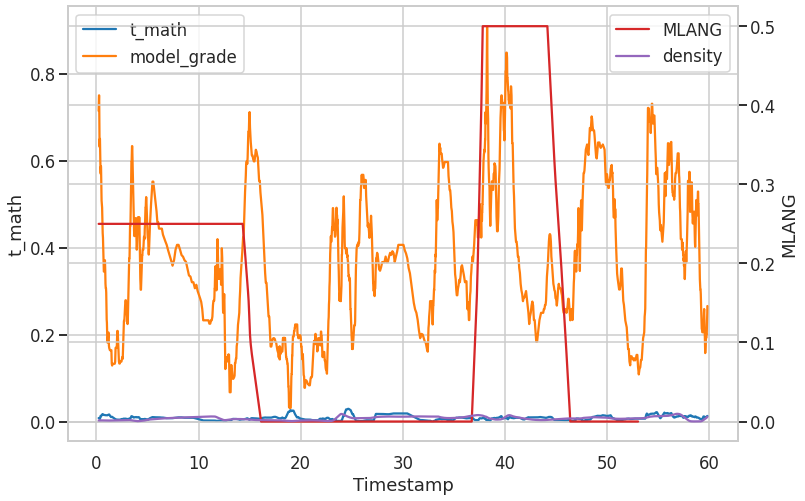

2177


<ipython-input-180-fe9c15cb6a6f>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])
<ipython-input-180-fe9c15cb6a6f>:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[second_axis_vars] = scaler.fit_transform(tdf[second_axis_vars])


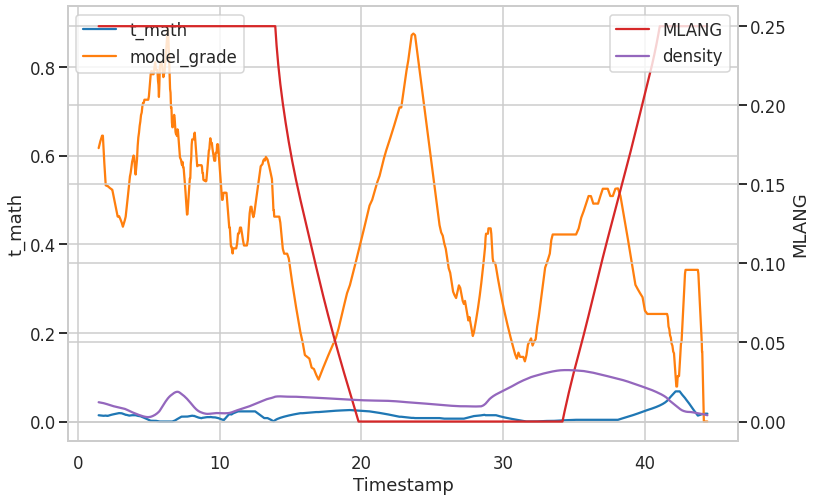

2959


<ipython-input-180-fe9c15cb6a6f>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])
<ipython-input-180-fe9c15cb6a6f>:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[second_axis_vars] = scaler.fit_transform(tdf[second_axis_vars])


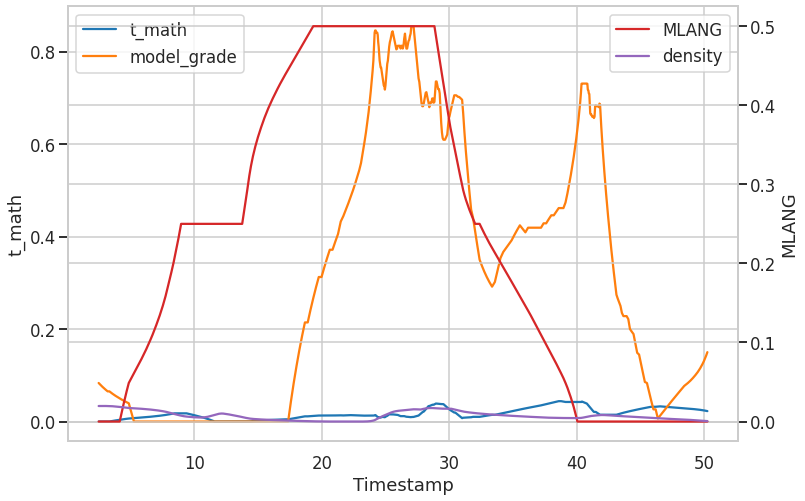

4230


<ipython-input-180-fe9c15cb6a6f>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])
<ipython-input-180-fe9c15cb6a6f>:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[second_axis_vars] = scaler.fit_transform(tdf[second_axis_vars])


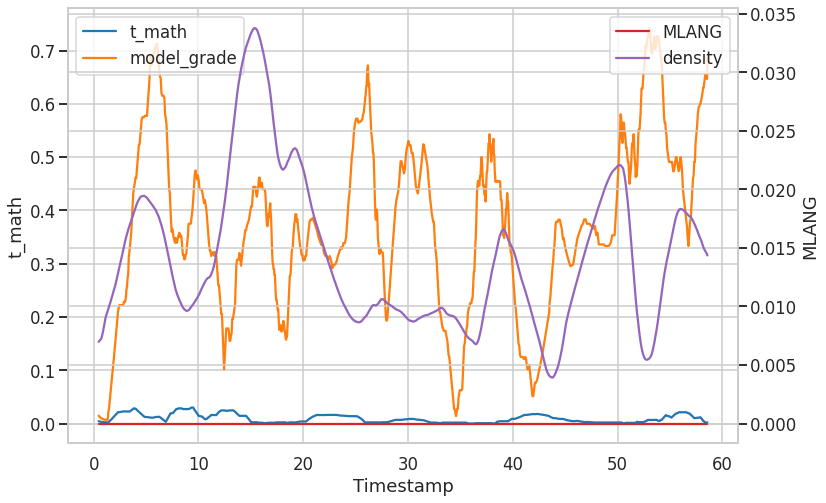

2727


<ipython-input-180-fe9c15cb6a6f>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])
<ipython-input-180-fe9c15cb6a6f>:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[second_axis_vars] = scaler.fit_transform(tdf[second_axis_vars])


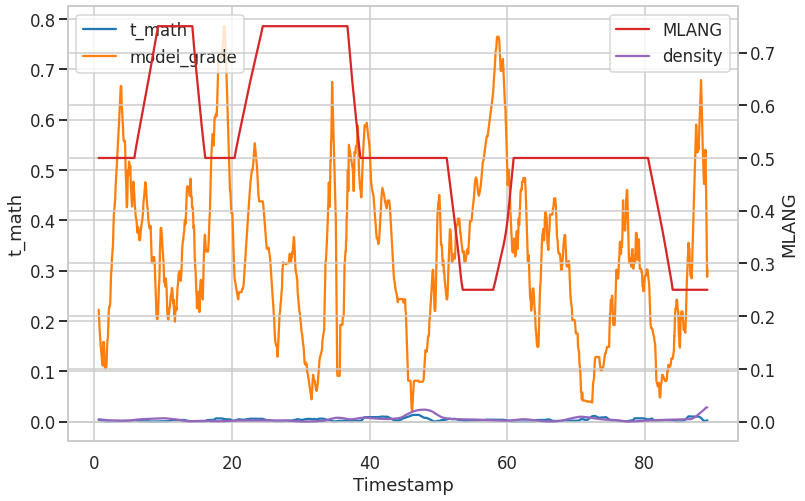

13


<ipython-input-180-fe9c15cb6a6f>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])
<ipython-input-180-fe9c15cb6a6f>:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[second_axis_vars] = scaler.fit_transform(tdf[second_axis_vars])


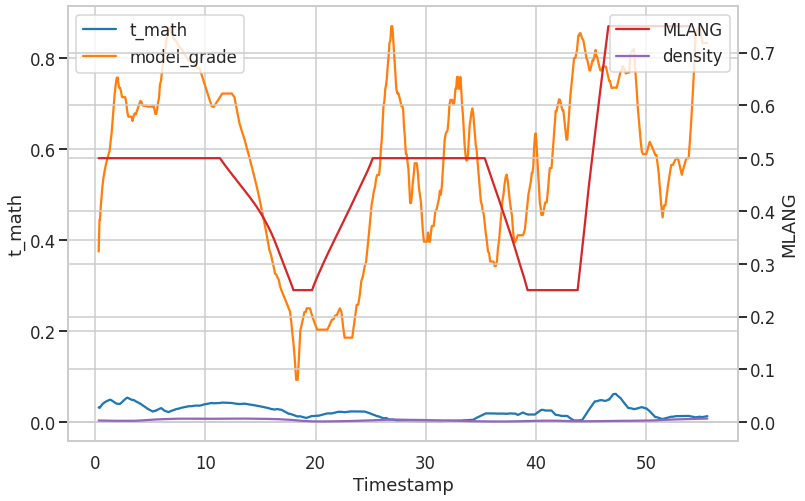

4419


<ipython-input-180-fe9c15cb6a6f>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])
<ipython-input-180-fe9c15cb6a6f>:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[second_axis_vars] = scaler.fit_transform(tdf[second_axis_vars])


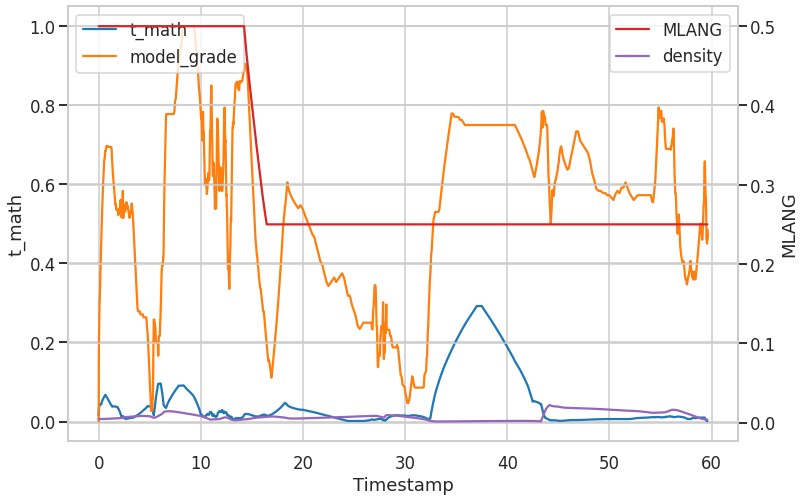

961


<ipython-input-180-fe9c15cb6a6f>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])
<ipython-input-180-fe9c15cb6a6f>:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[second_axis_vars] = scaler.fit_transform(tdf[second_axis_vars])


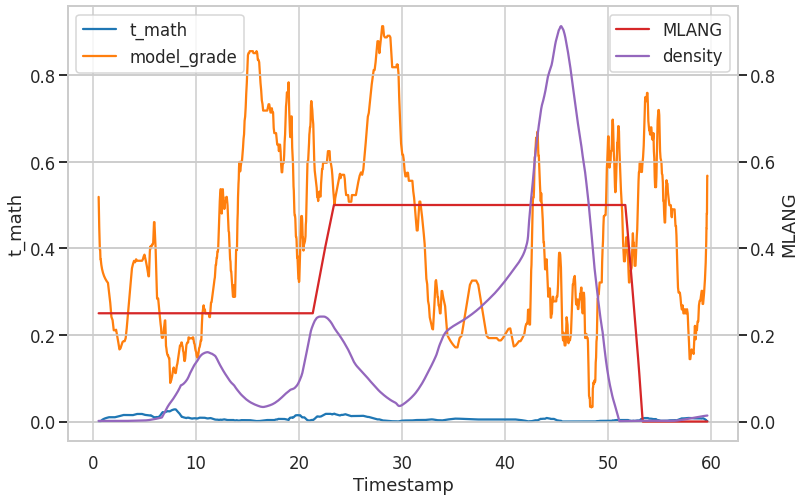

522


<ipython-input-180-fe9c15cb6a6f>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])
<ipython-input-180-fe9c15cb6a6f>:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[second_axis_vars] = scaler.fit_transform(tdf[second_axis_vars])


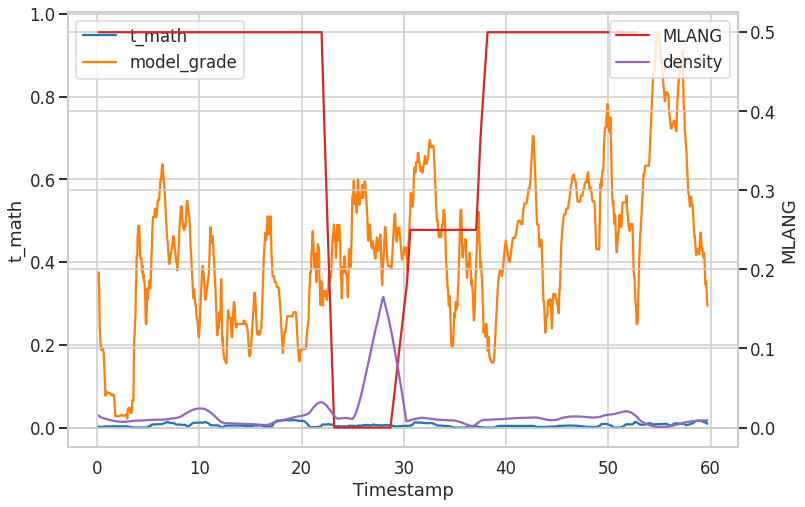

779


<ipython-input-180-fe9c15cb6a6f>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])
<ipython-input-180-fe9c15cb6a6f>:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[second_axis_vars] = scaler.fit_transform(tdf[second_axis_vars])


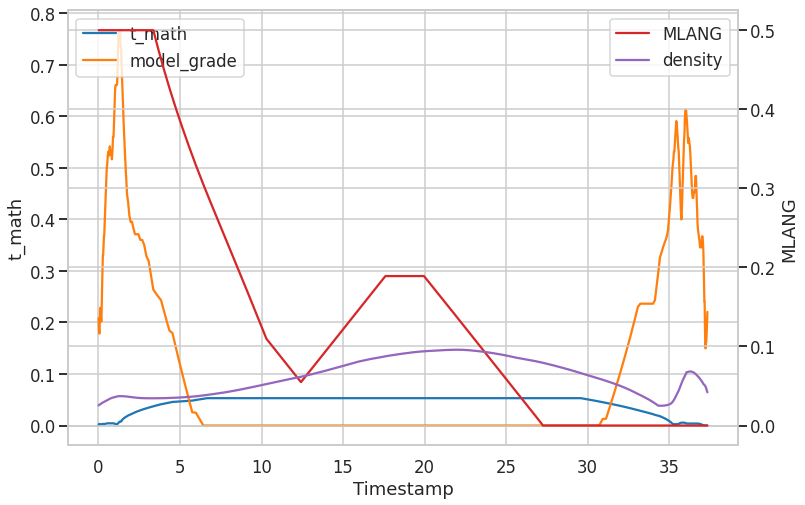

78


<ipython-input-180-fe9c15cb6a6f>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])
<ipython-input-180-fe9c15cb6a6f>:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[second_axis_vars] = scaler.fit_transform(tdf[second_axis_vars])


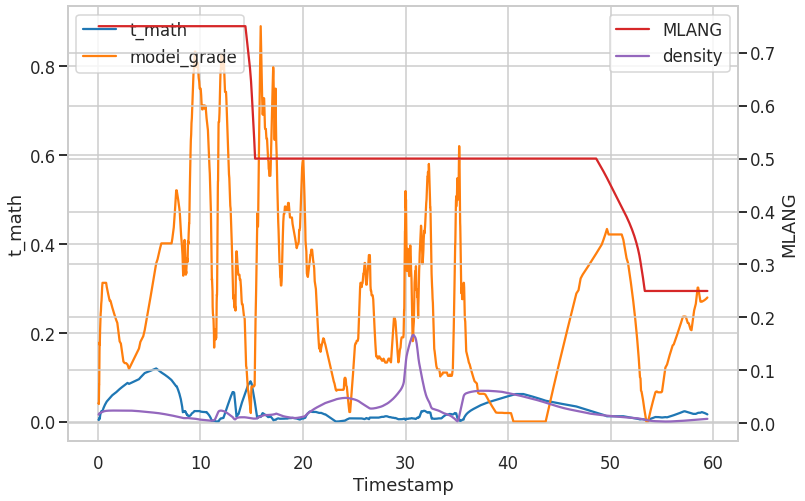

2588


<ipython-input-180-fe9c15cb6a6f>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])
<ipython-input-180-fe9c15cb6a6f>:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[second_axis_vars] = scaler.fit_transform(tdf[second_axis_vars])


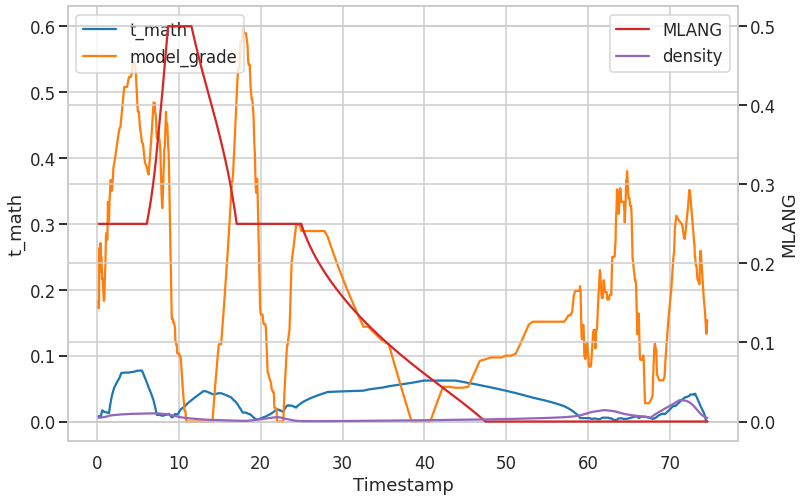

4054


<ipython-input-180-fe9c15cb6a6f>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])
<ipython-input-180-fe9c15cb6a6f>:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[second_axis_vars] = scaler.fit_transform(tdf[second_axis_vars])


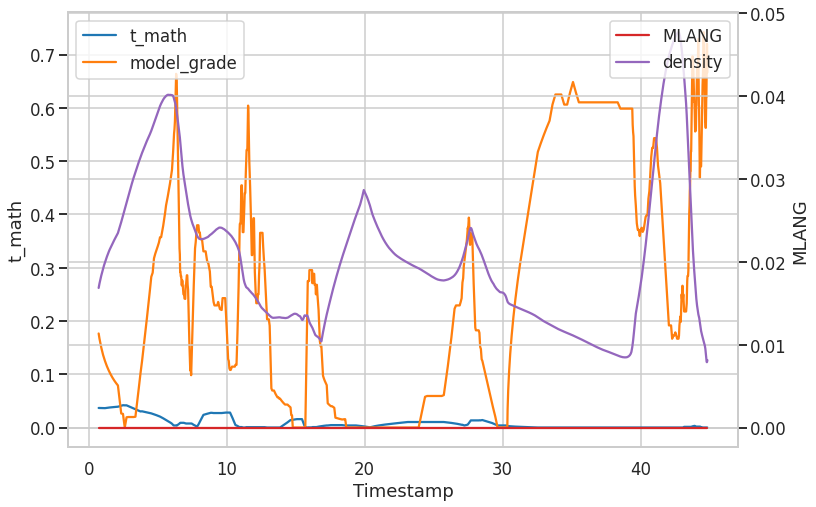

2757


<ipython-input-180-fe9c15cb6a6f>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])
<ipython-input-180-fe9c15cb6a6f>:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[second_axis_vars] = scaler.fit_transform(tdf[second_axis_vars])


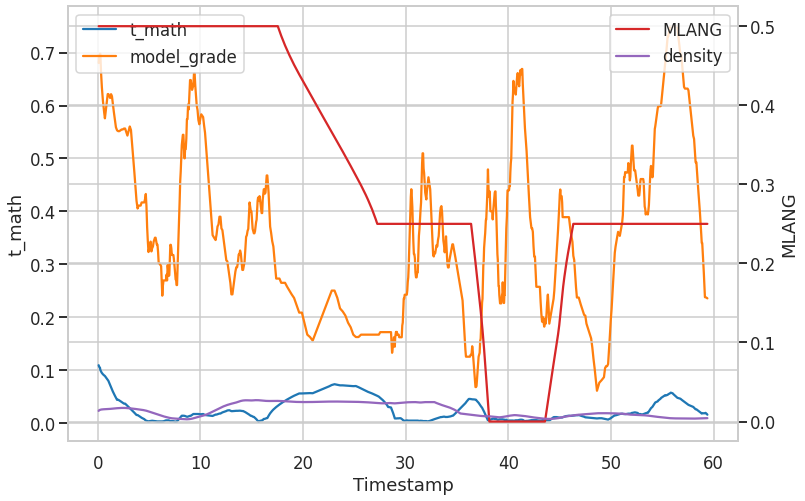

573


<ipython-input-180-fe9c15cb6a6f>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])
<ipython-input-180-fe9c15cb6a6f>:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[second_axis_vars] = scaler.fit_transform(tdf[second_axis_vars])


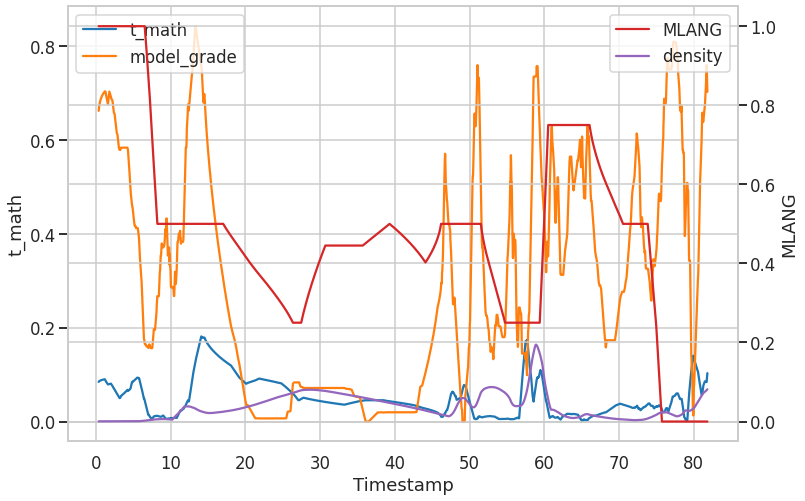

2395


<ipython-input-180-fe9c15cb6a6f>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])
<ipython-input-180-fe9c15cb6a6f>:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[second_axis_vars] = scaler.fit_transform(tdf[second_axis_vars])


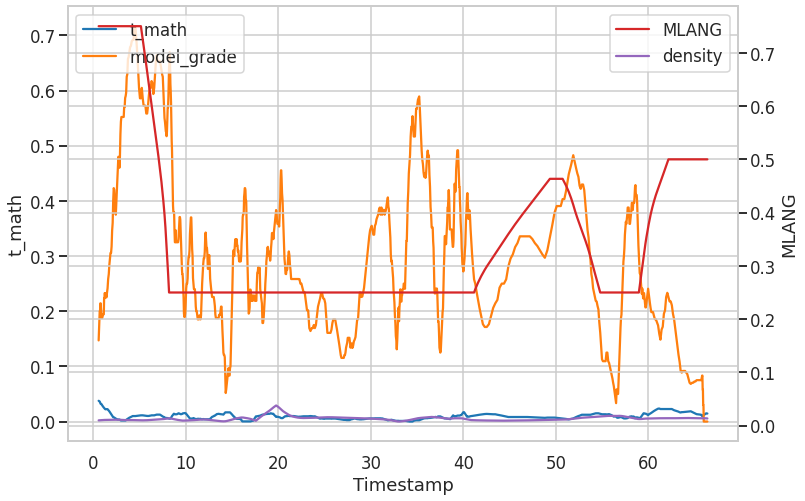

4685


<ipython-input-180-fe9c15cb6a6f>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])
<ipython-input-180-fe9c15cb6a6f>:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[second_axis_vars] = scaler.fit_transform(tdf[second_axis_vars])


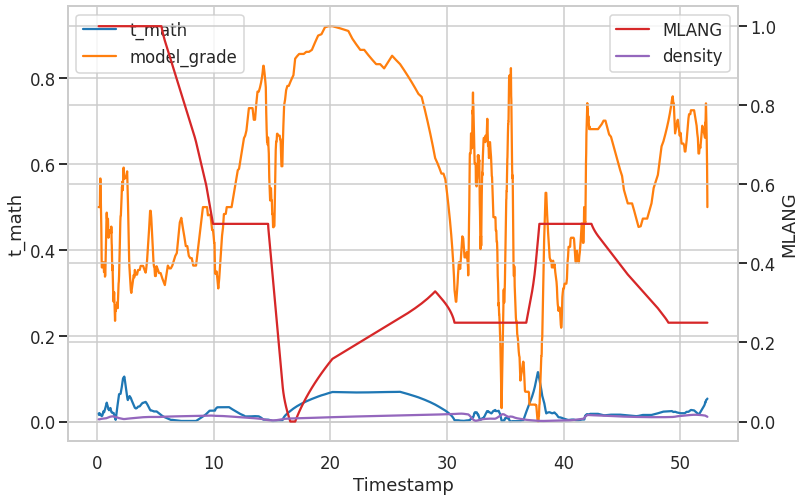

2950


<ipython-input-180-fe9c15cb6a6f>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])
<ipython-input-180-fe9c15cb6a6f>:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[second_axis_vars] = scaler.fit_transform(tdf[second_axis_vars])


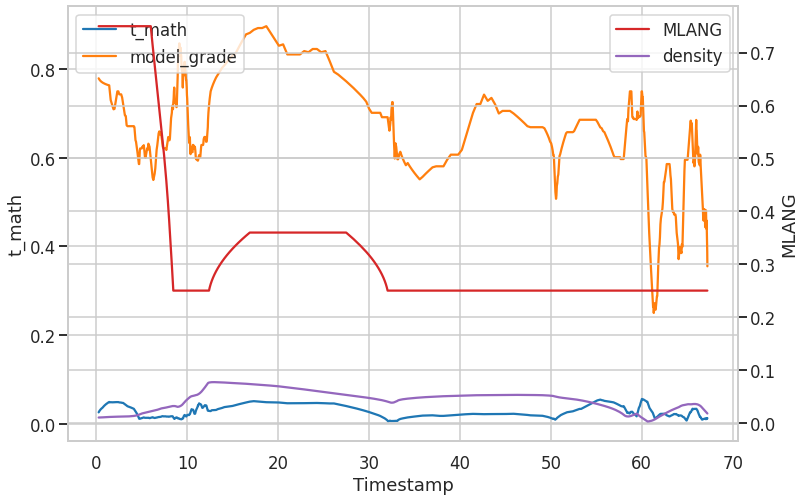

2472


<ipython-input-180-fe9c15cb6a6f>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])
<ipython-input-180-fe9c15cb6a6f>:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[second_axis_vars] = scaler.fit_transform(tdf[second_axis_vars])


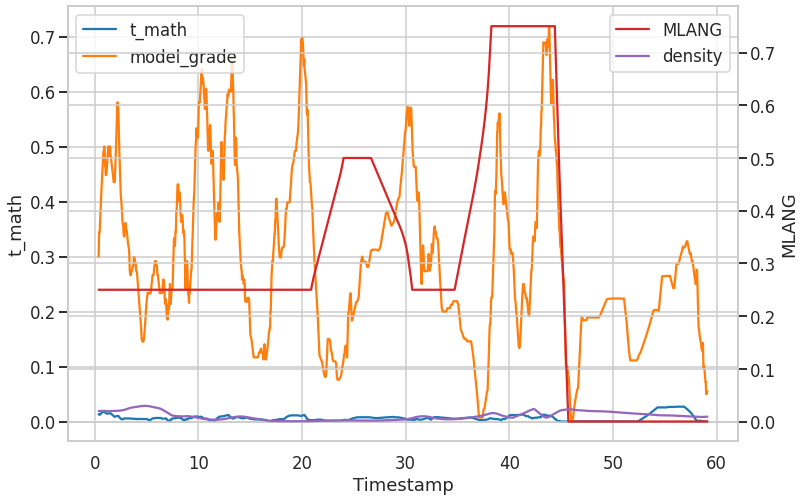

2117


<ipython-input-180-fe9c15cb6a6f>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])
<ipython-input-180-fe9c15cb6a6f>:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[second_axis_vars] = scaler.fit_transform(tdf[second_axis_vars])


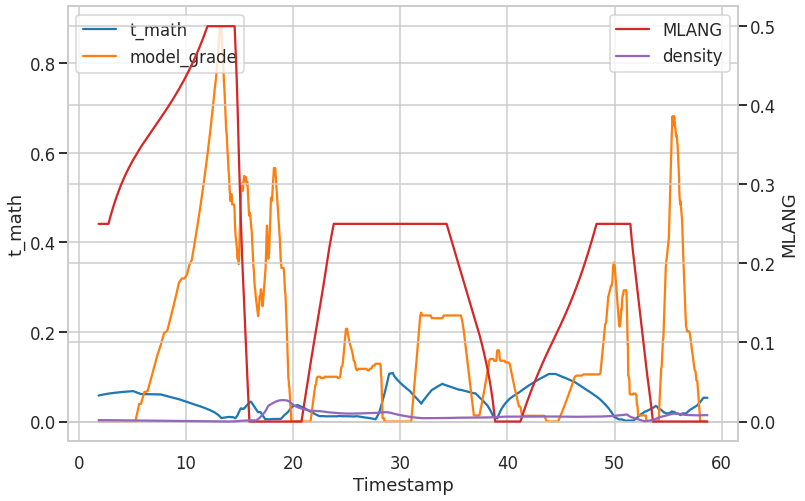

In [ ]:
ob = 16

for ob in df.OBSID.sample(20):
  print(ob)
  make_class_heartbeat(ob, first_axis_vars = ['t_math','model_grade'],
                          second_axis_vars = ['MLANG', 'density'],
                          xvar = 'timestamp',
                          xinrolling = True, legend= True, scale=True,
                          window = 40)

2800


<ipython-input-153-5237a2b62448>:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])
<ipython-input-153-5237a2b62448>:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[second_axis_vars] = scaler.fit_transform(df[second_axis_vars])


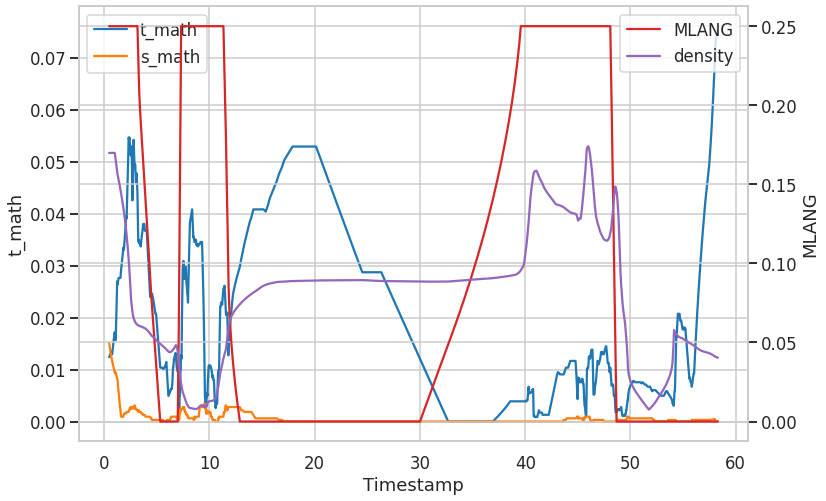

1013


<ipython-input-153-5237a2b62448>:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])
<ipython-input-153-5237a2b62448>:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[second_axis_vars] = scaler.fit_transform(df[second_axis_vars])


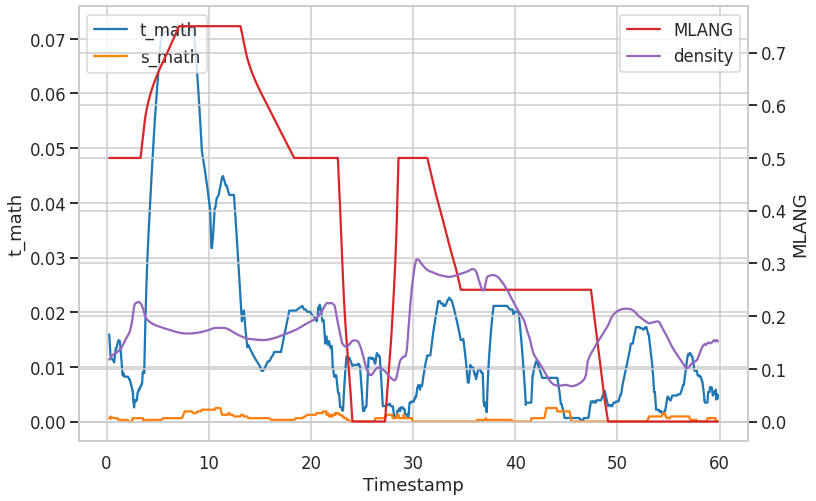

823


<ipython-input-153-5237a2b62448>:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])
<ipython-input-153-5237a2b62448>:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[second_axis_vars] = scaler.fit_transform(df[second_axis_vars])


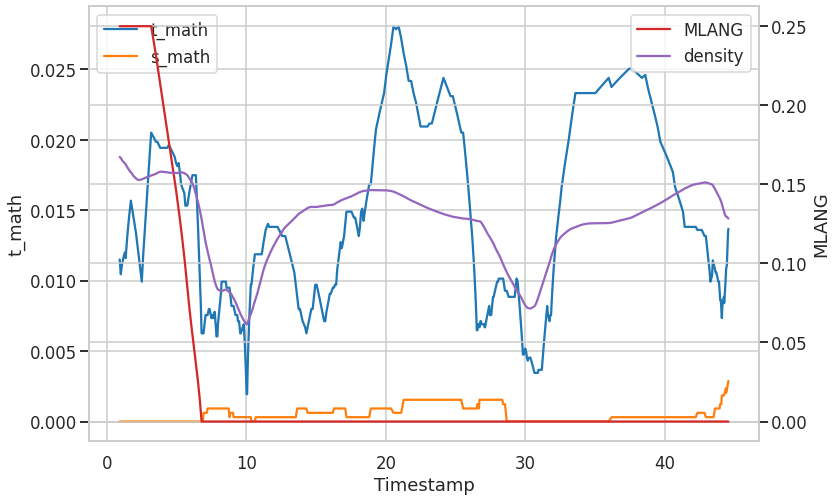

2930


<ipython-input-153-5237a2b62448>:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])
<ipython-input-153-5237a2b62448>:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[second_axis_vars] = scaler.fit_transform(df[second_axis_vars])


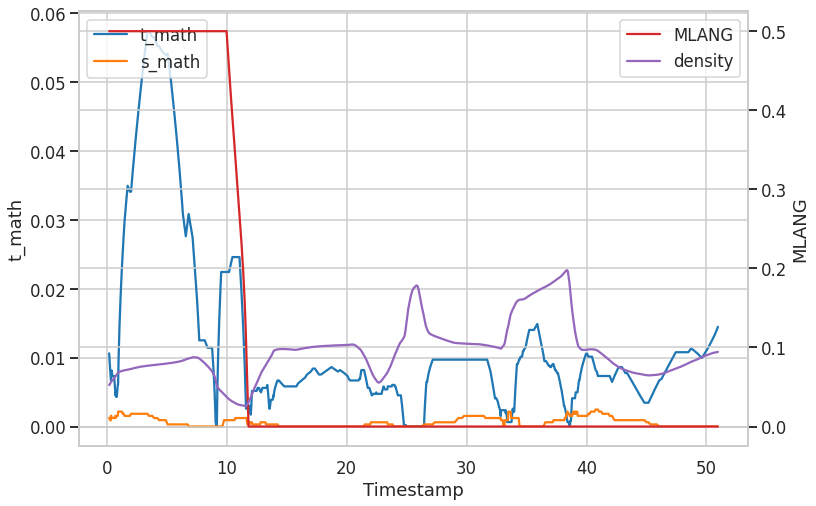

2072


<ipython-input-153-5237a2b62448>:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])
<ipython-input-153-5237a2b62448>:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[second_axis_vars] = scaler.fit_transform(df[second_axis_vars])


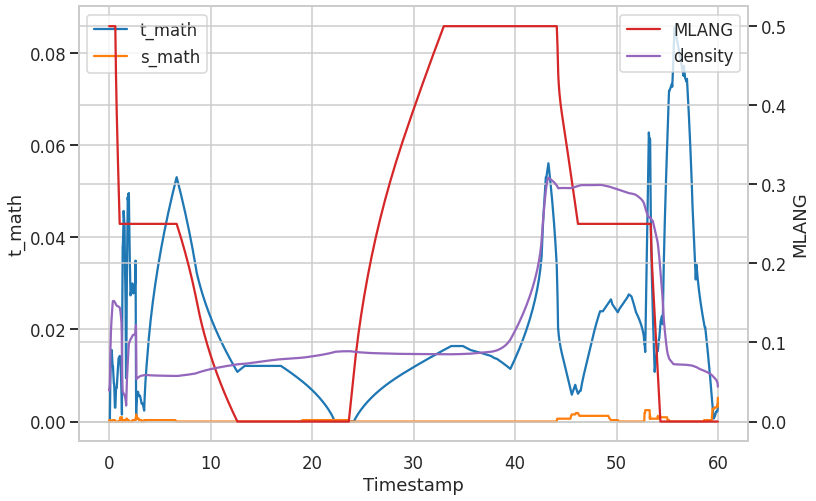

2153


<ipython-input-153-5237a2b62448>:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])
<ipython-input-153-5237a2b62448>:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[second_axis_vars] = scaler.fit_transform(df[second_axis_vars])
/usr/local/lib/python3.9/dist-packages/seaborn/_oldcore.py:1134: FutureWarning: reindexing with a non-unique Index is deprecated and will raise in a future version.
  comp_data.insert(0, var, comp_col)


ValueError: ignored

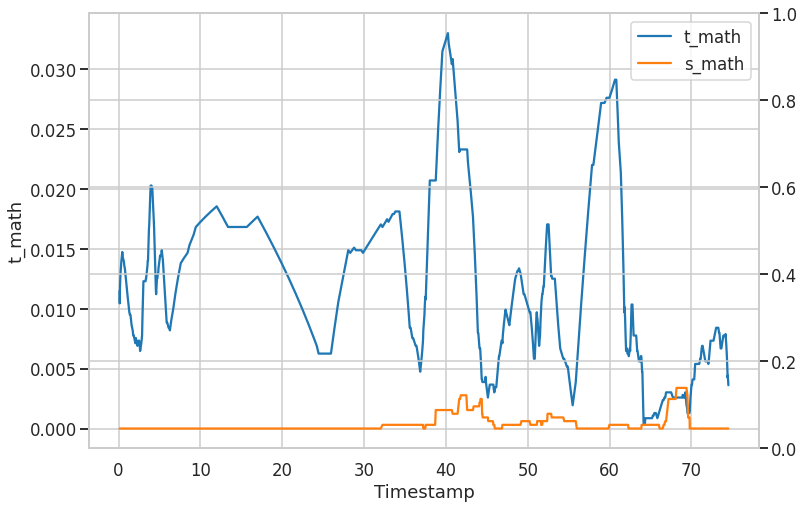

In [ ]:
ob = 16

for ob in df.OBSID.sample(20):
  print(ob)
  make_class_heartbeat(ob, first_axis_vars = ['t_math','s_math'],
                          second_axis_vars = ['MLANG', 'density'],
                          xvar = 'timestamp',
                          xinrolling = True, legend= True, scale=True,
                          window = 40)
  # make_class_heartbeat(ob, first_axis_vars = ['t_math'],
  #                         second_axis_vars = ['s_math'],
  #                         xvar = 'timestamp',
  #                         xinrolling = True,
  #                         window = 60)

197


<ipython-input-180-fe9c15cb6a6f>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])


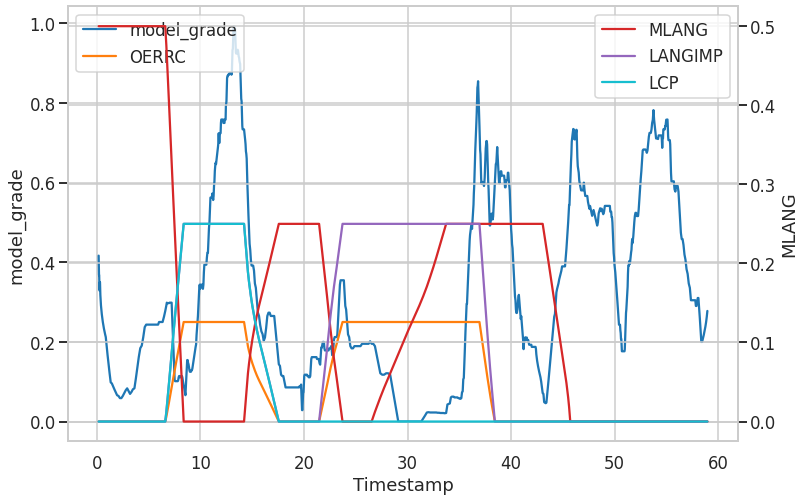

4008


<ipython-input-180-fe9c15cb6a6f>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])


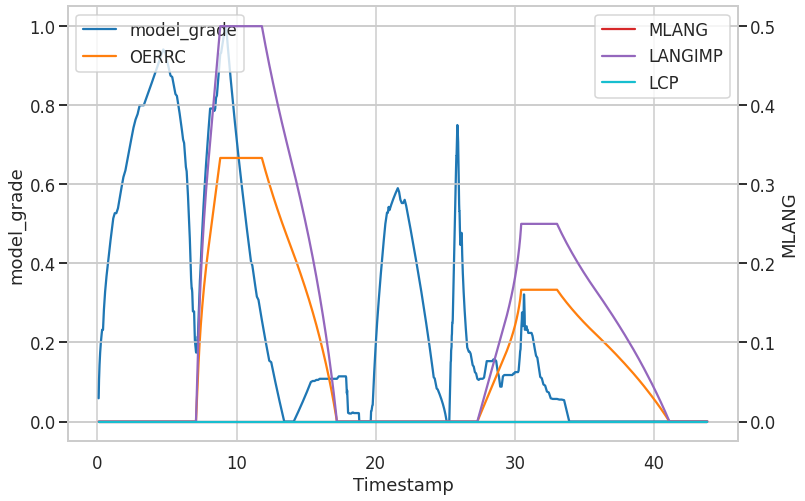

1005


<ipython-input-180-fe9c15cb6a6f>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])


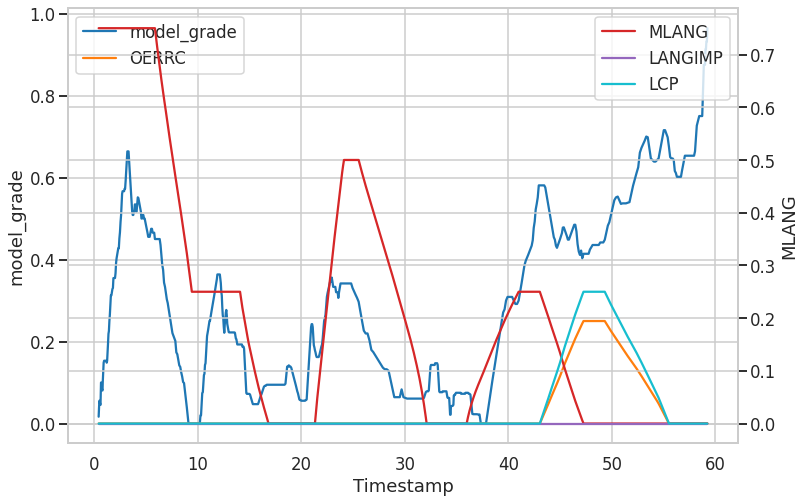

678


<ipython-input-180-fe9c15cb6a6f>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])


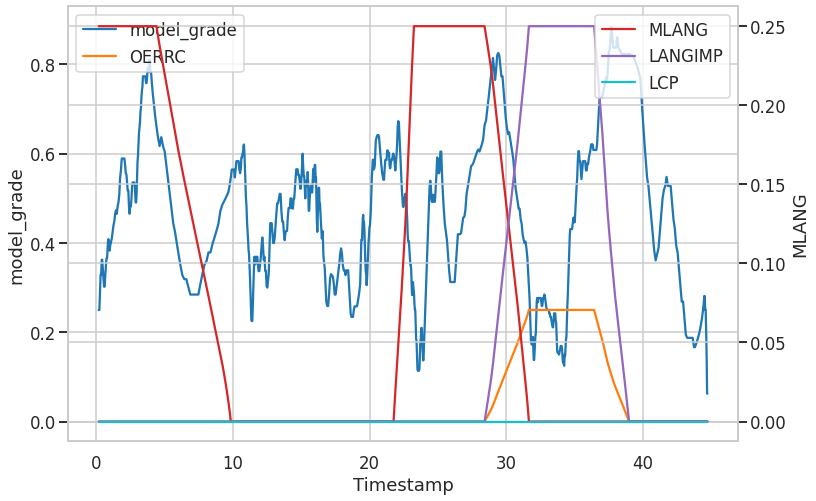

4017


<ipython-input-180-fe9c15cb6a6f>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])


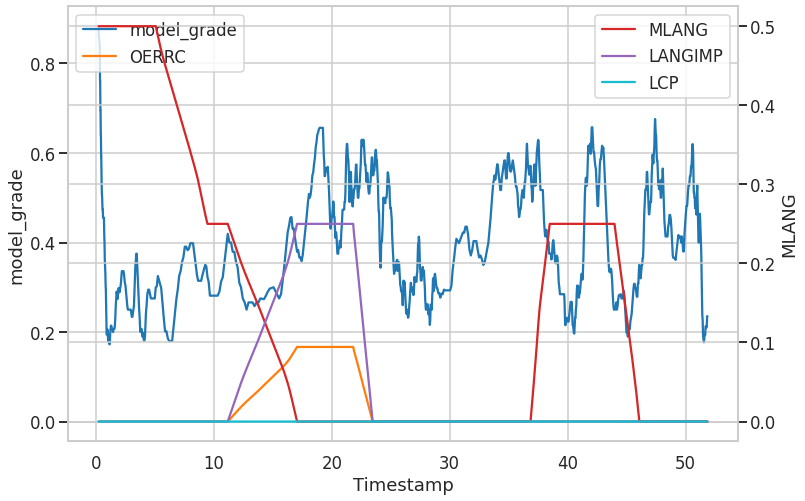

635


<ipython-input-180-fe9c15cb6a6f>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])


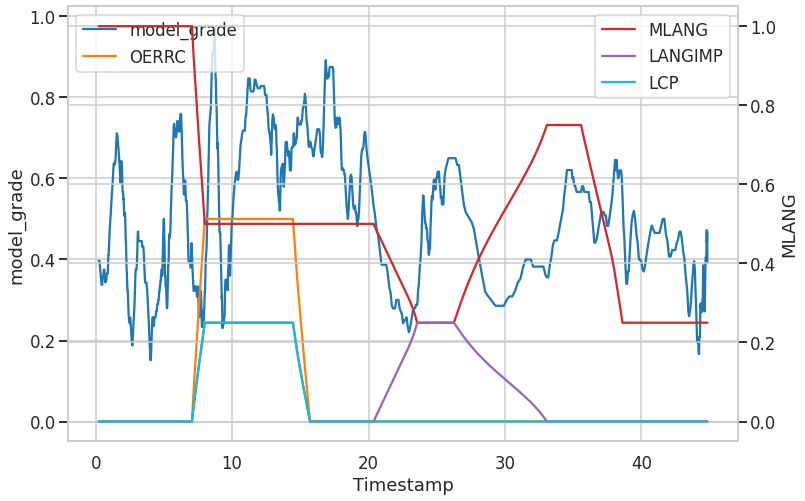

2200


<ipython-input-180-fe9c15cb6a6f>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])


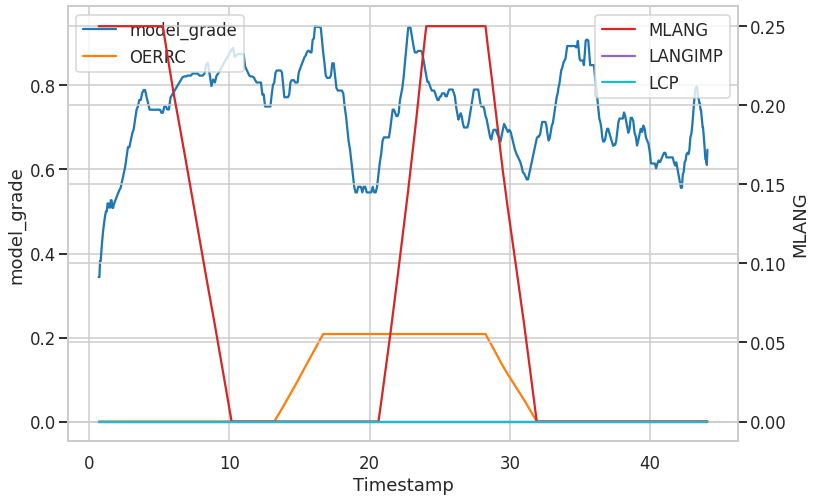

510


<ipython-input-180-fe9c15cb6a6f>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])


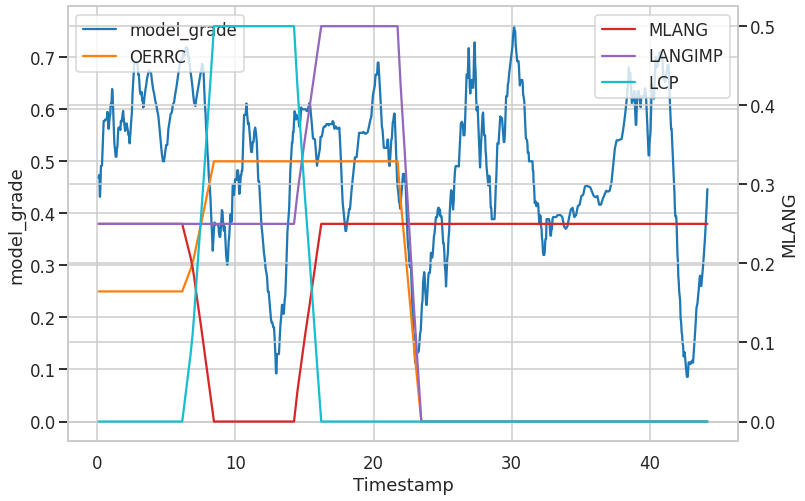

2273


<ipython-input-180-fe9c15cb6a6f>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])


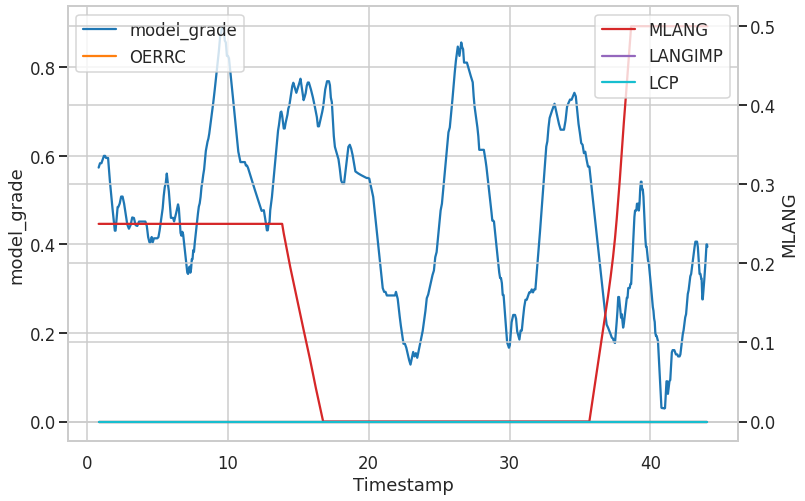

4124


<ipython-input-180-fe9c15cb6a6f>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])


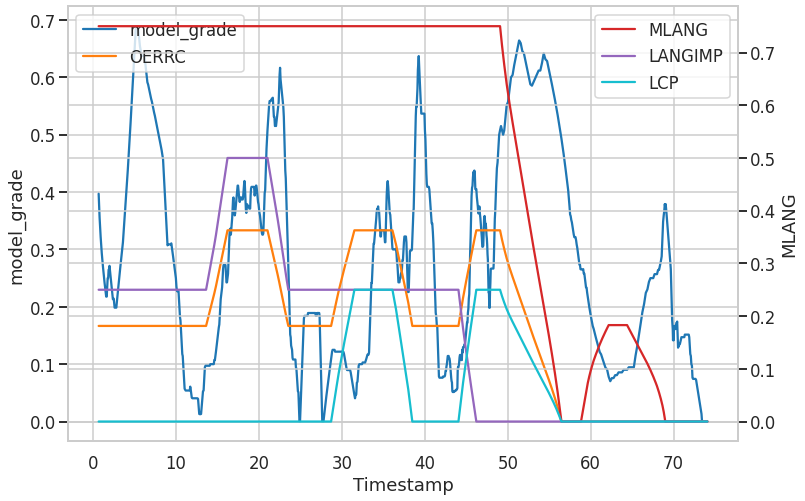

2381


<ipython-input-180-fe9c15cb6a6f>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])


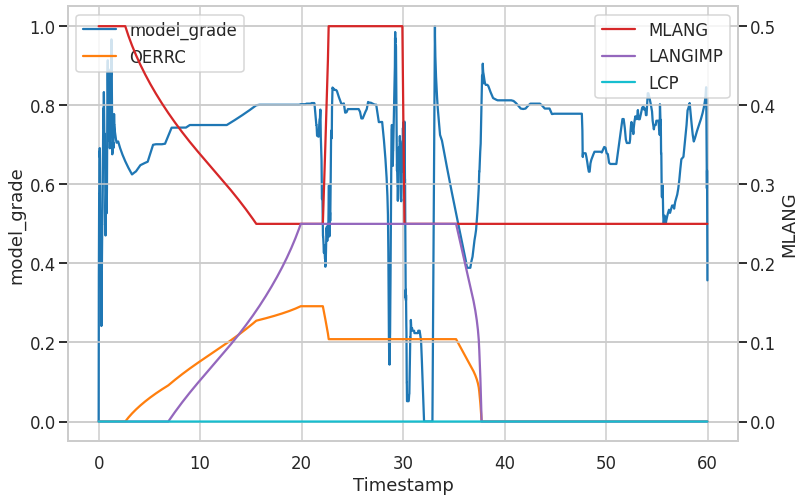

583


<ipython-input-180-fe9c15cb6a6f>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])


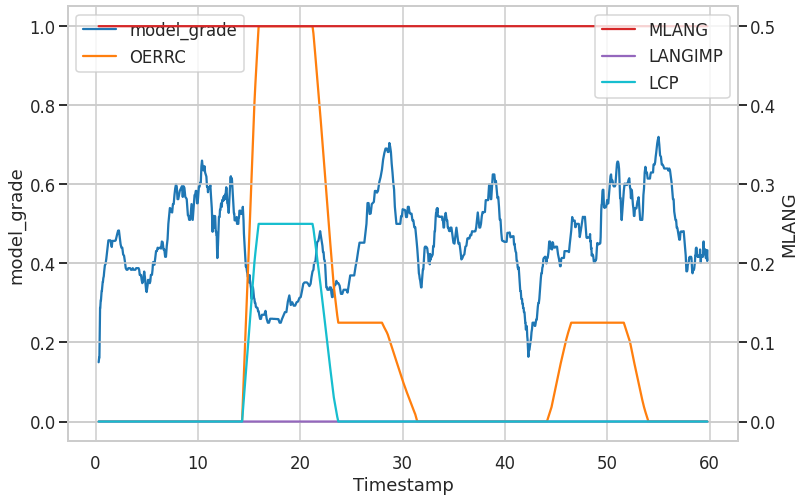

4021


<ipython-input-180-fe9c15cb6a6f>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])


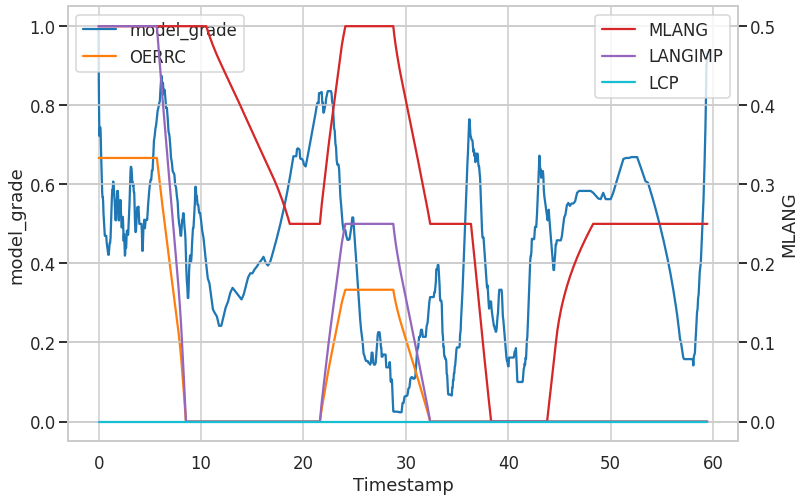

33


<ipython-input-180-fe9c15cb6a6f>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])


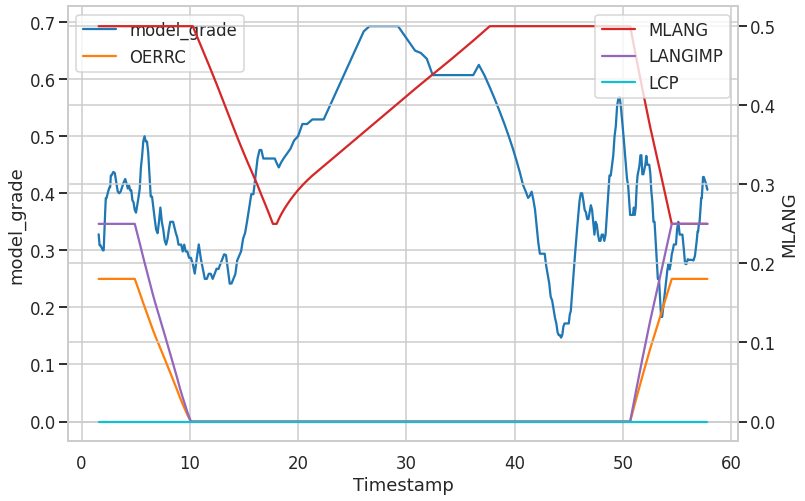

2961


<ipython-input-180-fe9c15cb6a6f>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])


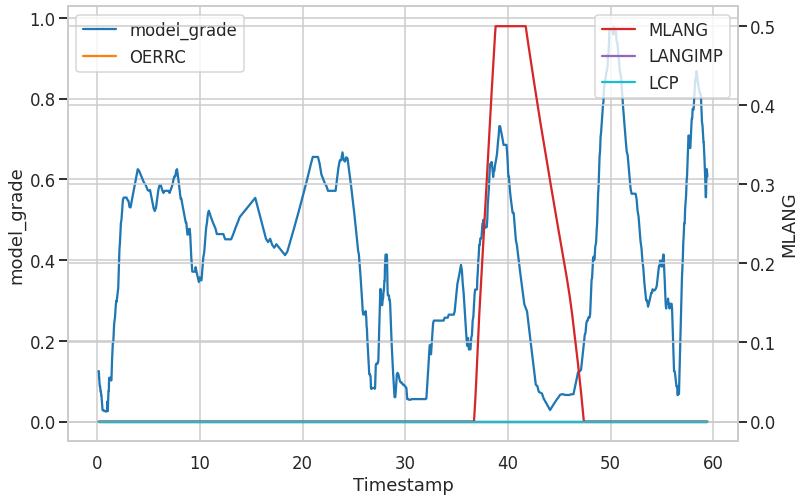

2755


<ipython-input-180-fe9c15cb6a6f>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])


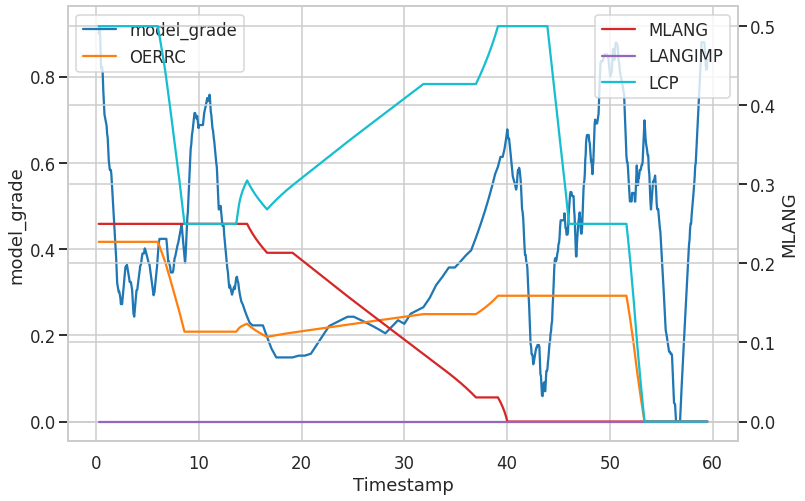

4129


<ipython-input-180-fe9c15cb6a6f>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])


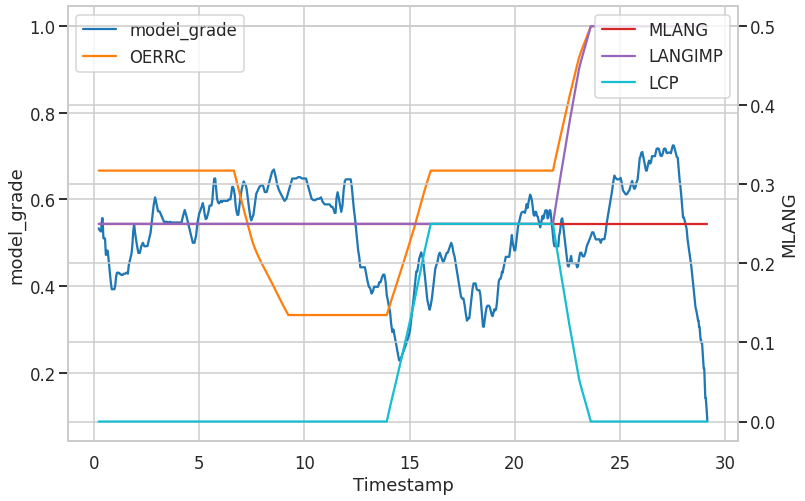

3016


<ipython-input-180-fe9c15cb6a6f>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])


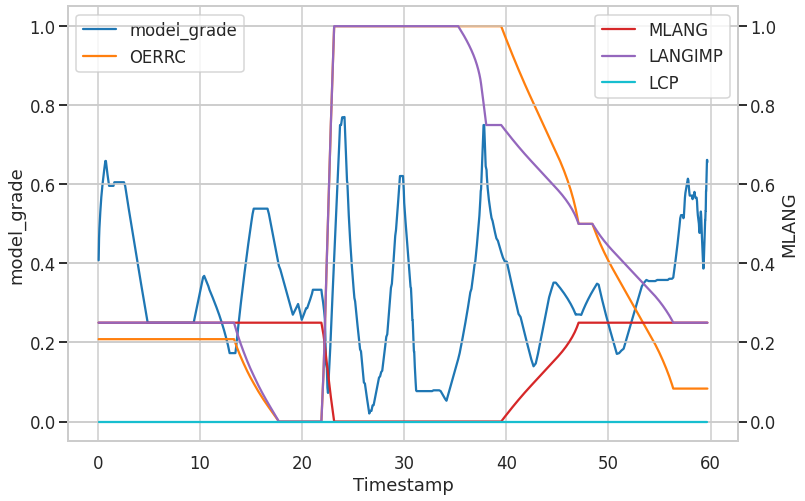

1099


<ipython-input-180-fe9c15cb6a6f>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])


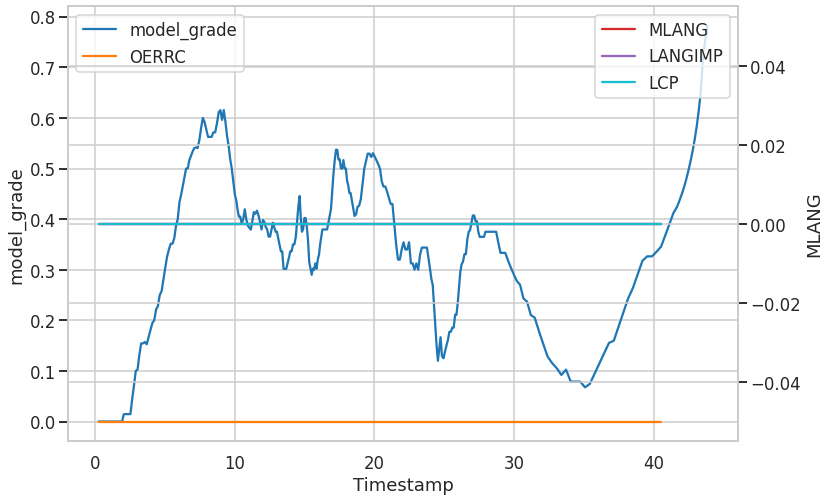

2089


<ipython-input-180-fe9c15cb6a6f>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[first_axis_vars] = scaler.fit_transform(tdf[first_axis_vars])


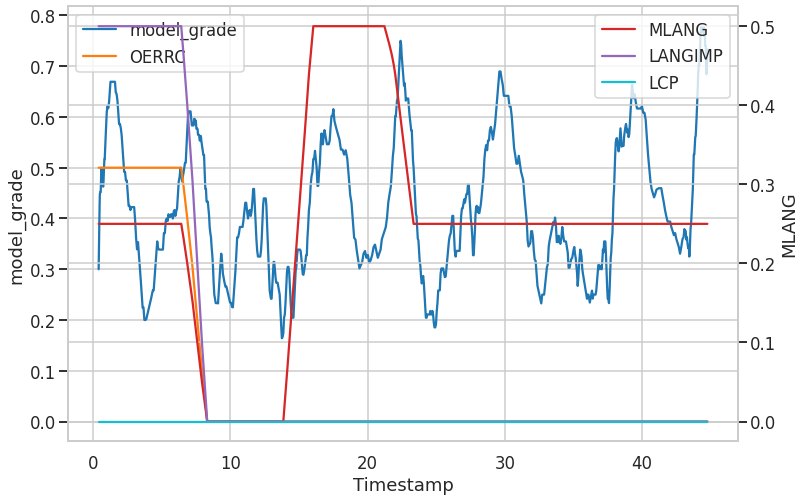

In [ ]:
for ob in df.OBSID.sample(20):
  print(ob)
  make_class_heartbeat(ob, first_axis_vars = ['model_grade','OERRC'],
                          second_axis_vars = ['MLANG','LANGIMP','LCP'],
                          xvar = 'timestamp',
                          xinrolling = True, legend= True, scale1 = True,
                          window = 40)

In [ ]:
v[v.OBSID==2654].sort_values('CHAPNUM').loc[:,"MAJERR":]

,MAJERR,LANGIMP,LCP,OERR,OERR4,STEXPL,SMQR,ETCA,OSPMMR,OSPMMR4,...,TREMSTU,STUENG,CLMATINQ,LESSEFFIC,DENSMAT,LATASK,LESSCLEAR,TASKDEVMAT,ERRANN,WORLD
36585,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
36588,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
36587,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
36586,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
36545,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
36548,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
36547,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
36546,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
36589,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
36590,0.0,0.0,1.0,1.0,2.0,0.0,0.0,0.0,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


2934


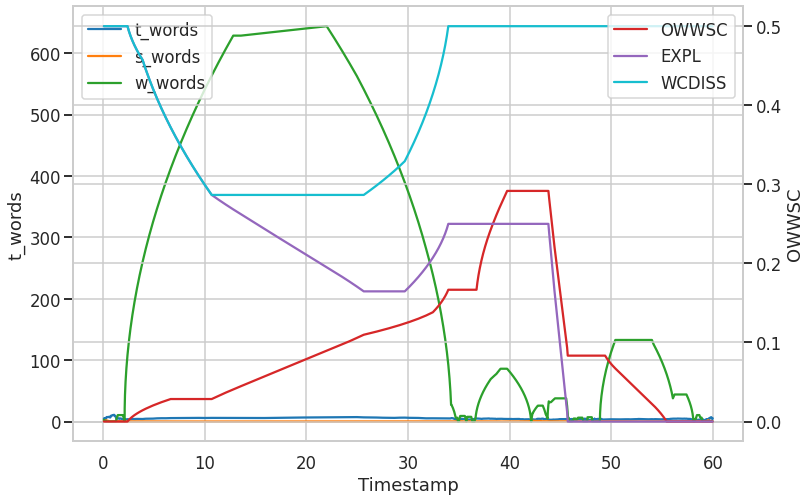

4658


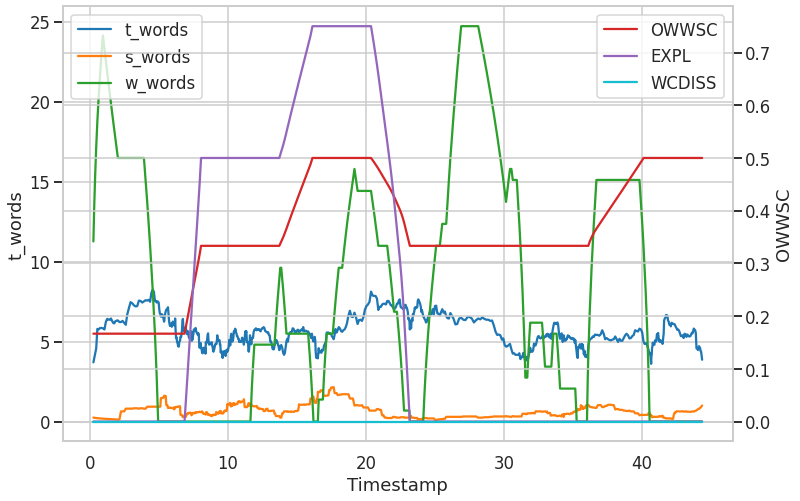

915


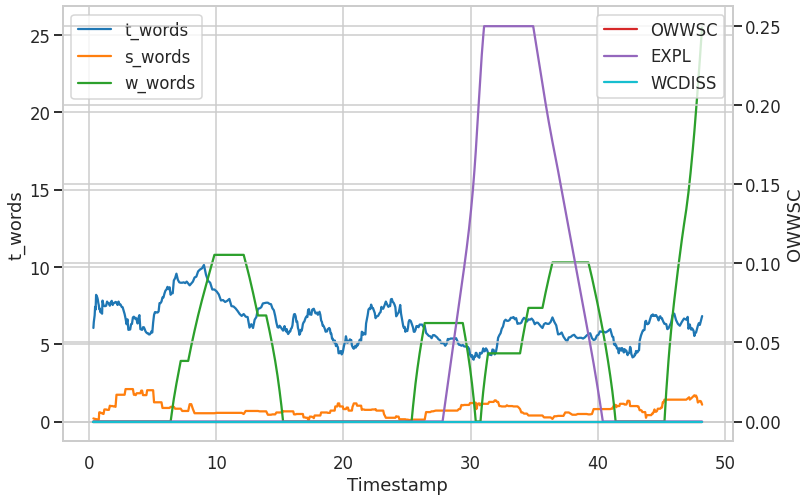

2288


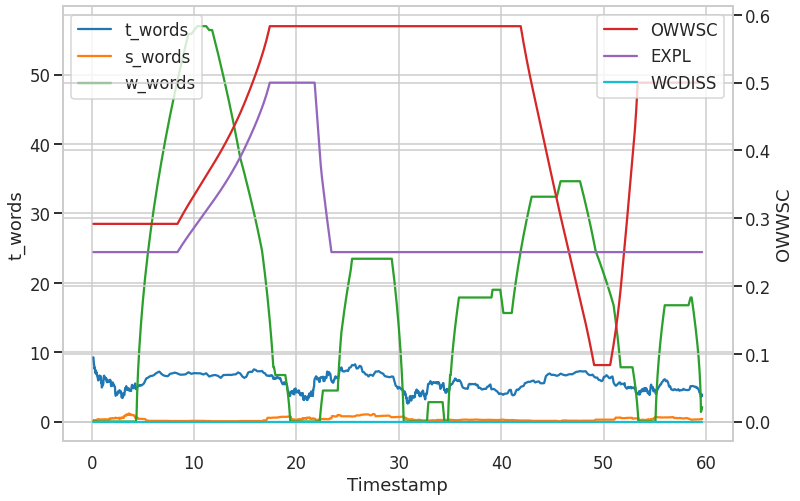

208


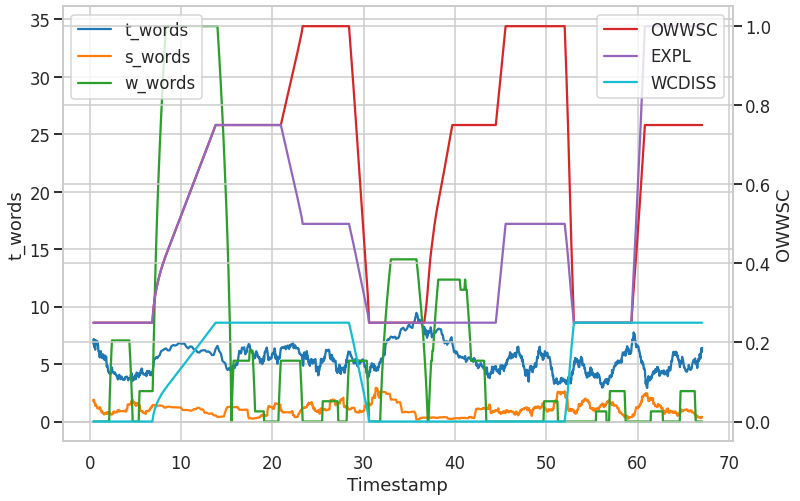

2952


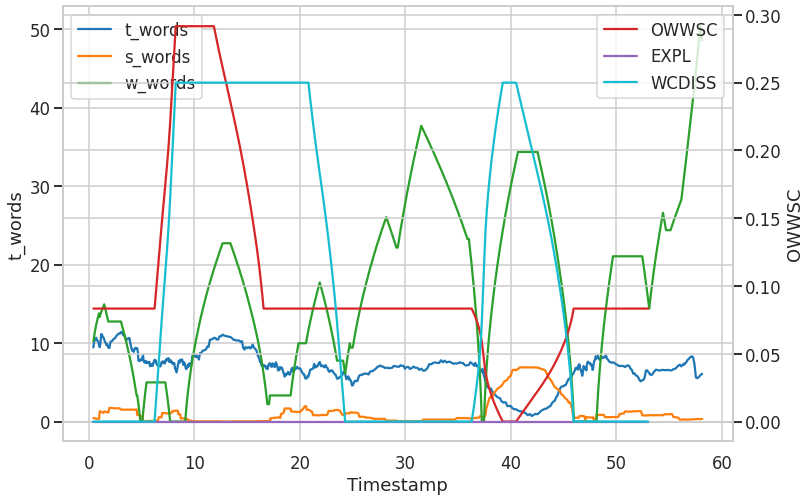

2529


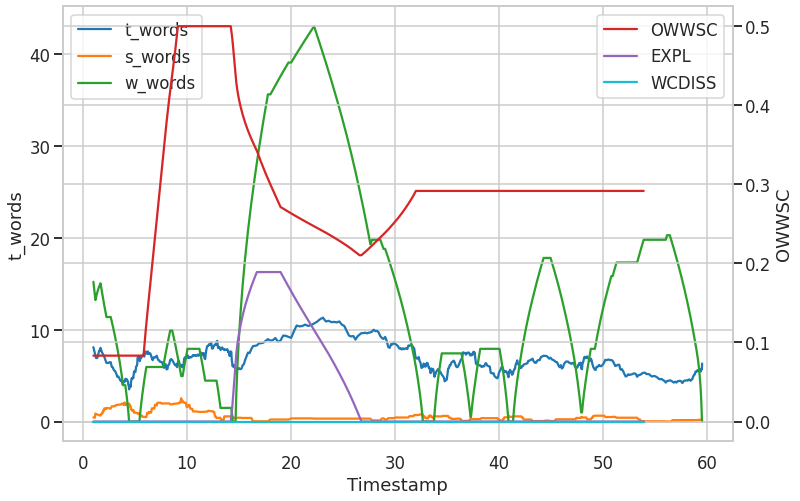

144


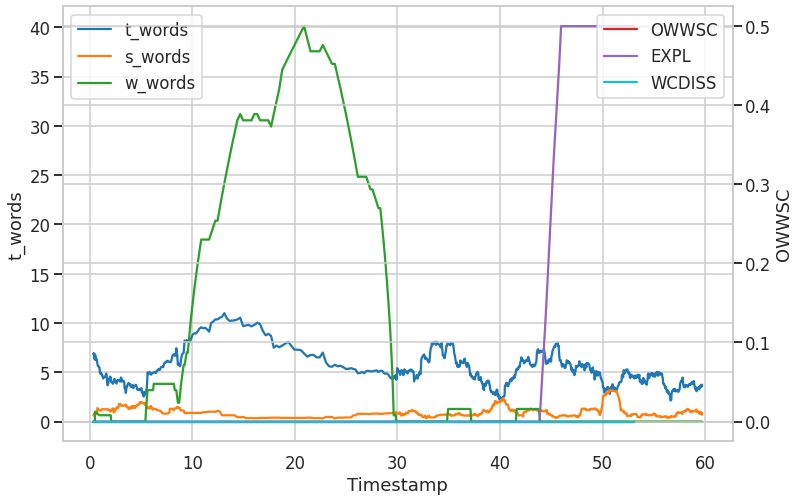

310


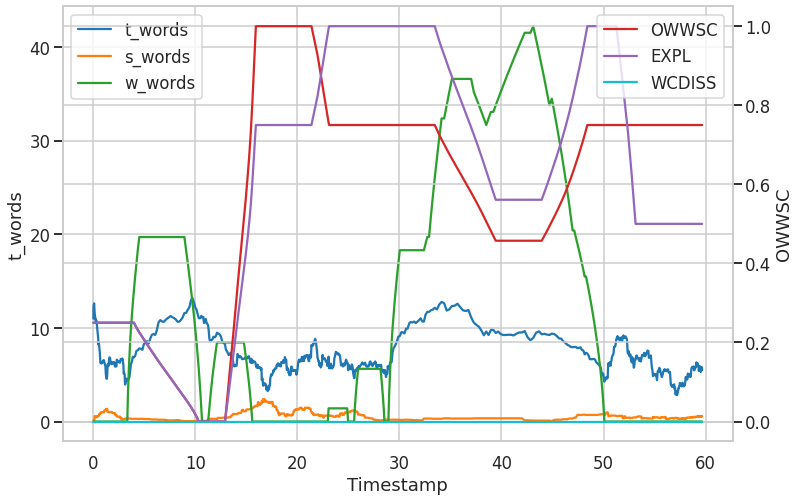

2157


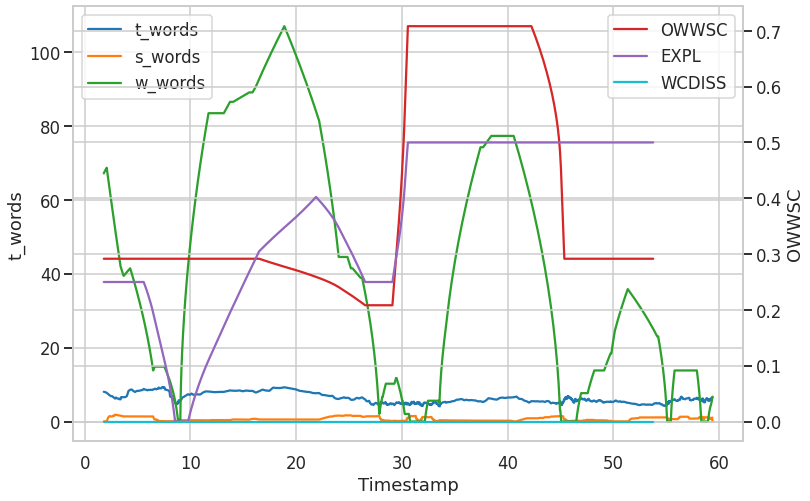

5


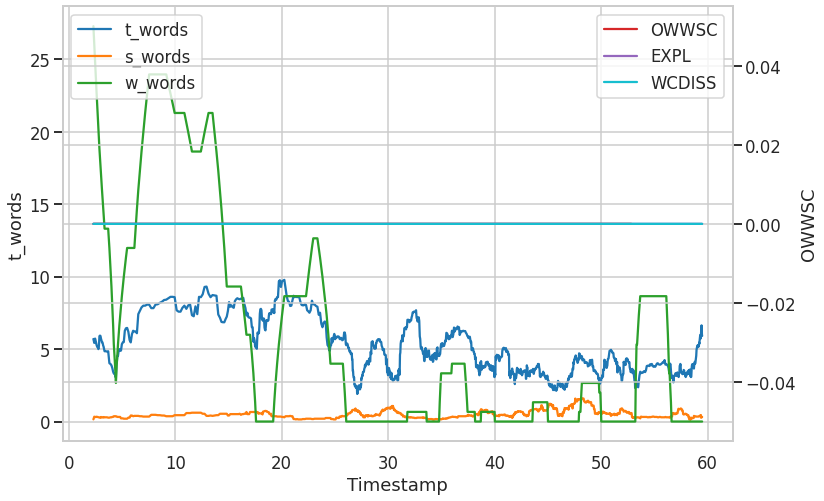

254


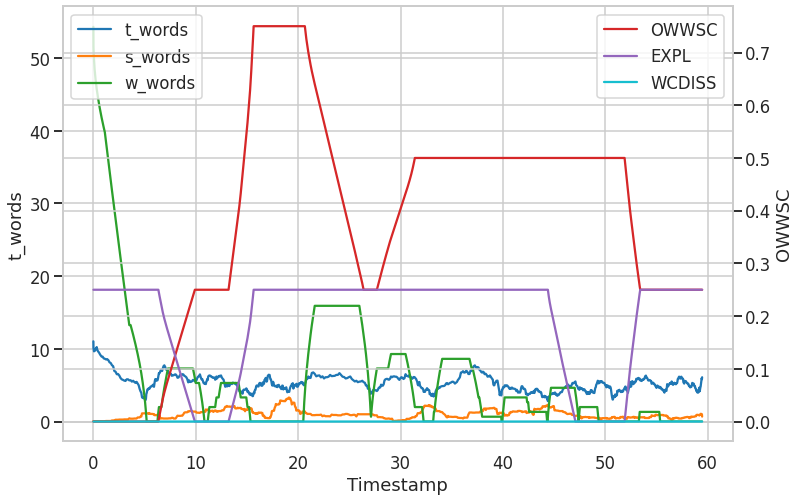

823


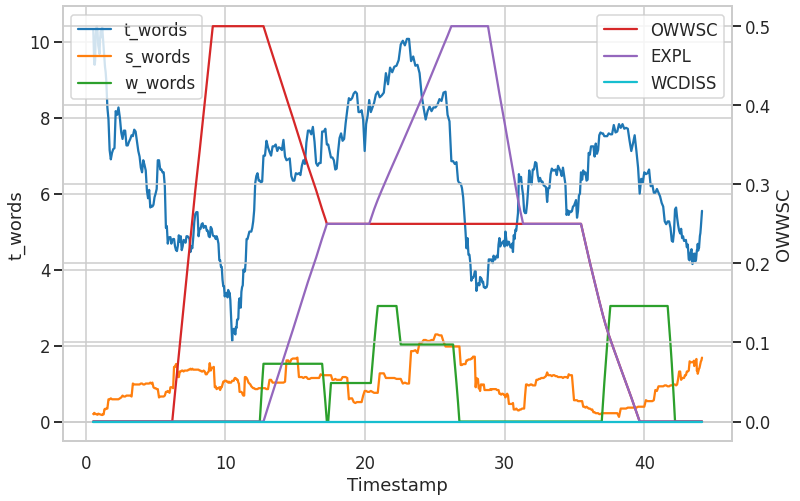

4002


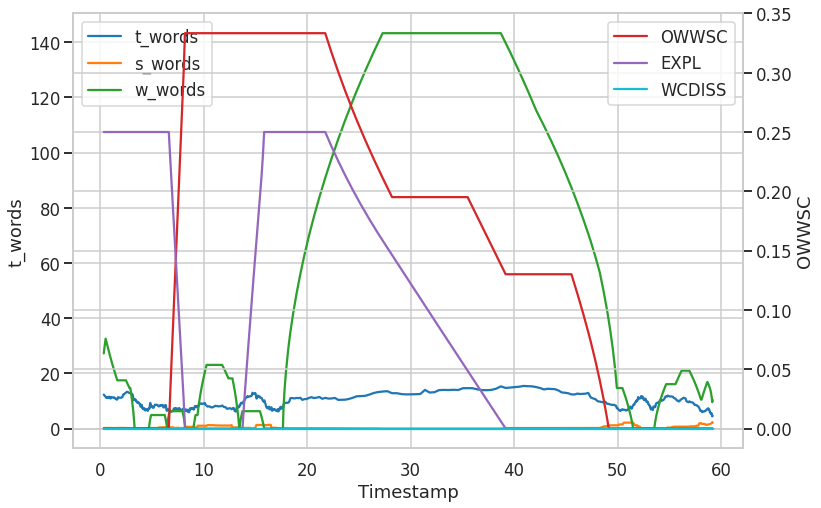

4665


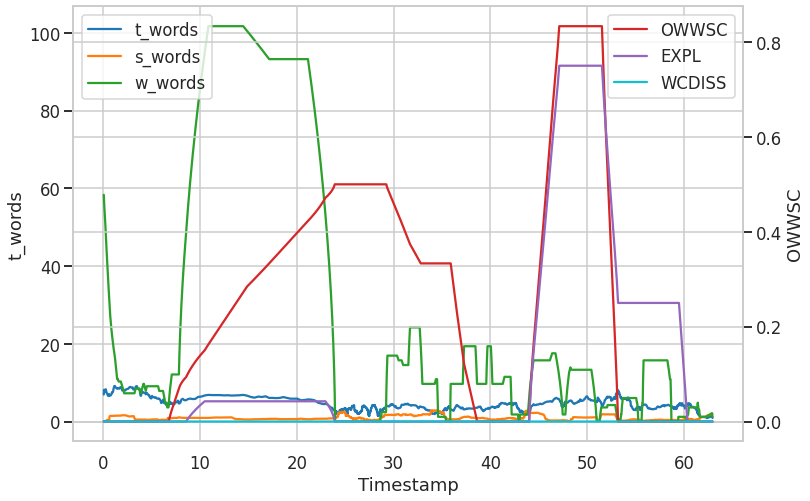

4727


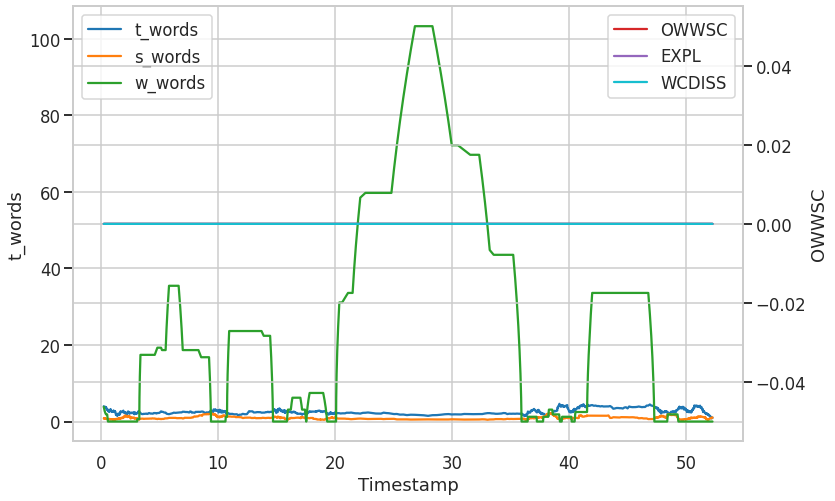

2084


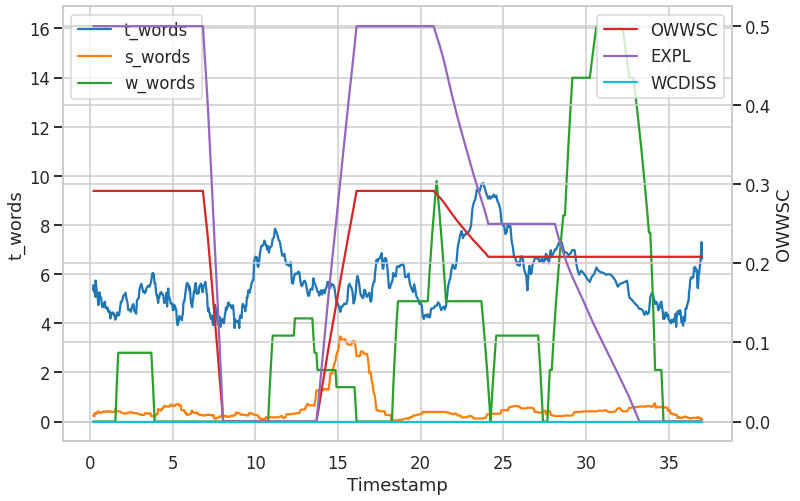

837


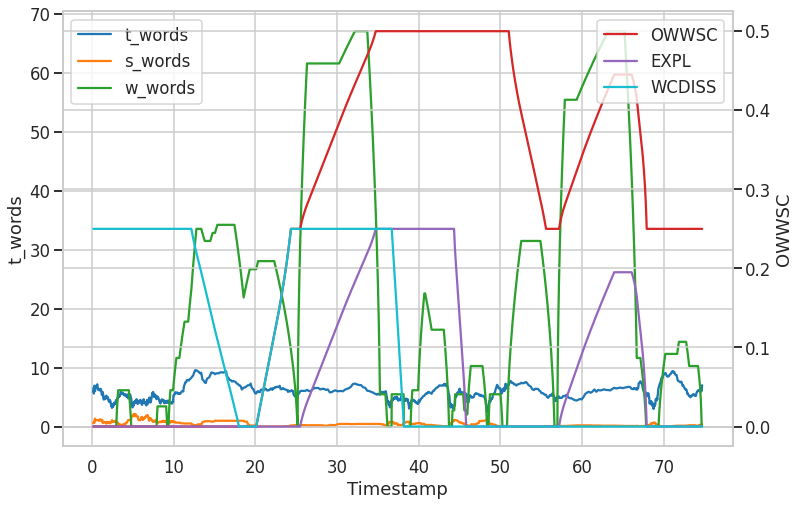

5


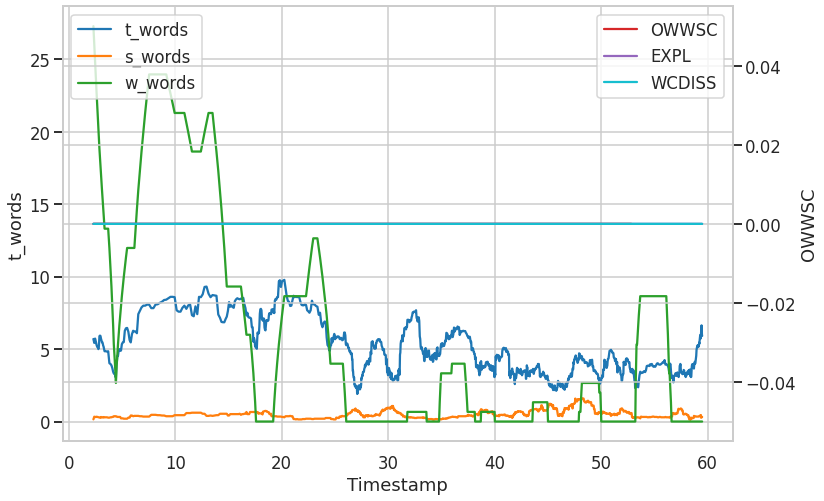

2599


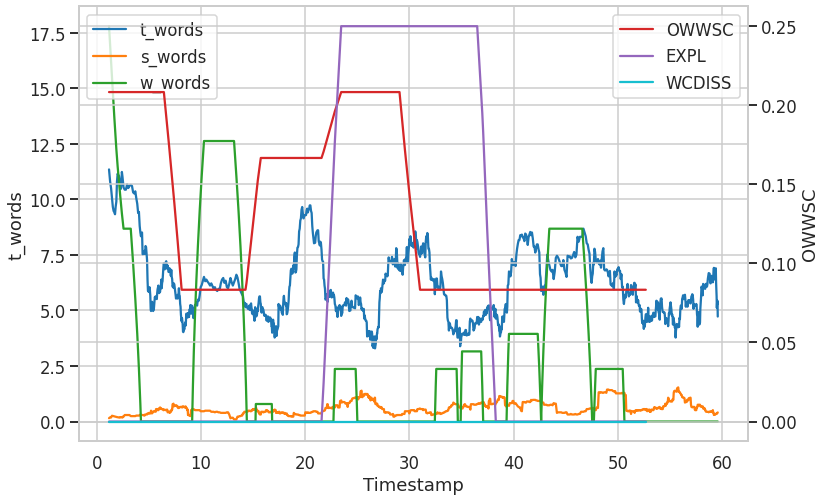

In [ ]:
for ob in df.OBSID.sample(20):
  print(ob)
  make_class_heartbeat(ob, first_axis_vars = ['t_words','s_words','w_words'],
                          second_axis_vars = ['OWWSC','EXPL','WCDISS'],
                          xvar = 'timestamp',
                          xinrolling = True, legend= True,
                          window = 40)
  # make_class_heartbeat(ob, first_axis_vars = ['t_math'],
  #                         second_axis_vars = ['s_math'],
  #                         xvar = 'timestamp',
  #                         xinrolling = True,
  #                         window = 60)

In [ ]:
df.w_words.sum()

10388896.138754811

In [ ]:
df.adj_num_words.sum()

19608195.697273858

In [ ]:
df['s_math'] = 0
df['t_math'] =0
df['s_math'] = ((df.t != True) * df.math_words)
df['t_math'] = (df.t * df.math_words)

In [ ]:
# print("\n".join(df[df.OBSID == 28][['text','w_words']].text.iloc[:50]))

# Make a Summarized Group DF

In [ ]:
obs_rating_vars =  ['CLPC', 'CLNC',
       'CLTS', 'CLRSP', 'CLBM', 'CLPRDT', 'CLILF', 'CLCU', 'CLAPS', 'CLQF',
       'CLINSTD', 'CLSTENG', 'SEGMENT',
       'FORMAT_ACTIVE', 'FORMAT_BOTH', 'FORMAT_SMALLGRP', 'DIRINST', 'APLPROB',
       'CWCM', 'WCDISS', 'LINK', 'EXPL', 'MMETH', 'MGEN', 'MLANG', 'ORICH',
       'ORICH4', 'REMED', 'USEPROD', 'MATCON', 'OWWS', 'OWWS4', 'MAJERR',
       'LANGIMP', 'LCP', 'OERR', 'OERR4', 'STEXPL', 'SMQR', 'ETCA', 'OSPMMR',
       'OSPMMR4', 'STUCON', 'STUCOM', 'SMALDIS', 'MMSM', 'ORIENT', 'SUMM',
       'MQI_CHECK', 'DIFFINST', 'LLC', 'MQI3', 'MKT3', 'MQI5', 'MKT5',
       'TSTUDEA', 'TREMSTU', 'STUENG', 'CLMATINQ', 'LESSEFFIC', 'DENSMAT',
       'LATASK', 'LESSCLEAR', 'TASKDEVMAT', 'ERRANN', 'WORLD']

In [ ]:
df.columns

Index(['speaker', 'text', 'year', 'OBSID', 'video_id', 'cleaned_text',
       'num_words', 'turn_idx', 'comb_idx', 't',
       ...
       'LATASK', 'LESSCLEAR', 'TASKDEVMAT', 'ERRANN', 'WORLD', 'math_words',
       'log_math_words', 'pct_math_words', 's_pct_math_words',
       't_pct_math_words'],
      dtype='object', length=123)

In [ ]:
dfs = []


for ob, group in tqdm(df.groupby(by = 'OBSID'),total = len(df.groupby(by = 'OBSID'))):
  obsdf = copy.deepcopy(group.iloc[0,:])
  for n in obs_rating_vars:
    obsdf.loc[n] = np.nanmean(group[n])
  obsdf['m_words'] = group.math_words.sum() / group.num_words.sum()
  obsdf['sm_words'] = ((group.t != True) * group.math_words).sum() / group.s_words.sum()
  obsdf['tm_words'] = (group.t * group.math_words).sum() / group.t_words.sum()
  # time_delta = group.timestamp.diff().tolist()[1:]
  # time_delta.append(v[v.OBSID == ob].CHAPNUM.max()*7.5 - group.timestamp.max())
  # obsdf['mwpm'] = scipy.stats.hmean(obsdf['math_words'] / time_delta, nan_policy='omit')
  model = smf.ols(formula = 'math_words ~ timestamp',data=group[(group.speaker=='teacher')])
  obsdf['t_math_int'], obsdf['t_math_slope'] = model.fit().params
  model = smf.ols(formula = 'math_words ~ timestamp',data=group[~(group.speaker=='teacher')])
  obsdf['s_math_int'], obsdf['s_math_slope'] = model.fit().params
  dfs.append(pd.DataFrame(obsdf).T)

dfs = pd.concat([d for d in dfs])
dfs.loc[:,'CLPC':] = dfs.loc[:,'CLPC':].astype('float')

  0%|          | 0/1658 [00:00<?, ?it/s]

<ipython-input-42-37a3e1dad228>:7: RuntimeWarning: Mean of empty slice
  obsdf.loc[n] = np.nanmean(group[n])
<ipython-input-42-37a3e1dad228>:7: RuntimeWarning: Mean of empty slice
  obsdf.loc[n] = np.nanmean(group[n])
<ipython-input-42-37a3e1dad228>:7: RuntimeWarning: Mean of empty slice
  obsdf.loc[n] = np.nanmean(group[n])
<ipython-input-42-37a3e1dad228>:7: RuntimeWarning: Mean of empty slice
  obsdf.loc[n] = np.nanmean(group[n])
<ipython-input-42-37a3e1dad228>:7: RuntimeWarning: Mean of empty slice
  obsdf.loc[n] = np.nanmean(group[n])
<ipython-input-42-37a3e1dad228>:7: RuntimeWarning: Mean of empty slice
  obsdf.loc[n] = np.nanmean(group[n])
<ipython-input-42-37a3e1dad228>:7: RuntimeWarning: Mean of empty slice
  obsdf.loc[n] = np.nanmean(group[n])
<ipython-input-42-37a3e1dad228>:7: RuntimeWarning: Mean of empty slice
  obsdf.loc[n] = np.nanmean(group[n])
<ipython-input-42-37a3e1dad228>:7: RuntimeWarning: Mean of empty slice
  obsdf.loc[n] = np.nanmean(group[n])
<ipython-input-42-3

In [ ]:
dfs.scoreSTA = dfs.scoreSTA.astype('float')

In [ ]:
dfs.dtypes

speaker         object
text            object
year            object
OBSID           object
video_id        object
                 ...  
tm_words        object
t_math_int      object
t_math_slope    object
s_math_int      object
s_math_slope    object
Length: 130, dtype: object

In [ ]:
# dfs['STAq'] =
pd.qcut(dfs[dfs.scoreSTA.notnull()].scoreSTA,5,retbins=True)

TypeError: ignored

In [ ]:
dfs.to_csv(DATA_FOLDER + "OBSID_level.csv")

<ipython-input-11-9f3ea7004bf4>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[second_axis_vars] = scaler.fit_transform(df[second_axis_vars])


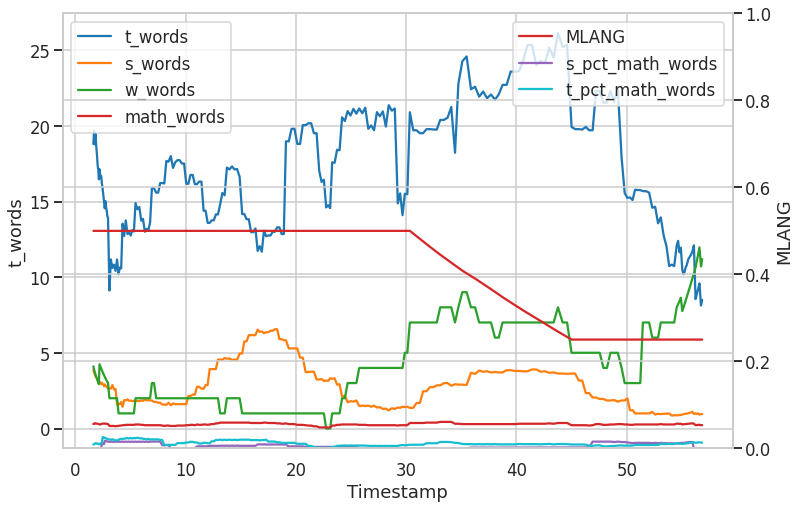

In [ ]:
ob =3
make_class_heartbeat(ob, first_axis_vars = ['t_words','s_words','w_words','math_words'],
                         second_axis_vars = ['MLANG','s_pct_math_words','t_pct_math_words'],
                         xvar = 'timestamp',
                         xinrolling = True,
                         window = 40)

# Create timestamps

## Check for markers

In [ ]:
pat = re.compile("\[([^\]].*?)\]")
# df['has_work_comment'] = np.nan

for i, row in tqdm(df.iterrows(), total = len(df)):
  asdf = pat.findall(row.text)
  asdf = [x for x in asdf if 'udible' not in x and 'osstalk' not in x and 'ide conversat' not in x.lower() and 'ilence' not in x and 'panish' not in x and 'foreign' not in x and 'pause' not in x.lower() and 'work' not in x.lower() and 'writ' not in x.lower() and 'laugh' not in x.lower() and 'cough' not in x.lower() and 'hisper' not in x and 'ultiple comment' not in x.lower() and 'ultiple answer' not in x.lower() and 'French' not in x and 'clappi' not in x.lower() and 'video' not in x.lower() and 'movie' not in x.lower() and 'announcement' not in x.lower()]
  if len(asdf) > 0:
    # df.loc[i,'has_work_comment'] = 1

    print(asdf)

  0%|          | 0/579979 [00:00<?, ?it/s]

['find']
['water']
['counting 1 to 28']
['and only']
['2 out of 15 minus 18 is 3.  18 out of 8']
['By']
['in all this']
['If the driver being paid']
['astronaut and this is what it was in', 'Counting 1 to 18']
['Counting 1 to 8']
['the boat']
['kids']
['Chapter']
['Moving table']
['0:55:00']
['Fighting']
['beep']
['Mocks the student']
['0:01:00']
['Organize yourself, please']
['takes up']
['0:03:23']
["I'm always good as the saying"]
['cubes there']
['4 and 3']
['de']
['continue to help']
['4 by –']
['Over there']
['Over the 2']
['form']
['four']
['Five']
['one there']
['bucket']
['button']
['bag']
["They're 90 degrees"]
["They're all 90 degrees"]
['length']
['times B times H']
['Applause']
['Papers shuffling']
['Mumbling']
['Mumbling']
['Applause']
['Beeping']
['Applause']
['Applause']
['Mumbling']
['Applause']
['Mumbling']
['Applause']
['Clanking sounds']
['Side comment from other teacher']
['Fingers snapping']
['Students rotating groups']
['Apalene']
['reading conference', 'will be 

KeyboardInterrupt: ignored

## Timestep Functions

  0%|          | 0/1658 [00:00<?, ?it/s]

<AxesSubplot:xlabel='turn_idx'>

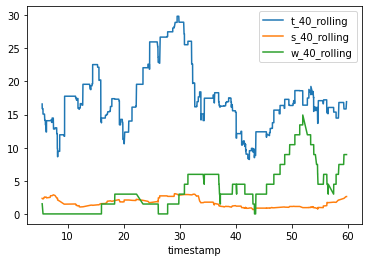

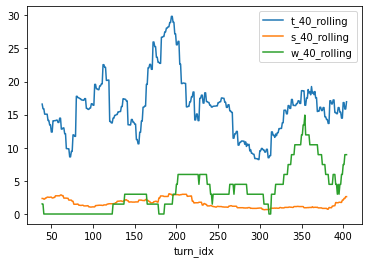

In [ ]:
total_time = pd.DataFrame(v.groupby(by=["OBSID"]).CHAPNUM.max() * 7.5)

def add_timestamps(df, use_adjusted = True, custom_end_time = 0):
    """
    Adds a new column with HH:MM:SS timestamps to a grouped pd dataframe by
    'OBSID', starting at 00:00:00 for group_index 0 and ending at
    custom_end_time. Extracts available timestamps from the text and imputes
    timestamps for the rest of each group's rows using the weights found in
    'num_words'.

    Parameters:
    df (pd.DataFrame): grouped pd dataframe with a column of transcription text
        and a column of 'num_words' for each group
    custom_end_time (str): the custom end time for each group in the format
        'HH:MM:SS'

    Returns:
    pd.DataFrame: the same dataframe as input, with an additional column of
        timestamps
    """
    def numeric_time(hh=0, mm=0, ss=0):
      return float(hh)*60 + float(mm) + float(ss)/60.
    # convert custom_end_time to timedelta
    def get_custom_end(custom_end_time):
      # if isinstance(custom_end_time,str):
      #   hh, mm, ss = [float(x) for x in custom_end_time.split(":")]
      return numeric_time(hh, mm, ss)

    # define regex to extract timestamps from text
    regex = r'\[[^\]]*?(\d{1,2}):(\d{2})([:.]\d{2})?[^\]]*?\]|(\d{1,2}):(\d{2}):(\d{2})'

    # function to extract timestamp from text and return as timedelta
    def extract_timestamp(text):
        match = re.search(regex, text)
        if match:
            time_groups = list(match.groups())
            if all([not isinstance(x,str) for x in time_groups]):
              if all([isinstance(x,str) for x in time_groups[0]]) and (len(time_groups[0]) == 3): time_groups = time_groups[0]
            if len(time_groups) == 3:
              if not time_groups[-1]:time_groups[-1] = '00'
              elif time_groups[-1][0] == ':':
                time_groups[-1] = time_groups[-1][1:]
              elif time_groups[-1][0] == '.':
                time_groups[-1] = (int(time_groups[-1][1:])/(10**len(time_groups[-1]-1)))
            elif len(time_groups) == 2: time_groups.append('00')
            time_groups = [re.findall(r'\d+', str(x))[0] for x in time_groups if x]
            for i, tim in enumerate(time_groups):
              if (len(tim) == 0 )|(tim == '00'): time_groups[i] = '00'
              elif len(str(int(tim))) == 1: time_groups[i] = f"0{int(tim)}"
            if len(time_groups) == 3: hh, mm, ss = time_groups
            elif len(time_groups) == 2: hh, mm = time_groups

            # return numeric_time(hh, mm, ss)
            return numeric_time(*time_groups)
        else:
            return np.nan

    df['timestamp'] = df['text'].apply(extract_timestamp)
    df.loc[(df.turn_idx == 0) & (df.timestamp.isnull()), 'timestamp'] = 0 #pd.to_timedelta(f'{00}:{00}:{00}')
    for name, group in tqdm(df.groupby('OBSID'), total = len(df.groupby('OBSID'))):
      g = group.copy()
      if use_adjusted: g['weights'] = group.adj_cum_words / group.adj_cum_words.max()
      else: g['weights'] = group.cum_words / group.cum_words.max()
      g.loc[g.weights == 1.0,'timestamp'] = total_time.loc[int(name)].values[0]
      g = g.set_index('weights')
      g = g['timestamp']

      timestamps = g.interpolate(method = 'akima', limit_direction='both')
      df.loc[df.OBSID == name,'timestamp'] = [0] + [x + timestamps.values[0] for x in timestamps.values][:-1]

    return df

count_time_stamps_given

add_timestamps(df)

ob = 450

df[df.OBSID == ob].plot.line(x = "timestamp", y = ["t_40_rolling","s_40_rolling", "w_40_rolling"])
df[df.OBSID == ob].plot.line(x = "turn_idx", y = ["t_40_rolling","s_40_rolling", "w_40_rolling"])

In [ ]:
regex = re.compile('\[([^\]]*?\d{1,2}:\d{1,2}:\d{2}[^\]]*?)\]')
regex = r'\[([^\]]*?work[^\]]*?)(\d{1,2}):(\d{2})([:.]\d{2})?[^\]]*?\]'
regex = re.compile('\[[^\]]*?[Ss]ilenc.*?\d{1,2}:\d{1,2}')
# pat = re.compile("\[([^\]].*?)\]")
full_text = "\n".join(df.text)

asdf = re.findall(regex,full_text)
len(asdf)

0

In [ ]:
df = pd.read_pickle(DATA_FOLDER + 'corpora_gr_domain_augm_teach_only.pkl')
df.shape

(113980, 8)

In [ ]:
adf = pd.read_csv(DATA_FOLDER + 'raw_corpus_augmented.csv')
adf.shape

(117078, 9)

In [ ]:
import nltk
from nltk.tokenize.punkt import PunktSentenceTokenizer
sent_tokenizer = lambda s: PunktSentenceTokenizer().tokenize(s)

In [ ]:
adf['text'] = adf.text.apply(lambda x: sent_tokenizer(x))
adf = adf.explode('text')
adf.shape

(2171038, 9)

In [ ]:
df = df.drop(columns = "Unnamed: 0")
df = df.reset_index(drop=True)

In [ ]:
df.to_pickle(DATA_FOLDER + "raw_corpus_exploded.pkl")

In [ ]:
adf = adf.drop_duplicates()

In [ ]:
gc.collect()

604

<Axes: xlabel='grade', ylabel='count'>

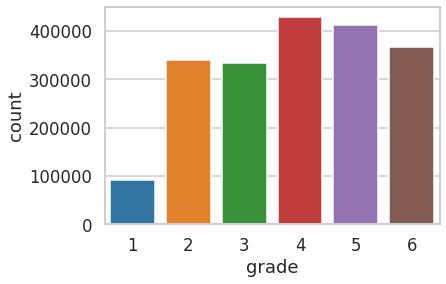

In [ ]:
sns.countplot(adf[adf.grade.isin(['1','2','3','4','5','6'])], x='grade', order = ['1','2','3','4','5','6'])

<Axes: xlabel='domain', ylabel='count'>

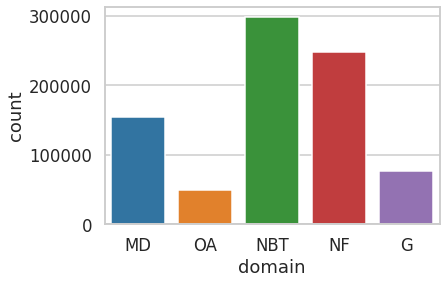

In [ ]:
sns.countplot(adf[adf.grade.isin(['4','5',])], x='domain',)

In [ ]:
adf.to_csv(DATA_FOLDER + 'MathTalkCorpus.csv')

In [ ]:
x = adf.standard.value_counts().reset_index()
x[x.standard > 1]

,index,standard
0,None,75307
1,2.NBT.B.5,70046
2,5.NBT.B.7,61209
3,2.OA.B.2,49385
4,4.NBT.B.6,35414
...,...,...
332,7.SP.A.1,2
333,7.SP.B.3,2
334,7.SP.B.4,2
335,7.SP.C.6,2


In [ ]:
adf[adf.grade.isin(['4','5'])]

,grade,domain,cluster,standard,speaker,text,source,est_tok
18,4,MD,NaN,3.MD,teacher,These are the lengths of the cars in the pictu...,talking_math,20
19,4,MD,NaN,3.MD,teacher,Describe how you would make a line plot about ...,talking_math,19
20,5,MD,B,4.MD.B.4,teacher,These are the lengths of the blocks in the pic...,talking_math,20
21,5,MD,B,4.MD.B.4,teacher,Describe how you would make a line plot of thi...,talking_math,22
31,4,OA,A,3.OA.A.3,teacher,We see 5 puppies can sit in a basket.,talking_math,27
...,...,...,...,...,...,...,...,...
113899,5,OA,B,3.OA.B.5,teacher,+ = ____.,engageNY,938
113899,5,OA,B,3.OA.B.5,teacher,"Below it, write 12 × 3 = ____.)",engageNY,938
113899,5,OA,B,3.OA.B.5,teacher,12 is the same as 8 and what number?,engageNY,938
113899,5,OA,B,3.OA.B.5,teacher,"Below it, write 24 + ____ = ____.)",engageNY,938


In [ ]:
adf[adf.standard=='7.SP.C.7']

,grade,domain,cluster,standard,speaker,text,source,est_tok
2236,7,SP,C,7.SP.C.7,teacher,Develop a probability model and use it to find...,CCSS,48
2236,7,SP,C,7.SP.C.7,teacher,Compare probabilities from a model to observed...,CCSS,48


In [ ]:
df[df.text.str.contains("work on problem")]

,speaker,text,year,OBSID,video_id,cleaned_text,num_words,turn_idx,comb_idx,t,...,TASKDEVMAT,ERRANN,WORLD,math_words,log_math_words,pct_math_words,s_pct_math_words,t_pct_math_words,s_math,t_math
34585,teacher,"1 take away 0, 3 take away 1. So our answer i...",2,2832,362,1 take away 0 3 take away 1 so our answer is w...,56,230,2832_230,1,...,NaN,NaN,NaN,2,1.098612,0.035714,NaN,0.035714,0,2
45235,teacher,Just wait a minute. Thank you. Go ahead and ...,2,2683,813,just wait a minute thank you go ahead and work...,43,207,2683_207,1,...,NaN,NaN,NaN,1,0.693147,0.023256,NaN,0.023256,0,1
131471,teacher,Okay. Go work on problem number two. Yes?,2,2442,735,okay go work on problem number two yes,8,109,2442_109,1,...,NaN,NaN,NaN,1,0.693147,0.125000,NaN,0.125000,0,1
140265,teacher,"Your name, today’s date, Hershey’s Fractions, ...",2,2678,792,your name today s date hershey s fractions and...,51,94,2678_94,1,...,NaN,NaN,NaN,1,0.693147,0.019608,NaN,0.019608,0,1
280993,teacher,Table 5 is ready and they’re following directi...,3,4084,374,table 5 is ready and they re following directi...,118,133,4084_133,1,...,NaN,NaN,NaN,3,1.386294,0.025424,NaN,0.025424,0,3
301790,teacher,"Yes, as part of your homework we’re going to d...",3,4203,816,yes as part of your homework we re going to do...,84,274,4203_274,1,...,NaN,NaN,NaN,0,0.000000,0.000000,NaN,0.000000,0,0
318245,teacher,"Bigger, not smaller. Okay, I am going to have...",1,508,732,bigger not smaller okay i am going to have a s...,134,209,508_209,1,...,NaN,NaN,NaN,3,1.386294,0.022388,NaN,0.022388,0,3
383766,teacher,"No, if someone - that means just your table gr...",1,846,727,no if someone that means just your table group...,86,245,846_245,1,...,NaN,NaN,NaN,0,0.000000,0.000000,NaN,0.000000,0,0
515902,teacher,Yes. Now we are problem number 10. Let's wor...,1,11,305,yes now we are problem number 10 let s work on...,42,352,11_352,1,...,NaN,NaN,NaN,2,1.098612,0.047619,NaN,0.047619,0,2


In [ ]:
df[(df.OBSID == 737)& (df.text.str.contains(":2"))]

,speaker,text,year,OBSID,video_id,cleaned_text,num_words,turn_idx,comb_idx,t,...,TASKDEVMAT,ERRANN,WORLD,math_words,log_math_words,pct_math_words,s_pct_math_words,t_pct_math_words,s_math,t_math
534493,teacher,"Yes. Two-tenths. What’s left over? One, two...",1,737,424,yes two tenths what s left over one two three ...,202,197,737_197,1,...,NaN,NaN,NaN,11,2.484907,0.054455,NaN,0.054455,0,11
534498,teacher,"So, write them both down. 0:27:26]",1,737,424,so write them both down 0 27 26,8,202,737_202,1,...,NaN,NaN,NaN,0,0.000000,0.000000,NaN,0.000000,0,0


  0%|          | 0/1658 [00:00<?, ?it/s]

<Axes: xlabel='turn_idx'>

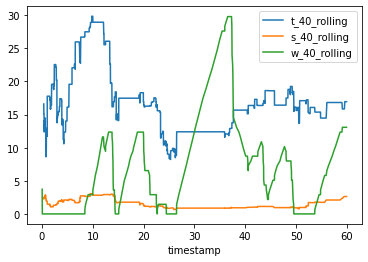

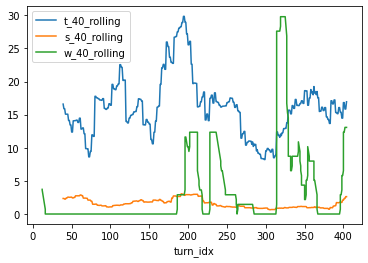

In [ ]:
total_time = pd.DataFrame(v.groupby(by=["OBSID"]).CHAPNUM.max() * 7.5)

def add_timestamps(df, use_adjusted = True, custom_end_time = 0):
    """
    Adds a new column with HH:MM:SS timestamps to a grouped pd dataframe by
    'OBSID', starting at 00:00:00 for group_index 0 and ending at
    custom_end_time. Extracts available timestamps from the text and imputes
    timestamps for the rest of each group's rows using the weights found in
    'num_words'.

    Parameters:
    df (pd.DataFrame): grouped pd dataframe with a column of transcription text
        and a column of 'num_words' for each group
    custom_end_time (str): the custom end time for each group in the format
        'HH:MM:SS'

    Returns:
    pd.DataFrame: the same dataframe as input, with an additional column of
        timestamps
    """
    def numeric_time(hh=0, mm=0, ss=0):
      return float(hh)*60 + float(mm) + float(ss)/60.
    # convert custom_end_time to timedelta
    def get_custom_end(custom_end_time):
      # if isinstance(custom_end_time,str):
      #   hh, mm, ss = [float(x) for x in custom_end_time.split(":")]
      return numeric_time(hh, mm, ss)

    # define regex to extract timestamps from text
    regex = r'\[[^\]]*?(\d{1,2}):(\d{2})([:.]\d{2})?[^\]]*?\]|(\d{1,2}):(\d{2}):(\d{2})'

    # function to extract timestamp from text and return as timedelta
    def extract_timestamp(text):
        match = re.search(regex, text)
        if match:
            time_groups = list(match.groups())
            if all([not isinstance(x,str) for x in time_groups]):
              if all([isinstance(x,str) for x in time_groups[0]]) and (len(time_groups[0]) == 3): time_groups = time_groups[0]
            if len(time_groups) == 3:
              if not time_groups[-1]:time_groups[-1] = '00'
              elif time_groups[-1][0] == ':':
                time_groups[-1] = time_groups[-1][1:]
              elif time_groups[-1][0] == '.':
                time_groups[-1] = (int(time_groups[-1][1:])/(10**len(time_groups[-1]-1)))
            elif len(time_groups) == 2: time_groups.append('00')
            time_groups = [re.findall(r'\d+', str(x))[0] for x in time_groups if x]
            for i, tim in enumerate(time_groups):
              if (len(tim) == 0 )|(tim == '00'): time_groups[i] = '00'
              elif len(str(int(tim))) == 1: time_groups[i] = f"0{int(tim)}"
            if len(time_groups) == 3: hh, mm, ss = time_groups
            elif len(time_groups) == 2: hh, mm = time_groups

            # return numeric_time(hh, mm, ss)
            return numeric_time(*time_groups)
        else:
            return np.nan

    df['timestamp'] = df['text'].apply(extract_timestamp)
    df.loc[(df.turn_idx == 0) & (df.timestamp.isnull()), 'timestamp'] = 0 #pd.to_timedelta(f'{00}:{00}:{00}')
    for name, group in tqdm(df.groupby('OBSID'), total = len(df.groupby('OBSID'))):
      g = group.copy()
      if use_adjusted: g['weights'] = group.adj_cum_words / group.adj_cum_words.max()
      else: g['weights'] = group.cum_words / group.cum_words.max()
      g.loc[g.weights == 1.0,'timestamp'] = total_time.loc[int(name)].values[0]
      g = g.set_index('weights')
      g = g['timestamp']

      timestamps = g.interpolate(method = 'akima', limit_direction='both')
      df.loc[df.OBSID == name,'timestamp'] = [0] + [x + timestamps.values[0] for x in timestamps.values][:-1]

    return df



add_timestamps(df)

ob = 450

df[df.OBSID == ob].plot.line(x = "timestamp", y = ["t_40_rolling","s_40_rolling", "w_40_rolling"])
df[df.OBSID == ob].plot.line(x = "turn_idx", y = ["t_40_rolling","s_40_rolling", "w_40_rolling"])



### Sanity Checks

/usr/local/lib/python3.9/dist-packages/pandas/core/frame.py:3678: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[col] = igetitem(value, i)


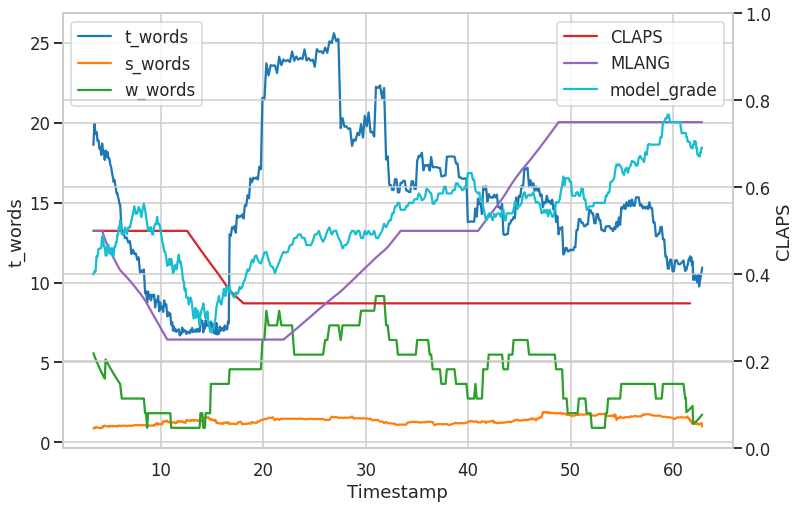

In [ ]:
# tmp = df[df.OBSID == ob].timestamp


ob = 4487
ob = 816
# df[df.OBSID == ob].plot.line(x = "timestamp", y = ["t_40_rolling","s_40_rolling", "w_40_rolling"])
# df[df.OBSID == ob].plot.line(x = "turn_idx", y = ["t_40_rolling","s_40_rolling", "w_40_rolling"])

make_class_heartbeat(ob, second_axis_vars=['CLAPS','MLANG','model_grade'], xinrolling=True, window = 60)

<ipython-input-34-9f3ea7004bf4>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[second_axis_vars] = scaler.fit_transform(df[second_axis_vars])


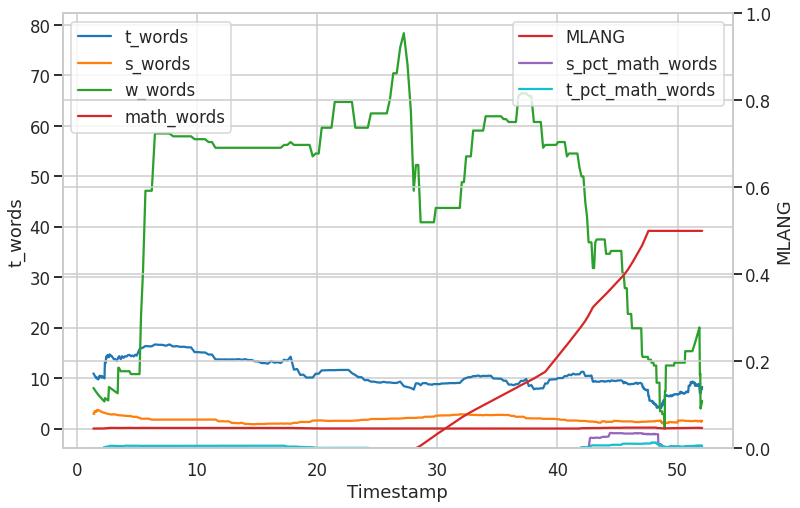

In [ ]:
ob = 4487
# ob = 816
make_class_heartbeat(ob, first_axis_vars = ['t_words','s_words','w_words','math_words'],
                         second_axis_vars = ['MLANG','s_pct_math_words','t_pct_math_words'],
                         xvar = 'timestamp',
                         xinrolling = True,
                         window = 80)

,speaker,text,year,OBSID,video_id,cleaned_text,num_words,turn_idx,comb_idx,t,...,LATASK,LESSCLEAR,TASKDEVMAT,ERRANN,WORLD,math_words,log_math_words,pct_math_words,s_pct_math_words,t_pct_math_words
0,teacher,"Friends, yesterday we started off by working o...",2,2119,706,friends yesterday we started off by working on...,13,0,2119_0,1,...,NaN,NaN,NaN,NaN,NaN,1,0.693147,0.076923,NaN,0.076923
1,student,Yes.,2,2119,706,yes,1,1,2119_1,0,...,NaN,NaN,NaN,NaN,NaN,0,0.000000,0.000000,0.0,NaN
2,teacher,"And yesterday towards the end of the period, y...",2,2119,706,and yesterday towards the end of the period yo...,38,2,2119_2,1,...,NaN,NaN,NaN,NaN,NaN,1,0.693147,0.026316,NaN,0.026316
3,multiple students,Yes.,2,2119,706,yes,1,3,2119_3,0,...,NaN,NaN,NaN,NaN,NaN,0,0.000000,0.000000,0.0,NaN
4,teacher,Some of you might be done. If you are finishe...,2,2119,706,some of you might be done if you are finished ...,106,4,2119_4,1,...,NaN,NaN,NaN,NaN,NaN,0,0.000000,0.000000,NaN,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
579974,teacher,Can you hit the mouse so we can see. You shoul...,1,315,445,can you hit the mouse so we can see you should...,32,515,315_515,1,...,NaN,NaN,NaN,NaN,NaN,0,0.000000,0.000000,NaN,0.000000
579975,student,I’ll go first.,1,315,445,i ll go first,4,516,315_516,0,...,NaN,NaN,NaN,NaN,NaN,0,0.000000,0.000000,0.0,NaN
579976,teacher,What do you want to ask her if she has?,1,315,445,what do you want to ask her if she has,10,517,315_517,1,...,NaN,NaN,NaN,NaN,NaN,0,0.000000,0.000000,NaN,0.000000
579977,student,"If she has 5, 1.",1,315,445,if she has 5 1,5,518,315_518,0,...,NaN,NaN,NaN,NaN,NaN,0,0.000000,0.000000,0.0,NaN


In [ ]:
df[df.comb_idx == '2119_321']

,level_0,speaker,text,year,OBSID,video_id,cleaned_text,num_words,turn_idx,comb_idx,...,LATASK,LESSCLEAR,TASKDEVMAT,ERRANN,WORLD,math_words,log_math_words,pct_math_words,s_pct_math_words,t_pct_math_words
NaN,NaN,student,Where's the pictures?,2,2119,706,where s the pictures,4,321,2119_321,...,NaN,NaN,NaN,NaN,NaN,0,0.0,0.0,0.0,NaN


In [ ]:
# df.groupby('OBSID').mean().to_csv(DATA_FOLDER + "all_obs_meaned.csv")
# df.groupby('OBSID').max().to_csv(DATA_FOLDER + "all_obs_maxed.csv")

<ipython-input-68-1487de10f028>:2: FutureWarning: Dropping invalid columns in DataFrameGroupBy.max is deprecated. In a future version, a TypeError will be raised. Before calling .max, select only columns which should be valid for the function.
  df.groupby('OBSID').max().to_csv(DATA_FOLDER + "all_obs_maxed.csv")


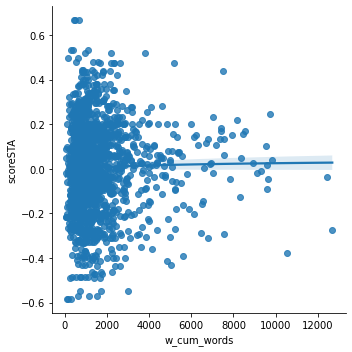

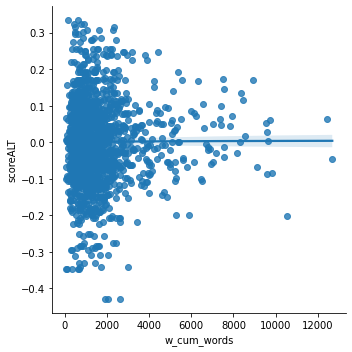

In [ ]:
tmp = pd.concat([df.groupby(by='OBSID').w_cum_words.max(),df.groupby(by='OBSID').scoreSTA.mean(),df.groupby(by='OBSID').scoreALT.mean()],axis=1)

sns.lmplot(data=tmp, x = 'w_cum_words', y = 'scoreSTA')
sns.lmplot(data=tmp, x = 'w_cum_words', y = 'scoreALT')

In [ ]:
tmp.iloc[np.argmax(tmp.has_timestamp),:]

w_cum_words      1898.207407
has_timestamp      13.000000
scoreSTA           -0.029140
scoreALT            0.072557
Name: 816, dtype: float64

In [ ]:
tmp = pd.concat([df.groupby(by='OBSID').w_cum_words.max(),df.groupby(by='OBSID').has_timestamp.sum(),df.groupby(by='OBSID').scoreSTA.mean(),df.groupby(by='OBSID').scoreALT.mean()],axis=1)


In [ ]:
df.shape

(579979, 48)

In [ ]:


df.to_pickle(DATA_FOLDER + "augmented_transcript_reduced_work_words.pkl")

In [ ]:
edf = pd.read_pickle(DATA_FOLDER + "transcript_w_predictions.pkl")
edf.index = edf.comb_idx
edf = edf[['model_grade','model_domain']]
df = pd.merge(df,edf,left_on='comb_idx',right_index=True,how='left')


# NER Checks (for Dora)

In [ ]:
['conversations','Crosstalk','student? but not Student X','yell','discuss','walk','noise','scribbling','whispering','chatter','side comment','pair','play..game| cards','students checking answers','quiz']

['papers']

['video','movie']

['mumbling','background']

['Students putting items away and cleaning up']

['long pause','no response']

['Students trying to figure out pattern']

['end of audio'] 'audio'

checktimestamps = ':',
'yell'
['Leave me alone.']


['Begins reading book:', 'Continues reading:', 'Continues reading:', 'Continues reading:', 'Continues reading:', 'Continues reading:', 'Continues reading:', 'Continues reading:']
['Continues reading:', 'Continues reading:']
['Continues reading:', 'Continues reading:', 'End of story.']
['screaming','yelling','laugh','giggle']

['French','Spanish','foreign','Portuguese','Creole','Chinese']

['Indiscernible','unintelligible']


['writes on board','writes equation']

In [ ]:
['Argo']
['Amah']
['Argo']
['Amah']
['Argo']
['Amah']
['Mina', 'Trousdale', 'Mary Church Terrell School'] : https://profiles.dcps.dc.gov/pdf/mc-terrell2012.pdf

['Benny']

['Greentree']

['Amcast']
['Brockton']
['Angelo', 'Baker']
['Jacinta']

['Bishin']
['Juliani']
['Writes on board']
['Naema']
['Clears throat']
['Alem', 'Tudor']

['Hepron’s']
['Jonah']

['Macula']
['Percy']

['Margaret']
['Sanchez']


['SpongeBob', 'Nathan']
['Patrick', '25 cents']
['Frankie’s',]
['Claudia', 'Jan']
['Sowser']
['lasso', 'lasso']
['Hawk', 'Bond', 'Bond', 'Bond']

['Mrs. Firoli']
['Mrs. Blanchard']
['Bennett']

['Gwinnett']
['Harbin’s']

['Georgia town']

['Chapman.']
['Cliff']


['Brockton']
['Angelo', 'Baker']
['brads']

['Jonah']

['Gwen’s', 'what a film']

['MCAS']
['M- Cass']
['CICT', 'CICT']
EMCAST
UNCAS
['Amcast']
['AYP']

['New York', 'as']

### State Asmt Markers

In [ ]:
testpat = re.compile("[UuAaEe]?[MmNn][Cc][Aa][Ss][SsTt]?|Amcast|M- Cass|AYPCRCT|CICT")

In [ ]:
testpat = re.compile("[UuAaEe]?[MmNn][Cc][Aa][Ss][SsTt]?[Tt]?|Amcast|M[- ]?Cass|[Dd]?[Cc][ -]?C[Aa][Ss][SsTt]?|CAS|AYP|CRCT|CICT|RCT|[Tt]est[ -][Pp]rep")
pat = re.compile("\[([^\]]*?[Ww]ork.*?|[^\]]*?[Ii]ndep.*?|[^\]]*?[Ii]ndivi.*?|[^\]]*?[Gg]roups.*?|[^\]]*?[Qq]uiet.*?|[^\]]*?[Ss]ilen.*?)\]")  #[^\]]*?[Pp]roblem.*?
pat = testpat

df['asmt_comment'] = 0

for i, row in tqdm(df.iterrows(), total = len(df)):
  asdf = pat.findall(row.text)
  if len(asdf) > 0:
    df.loc[i,'asmt_comment'] = len(asdf)
    # print(row.speaker + ":" + row.text)

  0%|          | 0/580408 [00:00<?, ?it/s]

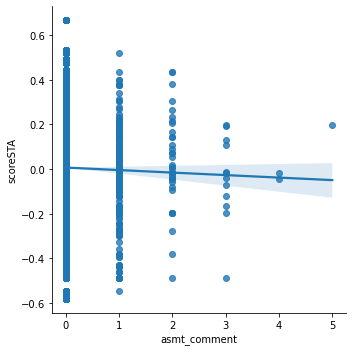

In [ ]:
# df.plot.scatter(x='asmt_comment',y='scoreSTA')

# sns.lmplot(x='asmt_comment',y='scoreSTA',data=df)

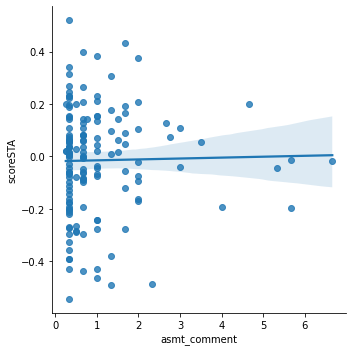

In [ ]:
## This is plotting the average number of references to tests per class per year against the test score earned that year

asdf = pd.concat([df.groupby(['id_year','OBSID']).asmt_comment.sum('asmt_comment').groupby('id_year').mean(),df.groupby('id_year')['scoreSTA'].mean()],axis = 1)

sns.lmplot(data = asdf[asdf.asmt_comment > 0], x = 'asmt_comment', y = 'scoreSTA')


## This is plotting the average number of references to tests per class per year against the test score earned that year ### THIS ONE IS INCORRECT

# asdf = pd.concat([df[df.asmt_comment > 0].groupby(['id_year','OBSID']).asmt_comment.size().groupby('id_year').mean(),df[df.asmt_comment > 0].groupby('id_year')['scoreSTA'].mean()],axis = 1)
# asdf = pd.concat([df[df.asmt_comment > 0].groupby(['id_year','OBSID']).asmt_comment.size().groupby('id_year').mean(),df[df.asmt_comment > 0].groupby('id_year')['scoreSTA'].mean()],axis = 1)
# sns.lmplot(data = asdf, x = 'asmt_comment', y = 'scoreSTA', logx=True)

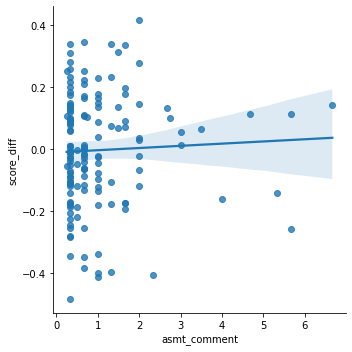

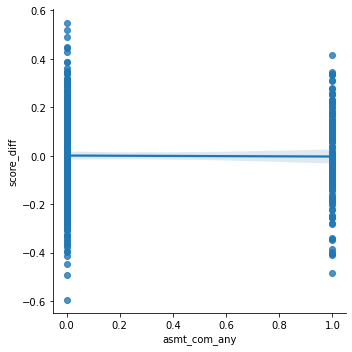

In [ ]:
asdf = pd.concat([df.groupby(['id_year','OBSID']).asmt_comment.sum('asmt_comment').groupby('id_year').mean(),df.groupby('id_year')['scoreSTA'].mean(),df.groupby('id_year')['scoreALT'].mean(),df.groupby('id_year').id_year.unique()],axis = 1)
asdf['score_diff'] = asdf.scoreSTA - asdf.scoreALT
asdf['asmt_com_any'] = asdf.asmt_comment.apply(bool).apply(int)
sns.lmplot(data = asdf[asdf.asmt_comment > 0], x = 'asmt_comment', y = 'score_diff')
sns.lmplot(data = asdf[asdf.asmt_comment > -1], x = 'asmt_com_any', y = 'score_diff')

<AxesSubplot:xlabel='scoreSTA', ylabel='scoreALT'>

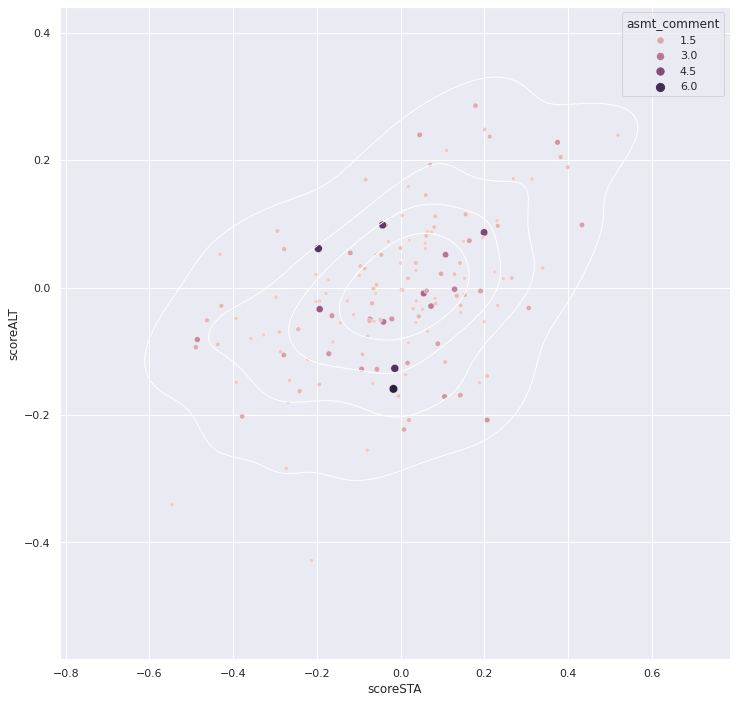

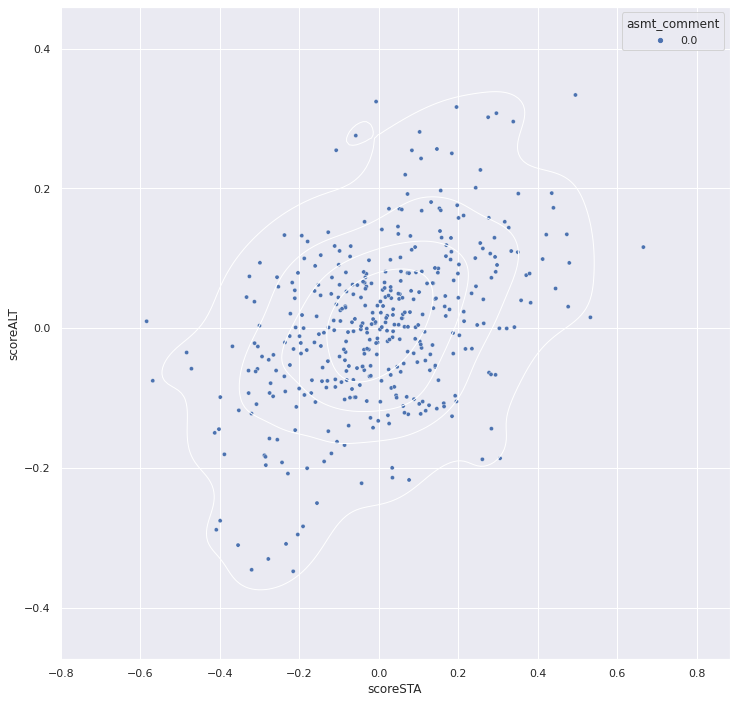

In [ ]:
asdf = pd.concat([df.groupby(['id_year','OBSID']).asmt_comment.sum('asmt_comment').groupby('id_year').mean(),df.groupby('id_year')['scoreSTA'].mean(),df.groupby('id_year')['scoreALT'].mean(),df.groupby('id_year').id_year.unique()],axis = 1)
# sns.displot(data = asdf[asdf.asmt_comment > 0], x = 'asmt_comment', y = 'scoreALT',)

# Draw a combo histogram and scatterplot with density contours
sns.set_theme(style="darkgrid")
f, ax = plt.subplots(figsize=(12, 12))
sns.scatterplot(data = asdf[asdf.asmt_comment > 0], x='scoreSTA', y='scoreALT', s=25, hue="asmt_comment", size="asmt_comment")
# sns.histplot(data = asdf, x='scoreSTA', y='scoreALT', hue="asmt_comment", bins=50, pthresh=.1, cmap="mako")
sns.kdeplot(data = asdf[asdf.asmt_comment > 0], x='scoreSTA', y='scoreALT', levels=5, color="w", linewidths=1)

f, ax = plt.subplots(figsize=(12, 12))
sns.scatterplot(data = asdf[asdf.asmt_comment == 0], x='scoreSTA', y='scoreALT', s=18, hue="asmt_comment", size="asmt_comment")
# sns.histplot(data = asdf, x='scoreSTA', y='scoreALT', hue="asmt_comment", bins=50, pthresh=.1, cmap="mako")
sns.kdeplot(data = asdf[asdf.asmt_comment == 0], x='scoreSTA', y='scoreALT', levels=5, color="w", linewidths=1)

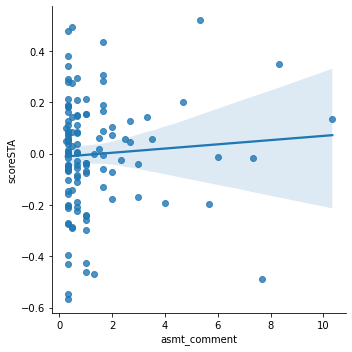

In [ ]:
testpat = re.compile("[UuAaEe]?[MmNn][Cc][Aa][Ss][SsTt]?|Amcast|M- Cass|AYP|[Aa]ssessment")

asdf = pd.concat([df.groupby(['id_year','OBSID']).asmt_comment.sum('asmt_comment').groupby('id_year').mean(),df.groupby('id_year')['scoreSTA'].mean()],axis = 1)

sns.lmplot(data = asdf[asdf.asmt_comment > 0], x = 'asmt_comment', y = 'scoreSTA')

In [ ]:
df.columns

Index(['speaker', 'text', 'year', 'OBSID', 'video_id', 'cleaned_text',
       'num_words', 'turn_idx', 'comb_idx', 't', 'cum_words', 't_words',
       's_words', 't_cum_words', 's_cum_words', 'tt_cum_ratio', 'st_cum_ratio',
       'talk_cum_pct', 't_words_rolling', 's_words_rolling', 't_25_rolling',
       's_25_rolling', 't_40_rolling', 's_40_rolling', 'all_40_rolling',
       'ts_cum_ratio', 'NCTETID', 'id_year', 'scoreSTA', 'scoreALT',
       'scoreSESTA', 'scoreSEALT', 'avgscoreSTA', 'avgscoreALT',
       'avgscoreSESTA', 'avgscoreSEALT', 'has_work_comment', 'asmt_comment'],
      dtype='object')

In [ ]:
pd.concat([df[df.speaker == 'teacher'].groupby(by = 'OBSID').has_work_text.sum(),
           df[df.speaker == 'teacher'].groupby(by = 'OBSID').scoreSTA.mean()], axis =1)

,has_work_text,scoreSTA
OBSID,,
3,3.0,-0.098283
4,9.0,0.421757
5,3.0,-0.546208
7,0.0,0.435624
8,2.0,0.023429
...,...,...
4758,4.0,-0.255992
4759,2.0,-0.179954
4760,5.0,-0.286573


### NER namecheck

In [ ]:
namecheck = ['Argo','Amah','Benny','Gavin','Jacinta','Bishin','Juliani','Naema','Alem', 'Tudor','Hepron','Jonah','Macula','Percy','Sanchez', 'Nathan','Claudia','Mrs. Firoli','Mrs. Blanchard','Bennett','Harbin','Jonah','Gwen']

placecheck = ['[Ll]awrenceville' ,'[gG]winn?et','School','New York', 'Massachusetts','Ohio','Connecticut','Trousdale', 'Mary Church Terrell School','Brockton','Brooklyn','(?<!eorge) [Ww]ashington','room.*?202']
placecheck = ['Lawrenceville' ,'[gG][wl][ei][nm]n?et','Brockton']

# placecheck = ['Gavin']

In [ ]:
pat = re.compile(f"{'|'.join(placecheck)}")  #[^\]]*?[Pp]roblem.*?

# df['asmt_comment'] = 0

for i, row in tqdm(df.iterrows(), total = len(df)):
  asdf = pat.findall(row.text)
  if len(asdf) > 0:
    # df.loc[i,'asmt_comment'] = len(asdf)
    print(str(row.OBSID) + ":" + row.speaker + ":" + row.text)

  0%|          | 0/580408 [00:00<?, ?it/s]

2444:teacher:You know, that is really not a great choice, because people from the county look at it too.  So you might want to think about your behavior, that – and Student T, don’t even get close to that cart.  You need to scoot closer to the table. You know, this is a very expensive camera, so a lot of people can look at this and a lot of people from Gwinnett County look at this.  So you really should be on your really best behavior.  You know how to behave better than that.
2090:teacher:Guys, when you purchase something, your tax is figured on the total amount that you're spending, whether it's 6 cents for every dollar, or 7 cents for every dollar, 8 or 9 cents for every dollar.  That's something your parents are getting ready to vote on in November.  In Gwinnett County, we have something called a SPLOST tax, and a few years ago they voted to have an additional penny tax charge to every dollar, and that additional penny was used for things that were needed for schools, and it was in

In [ ]:
namecheck = ['Argo','Amah','Benny','Gavin','Jacinta','Bishin','Juliani','Naema','Alem', 'Tudor','Hepron','Jonah','Macula','Percy','Sanchez', 'Nathan','Claudia','Mrs. Firoli','Mrs. Blanchard','Bennett','Harbin','Jonah','Gwen']
pat = re.compile(f"{'|'.join(namecheck)}")  #[^\]]*?[Pp]roblem.*?

# df['asmt_comment'] = 0

for i, row in tqdm(df.iterrows(), total = len(df)):
  asdf = pat.findall(row.text)
  if len(asdf) > 0:
    # df.loc[i,'asmt_comment'] = len(asdf)
    print(str(row.OBSID) + ":" + row.speaker + ":" + row.text)

  0%|          | 0/580408 [00:00<?, ?it/s]

2680:student:Dear Jonah, what I thought was – when we were done – what I thought we were going to do today was we were going to have [inaudible] [taking] and do other fun things and teach each other what we don’t get.
2852:teacher:Did you solve it a different way, Student K?  Nathan?
2065:multiple students:And the range. very favorite nights at Harbins is coming up very soon. Anybody want to take a guess at what you think my very favorite night at Harbins is?
2304:teacher:This one does not have centimeters.  Do you know what, you can actually ask [Mrs. Firoli] if she has the other rulers with the centimeters?
2304:teacher:She’s right over there in [Mrs. Blanchard] [Inaudible].
2304:teacher:Ms. [Bennett], can I go [inaudible]?
2978:teacher:Oh, I thought you were sleeping.  Is this and this the same color?  Is it?  No, it looks like it is.  I’m just asking. Did you do this one and this one the same color?  That’s good.  I’m glad you did.  I just couldn’t tell. There’s a highlighter there

In [ ]:
ob = 555
print("\n".join(df[df.OBSID == ob].speaker + ":" + df[df.OBSID == ob].text))

## Xavier, Jacinta, Tyler George, Hunter, Mr. Cohen

teacher:Boys and girls, make sure you have your journals open.  Today’s date is the 9th.  So, let’s write today’s date on your journal page.  Obviously, you could use a page more than once.  You can use the top, middle, bottom, it’s not gonna take up that much room.  So, we have Student L and Student W.
student:You always wanna do Student W.
teacher:Well, I’d like to today.  Now, first of all, Student L, what concept – young lady, what were you gonna practice all week long?
student:3D shapes.
teacher:3D shapes, no, no, no, no, no.  Decimals.
student:Decimals.
teacher:We were gonna practice least to greatest, greatest to least, organizing decimals, putting them in order.  All right, so write down this list of decimals, please.  [Inaudible] 63, let’s do 6.30, let’s also do 0.36, and finally let’s stop with 63.06.
student:Mr. Cohen, isn’t today the 8th?
teacher:Look at the calendar.  Let’s order these from greatest to least.  All right, well, first things first.  On the CRCT, or in our as

In [ ]:
ob = 251
print("\n".join(df[df.OBSID == ob].speaker + ":" + df[df.OBSID == ob].text))

## Bishin, Brenda, CG, Len

teacher:Okay, before we get started, I want every group, and you’ll notice your number is on your group.  So, group one, eyes and ears up here.  Two, three, four, five, and this is gonna be group six.  I would like you to find the volume of your rectangular prism.  So, that is how we are going to start today.  I want you to find the volume of your rectangular prism.  Why don’t you two shift yourselves up here and try to do it quickly and quietly?  Okay?  Thank you.
multiple students:[Multiple comments]
teacher:[Inaudible] Eight and what?  Eight.  Right.  Give me a thumbs up when your group has found the volume of your rectangular prism.  Okay, group six, you’re the only one I don’t see thumbs for.  Are we almost ready?  Len, has your group found the volume?  Do you think you know it?
student:[Inaudible]
teacher:Okay, I’ll give you guys another minute.  Thinking about how we have bending volume, if you need to look at our map wall, please think about how we have been finding volume.  Th

In [ ]:
ob = 2852
print("\n".join(df[df.OBSID == ob].speaker + ":" + df[df.OBSID == ob].text))

## Nathan

teacher:All right, darlings.  As we started to talk yesterday – could All right.  I wanted to take a second and I wanted to talk again just briefly, because there was so many children absent yesterday, and I wanted to share our positives about the A-Net Testing.  Thrilled.  Thrilled.  Thrilled with your grades.  And I’m still going to take up each student separately and show you your results.  Show you your growth.  But as a class we did really well. Again, there were a couple of sections that we didn’t do so well.  We went over two of those problems yesterday, and I think we own them.  We are going to work on those from now, right up until April vacation.  I’m going to throw those same kinds of problems in for you along with others that I know we need reviewing from past testing.  But I know you can get it. So this mornings work, take out your math notebooks for me, okay?  Take out your math notebooks.  Student R, can I see your math notebook, please?
student:[Inaudible].
teacher:Than

In [ ]:
ob = 234
print("\n".join(df[df.OBSID == ob].speaker.apply(str) + ":" + df[df.OBSID == ob].text))

## Brockton and other schools

nan: [Audio starts at 0:04:26]
student:Thank you.
teacher:Mm-hmm.  That was great.  We ready?  Okay.  Thank you Mr. R.
teacher:Shhh.  Don’t be [Inaudible].  Twizzlers, shapes, and patterns. As I read the story to you today, see if you can make a connection to yourself, to math, or to your world.  “Our school is under construction.  An architect came off the job site and walked into our classroom.  She usually designs buildings, but today, she’s teaching us how to draw shapes.”  What are some of the shapes you see in the picture?  Student C?
student:A square.
teacher:A square.  Student B?
student:A triangle.
teacher:A triangle.  What do you see, Student A?
student:I see a circle.
teacher:A circle.  If you still have your hand up, turn to your neighbor and tell them a shape you see.  [Whispering]  The architect drew a dot and told us it was a?  What’s a dot?
student:Oh, like a line try to make a –
teacher:It’s just a dot.
student:Oh, it’s a dot?
teacher:A dot is a point in space.  We kne

251 uses actual student names
555
933
165 is from Washington DC
2609 Ms. D's class, the students in room 202, the 4th graders at the Kennedy School.

In [ ]:
classdf[classdf.OBSID == 2965]

,NCTETID,DISTRICT,CLASS_11,CLASS_12,CLASS_13,SCHOOLYEAR_SP,OBSID,RATERID,OBSYEAR,OBSMONTH,...,CLRSP,CLBM,CLPRDT,CLILF,CLCU,CLAPS,CLQF,CLINSTD,CLSTENG,id_year
1968,12021,12.0,(1) Yes,(1) Yes,(0) No,2012,2965,16.0,2012.0,4.0,...,(2) Low Range (2),(6) High Range (6),(7) High Range (7),(5) Mid Range (5),(5) Mid Range (5),(4) Mid Range (4),(4) Mid Range (4),(4) Mid Range (4),(7) High Range (7),12021_12
1969,12021,12.0,(1) Yes,(1) Yes,(0) No,2012,2965,16.0,2012.0,4.0,...,(2) Low Range (2),(7) High Range (7),(7) High Range (7),(5) Mid Range (5),(5) Mid Range (5),(4) Mid Range (4),(5) Mid Range (5),(5) Mid Range (5),(7) High Range (7),12021_12
1970,12021,12.0,(1) Yes,(1) Yes,(0) No,2012,2965,16.0,2012.0,4.0,...,(2) Low Range (2),(6) High Range (6),(7) High Range (7),(4) Mid Range (4),(4) Mid Range (4),(3) Mid Range (3),(3) Mid Range (3),(4) Mid Range (4),(7) High Range (7),12021_12
1971,12021,12.0,(1) Yes,(1) Yes,(0) No,2012,2965,16.0,2012.0,4.0,...,(2) Low Range (2),(7) High Range (7),(7) High Range (7),(5) Mid Range (5),(4) Mid Range (4),(2) Low Range (2),(3) Mid Range (3),(3) Mid Range (3),(7) High Range (7),12021_12


In [ ]:
classdf[classdf.NCTETID == 12054]

,NCTETID,DISTRICT,CLASS_11,CLASS_12,CLASS_13,SCHOOLYEAR_SP,OBSID,RATERID,OBSYEAR,OBSMONTH,...,CLRSP,CLBM,CLPRDT,CLILF,CLCU,CLAPS,CLQF,CLINSTD,CLSTENG,id_year
2645,12054,12.0,(0) No,(1) Yes,(0) No,2012,2304,15.0,2011.0,12.0,...,(3) Mid Range (3),(7) High Range (7),(7) High Range (7),(3) Mid Range (3),(3) Mid Range (3),(1) Low Range (1),(4) Mid Range (4),(2) Low Range (2),(4) Mid Range (4),12054_12
2646,12054,12.0,(0) No,(1) Yes,(0) No,2012,2304,15.0,2011.0,12.0,...,(4) Mid Range (4),(6) High Range (6),(6) High Range (6),(5) Mid Range (5),(4) Mid Range (4),(1) Low Range (1),(5) Mid Range (5),(4) Mid Range (4),(5) Mid Range (5),12054_12
2647,12054,12.0,(0) No,(1) Yes,(0) No,2012,2304,15.0,2011.0,12.0,...,(5) Mid Range (5),(7) High Range (7),(7) High Range (7),(5) Mid Range (5),(5) Mid Range (5),(3) Mid Range (3),(5) Mid Range (5),(4) Mid Range (4),(6) High Range (6),12054_12
2648,12054,12.0,(0) No,(1) Yes,(0) No,2012,2304,15.0,2011.0,12.0,...,(4) Mid Range (4),(6) High Range (6),(7) High Range (7),(5) Mid Range (5),(5) Mid Range (5),(2) Low Range (2),(5) Mid Range (5),(4) Mid Range (4),(5) Mid Range (5),12054_12
2649,12054,12.0,(0) No,(1) Yes,(0) No,2012,2670,4.0,2012.0,2.0,...,(4) Mid Range (4),(6) High Range (6),(6) High Range (6),(5) Mid Range (5),(5) Mid Range (5),(3) Mid Range (3),(5) Mid Range (5),(5) Mid Range (5),(6) High Range (6),12054_12
2650,12054,12.0,(0) No,(1) Yes,(0) No,2012,2670,4.0,2012.0,2.0,...,(4) Mid Range (4),(6) High Range (6),(6) High Range (6),(5) Mid Range (5),(5) Mid Range (5),(3) Mid Range (3),(4) Mid Range (4),(4) Mid Range (4),(6) High Range (6),12054_12
2651,12054,12.0,(0) No,(1) Yes,(0) No,2012,2670,4.0,2012.0,2.0,...,(4) Mid Range (4),(4) Mid Range (4),(6) High Range (6),(6) High Range (6),(4) Mid Range (4),(3) Mid Range (3),(4) Mid Range (4),(5) Mid Range (5),(6) High Range (6),12054_12
2652,12054,12.0,(0) No,(1) Yes,(0) No,2012,2938,8.0,2012.0,3.0,...,(3) Mid Range (3),(7) High Range (7),(7) High Range (7),(5) Mid Range (5),(3) Mid Range (3),(3) Mid Range (3),(3) Mid Range (3),(3) Mid Range (3),(5) Mid Range (5),12054_12
2653,12054,12.0,(0) No,(1) Yes,(0) No,2012,2938,8.0,2012.0,3.0,...,(3) Mid Range (3),(7) High Range (7),(7) High Range (7),(4) Mid Range (4),(3) Mid Range (3),(3) Mid Range (3),(2) Low Range (2),(3) Mid Range (3),(5) Mid Range (5),12054_12
2654,12054,12.0,(0) No,(1) Yes,(0) No,2012,2938,8.0,2012.0,3.0,...,(3) Mid Range (3),(7) High Range (7),(7) High Range (7),(4) Mid Range (4),(3) Mid Range (3),(3) Mid Range (3),(3) Mid Range (3),(3) Mid Range (3),(5) Mid Range (5),12054_12


#### Districts

Brockton County Schools

In [ ]:
classdf[classdf.DISTRICT == 12].OBSID.nunique()/classdf.OBSID.nunique()

0.19089316987740806

In [ ]:
elem_schools = ['Angelo' ,
'Arnone' ,
'Baker' ,
'Brookfield' ,
'Downey' ,
'Manthala', #'George',
'Gilmore' ,
'Hancock' ,
'Kennedy' ,
'Raymond']

pat = re.compile(f"{'|'.join(elem_schools)}")  #[^\]]*?[Pp]roblem.*?

# df['asmt_comment'] = 0

for i, row in tqdm(df.iterrows(), total = len(df)):
  asdf = pat.findall(row.text)
  if len(asdf) > 0:
    # df.loc[i,'asmt_comment'] = len(asdf)
    print(str(row.OBSID) + ":" + row.speaker + ":" + row.text)

  0%|          | 0/579979 [00:00<?, ?it/s]

2965:teacher:Yes, Massachusetts says, “How is our school doing compared to all the other schools in the state?  How is our class doing compared to all the other classes in our city?” Right?  Student J, do you know that there’s something looking at you all morning, because I’m going to be very sad when we watch this.  While practicing my MCASS strategy, I’ll be able to answer and label all parts of the question about Hudson’s Bakery.  I will be able to show or explain how I got my answers.  I’m going to give you an open response question in a minute, and I did go to the Department of Education Website and I printed out some answers that actual 4th graders did, and we’re going to grade them together just like we do.  Now tell me the highest score you can get on an open response question, Student G.
2965:teacher:Okay, stop right there.  I’m so glad you know bakeries sell cakes.  So we’re going to read a problem about Hudson’s Bakery and we’re going to solve it.  There are three parts to t

Washington DC

In [ ]:
classdf[classdf.DISTRICT == 13].OBSID.nunique()/classdf.OBSID.nunique()

0.1190893169877408

Gwinnett County

In [ ]:
classdf[classdf.DISTRICT == 14].OBSID.nunique()/classdf.OBSID.nunique()

0.46409807355516636

In [ ]:
testpat = re.compile("[UuAaEe]?[MmNn][Cc][Aa][Ss][SsTt]?|Amcast|M- Cass|AYP")

pat = re.compile("\[([^\]]*?[Ww]ork.*?|[^\]]*?[Ii]ndep.*?|[^\]]*?[Ii]ndivi.*?|[^\]]*?[Gg]roups.*?|[^\]]*?[Qq]uiet.*?|[^\]]*?[Ss]ilen.*?)\]")  #[^\]]*?[Pp]roblem.*?
pat = testpat

df['asmt_comment'] = 0

for i, row in tqdm(df.iterrows(), total = len(df)):
  asdf = pat.findall(row.text)
  if len(asdf) > 0:
    df.loc[i,'asmt_comment'] = len(asdf)
    print(row.speaker + ":" + row.text)

Index(['speaker', 'text', 'year', 'OBSID', 'video_id', 'cleaned_text',
       'num_words', 'turn_idx', 'comb_idx', 't', 'cum_words', 't_words',
       's_words', 't_cum_words', 's_cum_words', 'tt_cum_ratio', 'st_cum_ratio',
       'talk_cum_pct', 't_words_rolling', 's_words_rolling', 't_25_rolling',
       's_25_rolling', 't_40_rolling', 's_40_rolling', 'all_40_rolling',
       'ts_cum_ratio', 'NCTETID', 'id_year', 'scoreSTA', 'scoreALT',
       'scoreSESTA', 'scoreSEALT', 'avgscoreSTA', 'avgscoreALT',
       'avgscoreSESTA', 'avgscoreSEALT', 'has_work_text'],
      dtype='object')

# Clean and Combining

## Explode sentences

In [ ]:
import nltk
from nltk.tokenize.punkt import PunktSentenceTokenizer
sent_tokenizer = lambda s: PunktSentenceTokenizer().tokenize(s)


# re.sub(r'\sAND\s', ' & ', 'Baked Beans And Spam', flags=re.IGNORECASE)
# pat = re.compile('\[[^\]]*?\]')
# df[df.text.apply(lambda x: bool(pat.search(str(x))))].text.apply(lambda x: re.sub(pat, '<UNK>', str(x)))



# f"\[([^\]]*?)\]"

# df.cleaned_text.iloc[0]
# pat.search(df.cleaned_text.iloc[0])
# df.text.loc[579452]

def replace_annotations(text):
  pat = re.compile('\[[^\]]*?\]')
  return re.sub(pat, '<UNK>', str(text))

def text_cell_clean(text):
  # 0. replace annotations
  text = replace_annotations(text)
  # # 1. basic cleaning
  # clean_txt = basic_clean(text)
  # # 2. expand contractions
  # expand_txt = expand_contract(clean_txt)
  # # 3. normalize math symbols
  # nor_txt = normalize_math_symbol(expand_txt)
  # 4. sentence tokenization
  sentences = sent_tokenizer(text)
  return sentences

# df[df.text.apply(lambda x: bool(pat.search(str(x))))].text.apply(lambda x: text_cell_clean(x))
# df.text.apply(lambda x: text_cell_clean(x)).apply(len).hist()

In [ ]:
df['text_sent'] = df.text.apply(lambda x: text_cell_clean(x))
df = df.explode('text_sent')
df.shape

(1412404, 126)

In [ ]:
df['text_sent'] = df.text.apply(lambda x: text_cell_clean(x))
df = df.explode('text_sent')
df.shape

(1412404, 126)

## Scaling and adjusting

In [ ]:
rating_cols = df.loc[:,'CLPC':'MMSM'].columns.tolist() + df.loc[:,'ORIENT':'WORLD'].columns.tolist()
scaler = MinMaxScaler()
df[rating_cols] = scaler.fit_transform(df[rating_cols])

# List of column pairs
column_pairs = [('ORICH', 'ORICH4'), ('OWWS', 'OWWS4'),('OERR','OERR4'),('OSPMMR','OSPMMR4'),('SMALDIS','FORMAT_SMALLGRP')]

# Iterate over column pairs
for pair in column_pairs:
    # Compute the mean of the columns
    mean_col = np.nanmean(df[list(pair)], axis=1)
    # Create new column with combined mean
    new_col_name = pair[0] + 'C'
    df[new_col_name] = mean_col
    # Remove old columns
    # df = df.drop(list(pair), axis=1)

df.SMALDISC

In [ ]:
# List of column pairs
column_pairs = [('ORICH', 'ORICH4'), ('OWWS', 'OWWS4'),('OERR','OERR4'),('OSPMMR','OSPMMR4'),('SMALDIS','FORMAT_SMALLGRP')]

# Iterate over column pairs
for pair in column_pairs:
    # Compute the mean of the columns
    mean_col = np.nanmean(df[list(pair)], axis=1)
    # Create new column with combined mean
    new_col_name = pair[0] + 'C'
    df[new_col_name] = mean_col
    # Remove old columns
    # df = df.drop(list(pair), axis=1)

df.SMALDISC

<ipython-input-20-c7982c651a68>:7: RuntimeWarning: Mean of empty slice
  mean_col = np.nanmean(df[list(pair)], axis=1)
<ipython-input-20-c7982c651a68>:7: RuntimeWarning: Mean of empty slice
  mean_col = np.nanmean(df[list(pair)], axis=1)
<ipython-input-20-c7982c651a68>:7: RuntimeWarning: Mean of empty slice
  mean_col = np.nanmean(df[list(pair)], axis=1)
<ipython-input-20-c7982c651a68>:7: RuntimeWarning: Mean of empty slice
  mean_col = np.nanmean(df[list(pair)], axis=1)
<ipython-input-20-c7982c651a68>:7: RuntimeWarning: Mean of empty slice
  mean_col = np.nanmean(df[list(pair)], axis=1)


0.0          0.5
1.0          0.5
2.0          0.5
3.0          0.5
4.0          0.5
            ... 
1404138.0    NaN
NaN          NaN
NaN          NaN
NaN          NaN
NaN          NaN
Name: SMALDISC, Length: 1412404, dtype: float64

In [ ]:
df = df.reset_index(drop=True)

,speaker,text,year,OBSID,video_id,cleaned_text,num_words,turn_idx,comb_idx,t,...,OERR4,STEXPL,SMQR,ETCA,OSPMMR,OSPMMR4,STUCON,STUCOM,SMALDIS,MMSM
0.0,teacher,"Friends, yesterday we started off by working o...",2,2119,706,friends yesterday we started off by working on...,13,0,2119_0,1,...,0.0,0.5,0.0,0.25,0.5,0.666667,NaN,NaN,NaN,NaN
1.0,student,Yes.,2,2119,706,yes,1,1,2119_1,0,...,0.0,0.5,0.0,0.25,0.5,0.666667,NaN,NaN,NaN,NaN
2.0,teacher,"And yesterday towards the end of the period, y...",2,2119,706,and yesterday towards the end of the period yo...,38,2,2119_2,1,...,0.0,0.5,0.0,0.25,0.5,0.666667,NaN,NaN,NaN,NaN
3.0,multiple students,Yes.,2,2119,706,yes,1,3,2119_3,0,...,0.0,0.5,0.0,0.25,0.5,0.666667,NaN,NaN,NaN,NaN
4.0,teacher,Some of you might be done.,2,2119,706,some of you might be done if you are finished ...,6,4,2119_4,1,...,0.0,0.5,0.0,0.25,0.5,0.666667,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1404138.0,teacher,Okay so let’s start over who wants to go first?,1,315,445,can you hit the mouse so we can see you should...,10,515,315_515,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
NaN,student,I’ll go first.,1,315,445,i ll go first,3,516,315_516,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
NaN,teacher,What do you want to ask her if she has?,1,315,445,what do you want to ask her if she has,10,517,315_517,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
NaN,student,"If she has 5, 1.",1,315,445,if she has 5 1,5,518,315_518,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
df = df.reset_index(drop=True)
gc.collect()
df

,speaker,text,year,OBSID,video_id,cleaned_text,num_words,turn_idx,comb_idx,t,...,OERR4,STEXPL,SMQR,ETCA,OSPMMR,OSPMMR4,STUCON,STUCOM,SMALDIS,MMSM
0,teacher,"Friends, yesterday we started off by working o...",2,2119,706,friends yesterday we started off by working on...,13,0,2119_0,1,...,0.0,0.5,0.0,0.25,0.5,0.666667,NaN,NaN,NaN,NaN
1,student,Yes.,2,2119,706,yes,1,1,2119_1,0,...,0.0,0.5,0.0,0.25,0.5,0.666667,NaN,NaN,NaN,NaN
2,teacher,"And yesterday towards the end of the period, y...",2,2119,706,and yesterday towards the end of the period yo...,38,2,2119_2,1,...,0.0,0.5,0.0,0.25,0.5,0.666667,NaN,NaN,NaN,NaN
3,multiple students,Yes.,2,2119,706,yes,1,3,2119_3,0,...,0.0,0.5,0.0,0.25,0.5,0.666667,NaN,NaN,NaN,NaN
4,teacher,Some of you might be done.,2,2119,706,some of you might be done if you are finished ...,6,4,2119_4,1,...,0.0,0.5,0.0,0.25,0.5,0.666667,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1412399,teacher,Okay so let’s start over who wants to go first?,1,315,445,can you hit the mouse so we can see you should...,10,515,315_515,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1412400,student,I’ll go first.,1,315,445,i ll go first,3,516,315_516,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1412401,teacher,What do you want to ask her if she has?,1,315,445,what do you want to ask her if she has,10,517,315_517,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1412402,student,"If she has 5, 1.",1,315,445,if she has 5 1,5,518,315_518,0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


# Rolling Window Funcs Checks

In [ ]:
cols = ['speaker', 'text',  'cleaned_text', 'text_sent',
        'year', 'OBSID', 'NCTETID', 'id_year',
        'num_words','math_words','n_words',
        'turn_idx',  'comb_idx',  't',
        'cum_words', 'ncum_words'
        't_words', 'nt_words','t_cum_words',
        's_words', 'ns_words', 's_cum_words',
        'scoreSTA', 'scoreALT', 'avgscoreSTA', 'avgscoreALT',
 'timestamp', 'has_work_comment', 'ind_practice', 'group_work',
 'adj_num_words', 'adj_cum_words',
 'w_words', 'w_cum_words',
 'model_grade',
 'model_domain',
 'CLPC', 'CLNC', 'CLTS', 'CLRSP', 'CLBM', 'CLPRDT', 'CLILF', 'CLCU', 'CLAPS', 'CLQF', 'CLINSTD', 'CLSTENG',
 'FORMAT_ACTIVE', 'FORMAT_BOTH', 'FORMAT_SMALLGRP', 'DIRINST', 'APLPROB', 'CWCM', 'WCDISS','SMALDIS','SMALDISC',
 'LINK', 'EXPL', 'MMETH', 'MGEN', 'MLANG', 'ORICH', 'ORICH4','ORICHC',
 'REMED', 'USEPROD', 'MATCON', 'OWWS', 'OWWS4','OWWSC',
 'MAJERR', 'LANGIMP', 'LCP', 'OERR', 'OERR4','OERRC',
 'STEXPL', 'SMQR', 'ETCA', 'OSPMMR', 'OSPMMR4','OSPMMRC'
 'STUCON', 'STUCOM', 'MMSM',
 'ORIENT', 'SUMM', 'MQI_CHECK', 'DIFFINST', 'LLC', 'MQI3', 'MKT3', 'MQI5', 'MKT5',
 'TSTUDEA', 'TREMSTU', 'STUENG', 'CLMATINQ', 'LESSEFFIC', 'DENSMAT', 'LATASK', 'LESSCLEAR',
 'TASKDEVMAT', 'ERRANN', 'WORLD',
 ]

In [ ]:
# # scaler = MinMaxScaler()
# ## make a tmp dataframe
# tdf = df[first_axis_vars + second_axis_vars + [xvar]]
# tdf[second_axis_vars] = scaler.fit_transform(df[second_axis_vars])

tdf = copy.deepcopy(df[])
window = 40
min_periods = 10

if xinrolling:
  tdf = tdf[df.OBSID == ob].rolling(window=window,min_periods = min_periods, closed = 'both', center=True).mean()
else:
  tdf = tdf[df.OBSID == ob] #[first_axis_vars + second_axis_vars + [xvar]]
  tdf[first_axis_vars + second_axis_vars] = tdf[first_axis_vars + second_axis_vars].rolling(window=window,min_periods = min_periods, closed = 'both', center=True).mean()


,speaker,text,year,OBSID,video_id,cleaned_text,num_words,turn_idx,comb_idx,t,...,s_pct_math_words,t_pct_math_words,s_math,t_math,text_sent,ORICHC,OWWSC,OERRC,OSPMMRC,SMALDISC
0,teacher,"Friends, yesterday we started off by working o...",2,2119,706,friends yesterday we started off by working on...,13,0,2119_0,1,...,NaN,0.076923,0,1,"Friends, yesterday we started off by working o...",0.291667,0.583333,0.0,0.583333,0.5
1,student,Yes.,2,2119,706,yes,1,1,2119_1,0,...,0.0,NaN,0,0,Yes.,0.291667,0.583333,0.0,0.583333,0.5
2,teacher,"And yesterday towards the end of the period, y...",2,2119,706,and yesterday towards the end of the period yo...,38,2,2119_2,1,...,NaN,0.026316,0,1,"And yesterday towards the end of the period, y...",0.291667,0.583333,0.0,0.583333,0.5
3,multiple students,Yes.,2,2119,706,yes,1,3,2119_3,0,...,0.0,NaN,0,0,Yes.,0.291667,0.583333,0.0,0.583333,0.5
4,teacher,Some of you might be done. If you are finishe...,2,2119,706,some of you might be done if you are finished ...,106,4,2119_4,1,...,NaN,0.000000,0,0,Some of you might be done.,0.291667,0.583333,0.0,0.583333,0.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1412399,teacher,Can you hit the mouse so we can see. You shoul...,1,315,445,can you hit the mouse so we can see you should...,32,515,315_515,1,...,NaN,0.000000,0,0,Okay so let’s start over who wants to go first?,NaN,NaN,NaN,NaN,NaN
1412400,student,I’ll go first.,1,315,445,i ll go first,4,516,315_516,0,...,0.0,NaN,0,0,I’ll go first.,NaN,NaN,NaN,NaN,NaN
1412401,teacher,What do you want to ask her if she has?,1,315,445,what do you want to ask her if she has,10,517,315_517,1,...,NaN,0.000000,0,0,What do you want to ask her if she has?,NaN,NaN,NaN,NaN,NaN
1412402,student,"If she has 5, 1.",1,315,445,if she has 5 1,5,518,315_518,0,...,0.0,NaN,0,0,"If she has 5, 1.",NaN,NaN,NaN,NaN,NaN


In [ ]:
# sent_num_words = df.text_sent.apply(str).str.split().apply(len)
df.text = df.text_sent
df = df.drop(columns='text_sent')

In [ ]:

sent_num_words = df.text.apply(str).str.split().apply(len)
df['num_words'] = sent_num_words
df['t_words'] = df.t * sent_num_words
df['s_words'] = abs(df.t -1) * sent_num_words
df['cum_words'] = df.groupby(by= "OBSID").num_words.cumsum()

<Axes: >

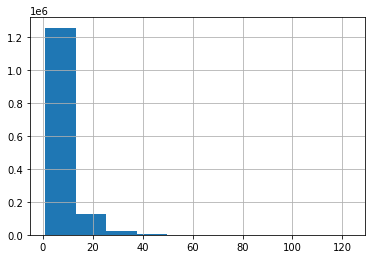

In [ ]:
# sent_num_words.hist()

In [ ]:
df.columns.tolist()

['speaker',
 'text',
 'year',
 'OBSID',
 'video_id',
 'cleaned_text',
 'num_words',
 'turn_idx',
 'comb_idx',
 't',
 'cum_words',
 't_words',
 's_words',
 't_cum_words',
 's_cum_words',
 'tt_cum_ratio',
 'st_cum_ratio',
 'talk_cum_pct',
 't_words_rolling',
 's_words_rolling',
 't_25_rolling',
 's_25_rolling',
 't_40_rolling',
 's_40_rolling',
 'all_40_rolling',
 'ts_cum_ratio',
 'NCTETID',
 'id_year',
 'scoreSTA',
 'scoreALT',
 'scoreSESTA',
 'scoreSEALT',
 'avgscoreSTA',
 'avgscoreALT',
 'avgscoreSESTA',
 'avgscoreSEALT',
 'has_timestamp',
 'timestamp',
 'has_work_comment',
 'ind_practice',
 'group_work',
 'adj_num_words',
 'adj_cum_words',
 'w_words',
 'w_cum_words',
 'w_words_rolling',
 'w_25_rolling',
 'w_40_rolling',
 'model_grade',
 'model_domain',
 'level_0_x',
 'level_0_y',
 'CLPC',
 'CLNC',
 'CLTS',
 'CLRSP',
 'CLBM',
 'CLPRDT',
 'CLILF',
 'CLCU',
 'CLAPS',
 'CLQF',
 'CLINSTD',
 'CLSTENG',
 'SEGMENT',
 'FORMAT_ACTIVE',
 'FORMAT_BOTH',
 'FORMAT_SMALLGRP',
 'DIRINST',
 'APLPROB'

In [ ]:
df["cum_words"]=df.groupby(by= "OBSID").num_words.cumsum()
df['t_words'] = df.t * df.num_words
df['s_words'] = abs(df.t -1) * df.num_words
df["t_cum_words"]=df.groupby(by= "OBSID").t_words.cumsum()
df["s_cum_words"]=df.groupby(by= "OBSID").s_words.cumsum()
df['tt_cum_ratio'] = df["t_cum_words"]/df.cum_words
df['st_cum_ratio'] = df["s_cum_words"]/df.cum_words
df['talk_cum_pct'] = df.groupby(by="OBSID", sort = False).apply(lambda x: x.cum_words/x.num_words.sum()).values
df["t_words_rolling"] = df.groupby(by="OBSID",sort=False).t_words.rolling(7).mean().values
df["s_words_rolling"] = df.groupby(by="OBSID",sort=False).s_words.rolling(7).mean().values
df["t_25_rolling"] = df.groupby(by="OBSID",sort=False).t_words.rolling(25).mean().values
df["s_25_rolling"] = df.groupby(by="OBSID",sort=False).s_words.rolling(25).mean().values
df["t_40_rolling"] = df.groupby(by="OBSID",sort=False).t_words.rolling(40).mean().values
df["s_40_rolling"] = df.groupby(by="OBSID",sort=False).s_words.rolling(40).mean().values
df["all_40_rolling"] = df.groupby(by="OBSID",sort=False).num_words.rolling(40).mean().values
df["ts_cum_ratio"] = df["s_cum_words"] / df["t_cum_words"]
df

In [ ]:
gc.collect()

146

In [ ]:
df.columns.tolist()

['speaker',
 'text',
 'year',
 'OBSID',
 'video_id',
 'cleaned_text',
 'num_words',
 'turn_idx',
 'comb_idx',
 't',
 'cum_words',
 't_words',
 's_words',
 't_cum_words',
 's_cum_words',
 'tt_cum_ratio',
 'st_cum_ratio',
 'talk_cum_pct',
 't_words_rolling',
 's_words_rolling',
 't_25_rolling',
 's_25_rolling',
 't_40_rolling',
 's_40_rolling',
 'all_40_rolling',
 'ts_cum_ratio',
 'NCTETID',
 'id_year',
 'scoreSTA',
 'scoreALT',
 'scoreSESTA',
 'scoreSEALT',
 'avgscoreSTA',
 'avgscoreALT',
 'avgscoreSESTA',
 'avgscoreSEALT',
 'has_timestamp',
 'timestamp',
 'has_work_comment',
 'ind_practice',
 'group_work',
 'adj_num_words',
 'adj_cum_words',
 'w_words',
 'w_cum_words',
 'w_words_rolling',
 'w_25_rolling',
 'w_40_rolling',
 'model_grade',
 'model_domain',
 'level_0_x',
 'level_0_y',
 'CLPC',
 'CLNC',
 'CLTS',
 'CLRSP',
 'CLBM',
 'CLPRDT',
 'CLILF',
 'CLCU',
 'CLAPS',
 'CLQF',
 'CLINSTD',
 'CLSTENG',
 'SEGMENT',
 'FORMAT_ACTIVE',
 'FORMAT_BOTH',
 'FORMAT_SMALLGRP',
 'DIRINST',
 'APLPROB'

<Axes: >

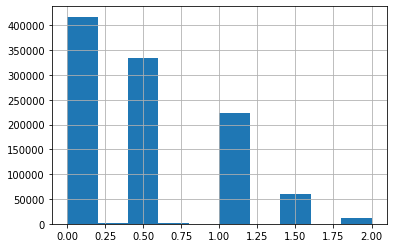

In [ ]:
# df[df.speaker=='teacher'].MLANG.hist()

In [ ]:
nan_dict = {}
rating_cols = df.loc[:,'CLPC':'MMSM'].columns.tolist() + ['ORICHC','OERRC','OWWSC','OSPMMRC','SMALDISC']
for ob, group in tqdm(df[df.speaker == 'teacher'].groupby(by='OBSID'),total=len(df[df.speaker == 'teacher'].groupby(by='OBSID'))):
  nan_dict[ob] = {}
  for rating in rating_cols:
    nan_dict[ob][rating] = {}
    nan_dict[ob][rating]['has_nan'] = any(group[rating].isnull())
    nan_dict[ob][rating]['all_nan'] = all(group[rating].isnull())
    nan_dict[ob][rating]['nan_proportion'] = sum(group[rating].isnull())/len(group)
    nan_dict[ob][rating]['nanmean'] = np.nanmean(group[rating])

obs_check = pd.DataFrame(nan_dict).T
for r in rating_cols:
  print("*"*50)
  print(r)
  print(f'All: {obs_check[r].apply(lambda x: int(x["all_nan"])).mean()}')
  print(f'Any: {obs_check[r].apply(lambda x: int(x["has_nan"])).mean()}')
  print(f'Portion: {obs_check[r].apply(lambda x: x["nan_proportion"]).mean()}')

  0%|          | 0/1658 [00:00<?, ?it/s]

<ipython-input-75-309caba0fa52>:10: RuntimeWarning: Mean of empty slice
  nan_dict[ob][rating]['nanmean'] = np.nanmean(group[rating])


**************************************************
CLPC
All: 0.0018094089264173703
Any: 0.6429433051869723
Portion: 0.07905454183341884
**************************************************
CLNC
All: 0.0018094089264173703
Any: 0.6423401688781665
Portion: 0.07854355304714485
**************************************************
CLTS
All: 0.0018094089264173703
Any: 0.6447527141133896
Portion: 0.08087339484394977
**************************************************
CLRSP
All: 0.0018094089264173703
Any: 0.6453558504221955
Portion: 0.08028635118882538
**************************************************
CLBM
All: 0.0018094089264173703
Any: 0.6459589867310012
Portion: 0.07981424947445877
**************************************************
CLPRDT
All: 0.0018094089264173703
Any: 0.643546441495778
Portion: 0.07901011642008708
**************************************************
CLILF
All: 0.0018094089264173703
Any: 0.6441495778045838
Portion: 0.08007750164951802
*********************************************

In [ ]:
df = df.reset_index(drop=True)

In [ ]:
obs_check = pd.DataFrame(nan_dict).T
for r in rating_cols:
  print("*"*50)
  print(r)
  print(f'All: {obs_check[r].apply(lambda x: int(x["all_nan"])).mean()}')
  print(f'Any: {obs_check[r].apply(lambda x: int(x["has_nan"])).mean()}')
  print(f'Portion: {obs_check[r].apply(lambda x: int(x["nan_proportion"])).mean()}')
# obs_check['MLANG'].apply(lambda x: int(x['all_nan'])).mean()

**************************************************
CLPC
All: 0.0018094089264173703
Any: 0.6429433051869723
Portion: 0.0018094089264173703
**************************************************
CLNC
All: 0.0018094089264173703
Any: 0.6423401688781665
Portion: 0.0018094089264173703
**************************************************
CLTS
All: 0.0018094089264173703
Any: 0.6447527141133896
Portion: 0.0018094089264173703
**************************************************
CLRSP
All: 0.0018094089264173703
Any: 0.6453558504221955
Portion: 0.0018094089264173703
**************************************************
CLBM
All: 0.0018094089264173703
Any: 0.6459589867310012
Portion: 0.0018094089264173703
**************************************************
CLPRDT
All: 0.0018094089264173703
Any: 0.643546441495778
Portion: 0.0018094089264173703
**************************************************
CLILF
All: 0.0018094089264173703
Any: 0.6441495778045838
Portion: 0.0018094089264173703
*******************************

<Axes: xlabel='cleaned_text', ylabel='num_words'>

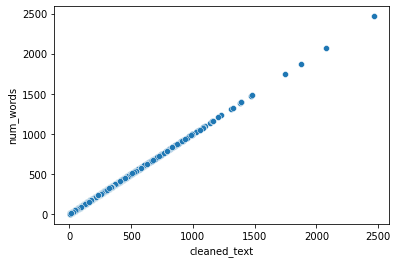

In [ ]:
sns.scatterplot(x = df.cleaned_text.apply(str).str.split().apply(len),y=df.num_words)

# Code from original corpora extractions

## Save extract text from edf

In [ ]:
grade = 4
grade_dir = root_dir + data_dir + "G"+str(grade)
module = 1
module_dir = grade_dir + "/Module " + str(module)+"/"

In [ ]:
pdf_name = "math-g"+str(grade)+"-m"+str(module)+"-full-module.pdf"
pdf_dr = module_dir + pdf_name

## Get standards and topics for grade levels

In [ ]:
## Create standards from for grades 1 to 6 into a data frame
sdf = pd.DataFrame(columns = ['Subject', 'Grade', 'Domain', 'Cluster Statement', 'Standard Code',
       'Common Core Standard'])
for grade in range(1,7):
  sdf = pd.concat([sdf,pd.read_excel(root_dir + "data/" + "math-ccss-k-12.xlsx", sheet_name=f"Grade {grade}")])
sdf.columns = [x.replace(" ","_").lower() for x in sdf.columns]

sdf

,subject,grade,domain,cluster_statement,standard_code,common_core_standard
0,Mathematics,Grade 1,Mathematical Practices,The Standards for Mathematical Practice descri...,1.MP.1,Make sense of problems and persevere in solvin...
1,Mathematics,Grade 1,Mathematical Practices,The Standards for Mathematical Practice descri...,1.MP.2,Reason abstractly and quantitatively.
2,Mathematics,Grade 1,Mathematical Practices,The Standards for Mathematical Practice descri...,1.MP.3,Construct viable arguments and critique the re...
3,Mathematics,Grade 1,Mathematical Practices,The Standards for Mathematical Practice descri...,1.MP.4,Model with mathematics.
4,Mathematics,Grade 1,Mathematical Practices,The Standards for Mathematical Practice descri...,1.MP.5,Use appropriate tools strategically.
...,...,...,...,...,...,...
50,Mathematics,Grade 6,Statistics and Probability,Summarize and describe distributions.,6.SP.5,Summarize numerical data sets in relation to t...
51,Mathematics,Grade 6,Statistics and Probability,Summarize and describe distributions.,6.SP.5 a.,Reporting the number of observations.
52,Mathematics,Grade 6,Statistics and Probability,Summarize and describe distributions.,6.SP.5 b.,Describing the nature of the attribute under i...
53,Mathematics,Grade 6,Statistics and Probability,Summarize and describe distributions.,6.SP.5 c.,Giving quantitative measures of center (median...


### Using docx

In [ ]:
!pip install python-docx
import docx

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.6/5.6 MB 37.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for python-docx: filename=python_docx-0.8.11-py3-none-any.whl size=184505 sha256=e33aef58dd8f30519b69b982dfcc2be5a7bf23b52225956d0597dc396d07b3bb
  Stored in directory: /root/.cache/pip/wheels/32/b8/b2/c4c2b95765e615fe139b0b17b5ea7c0e1b6519b0a9ec8fb34d
Successfully built python-docx


In [ ]:
# open the .docx file
doc = "/content/drive/MyDrive/transcript_analysis/data/engageNY/G4/Module 1/Math G4-M1 Lessons/Math-G4-M1-Topic-A-Lessons-1-4/math-g4-m1-topic-a-lesson-1.docx"
document = docx.Document(doc)

In [ ]:
# Extract the text from the document
import numpy as np
all_text = []
for para in document.paragraphs:
    all_text.append(para.text.split('\t'))

In [ ]:
all_text

[['Lesson 1'],
 ['Objective:  Interpret a multiplication equation as a comparison.'],
 [' '],
 ['Suggested Lesson Structure'],
 ['\uf06e\uf020Fluency Practice', '(13 minutes) '],
 ['\uf06e\uf020Application Problem', '(5 minutes) '],
 ['\uf06e\uf020Concept Development', '(35 minutes) '],
 ['\uf06e\uf020Student Debrief', '(7 minutes) '],
 ['', 'Total Time', '(60 minutes)'],
 ['Fluency Practice  (13 minutes)'],
 ['Sprint:  Multiply and Divide by 10  4.NBT.1', '(10 minutes)'],
 ['Place Value  4.NBT.2', '', '', '', '(3 minutes) '],
 ['Sprint:  Multiply and Divide by 10  (10 minutes)'],
 ['Materials:', '(S) Multiply and Divide by 10 Sprint'],
 ['Note:  Reviewing this fluency activity acclimates students to the Sprint routine, a vital component of the fluency program.'],
 ['Place Value  (3 minutes)'],
 ['Materials:',
  '(S) Personal white board, unlabeled thousands place value chart (Template)'],
 ['Note:  Reviewing and practicing place value skills in isolation prepares students for success 

## Function to extract the text (takes a dictionary of info we get from file extensions)

# Extract all the text!




In [ ]:
## For the entire dataset
cols_for_df = ['grade','module','topic','lesson','objective',
               'lesson_part','standard','text_type','text',
               'subject','path','material',]
lesson_df = pd.DataFrame(columns = cols_for_df)


def extract_lesson_text(fileinfo):
  '''This function takes in a dictionary containing the file information
  created from parsing glob (see below). From this, it parses .docx
  documents by file path, extracts relevant pieces, and stores them in a
  dataframe.
  The files are from the publicly available engageNY curricula found here:
  https://nysed.sharepoint.com/sites/P12EngageNY-Math-EXTA/Shared%20Documents/Forms/AllItems.aspx?ga=1&id=%2Fsites%2FP12EngageNY%2DMath%2DEXTA%2FShared%20Documents%2FMathematics&viewid=74a2b97e%2D3088%2D44b7%2Dab73%2D420870c488b4


      Inputs: dictionary
      Returns: DataFrame w extracted text info
  '''
  grade = fileinfo['grade']
  module = fileinfo['module']
  topic = fileinfo['topic']
  lesson = fileinfo['lesson']
  path = fileinfo['path']
  material = fileinfo['material']
  subject = fileinfo['subject']
  document = docx.Document(path)
  all_text = []
  for para in document.paragraphs:
      all_text.append(para.text.split('\t'))

  lesson_df = pd.DataFrame(columns = cols_for_df)
  new_df = pd.DataFrame(columns = cols_for_df)
  prev_df = pd.DataFrame(columns = cols_for_df)
  curr_obj,prev_objective,curr_lesson_part,prev_lesson_part,curr_std,prev_std = ['None'] *6

  curr_lesson_tags = {}
  ts_convo = []
  other_txt = []
  prev_ts_convo = []
  prev_other = []
  prev_text = []
  prev_type, curr_type = ["overview"]*2
  curr_text = []
  for txt_list in all_text:
    if '' in txt_list:
      txt_list.remove('')

    if (txt_list == ['']) or (txt_list==[]) or not txt_list:
      pass

    elif "Objective:" in txt_list[0]:
      curr_obj = txt_list[0].split("  ")[-1].strip()

    elif ' minutes)' in txt_list[-1] and len(txt_list)>1:
      if txt_list[0].split("  ")[-1].strip() in list(sdf.standard_code):
        tmp = [x.strip() for x in txt_list[0].split("  ")]
        standards = tmp[-1]
        lesson_parts = " ".join(tmp[:-1])
        curr_lesson_tags[lesson_parts] = standards

    elif ' minutes)' in txt_list[0]:

      curr_lesson_part = txt_list[0].split("  ")[0].strip()
      if curr_lesson_part in curr_lesson_tags.keys():
        if curr_lesson_tags[curr_lesson_part] == 'None':
          curr_lesson_tags[curr_lesson_part] = prev_std
        curr_std = curr_lesson_tags[curr_lesson_part]
      else:
        curr_lesson_tags[curr_lesson_part] = curr_std

    else:
      if 'T:' in txt_list or 'S:' in txt_list or 'T: ' in txt_list or 'S: ' in txt_list:
        curr_type = 'ts_dialogue'
      elif any([re.search(r"^\s{0,2}Problem \d{1,2}",x) for x in txt_list]) or curr_lesson_part in ['Exit Ticket'] or ((prev_type == 'problems') and ((1== len(prev_text)) or (any(['?' in x for x in txt_list])))):
        curr_type = 'problems'
      elif any(['?' in x for x in txt_list]) or any(['Debrief' in x for x in txt_list]):
        curr_type = 'ts_dialogue'
      elif ":" in txt_list[0].split("  ")[0]:
        curr_type = 'instructional_guidance'
      else:
        curr_type = prev_type
      if prev_type == curr_type and curr_lesson_part == prev_lesson_part:
        curr_text.append(txt_list)
      else:
        curr_text = [copy.deepcopy(txt_list)]

      if (curr_lesson_part != 'None') and txt_list != ['']:
        new_df = pd.DataFrame({'grade':grade,'module':module,
                              'topic':topic,'lesson':lesson,
                              'objective':curr_obj,
                              'lesson_part':curr_lesson_part,
                              'standard':curr_std,
                              'text_type':curr_type,
                              'text':[copy.deepcopy(curr_text)],
                               'subject':subject,
                               'path':path,
                               "material":material,
                               })
        if prev_type != curr_type:
          lesson_df = pd.concat([lesson_df,prev_df])

    prev_objective = curr_obj
    prev_std = curr_std
    prev_lesson_part = curr_lesson_part
    prev_ts_convo = copy.deepcopy(ts_convo)
    prev_text = copy.deepcopy(curr_text)
    prev_df = copy.deepcopy(new_df)
    prev_type = curr_type

  lesson_df = pd.concat([lesson_df,prev_df])
  return lesson_df


files = {}
for name in glob.iglob(root_dir + data_dir + "**/*lesson*.docx", recursive=True):
  doc = name.split("/")[-1][:-5]
  filename = doc.split("-")
  if len(filename) >= 7 and filename[0][0] not in ["~","$"]:
    subj, grade, module, top, topic,ls,lesson = filename[:7]
    material = filename[-1]
    files[doc] = {"path":name,
                  "subject":subj,
                  "grade":grade[-1],
                  "module":module,
                  "topic":topic,
                  "lesson":lesson,
                  "material":material,
                  }

for d, info in files.items():
  lesson_df = pd.concat([lesson_df,extract_lesson_text(info)])


lesson_df.to_csv(root_dir + data_dir + "full_lesson_text_extra_grades.csv")
lesson_df


,grade,module,topic,lesson,objective,lesson_part,standard,text_type,text,subject,path,material
0,4,m1,a,1,Interpret a multiplication equation as a compa...,Place Value,4.NBT.2,instructional_guidance,"[[Materials:, (S) Multiply and Divide by 10 Sp...",math,/content/drive/My Drive/transcript_analysis/da...,1
0,4,m1,a,1,Interpret a multiplication equation as a compa...,Place Value,4.NBT.2,ts_dialogue,"[[T:, (Project place value chart to the thousa...",math,/content/drive/My Drive/transcript_analysis/da...,1
0,4,m1,a,1,Interpret a multiplication equation as a compa...,Place Value,4.NBT.2,instructional_guidance,[[Continue for the following possible sequence...,math,/content/drive/My Drive/transcript_analysis/da...,1
0,4,m1,a,1,Interpret a multiplication equation as a compa...,Application Problem,4.NBT.2,ts_dialogue,[[Ben has a rectangular area 9 meters long and...,math,/content/drive/My Drive/transcript_analysis/da...,1
0,4,m1,a,1,Interpret a multiplication equation as a compa...,Concept Development,4.NBT.2,instructional_guidance,"[[Note: As the first lesson of the year, this...",math,/content/drive/My Drive/transcript_analysis/da...,1
...,...,...,...,...,...,...,...,...,...,...,...,...
0,1,m4,a,1,Compare the efficiency of counting by ones and...,Concept Development,1.NBT.5,instructional_guidance,"[[Materials:, (T) 40 linking cubes (2 colors, ...",math,/content/drive/My Drive/transcript_analysis/da...,1
0,1,m4,a,1,Compare the efficiency of counting by ones and...,Concept Development,1.NBT.5,ts_dialogue,"[[T:, You will make your own math toolkit toda...",math,/content/drive/My Drive/transcript_analysis/da...,1
0,1,m4,a,1,Compare the efficiency of counting by ones and...,Concept Development,1.NBT.5,instructional_guidance,"[[T/S:, (Count by ones.)]]",math,/content/drive/My Drive/transcript_analysis/da...,1
0,1,m4,a,1,Compare the efficiency of counting by ones and...,Student Debrief,1.NBT.5,ts_dialogue,"[[T:, Now, let’s count them by tens by making ...",math,/content/drive/My Drive/transcript_analysis/da...,1


In [ ]:
info

{'path': '/content/drive/My Drive/transcript_analysis/data/engageNY/G1/Module 4/Math G1-M4 Lessons/math-g1-m4-topic-a-lessons-1-6/math-g1-m4-topic-a-lesson-3.docx',
 'subject': 'math',
 'grade': '1',
 'module': 'm4',
 'topic': 'a',
 'lesson': '3',
 'material': '3'}

In [ ]:
lesson_df.grade.value_counts()

4    2190
5    1963
3    1681
2    1656
1    1303
6    1117
Name: grade, dtype: int64

In [ ]:
lesson_df.text.iloc[-2]

[['The Student Debrief is intended to invite reflection and active processing of the total lesson experience.'],
 ['Invite students to review their solutions for the Problem Set.  They should check work by comparing answers with a partner before going over answers as a class.  Look for misconceptions or misunderstandings that can be addressed in the Debrief.  Guide students in a conversation to debrief the Problem Set and process the lesson.  '],
 ['Any combination of the questions below may be used to lead the discussion.'],
 ['How are the problems similar?  How are they different?'],
 ['How many strategies can you use to solve the problems?'],
 ['How was your solution the same and different from those that were demonstrated?'],
 ['Did you see other solutions that surprised you or made you see the problems differently?'],
 ['How many different story problems can you create for Problems 5 and 6?'],
 ['\n']]

In [ ]:
df = pd.read_csv(root_dir + data_dir + "full_lesson_text_extra_grades.csv")
df.text = df.text.apply(eval)
df

,Unnamed: 0,grade,module,topic,lesson,objective,lesson_part,standard,text_type,text,subject,path,material
0,0,4,m1,a,1,Interpret a multiplication equation as a compa...,Place Value,4.NBT.2,instructional_guidance,"[[Materials:, (S) Multiply and Divide by 10 Sp...",math,/content/drive/My Drive/transcript_analysis/da...,1
1,0,4,m1,a,1,Interpret a multiplication equation as a compa...,Place Value,4.NBT.2,ts_dialogue,"[[T:, (Project place value chart to the thousa...",math,/content/drive/My Drive/transcript_analysis/da...,1
2,0,4,m1,a,1,Interpret a multiplication equation as a compa...,Place Value,4.NBT.2,instructional_guidance,[[Continue for the following possible sequence...,math,/content/drive/My Drive/transcript_analysis/da...,1
3,0,4,m1,a,1,Interpret a multiplication equation as a compa...,Application Problem,4.NBT.2,ts_dialogue,[[Ben has a rectangular area 9 meters long and...,math,/content/drive/My Drive/transcript_analysis/da...,1
4,0,4,m1,a,1,Interpret a multiplication equation as a compa...,Concept Development,4.NBT.2,instructional_guidance,"[[Note: As the first lesson of the year, this...",math,/content/drive/My Drive/transcript_analysis/da...,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...
9905,0,1,m4,a,1,Compare the efficiency of counting by ones and...,Concept Development,1.NBT.5,instructional_guidance,"[[Materials:, (T) 40 linking cubes (2 colors, ...",math,/content/drive/My Drive/transcript_analysis/da...,1
9906,0,1,m4,a,1,Compare the efficiency of counting by ones and...,Concept Development,1.NBT.5,ts_dialogue,"[[T:, You will make your own math toolkit toda...",math,/content/drive/My Drive/transcript_analysis/da...,1
9907,0,1,m4,a,1,Compare the efficiency of counting by ones and...,Concept Development,1.NBT.5,instructional_guidance,"[[T/S:, (Count by ones.)]]",math,/content/drive/My Drive/transcript_analysis/da...,1
9908,0,1,m4,a,1,Compare the efficiency of counting by ones and...,Student Debrief,1.NBT.5,ts_dialogue,"[[T:, Now, let’s count them by tens by making ...",math,/content/drive/My Drive/transcript_analysis/da...,1


In [ ]:
sdf.to_csv(root_dir + "data/ccss_standards_text.csv")

In [ ]:
df.head()

,Unnamed: 0,grade,module,topic,lesson,objective,lesson_part,standard,text_type,text,subject,path,material
0,0,4,m1,a,1,Interpret a multiplication equation as a compa...,Place Value,4.NBT.2,instructional_guidance,"[['Materials:', '(S) Multiply and Divide by 10...",math,/content/drive/My Drive/transcript_analysis/da...,1
1,0,4,m1,a,1,Interpret a multiplication equation as a compa...,Place Value,4.NBT.2,ts_dialogue,"[['T:', '(Project place value chart to the tho...",math,/content/drive/My Drive/transcript_analysis/da...,1
2,0,4,m1,a,1,Interpret a multiplication equation as a compa...,Place Value,4.NBT.2,instructional_guidance,[['Continue for the following possible sequenc...,math,/content/drive/My Drive/transcript_analysis/da...,1
3,0,4,m1,a,1,Interpret a multiplication equation as a compa...,Application Problem,4.NBT.2,ts_dialogue,[['Ben has a rectangular area 9 meters long an...,math,/content/drive/My Drive/transcript_analysis/da...,1
4,0,4,m1,a,1,Interpret a multiplication equation as a compa...,Concept Development,4.NBT.2,instructional_guidance,"[['Note: As the first lesson of the year, thi...",math,/content/drive/My Drive/transcript_analysis/da...,1


## Save teacher / student conversations as dictionary

In [ ]:
ts_convo_dict = {'T':[],"S":[]}
for txt_list in all_text:
  if 'T:' in txt_list:
    ts_convo_dict['T'].append(txt_list[1])
  if 'S:' in txt_list:
    ts_convo_dict['S'].append(txt_list[1])

for key, value in ts_convo_dict.items():
  print(key, value)

T ['(Project place value chart to the thousands.)  Show 4 ones as place value disks.  Write the number below it.', 'Show 4 tens disks, and write the number below it.', 'Say the number in unit form.', 'Say the number in standard form.', '(Have a place value chart ready.  Draw or place 1 unit into the ones place.)', 'How many units do I have?', 'What is the name of this unit?', 'Count the ones with me.  (Draw ones as they do so.)', '10 ones.  What larger unit can I make?', 'I change 10 ones for 1 ten.  We say, “1 ten is 10 times as much as 1 one.”  Tell your partner what we say and what that means.  Use the model to help you.', 'Discuss the patterns you have noticed with your partner.', 'Let’s review, in words, the multiplication pattern that matches our models and 10 times as many.', 'Draw place value disks as dots.  Because you are using dots, label your columns with the unit value. ', 'Represent 2 ones.  Solve to find 10 times as many as 2 ones.  Work together.', '10 times as many as 

## Save teacher / student conversations as list

In [ ]:
ts_convo = []
for txt_list in all_text:
  if 'T:' in txt_list or 'S:' in txt_list:
    ts_convo.append(txt_list)

ts_convo

[['T:',
  '(Project place value chart to the thousands.)  Show 4 ones as place value disks.  Write the number below it.'],
 ['S:', '(Draw 4 ones disks and write 4 below it.) '],
 ['T:', 'Show 4 tens disks, and write the number below it.'],
 ['S:', '(Draw 4 tens disks and write 4 at the bottom of the tens column.)'],
 ['T:', 'Say the number in unit form.'],
 ['S:', '4 tens 4 ones.'],
 ['T:', 'Say the number in standard form.'],
 ['S:', '44.'],
 ['T:',
  '(Have a place value chart ready.  Draw or place 1 unit into the ones place.)'],
 ['T:', 'How many units do I have?'],
 ['S:', '1.'],
 ['T:', 'What is the name of this unit?'],
 ['S:', 'A one.'],
 ['T:', 'Count the ones with me.  (Draw ones as they do so.)'],
 ['S:', '1 one, 2 ones, 3 ones, 4 ones, 5 ones...,10 ones.'],
 ['T:', '10 ones.  What larger unit can I make?'],
 ['S:', '1 ten. '],
 ['T:',
  'I change 10 ones for 1 ten.  We say, “1 ten is 10 times as much as 1 one.”  Tell your partner what we say and what that means.  Use the mod

## Using PyPDF2

In [ ]:
!pip install PyPDF2
import PyPDF2

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 232.6/232.6 KB 6.0 MB/s eta 0:00:00


In [ ]:
reader = PyPDF2.PdfReader(pdf_dr)
print(len(reader.pages))

In [ ]:
def get_text_from_pdf(pdf):
    text = ''
    with open(pdf, 'rb') as file:
      # Create a PDF reader object
      reader = PyPDF2.PdfReader(file)
      # Get the number of pages
      num_pages = len(reader.pages)
      # iterate over each page
      for i in range(num_pages):
          page = reader.pages[i] # get i-th page
          text += page.extract_text() # extract the text
    return text

In [ ]:
root_dir = "/content/drive/My Drive/transcript_analysis/"
data_dir = "data/engageNY/"
def get_pdf_by_grade(grade, module):
    grade_dir = root_dir + data_dir + "G"+str(grade)
    module_dir = grade_dir + "/Module " + str(module)+"/"
    pdf_dir = module_dir + "math-g"+str(grade)+"-m"+str(module)+"-full-module.pdf"
    text = get_text_from_pdf(pdf_dir)
    text_dir = root_dir + data_dir + "text_file/math-g"+str(grade)+"-m"+str(module)+"-full-module.txt"
    with open(text_dir,"x") as f:
      f.write(text)
      f.close()


Get text from Grade 4 (7 modules)

In [ ]:
for module in range(1,8):
    get_pdf_by_grade(4,module)

Get text from Grade 5 (6 modules)

In [ ]:
for module in range(1,7):
    get_pdf_by_grade(5,module)

Get text from Grade 3 (7 modules)

In [ ]:
for module in range(1,8):
    get_pdf_by_grade(3,module)

Get text from Grade 6 (6 modules)

In [ ]:
for module in range(1,7):
    get_pdf_by_grade(6,module)

## Get teacher/student conversation from text file

In [ ]:
gr = 4
mo = 1
text_f = "text_file/math-g"+str(gr)+"-m"+str(mo)+"-full-module.txt"
text_dir = root_dir + data_dir + text_f

In [ ]:
with open(text_dir) as f:
  text = f.read()

In [ ]:
text

" \n \n \n \n \n \n \n \nTable of Contents  \nGRADE 4  • MODULE 1  \nPlace Value, Rounding, and Algorithms for Addition and \nSubtraction  \n \nModule Overview  ..........................................................................................................  2 \n \nTopic A:  Place Value  of Multi -Digit Whole Numbers ...................................................  20 \n \nTopic B:   Comparing  Multi -Digit Whole Numbers  ........................................................  78 \n \nTopic C:  Round ing Multi -Digit Whole Numbers  ........................................................  107 \n \nMid-Module Assessment and Rubric  ........................................................................  153 \n \nTopic D:  Multi -Digit Whole Number  Addition  ...........................................................  160 \n \nTopic E:  Multi -Digit Whole Number  Subtraction  ......................................................  188 \n \nTopic F:  Addition and Subtrac

In [ ]:
text_wo_new_lines = text.replace("\n", "")

In [ ]:
import re
pat = re.compile("T:+[?.!]$")
teacher_results = pat.findall(text)

In [ ]:
pattern = r"T:.*\s{0,1}$"

In [ ]:
matches = re.findall(pattern, text_wo_new_lines, re.MULTILINE)

In [ ]:
matches

["T:  You will have 60 seconds to do as many problems as you can.   I do not expect you to finish all of them.   Just do as many as you can, your personal best.  (If some students are likely to finish before time is up, assign a number to count by  on the back.)  T:  Take your mark!  Get set!   THINK!    Students immediately turn papers over and work furiously to finish  as many problems as they can in 60 seconds.  Time precisely.  T:  Stop!  Circle the last problem you did.   I will read just the answers.  If you got it right, call out “Yes!”  If you made a mistake, circle it.  Ready?  T:  (Energetically, rapid -fire call th e first answer.)  S:  Yes!  T:  (Energetically, rapid -fire call the second answer.)  S:  Yes!  Repeat to the end of Sprint A  or until no student  has a correct  answer .  If need ed, read the count -by answers in the same way as Sprint answers.  Each number counted -by on the back is considered a  correct answer.  T:  Fantastic!   Now , write the number you got 

In [ ]:
teacher_results

[]

# Temporal Clustering

## Install packages

In [ ]:
!pip install tslearn
!pip install tsfresh

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 358.2/358.2 KB 5.2 MB/s eta 0:00:00
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.2/98.2 KB 3.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 136.2/136.2 KB 7.8 MB/s eta 0:00:00


In [ ]:
import numpy
import matplotlib.pyplot as plt
from tslearn.clustering import TimeSeriesKMeans
from tslearn.clustering import KShape
from tslearn.datasets import CachedDatasets
from tslearn.preprocessing import TimeSeriesScalerMeanVariance,TimeSeriesResampler

### Check methods against different dataset

Euclidean k-means
16.434 --> 9.437 --> 9.437 --> 
DBA k-means
Init 1


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  50 out of  50 | elapsed:    3.4s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 150 out of 150 | elapsed:    0.0s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 150 out of 150 | elapsed:    0.0s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 150 out of 150 | elapsed:    0.1s finished


0.637 --> 

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 150 out of 150 | elapsed:    0.0s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 150 out of 150 | elapsed:    0.1s finished


0.458 --> 0.458 --> 
Init 2


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  50 out of  50 | elapsed:    0.0s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 150 out of 150 | elapsed:    0.1s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 150 out of 150 | elapsed:    0.1s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 150 out of 150 | elapsed:    0.1s finished


0.826 --> 

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 150 out of 150 | elapsed:    0.0s finished


0.525 --> 

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 150 out of 150 | elapsed:    0.1s finished


0.477 --> 

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 150 out of 150 | elapsed:    0.0s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 150 out of 150 | elapsed:    0.0s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 150 out of 150 | elapsed:    0.0s finished


0.472 --> 0.472 --> 
Soft-DTW k-means
0.472 --> 0.144 --> 0.142 --> 0.143 --> 0.142 --> 0.143 --> 0.142 --> 0.143 --> 0.142 --> 0.142 --> 0.142 --> 0.142 --> 0.142 --> 0.142 --> 0.142 --> 0.142 --> 0.142 --> 0.142 --> 0.142 --> 0.142 --> 0.142 --> 


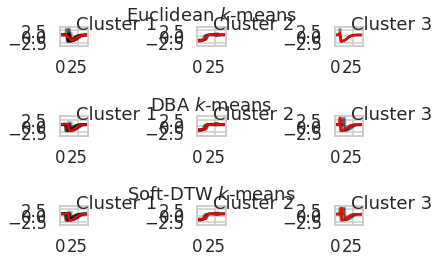

In [ ]:
seed = 0
numpy.random.seed(seed)
X_train, y_train, X_test, y_test = CachedDatasets().load_dataset("Trace")
X_train = X_train[y_train < 4]  # Keep first 3 classes
numpy.random.shuffle(X_train)
# Keep only 50 time series
X_train = TimeSeriesScalerMeanVariance().fit_transform(X_train[:50])
# Make time series shorter
X_train = TimeSeriesResampler(sz=40).fit_transform(X_train)
sz = X_train.shape[1]

# Euclidean k-means
print("Euclidean k-means")
km = TimeSeriesKMeans(n_clusters=3, verbose=True, random_state=seed)
y_pred = km.fit_predict(X_train)

plt.figure()
for yi in range(3):
    plt.subplot(3, 3, yi + 1)
    for xx in X_train[y_pred == yi]:
        plt.plot(xx.ravel(), "k-", alpha=.2)
    plt.plot(km.cluster_centers_[yi].ravel(), "r-")
    plt.xlim(0, sz)
    plt.ylim(-4, 4)
    plt.text(0.55, 0.85,'Cluster %d' % (yi + 1),
             transform=plt.gca().transAxes)
    if yi == 1:
        plt.title("Euclidean $k$-means")

# DBA-k-means
print("DBA k-means")
dba_km = TimeSeriesKMeans(n_clusters=3,
                          n_init=2,
                          metric="dtw",
                          verbose=True,
                          max_iter_barycenter=10,
                          random_state=seed)
y_pred = dba_km.fit_predict(X_train)

for yi in range(3):
    plt.subplot(3, 3, 4 + yi)
    for xx in X_train[y_pred == yi]:
        plt.plot(xx.ravel(), "k-", alpha=.2)
    plt.plot(dba_km.cluster_centers_[yi].ravel(), "r-")
    plt.xlim(0, sz)
    plt.ylim(-4, 4)
    plt.text(0.55, 0.85,'Cluster %d' % (yi + 1),
             transform=plt.gca().transAxes)
    if yi == 1:
        plt.title("DBA $k$-means")

# Soft-DTW-k-means
print("Soft-DTW k-means")
sdtw_km = TimeSeriesKMeans(n_clusters=3,
                           metric="softdtw",
                           metric_params={"gamma": .01},
                           verbose=True,
                           random_state=seed)
y_pred = sdtw_km.fit_predict(X_train)

for yi in range(3):
    plt.subplot(3, 3, 7 + yi)
    for xx in X_train[y_pred == yi]:
        plt.plot(xx.ravel(), "k-", alpha=.2)
    plt.plot(sdtw_km.cluster_centers_[yi].ravel(), "r-")
    plt.xlim(0, sz)
    plt.ylim(-4, 4)
    plt.text(0.55, 0.85,'Cluster %d' % (yi + 1),
             transform=plt.gca().transAxes)
    if yi == 1:
        plt.title("Soft-DTW $k$-means")

plt.tight_layout()
plt.show()

## Fit T-cluster to data

In [ ]:
df[df.timestamp.isnull()].shape

(0, 125)

In [ ]:
for col in df.columns:
  print(col)
  print(len(df[df[col].isnull()]))

speaker
10
text
0
year
0
OBSID
0
video_id
0
cleaned_text
50
num_words
0
turn_idx
0
comb_idx
0
t
0
cum_words
0
t_words
0
s_words
0
t_cum_words
0
s_cum_words
0
tt_cum_ratio
0
st_cum_ratio
0
talk_cum_pct
0
t_words_rolling
9948
s_words_rolling
9948
t_25_rolling
39792
s_25_rolling
39792
t_40_rolling
64631
s_40_rolling
64631
all_40_rolling
64631
ts_cum_ratio
0
NCTETID
0
id_year
0
scoreSTA
33388
scoreALT
36375
scoreSESTA
33388
scoreSEALT
36375
avgscoreSTA
18463
avgscoreALT
21174
avgscoreSESTA
18463
avgscoreSEALT
21174
has_timestamp
0
timestamp
0
has_work_comment
0
ind_practice
0
group_work
0
adj_num_words
0
adj_cum_words
0
w_words
0
w_cum_words
0
w_words_rolling
9948
w_25_rolling
39792
w_40_rolling
64631
model_grade
293580
model_domain
293580
level_0_x
0
level_0_y
4818
CLPC
48738
CLNC
48544
CLTS
49887
CLRSP
49592
CLBM
49098
CLPRDT
48912
CLILF
49228
CLCU
49561
CLAPS
48818
CLQF
49226
CLINSTD
48896
CLSTENG
48531
SEGMENT
24093
FORMAT_ACTIVE
137017
FORMAT_BOTH
137017
FORMAT_SMALLGRP
137017
DIRINST

### Scaling observation data

In [ ]:
df.loc[:,'CLPC':'MMSM'] = scaler.fit_transform(df.loc[:,'CLPC':'MMSM'])

In [ ]:
# group = df[df.OBSID == 450]
tword_ts = []
asdf = []
obs = []
unified_sample_size = 100
vars_included = ['t_words','s_words','FORMAT_ACTIVE','FORMAT_SMALLGRP'] #,'WCDISS','DIRINST']
vars_included = ['t_words','s_words','t_math','s_math','w_words','scoreSTA']
# vars_included = ['t_words']
num_vars = len(vars_included)

scaler = MinMaxScaler()
window = 40
min_periods = 5

# # ttdf =
# tdf['tw_scaled'] = scaler.fit_transform(tdf[['t_words']])

# grouped = tdf.groupby(['cluster', 'time']).mean().reset_index()

# # grouped['tw_scaled'] = scaler.fit_transform(grouped['t_words'])

# # iterate through each cluster and create a plot
# for cluster in grouped['cluster'].unique():
#     # filter the grouped dataframe by the cluster

#     for i, (n, g )in enumerate(tdf.reset_index().groupby('index')):
#       # g['t_words'] = scaler.fit_transform(g[['t_words']])+0.3
#       g = g[((g['index']==n)) & (g['cluster'] == cluster)].rolling(window=window,min_periods = 10, closed = 'both', center=True).mean()

for ob, group in tqdm(df.groupby(by= 'OBSID'), total =len(df.groupby(by= 'OBSID'))):
  # if len(group) >= 100:
  group = group.reset_index()
  obs.append(ob)
  if any(group.scoreSTA.isnull()):
    group.scoreSTA = 0
  tmp = group.scoreSTA
  group.loc[:,vars_included] = group.loc[:,vars_included].rolling(window=window,min_periods = min_periods, closed = 'both', center=True).mean(dropna=True)
  if 'scoreSTA' in vars_included: group['scoreSTA'] = tmp
  tword_ts.append(group.loc[np.linspace(group.index.min(),group.index.max(),unified_sample_size).astype(int)][vars_included])

tword_ts = np.hstack(tword_ts).reshape(-1,unified_sample_size,num_vars)
tword_ts.shape

  0%|          | 0/1658 [00:00<?, ?it/s]

(1658, 100, 6)

In [ ]:
df[df.model_grade.isnull()]

,speaker,text,year,OBSID,video_id,cleaned_text,num_words,turn_idx,comb_idx,t,...,TASKDEVMAT,ERRANN,WORLD,math_words,log_math_words,pct_math_words,s_pct_math_words,t_pct_math_words,s_math,t_math
1,student,Yes.,2,2119,706,yes,1,1,2119_1,0,...,NaN,NaN,NaN,0,0.0,0.0,0.0,NaN,0,0
3,multiple students,Yes.,2,2119,706,yes,1,3,2119_3,0,...,NaN,NaN,NaN,0,0.0,0.0,0.0,NaN,0,0
5,student,Can we find new ways to check it or [inaudible]?,2,2119,706,can we find new ways to check it or inaudible,10,5,2119_5,0,...,NaN,NaN,NaN,0,0.0,0.0,0.0,NaN,0,0
7,student,Can you [find] the gallon?,2,2119,706,can you find the gallon,5,7,2119_7,0,...,NaN,NaN,NaN,0,0.0,0.0,0.0,NaN,0,0
8,student,I don't know how to.,2,2119,706,i don t know how to,6,8,2119_8,0,...,NaN,NaN,NaN,0,0.0,0.0,0.0,NaN,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
579969,student,I told you to do what the teacher told us to do.,1,315,445,i told you to do what the teacher told us to do,12,510,315_510,0,...,NaN,NaN,NaN,0,0.0,0.0,0.0,NaN,0,0
579971,multiple students,Yes teacher.,1,315,445,yes teacher,2,512,315_512,0,...,NaN,NaN,NaN,0,0.0,0.0,0.0,NaN,0,0
579973,student,Which one was three points again?,1,315,445,which one was three points again,6,514,315_514,0,...,NaN,NaN,NaN,0,0.0,0.0,0.0,NaN,0,0
579975,student,I’ll go first.,1,315,445,i ll go first,4,516,315_516,0,...,NaN,NaN,NaN,0,0.0,0.0,0.0,NaN,0,0


## TSKMeans

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 1658 out of 1658 | elapsed:    0.7s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    1.0s
[Parallel(n_jobs=

10594.039 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.6s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    3.1s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.6s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    4.2s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

8104.146 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7984.580 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.2s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7932.665 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7910.236 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7896.630 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7890.026 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7886.157 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.2s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7881.961 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.8s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7879.863 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.5s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7879.677 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7878.863 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.2s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7876.264 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.6s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.0s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.5s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7866.998 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.6s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    3.0s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.9s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7864.787 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.6s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    3.1s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.5s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    4.0s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7855.022 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.0s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.6s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7850.045 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7846.400 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.2s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7843.774 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7838.899 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7834.555 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.7s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.1s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.6s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7831.677 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.6s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.1s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.7s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7829.825 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7828.118 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.7s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.1s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.5s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7827.160 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.1s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.6s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7826.642 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7825.873 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.6s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    3.1s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.5s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    4.0s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7825.557 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.2s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7825.498 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.5s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.6s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.0s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.5s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7825.498 --> 


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

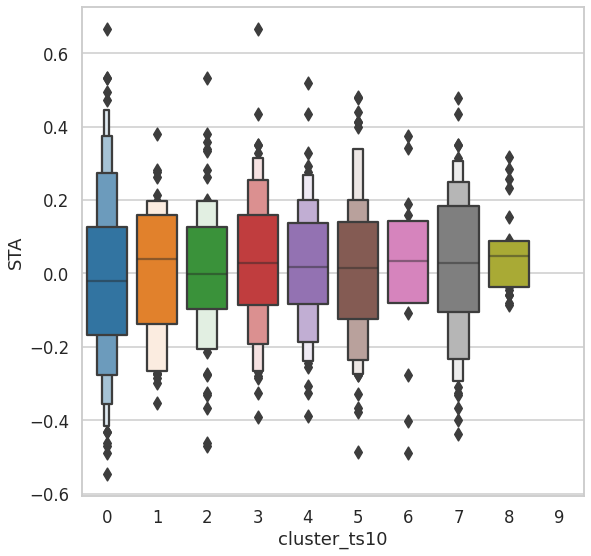

0    490
4    210
7    202
5    195
3    190
2    156
1     95
8     64
6     38
9     18
Name: cluster_ts10, dtype: int64


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1658 out of 1658 | elapsed:    0.6s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=

10595.840 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.6s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    3.0s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.8s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

8251.157 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

8088.108 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.0s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.6s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

8039.122 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.0s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.6s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

8004.631 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.6s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.1s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.7s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7982.156 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.7s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.1s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.6s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7946.901 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.6s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.0s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.5s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7891.625 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.2s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7839.531 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.2s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7802.002 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7792.755 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7787.244 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.2s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.7s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7780.472 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.5s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.9s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7778.111 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7776.281 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7775.230 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    4.0s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7774.974 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7774.974 --> 


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.6s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    3.0s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.9s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

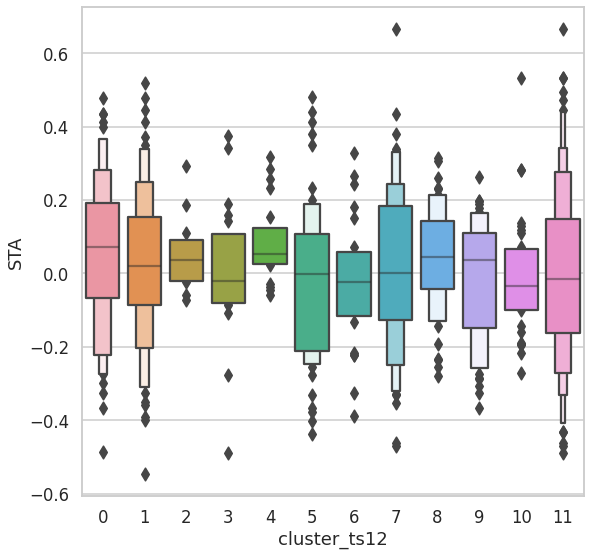

11    471
1     200
7     161
5     130
0     121
8     120
9     116
10    102
6      71
2      58
4      57
3      51
Name: cluster_ts12, dtype: int64


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 1658 out of 1658 | elapsed:    0.7s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    1.1s
[Parallel(n_jobs=

10270.160 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.6s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    3.1s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.6s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    4.0s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7989.699 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.2s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7820.535 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.5s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.9s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7736.940 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7686.220 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7651.255 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.5s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7632.141 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.7s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.2s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.8s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7624.703 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.6s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    3.1s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.6s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    4.2s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7617.608 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.9s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7611.731 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.0s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.5s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7609.616 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7607.671 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7605.858 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7603.685 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.7s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7602.469 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.6s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    3.1s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.7s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    4.2s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7601.617 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.6s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    3.0s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.6s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    4.1s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7600.100 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.9s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7598.574 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7598.289 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7598.032 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7597.730 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.6s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    3.2s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.6s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    4.1s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7597.543 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.0s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.5s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7597.389 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7597.240 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7597.240 --> 


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.6s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    3.1s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.7s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    4.2s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

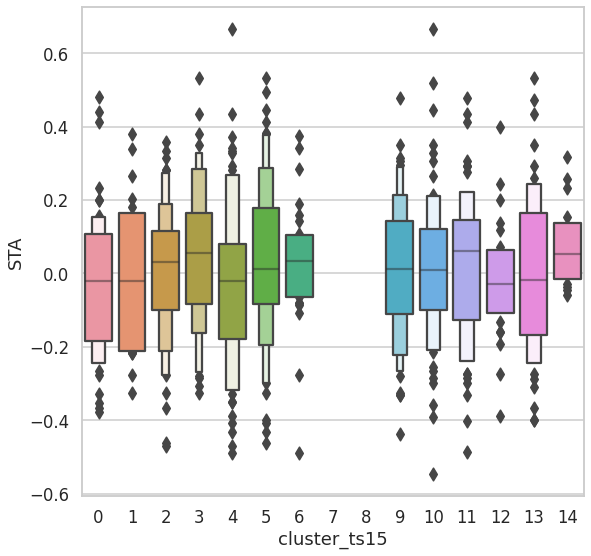

5     264
2     168
9     167
4     166
10    162
3     150
0     118
13    109
11     87
6      63
12     62
1      61
8      37
14     28
7      16
Name: cluster_ts15, dtype: int64


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1658 out of 1658 | elapsed:    0.6s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=

9901.913 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7593.298 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.7s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.8s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7452.071 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7409.289 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.2s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7383.361 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.6s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    3.1s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.7s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    4.3s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7365.562 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7351.060 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7342.681 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7334.717 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7328.277 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.8s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7321.611 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.6s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    3.2s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.7s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    4.2s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7317.299 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7311.798 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7307.491 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7304.974 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7302.577 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.0s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.6s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7299.578 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.6s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.2s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.7s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7297.802 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.5s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.5s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    4.0s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7295.366 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.5s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    4.0s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7293.743 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.7s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    3.2s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.7s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    4.3s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7291.879 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    3.0s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.6s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    4.1s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7290.303 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.5s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    4.0s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7289.894 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.6s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.1s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.7s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7288.559 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.5s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7287.959 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7286.792 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7285.147 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7284.209 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7282.805 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7280.724 --> 


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

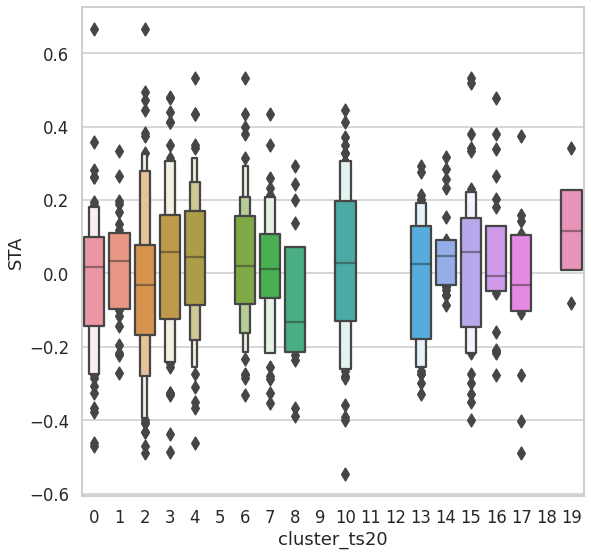

2     280
4     180
6     159
10    156
3     144
0     141
15    105
7      90
1      84
13     64
16     55
8      43
14     35
12     33
11     19
18     17
5      16
17     14
19     14
9       9
Name: cluster_ts20, dtype: int64


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1658 out of 1658 | elapsed:    0.5s finished
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=

9429.617 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7268.566 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.7s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    3.2s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.6s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    4.1s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7154.580 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.1s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.6s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7100.347 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7073.895 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.4s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7056.087 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7044.346 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.2s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7041.469 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7038.603 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.8s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.9s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7036.342 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.6s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    3.1s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.5s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    4.0s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7032.902 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7032.178 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7030.530 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.0s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.9s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7029.845 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    2.8s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.3s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7029.077 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.0s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.5s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7028.984 --> 

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.4s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    2.7s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.2s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    3.8s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

7028.984 --> 


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 446 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-1)]: Done 796 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 1246 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done 1796 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done 2446 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done 3196 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 4046 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-1)]: Done 4996 tasks      | elapsed:    2.1s
[Parallel(n_jobs=-1)]: Done 6046 tasks      | elapsed:    2.5s
[Parallel(n_jobs=-1)]: Done 7196 tasks      | elapsed:    3.0s
[Parallel(n_jobs=-1)]: Done 8446 tasks      | elapsed:    3.6s
[Parallel(n_jobs=-1)]: Done 9796 tasks      | elapsed:    4.1s
[Parallel(n_jobs=-1)]: Done 11246 tasks  

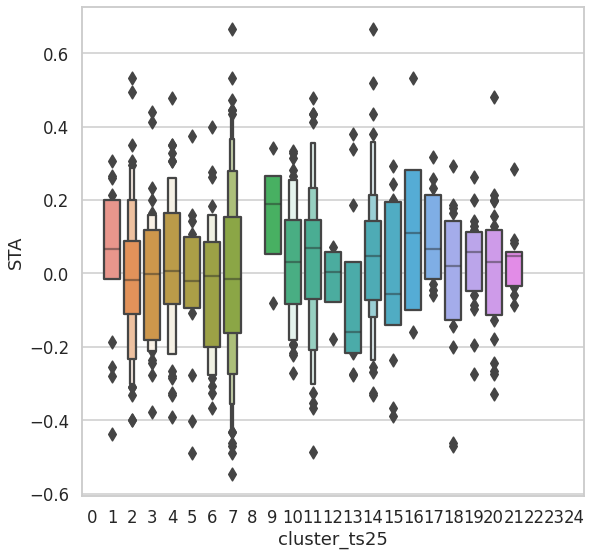

7     436
2     164
14    146
11    118
4     114
10     97
3      82
6      72
1      53
20     46
19     45
15     34
16     32
18     30
21     29
13     25
22     24
9      19
17     18
8      16
5      15
24     14
12     13
0       8
23      8
Name: cluster_ts25, dtype: int64


In [ ]:
for k in [10,12,15,20,25]:
  model = TimeSeriesKMeans(n_clusters=k, metric="dtw", max_iter=30, verbose = 1, n_jobs=-1)
  model.fit(tword_ts)
  y=model.predict(tword_ts)

  asdf[f'cluster_ts{k}'] = y
  fig = plt.figure(figsize=(9,9))
  sns.boxenplot(data=asdf, x=f'cluster_ts{k}',y='STA')
  plt.show()
  print(asdf[f'cluster_ts{k}'].value_counts())

# model = TimeSeriesKMeans(n_clusters=5, metric="dtw", max_iter=5, verbose = 1, n_jobs=-1)
# model.fit(tword_ts)
# y=model.predict(tword_ts)
asdf.to_pickle(DATA_FOLDER + "clusterfun.pkl")

In [ ]:
asdf.to_pickle(DATA_FOLDER + "clusterfun.pkl")

## KShape

0.718 --> 0.626 --> 0.596 --> 0.588 --> 0.583 --> 0.580 --> 0.578 --> 0.577 --> 0.576 --> 0.575 --> 0.575 --> 0.580 --> 


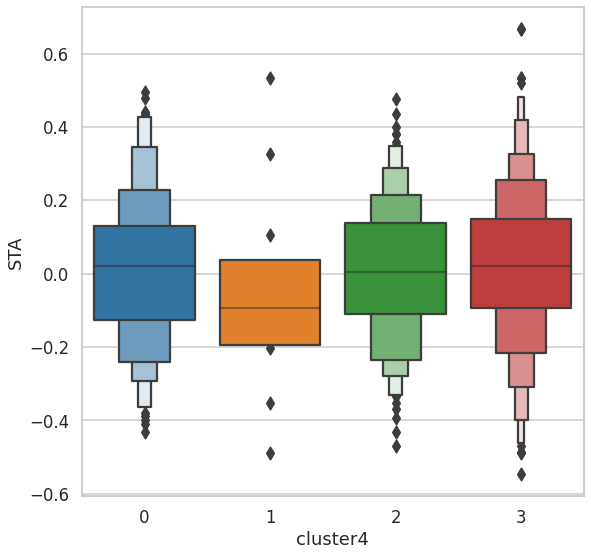

3    757
2    530
0    319
1     52
Name: cluster4, dtype: int64
0.707 --> 0.613 --> Resumed because of empty cluster
0.688 --> 0.588 --> 0.569 --> 0.566 --> 0.565 --> 0.566 --> 


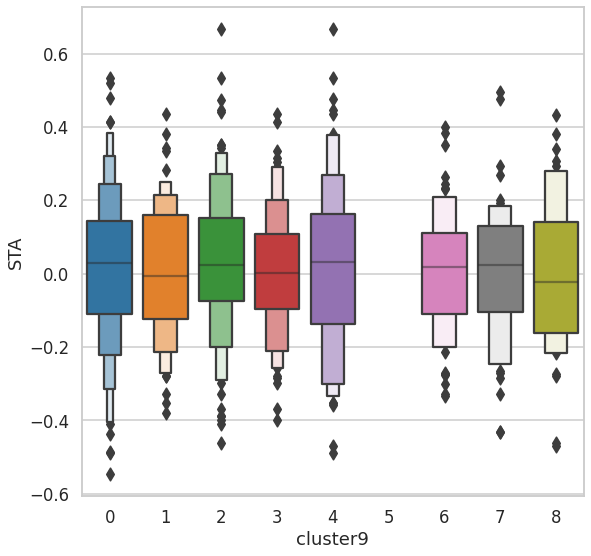

0    368
2    304
1    229
3    228
4    207
7    137
6    114
8     70
5      1
Name: cluster9, dtype: int64
0.683 --> 0.585 --> 0.563 --> 0.556 --> Resumed because of empty cluster
0.683 --> 0.593 --> Resumed because of empty cluster
0.682 --> 0.583 --> 0.562 --> 0.558 --> 0.558 --> 0.558 --> Resumed because of empty cluster
0.671 --> 0.570 --> 0.556 --> 0.554 --> 0.553 --> 0.552 --> 0.552 --> 0.551 --> 0.551 --> 0.551 --> 0.551 --> 0.553 --> 


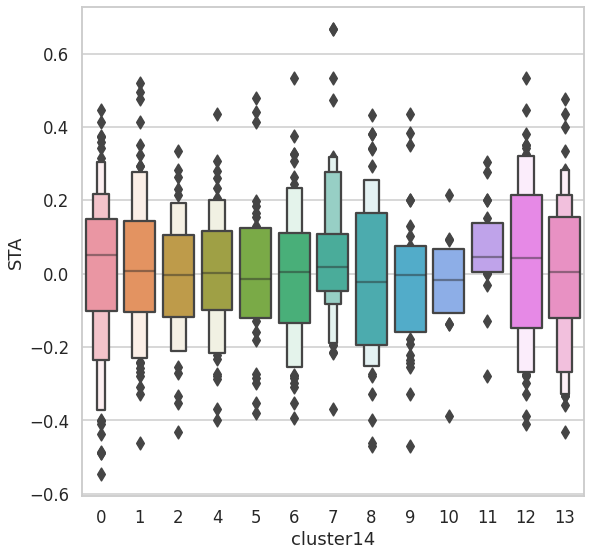

0     292
7     170
13    164
4     156
12    155
1     139
6     138
5      97
2      95
9      69
11     69
8      67
10     47
Name: cluster14, dtype: int64
0.674 --> 0.587 --> 0.563 --> 0.556 --> 0.553 --> 0.553 --> 0.553 --> 


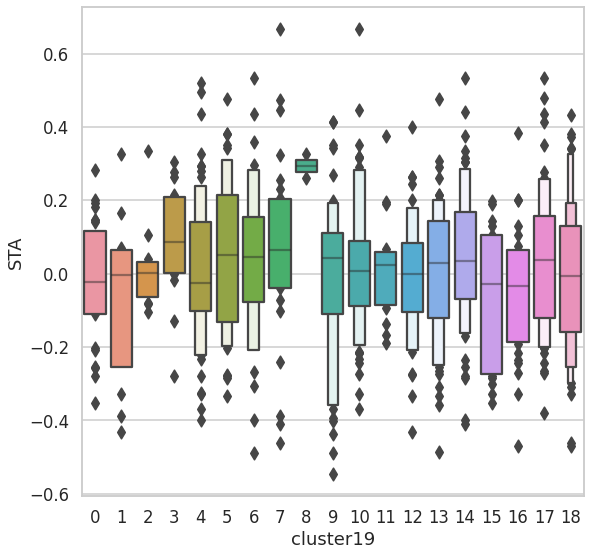

10    195
4     192
9     143
14    127
18    114
13    113
17    112
5     112
6      89
0      76
12     63
16     58
7      57
3      50
1      47
2      37
11     35
15     32
8       6
Name: cluster19, dtype: int64
0.663 --> 0.570 --> 0.554 --> 0.550 --> 0.548 --> 0.546 --> 0.547 --> 


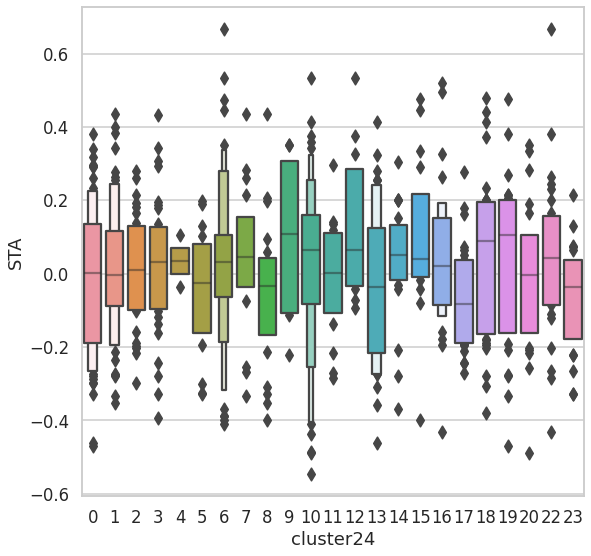

10    168
6     142
1     129
2     111
16    107
0     100
13     99
17     82
23     78
20     73
18     66
14     60
9      58
19     53
8      52
3      51
22     47
7      45
11     42
5      35
12     29
15     27
4       4
Name: cluster24, dtype: int64


In [ ]:
asdf = pd.DataFrame({"cluster":y,"t_words":[[x] for x in tword_ts]},index=obs)
asdf['STA'] = asdf.reset_index()['index'].apply(lambda x: df[(df.OBSID ==x)].scoreSTA.iloc[0])
asdf['ALT'] = asdf.reset_index()['index'].apply(lambda x: df[(df.OBSID ==x)].scoreALT.iloc[0])
asdf['model_grade'] = asdf.reset_index()['index'].apply(lambda x: df[(df.OBSID ==x)].model_grade.mean())
for k in [4,9,14,19,24]:
  model = KShape(n_clusters=k, max_iter=80, verbose = 1)
  model.fit(tword_ts)
  y=model.predict(tword_ts)

  asdf[f'cluster{k}'] = y
  fig = plt.figure(figsize=(9,9))
  sns.boxenplot(data=asdf, x=f'cluster{k}',y='STA')
  plt.show()
  print(asdf[f'cluster{k}'].value_counts())

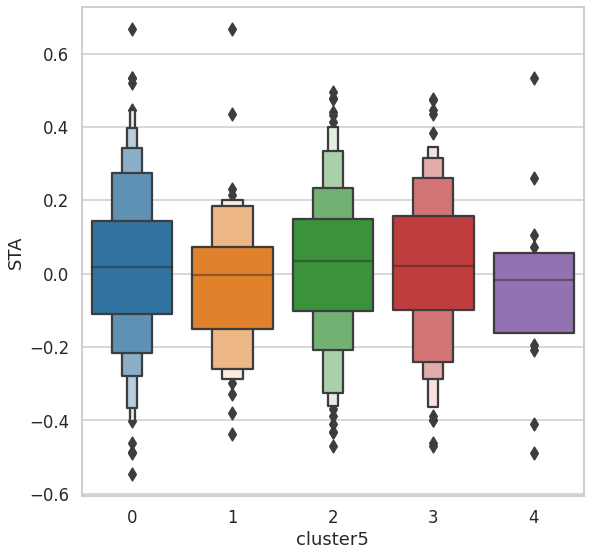

0    590
2    410
3    405
1    203
4     50
Name: cluster5, dtype: int64


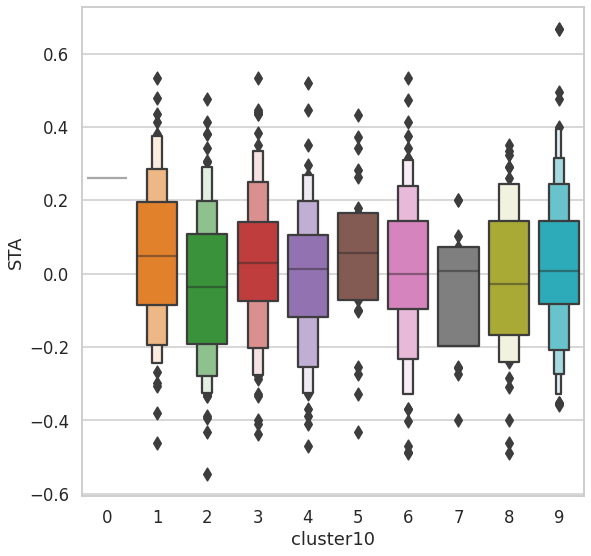

9    346
3    310
2    242
6    189
1    189
4    156
8    114
5     57
7     44
0     11
Name: cluster10, dtype: int64


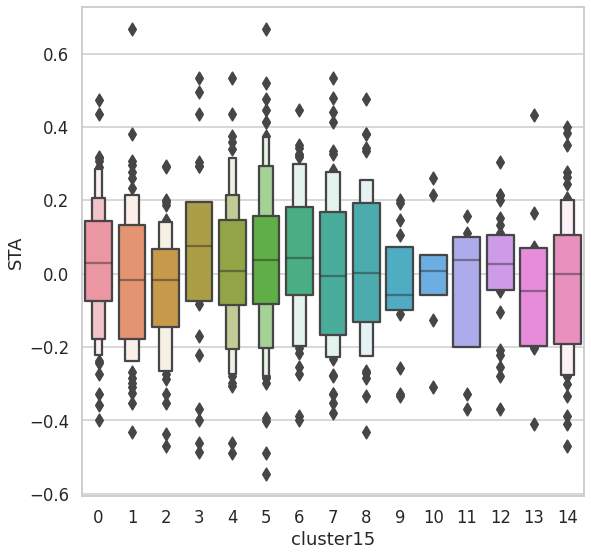

0     254
5     235
4     173
1     132
2     127
14    123
7     123
8     112
6     111
12    104
9      52
3      45
10     25
11     23
13     19
Name: cluster15, dtype: int64


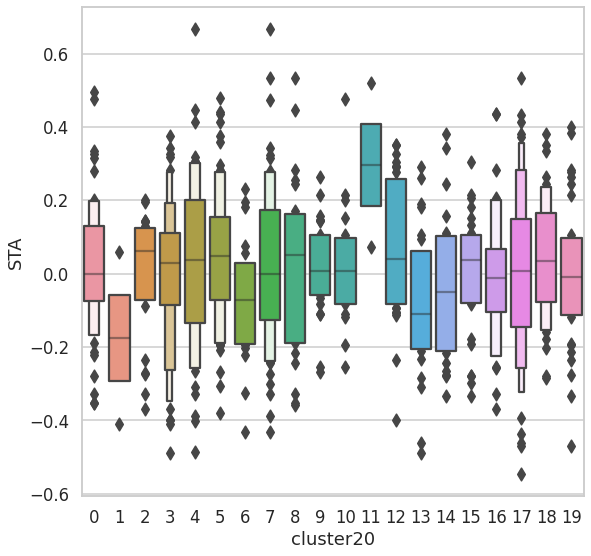

3     202
0     184
7     136
5     132
17    129
8      84
4      83
12     82
14     79
13     73
9      72
19     72
15     66
10     58
18     55
16     55
2      42
6      34
11     17
1       3
Name: cluster20, dtype: int64


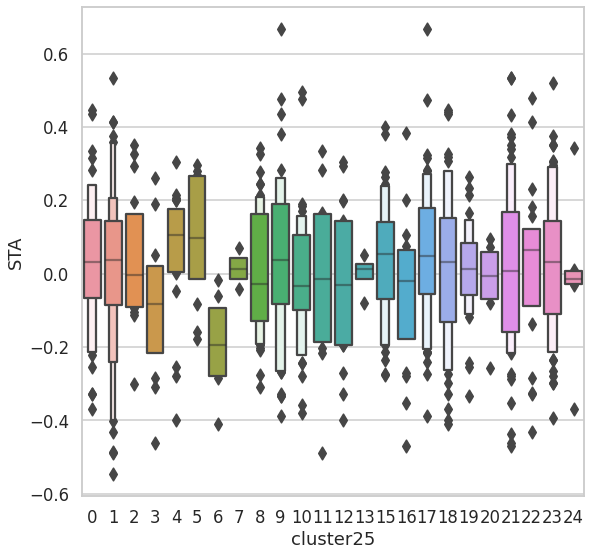

10    161
1     142
8     134
23    129
17    119
21    111
18     96
19     81
9      79
15     73
16     62
2      58
0      58
6      53
4      51
12     48
3      44
5      41
22     37
11     29
20     24
7      11
13      9
24      8
Name: cluster25, dtype: int64


In [ ]:
for k in [5,10,15,20,25]:
  fig = plt.figure(figsize=(9,9))
  sns.boxenplot(data=asdf, x=f'cluster{k}',y='STA')
  plt.show()
  print(asdf[f'cluster{k}'].value_counts())

In [ ]:
MODEL_FOLDER = DATA_FOLDER + 'models/'
model.to_pickle(MODEL_FOLDER + "tskmeans_downsamp100_tw.pkl")


tdf.t_words.apply(lambda x: x[0])

### Sanity checks

14    199
8     197
11    163
15    161
18    153
13    128
16     91
12     85
9      78
17     69
0      65
1      62
4      59
3      34
5      33
2      29
10     20
7      17
6      15
Name: cluster, dtype: int64

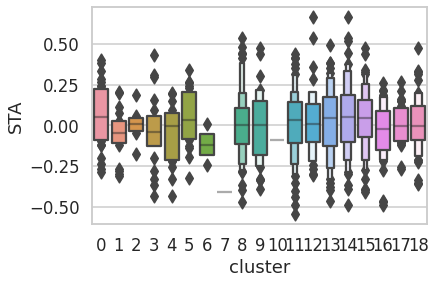

In [ ]:
asdf = pd.DataFrame({"cluster":y,"t_words":[[x] for x in tword_ts]},index=obs)

asdf['STA'] = asdf.reset_index()['index'].apply(lambda x: df[(df.OBSID ==x)].scoreSTA.iloc[0])
asdf['ALT'] = asdf.reset_index()['index'].apply(lambda x: df[(df.OBSID ==x)].scoreALT.iloc[0])
asdf['model_grade'] = asdf.reset_index()['index'].apply(lambda x: df[(df.OBSID ==x)].model_grade.mean())
# asdf['STA'] = asdf.reset_index()['index'].apply(lambda x: df[(df.OBSID ==x) & (df.CHAPNUM.notnull())].scoreSTA.iloc[0])

sns.boxenplot(data=asdf, x='cluster',y='STA')
asdf.cluster.value_counts()

<Axes: xlabel='cluster', ylabel='model_grade'>

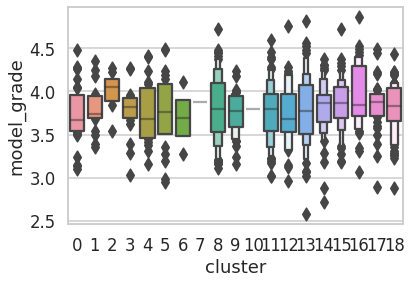

In [ ]:
sns.boxenplot(data=asdf, x='cluster',y='model_grade')

<Axes: xlabel='cluster', ylabel='ALT'>

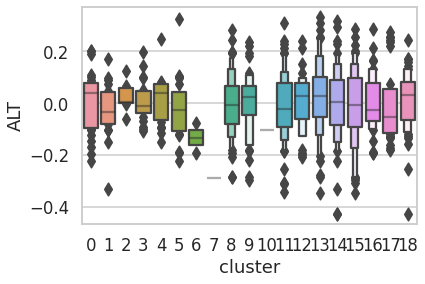

In [ ]:
sns.boxenplot(data=asdf, x='cluster',y='ALT')

4096
0.049637500197


<ipython-input-11-961a7280a436>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[second_axis_vars] = scaler.fit_transform(df[second_axis_vars])


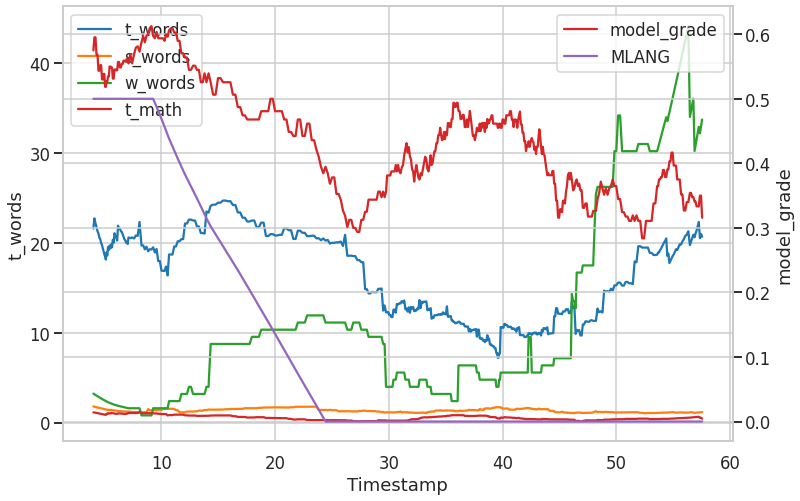

69
0.091777101159


<ipython-input-11-961a7280a436>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[second_axis_vars] = scaler.fit_transform(df[second_axis_vars])


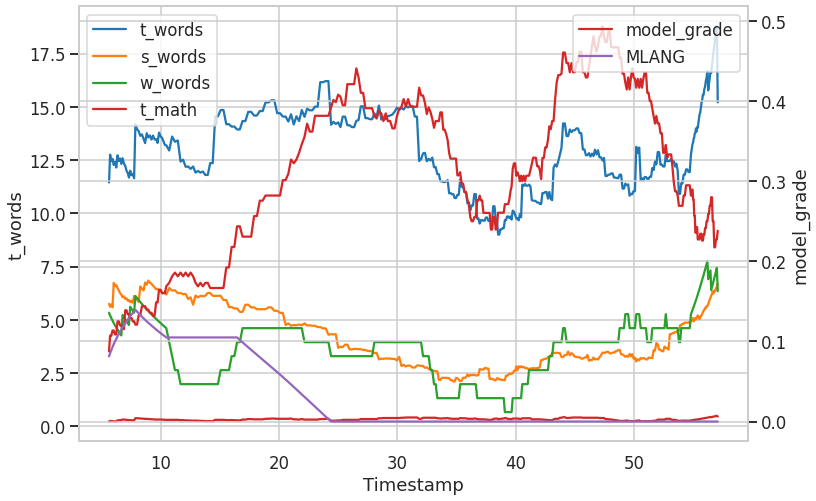

200
0.16395740211


<ipython-input-11-961a7280a436>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[second_axis_vars] = scaler.fit_transform(df[second_axis_vars])


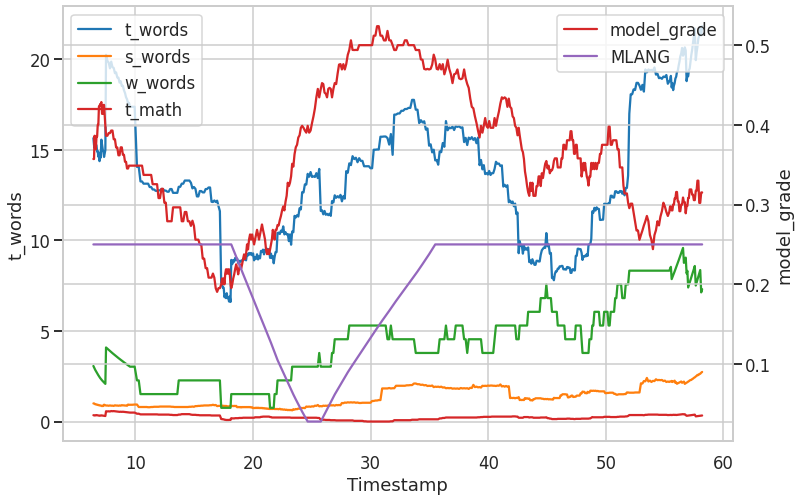

2154
0.005838800222


<ipython-input-11-961a7280a436>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[second_axis_vars] = scaler.fit_transform(df[second_axis_vars])


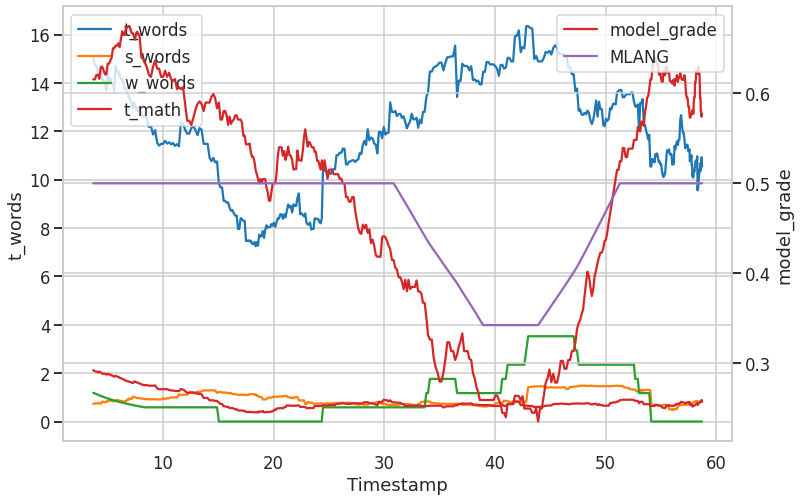

2059
0.036377899349


<ipython-input-11-961a7280a436>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[second_axis_vars] = scaler.fit_transform(df[second_axis_vars])


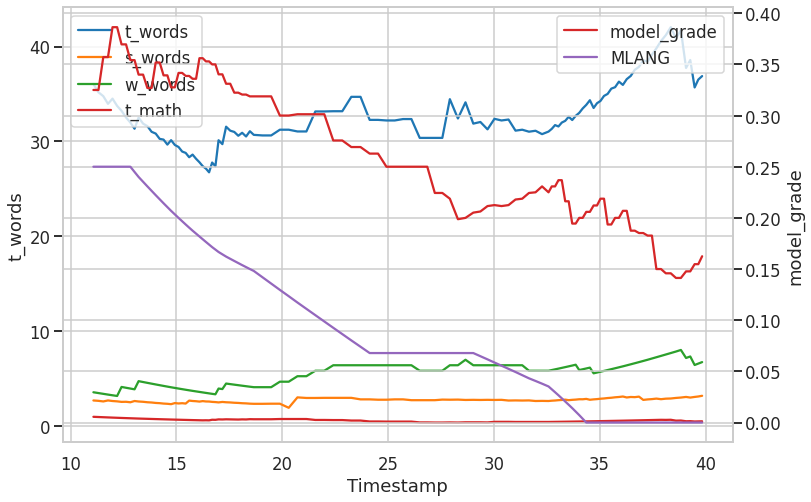

4653
-0.040272001177


<ipython-input-11-961a7280a436>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[second_axis_vars] = scaler.fit_transform(df[second_axis_vars])


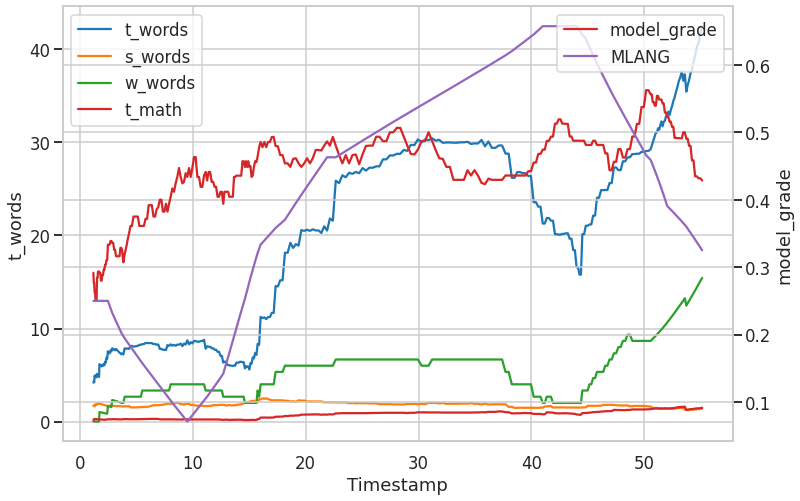

2255
0.054803200066


<ipython-input-11-961a7280a436>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[second_axis_vars] = scaler.fit_transform(df[second_axis_vars])


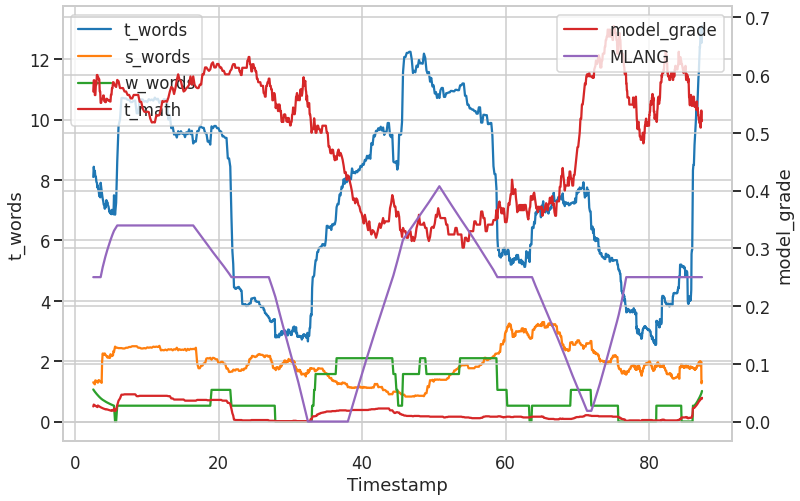

2099
0.083530798554


<ipython-input-11-961a7280a436>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[second_axis_vars] = scaler.fit_transform(df[second_axis_vars])


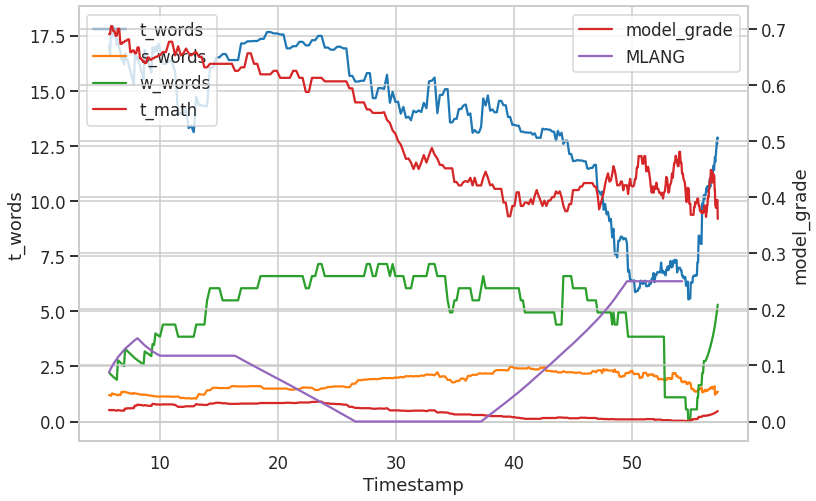

2196
-0.11294350028


<ipython-input-11-961a7280a436>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[second_axis_vars] = scaler.fit_transform(df[second_axis_vars])


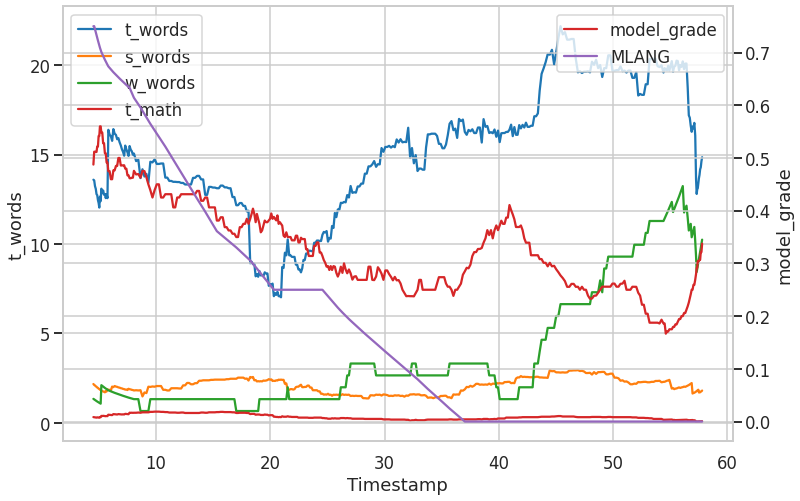

4052
-0.067037701607


<ipython-input-11-961a7280a436>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[second_axis_vars] = scaler.fit_transform(df[second_axis_vars])


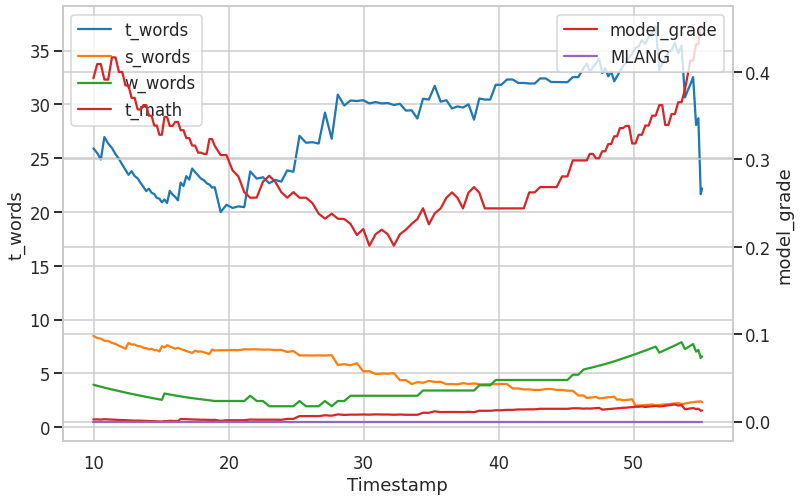

2393
0.076549202204


<ipython-input-11-961a7280a436>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[second_axis_vars] = scaler.fit_transform(df[second_axis_vars])


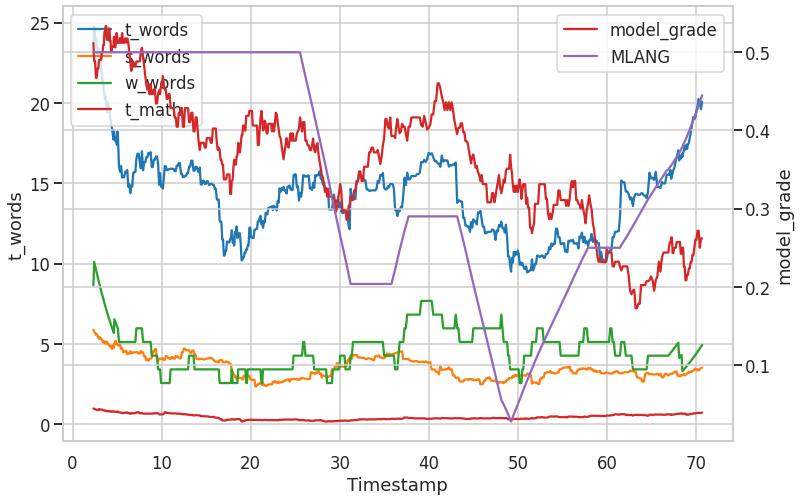

4538
0.018929999322


<ipython-input-11-961a7280a436>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[second_axis_vars] = scaler.fit_transform(df[second_axis_vars])


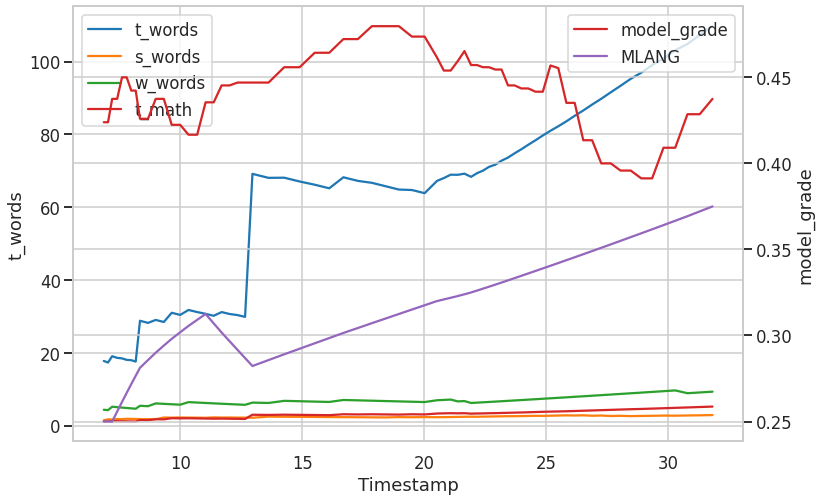

3035
-0.142524600029


<ipython-input-11-961a7280a436>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[second_axis_vars] = scaler.fit_transform(df[second_axis_vars])


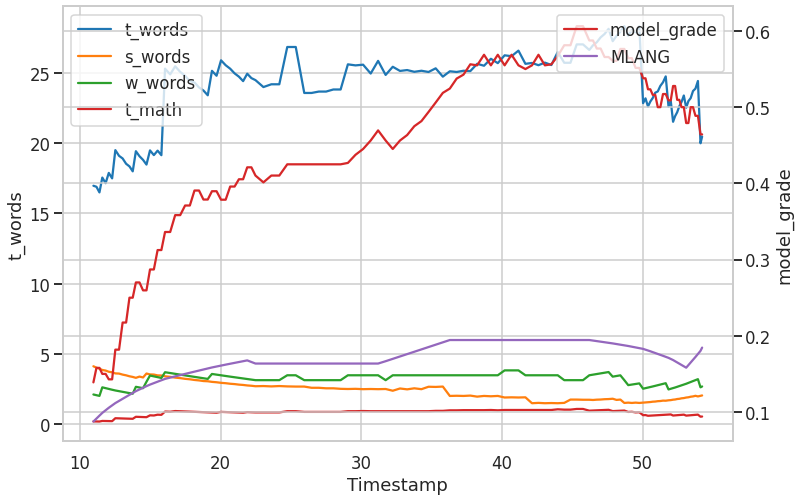

4478
0.24492199719


<ipython-input-11-961a7280a436>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[second_axis_vars] = scaler.fit_transform(df[second_axis_vars])


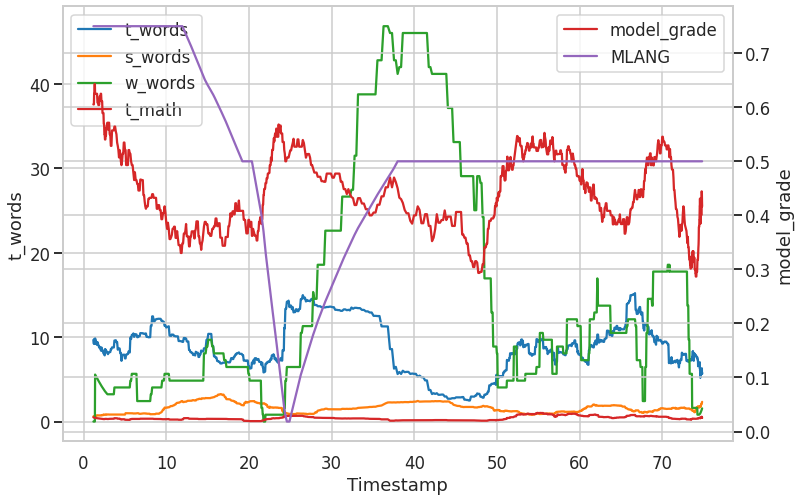

2975
-0.20286360383


<ipython-input-11-961a7280a436>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tdf[second_axis_vars] = scaler.fit_transform(df[second_axis_vars])


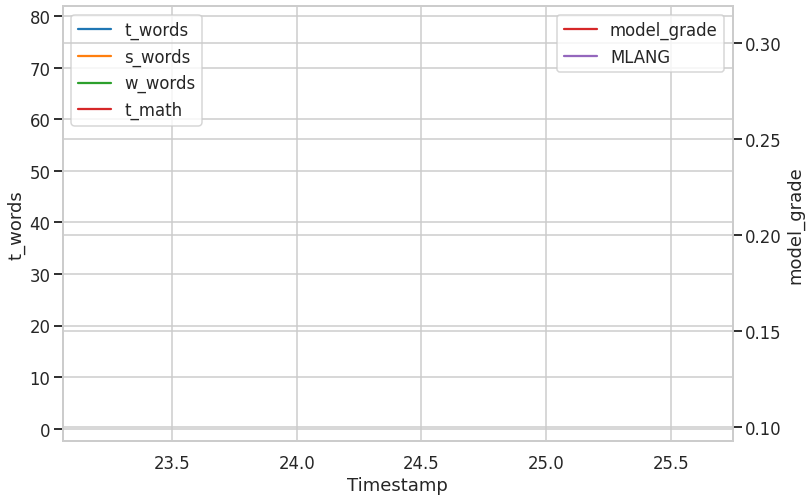

In [ ]:
for ob in list(set(tdf[tdf.cluster.isin([6])].index)):
  print(ob)
  print(df[df.OBSID == ob].scoreSTA.iloc[0])
  make_class_heartbeat(ob, first_axis_vars = ['t_words','s_words','w_words','t_math'],
                         second_axis_vars = ['model_grade','MLANG'],
                      #  second_axis_vars = ['t_math','s_math','model_grade'],
                         xvar = 'timestamp',
                         xinrolling = True,
                      #  legend = False,
                         window = 80)

In [ ]:
### Old updates
tdf['old_cluster_Kshape_13_14_good'] = tdf.cluster
tdf['cluster'] = sum([[i]*100 for i in y],[])
tdf

## Save clustering outputs

In [ ]:

tdf.to_pickle(DATA_FOLDER + "tskmeans_clusters_dw100tw.pkl")
tdf

In [ ]:
tdf = pd.read_pickle(DATA_FOLDER + "tskmeans_clusters_dw100tw.pkl")
tdf

,cluster,t_words,time
3,2,197,0
3,2,116,1
3,2,12,2
3,2,7,3
3,2,48,4
...,...,...,...
4763,3,322,95
4763,3,5,96
4763,3,0,97
4763,3,13,98


In [ ]:
for yi in [4,1,5]:
  for xx in tword_ts[y == yi]:

## Make a chart
grid = sns.FacetGrid(rdf, col=explanatory_var[0],
                     row = row,
                     hue=hue, palette="viridis",
                     height=4)
# Draw a line plot to show the trajectory of each random walk
# grid.map(sns.scatterplot, "grade", "qwk", marker="o")
grid.map(sns.lineplot, "grade", "qwk", marker="o")
grid.add_legend(title=hue, loc='upper center', bbox_to_anchor=(0.5, -0.15), ncol=5)
# Adjust the arrangement of the plots
grid.fig.tight_layout(w_pad=20)

1355      25
1276      27
1277      34
1150      39
474       43
        ... 
1562    1146
1657    1158
1210    1172
1445    1203
932     1223
Length: 1658, dtype: int64

## Create Cluster aggregate plots

### check against another dataset

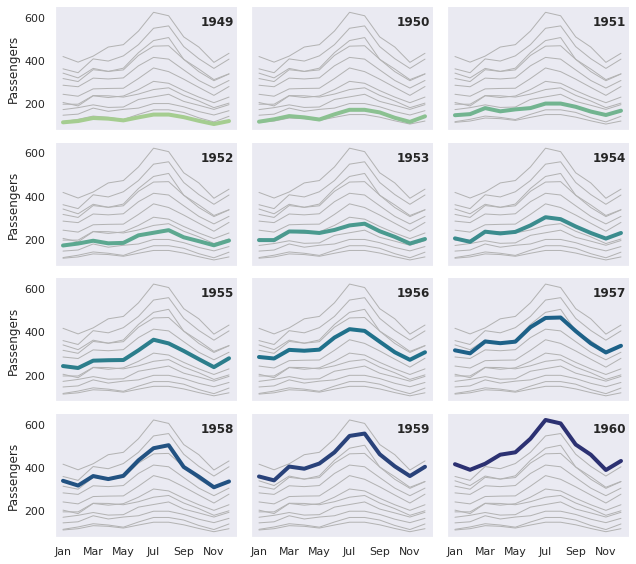

In [ ]:
import seaborn as sns

sns.set_theme(style="dark")
flights = sns.load_dataset("flights")

# Plot each year's time series in its own facet
g = sns.relplot(
    data=flights,
    x="month", y="passengers", col="year", hue="year",
    kind="line", palette="crest", linewidth=4, zorder=5,
    col_wrap=3, height=2, aspect=1.5, legend=False,
)

# Iterate over each subplot to customize further
for year, ax in g.axes_dict.items():

    # Add the title as an annotation within the plot
    ax.text(.8, .85, year, transform=ax.transAxes, fontweight="bold")

    # Plot every year's time series in the background
    sns.lineplot(
        data=flights, x="month", y="passengers", units="year",
        estimator=None, color=".7", linewidth=1, ax=ax,
    )

# Reduce the frequency of the x axis ticks
ax.set_xticks(ax.get_xticks()[::2])

# Tweak the supporting aspects of the plot
g.set_titles("")
g.set_axis_labels("", "Passengers")
g.tight_layout()

### Create Plots

In [ ]:
tdf['old_cluster_Kshape_13_14_good'] = tdf.cluster
tdf['cluster'] = sum([[i]*100 for i in y],[])
tdf

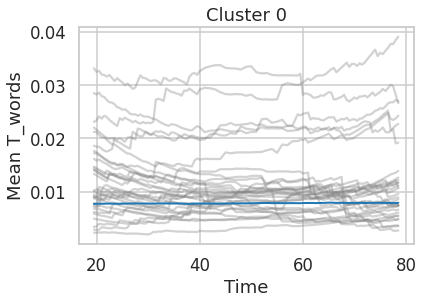

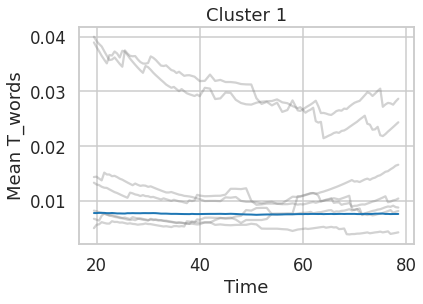

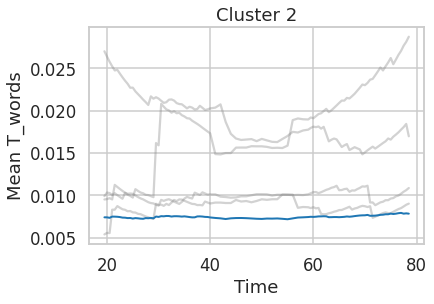

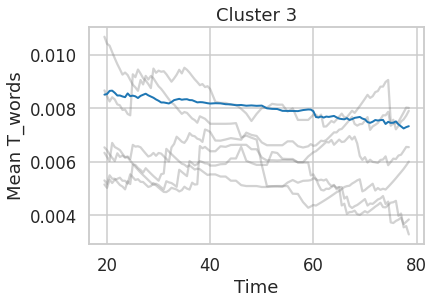

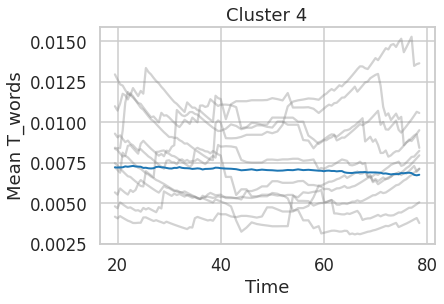

...

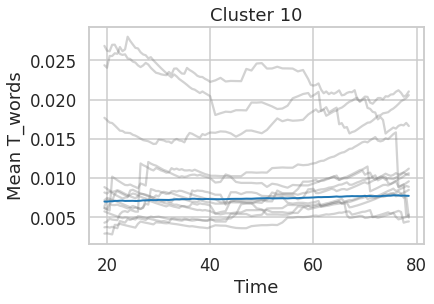

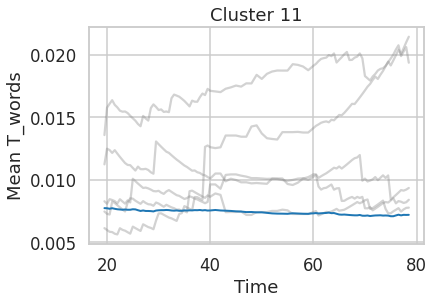

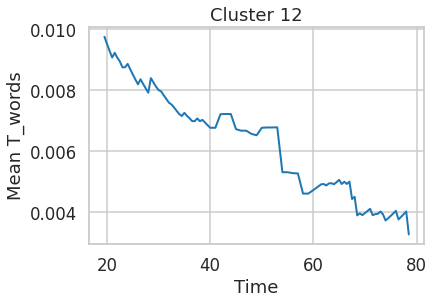

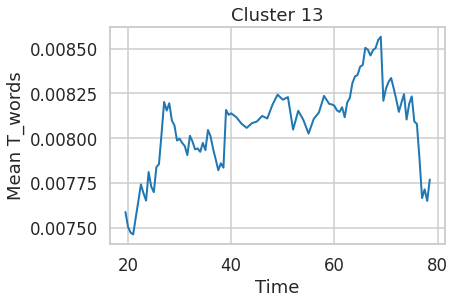

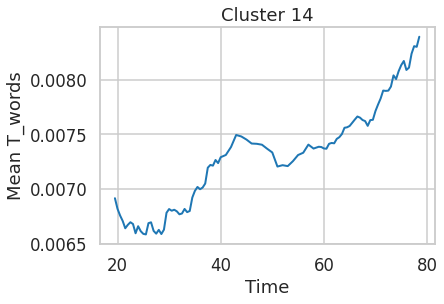

In [ ]:
scaler = MinMaxScaler()
window = 80

# ttdf =
tdf['tw_scaled'] = scaler.fit_transform(tdf[['t_words']])

grouped = tdf.groupby(['cluster', 'time']).mean().reset_index()

# grouped['tw_scaled'] = scaler.fit_transform(grouped['t_words'])

# iterate through each cluster and create a plot
for cluster in grouped['cluster'].unique():
    # filter the grouped dataframe by the cluster

    for i, (n, g )in enumerate(tdf.reset_index().groupby('index')):
      # g['t_words'] = scaler.fit_transform(g[['t_words']])+0.3
      g = g[((g['index']==n)) & (g['cluster'] == cluster)].rolling(window=window,min_periods = 10, closed = 'both', center=True).mean()
      plt.plot(g['time'], g['tw_scaled'], alpha=0.35, color='gray')
      if i >= 100: break

    group = grouped[grouped['cluster'] == cluster]
    # group['t_words'] = scaler.fit_transform(group[['t_words']])
    group = group.rolling(window=window,min_periods = 10, closed = 'both', center=True).mean()

    # plot each individual observation using a thin, transparent line
    plt.plot(group['time'], group['tw_scaled'], linewidth=2)
    # plot the average of t_words for that cluster using a bold line
    # plt.plot(group['time'], group['t_words'].mean(), linewidth=2)
    # add a title and axis labels to each plot
    plt.title('Cluster {}'.format(cluster))
    plt.xlabel('Time')
    plt.ylabel('Mean T_words')
    # show the plot
    plt.show()

# Rolling Function and Dataloader functions for Transformer

In [ ]:
import torch
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
import torchtext.transforms as T
import torch
import torch.nn as nn
import torch.optim as optim
import torch
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import GroupShuffleSplit
from torch.utils.data import dataset, sampler, dataloader

In [ ]:
tmp_df_cols =  colnames = ['speaker', 'OBSID','timestamp',  'year', 't_words', 's_words',
 'NCTETID', 'id_year', 'scoreSTA',
 'scoreALT', 'avgscoreSTA',
 'avgscoreALT',
 'model_grade',
 'model_domain',
 'ORICHC',
 'LINK',  'EXPL', 'MMETH','MLANG',
 'MGEN', 'ETCA',
 'OERRC',  'MAJERR', 'LANGIMP', 'LCP',
 ]

y_cols = [ 'ORICHC', 'LINK',  'EXPL', 'MMETH','MLANG',
 'MGEN', 'ETCA',
 'OERRC',  'MAJERR', 'LANGIMP', 'LCP',
 ]

max_seq_len = 64
batch_size = 4096

In [ ]:
## If used as categorical vars

label_encoders = {}
for col in y_cols:
  label_encoders[col] = LabelEncoder().fit(df[col])

## example for math corpus
MAX_NUM_GRADE_CLASSES = max(label_encoders['grade'].transform(df['grade'])) + 1
MAX_NUM_DOMAIN_CLASSES = max(label_encoders['domain'].transform(df['domain'])) + 1



## Agg funcs

In [ ]:
agg_get_last = lambda x: x.iloc[-1]
agg_mean = lambda x: np.nanmean(x)
embedding_stacked = lambda x: torch.stack(list(x))
text_concatenated = lambda x: '\n'.join(x)

def tensor_join(embeddings):
  tn = embedding_stacked(embeddings)
  return tn.reshape(tn.shape[0],tn.shape[-1])

In [ ]:
max_seq_len = 64
min_periods = 16

def roll_data(df, cols, window=max_seq_len, min_periods = min_periods, step = 9, closed ='both',center = True, func = np.nanmean):
  '''
  Function assumes data is already grouped
  '''
  if cols is None: rolling = df[cols].rolling(window=window,min_periods = min_periods, closed =closed,center = center)
  else: rolling = df[cols].rolling(window=window,min_periods = min_periods, closed =closed,center = center)
  # rolling = rolling[::step]
  indices = []
  for win in rolling:
    indices.append(win.index.tolist())
  rolling = rolling.apply(func)
  rolling['indices'] = indices
  return  rolling

roll_data(df[df.OBSID == 450],['CLPC'])

,CLPC,indices
1046585,0.666667,"[1046585, 1046586, 1046587, 1046588, 1046589, ..."
1046586,0.666667,"[1046585, 1046586, 1046587, 1046588, 1046589, ..."
1046587,0.666667,"[1046585, 1046586, 1046587, 1046588, 1046589, ..."
1046588,0.666667,"[1046585, 1046586, 1046587, 1046588, 1046589, ..."
1046589,0.666667,"[1046585, 1046586, 1046587, 1046588, 1046589, ..."
...,...,...
1047675,0.666667,"[1047642, 1047643, 1047644, 1047645, 1047646, ..."
1047676,0.666667,"[1047643, 1047644, 1047645, 1047646, 1047647, ..."
1047677,0.666667,"[1047644, 1047645, 1047646, 1047647, 1047648, ..."
1047678,0.666667,"[1047645, 1047646, 1047647, 1047648, 1047649, ..."


In [ ]:
def roll_data(df, cols, window=max_seq_len, min_periods = min_periods, step = 9, closed ='both',center = True, func = np.nanmean):
  '''
  Function assumes data is already grouped
  '''
  if cols is None: rolling = df[cols].rolling(window=window,min_periods = min_periods, closed =closed,center = center)
  else: rolling = df[cols].rolling(window=window,min_periods = min_periods, closed =closed,center = center)
  # rolling = rolling[::step]
  indices = []
  for win in rolling:
    indices.append(win.index.tolist())
  rolling = rolling.apply(func)
  rolling['indices'] = indices
  return  rolling

## Make a transcript df
tdf = pd.DataFrame(columns = y_cols + ['indices','OBSID'])
df_list = []
tdf = []
for ob in tqdm(df.OBSID.unique(),total=len(df.OBSID.unique())):
  tdf.append(roll_data(df[(df.OBSID == ob)& (df.speaker == 'teacher')],cols = y_cols + ['OBSID']))

# for ob,g in tqdm(df[df.speaker == 'teacher'].groupby('OBSID')[y_cols], total = len(df[df.speaker == 'teacher'].groupby('OBSID')[y_cols])):
#   pd.concat([tdf,roll_data(df[df.OBSID == ob],cols = y_cols),df[df.OBSID == ob][:,['OBSID']]])


tdf = pd.concat(tdf)
tdf

  0%|          | 0/1658 [00:00<?, ?it/s]

,ORICHC,LINK,EXPL,MMETH,MLANG,MGEN,ETCA,OERRC,MAJERR,LANGIMP,LCP,OBSID,indices
0,0.291667,0.25,0.5,0.0,0.5,0.0,0.25,0.0,0.0,0.0,0.0,2119.0,"[0, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 15, 1..."
2,0.291667,0.25,0.5,0.0,0.5,0.0,0.25,0.0,0.0,0.0,0.0,2119.0,"[0, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 15, 1..."
4,0.291667,0.25,0.5,0.0,0.5,0.0,0.25,0.0,0.0,0.0,0.0,2119.0,"[0, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 15, 1..."
5,0.291667,0.25,0.5,0.0,0.5,0.0,0.25,0.0,0.0,0.0,0.0,2119.0,"[0, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 15, 1..."
6,0.291667,0.25,0.5,0.0,0.5,0.0,0.25,0.0,0.0,0.0,0.0,2119.0,"[0, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 15, 1..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1412397,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,315.0,"[1412356, 1412358, 1412359, 1412360, 1412361, ..."
1412398,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,315.0,"[1412358, 1412359, 1412360, 1412361, 1412362, ..."
1412399,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,315.0,"[1412359, 1412360, 1412361, 1412362, 1412363, ..."
1412401,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,315.0,"[1412360, 1412361, 1412362, 1412363, 1412364, ..."


In [ ]:
roll_data(df[(df.OBSID == ob)& (df.speaker == 'teacher')],cols = y_cols + ['OBSID'])

,ORICHC,LINK,EXPL,MMETH,MLANG,MGEN,ETCA,OERRC,MAJERR,LANGIMP,LCP,OBSID,indices
1411453,0.0,0.25,0.0,0.0,0.5,0.0,0.0,0.0,0.0,0.0,0.0,315.0,"[1411453, 1411454, 1411455, 1411456, 1411457, ..."
1411454,0.0,0.25,0.0,0.0,0.5,0.0,0.0,0.0,0.0,0.0,0.0,315.0,"[1411453, 1411454, 1411455, 1411456, 1411457, ..."
1411455,0.0,0.25,0.0,0.0,0.5,0.0,0.0,0.0,0.0,0.0,0.0,315.0,"[1411453, 1411454, 1411455, 1411456, 1411457, ..."
1411456,0.0,0.25,0.0,0.0,0.5,0.0,0.0,0.0,0.0,0.0,0.0,315.0,"[1411453, 1411454, 1411455, 1411456, 1411457, ..."
1411457,0.0,0.25,0.0,0.0,0.5,0.0,0.0,0.0,0.0,0.0,0.0,315.0,"[1411453, 1411454, 1411455, 1411456, 1411457, ..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1412397,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,315.0,"[1412356, 1412358, 1412359, 1412360, 1412361, ..."
1412398,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,315.0,"[1412358, 1412359, 1412360, 1412361, 1412362, ..."
1412399,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,315.0,"[1412359, 1412360, 1412361, 1412362, 1412363, ..."
1412401,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,315.0,"[1412360, 1412361, 1412362, 1412363, 1412364, ..."


In [ ]:
tdf.to_pickle(DATA_FOLDER + "indexed_tdf_for_processing.pkl")

## Create DF w agg funcs

In [ ]:
max_seq_len = 32
min_seq_len = 16
batch_size = 1024

y_cols = [ 'ORICHC', 'LINK',  'EXPL', 'MMETH','MLANG',
 'MGEN', 'ETCA',
 'OERRC',  'MAJERR', 'LANGIMP', 'LCP',
 ]

def roll_data(df, cols, window=max_seq_len, min_periods = min_periods, step = 9, closed ='both',center = True, func = np.nanmean):
  '''
  Function assumes data is already grouped
  '''
  if cols is None: rolling = df[cols].rolling(window=window,min_periods = min_periods, closed =closed,center = center)
  else: rolling = df[cols].rolling(window=window,min_periods = min_periods, closed =closed,center = center)
  # rolling = rolling[::step]
  indices = []
  for win in rolling:
    indices.append(win.index.tolist())
  rolling = rolling.apply(func)
  rolling['indices'] = indices
  return  rolling

## Make a transcript df
tdf = []
for ob in tqdm(df.OBSID.unique(),total=len(df.OBSID.unique())):
  tdf.append(roll_data(df[(df.OBSID == ob)& (df.speaker == 'teacher')],cols = y_cols + ['OBSID']))
tdf = pd.concat(tdf)

class TranscriptDataset(dataset.Dataset):
    def __init__(self, embeds, inputs, y_cols, step = 1, max_seq_len = max_seq_len, from_text = False, tokenizer = None, emb_model = None, eval_only = False):
        super().__init__()
        self.embeds = embeds
        self.inputs = inputs[::step]
        self.eval_only = eval_only
        self.max_seq_len = max_seq_len
        self.from_text = from_text
        self.step = step
        self.y_cols = {col:self.inputs[col] for col in y_cols}
        self.indices = self.inputs['indices']
        if self.from_text:
          self.tokenizer = AutoTokenizer.from_pretrained('sentence-transformers/paraphrase-multilingual-MiniLM-L12-v2', use_fast = True)
          self.emb_model = AutoModel.from_pretrained('sentence-transformers/paraphrase-multilingual-MiniLM-L12-v2')
          self.emb_model.to(DEVICE)
        else:
          self
        if not self.eval_only:
          self.grade = grade
          self.domain = domain

    def __len__(self):
        return len(self.inputs)

    #Mean Pooling - Take attention mask into account for correct averaging
    def mean_pooling(self, model_output, attention_mask):
        token_embeddings = model_output[0] #First element of model_output contains all token embeddings
        input_mask_expanded = attention_mask.unsqueeze(-1).expand(token_embeddings.size()).float()
        return torch.sum(token_embeddings * input_mask_expanded, 1) / torch.clamp(input_mask_expanded.sum(1), min=1e-9)

    def get_embeddings(self, text_list):
        toks = self.tokenizer(text_list, padding='max_length', truncation=True, return_tensors='pt')
        toks = {k:v.to(DEVICE) for k,v in toks.items()}
        # Compute token embeddings
        with torch.no_grad():
            model_output = self.mean_pooling(self.emb_model(**toks), toks['attention_mask'])
        return model_output



    def tensor_join(embeddings):
      tn = torch.stack(list(embeddings))
      return tn.reshape(tn.shape[0],tn.shape[-1])

    def __getitem__(self,idx):
        """Constructs an observation.
        Data are sampled at random without replacement.
        """
        if self.from_text:
          sample = self.get_embeddings(self.inputs.iloc[idx])

        else:
          sample_idx = self.indices.iloc[idx]
          sample = self.tensor_join(self.embeds[sample_idx])

        mask = torch.ones_like(sample)
        pad_diff = self.max_seq_len - sample.shape[0] -1

        if pad_diff < 0 :
          sample = sample[:self.max_seq_len,:]
          mask = mask[:self.max_seq_len,:]
        else:
          sample = F.pad(sample,(0,0,1,pad_diff),'constant',0)
          mask = F.pad(mask,(0,0,1,pad_diff),'constant',0)
        mask = mask @ mask.T
        if self.eval_only:
          return sample, mask
        return {"src":sample, "mask":mask}, {k:v.iloc[idx] for v,k in self.y_cols.items()}




from sklearn.model_selection import GroupShuffleSplit

# def get_indices(data):
# # create a GroupShuffleSplit object with a specified test size and random state
# gss = GroupShuffleSplit(n_splits=1, test_size=test_size, random_state=42)

# # split the data into train and test sets while keeping the groups intact
# train_idx, test_idx = next(gss.split(X_cols, data[target_cols], groups=data['OBSID']))

# # create the train and test sets using the obtained indices
# X_train, X_test = X_cols.iloc[train_idx], X_cols.iloc[test_idx]
# y_train, y_test = data[target_cols].iloc[train_idx], data[target_cols].iloc[test_idx]

#     gss = GroupShuffleSplit(n_splits=1, test_size=test_size, random_state=42)

#     # split the data into train and test sets while keeping the groups intact
#     train_idx, test_idx = next(gss.split(X_cols, data[target_cols], groups=data['OBSID']))

#     # create the train and test sets using the obtained indices
#     X_train, X_test = X_cols.iloc[train_idx], X_cols.iloc[test_idx]
#     y_train, y_test = data[target_cols].iloc[train_idx], data[target_cols].iloc[test_idx]


def custom_rolling(df, x_cols, y_cols, window_size = max_seq_len, aggregator_funcs = agg_fun_dict, min_window_size = 8, step_size=1, group_shuffle = False):
    """
    Applies a custom rolling window operation to a pandas DataFrame using a specified aggregation function.
    :param grouped: The pandas groupby DataFrame to add the rolling window operation to.
    :param gdf: The pandas DataFrame to add the concat the operation to.
    :param window_size: The size of the rolling window.
    :param min_window_size: The minimum size of the rolling window.
    :param step_size: The steps between
    :param aggregator_funcs: The dictionary of aggregation functions to apply to each rolling window.
    :return: gdf combined with new pandas DataFrame with the result of the rolling window operation.
    """

    # Initialize an empty list to store the rolling window results
    results = []

    # Iterate over each group in the DataFrame
    for name, group in tqdm(grouped, total=len(list(grouped.groups.keys()))):
        # Extract the target column from the group as a pandas Series
        # target_series = group[target_col]
        group_size = len(group)
        if group_size < min_window_size: continue
        if group_shuffle: group = group.sample(frac = 1)

        # Initialize an empty list to store the rolling window results for this group
        group_results = []

        # Iterate over each index in the target Series
        for i in range(0,group_size,step_size):
            # Get the start and end indices for the current rolling window
            start_idx = max(i , 0)
            end_idx = min(i + window_size - 1, group_size)
            if end_idx - start_idx < min_window_size: break
            obs_result = {}

            for col in group.columns:
              target_series = group[col]
              aggregator_func = aggregator_funcs[col]
              # Extract the values for the current rolling window
              window_values = target_series[start_idx:end_idx]

              # Apply the aggregator function to the window values
              window_result = aggregator_func(window_values)
              obs_result[col] = window_result

            # Append the window result to the group results list
            group_results.append(obs_result)

        # Add the group results to the overall results list
        results.extend(group_results)

    # Create a new DataFrame with the rolling window results
    rolling_df = pd.DataFrame(results)

    # Merge the rolling window results DataFrame with the original DataFrame
    merged_df = pd.concat([gdf, rolling_df])

    # Return the merged DataFrame
    return merged_df






def custom_rolling(grouped, gdf, window_size, aggregator_funcs = agg_fun_dict, min_window_size = 1, step_size=1, group_shuffle = False):
    """
    Applies a custom rolling window operation to a pandas DataFrame using a specified aggregation function.
    :param grouped: The pandas groupby DataFrame to add the rolling window operation to.
    :param gdf: The pandas DataFrame to add the concat the operation to.
    :param window_size: The size of the rolling window.
    :param min_window_size: The minimum size of the rolling window.
    :param step_size: The steps between
    :param aggregator_funcs: The dictionary of aggregation functions to apply to each rolling window.
    :return: gdf combined with new pandas DataFrame with the result of the rolling window operation.
    """

    # Initialize an empty list to store the rolling window results
    results = []

    # Iterate over each group in the DataFrame
    for name, group in tqdm(grouped, total=len(list(grouped.groups.keys()))):
        # Extract the target column from the group as a pandas Series
        # target_series = group[target_col]
        group_size = len(group)
        if group_size < min_window_size: continue
        if group_shuffle: group = group.sample(frac = 1)

        # Initialize an empty list to store the rolling window results for this group
        group_results = []

        # Iterate over each index in the target Series
        for i in range(0,group_size,step_size):
            # Get the start and end indices for the current rolling window
            start_idx = max(i , 0)
            end_idx = min(i + window_size - 1, group_size)
            if end_idx - start_idx < min_window_size: break
            obs_result = {}

            for col in group.columns:
              target_series = group[col]
              aggregator_func = aggregator_funcs[col]
              # Extract the values for the current rolling window
              window_values = target_series[start_idx:end_idx]

              # Apply the aggregator function to the window values
              window_result = aggregator_func(window_values)
              obs_result[col] = window_result

            # Append the window result to the group results list
            group_results.append(obs_result)

        # Add the group results to the overall results list
        results.extend(group_results)

    # Create a new DataFrame with the rolling window results
    rolling_df = pd.DataFrame(results)

    # Merge the rolling window results DataFrame with the original DataFrame
    merged_df = pd.concat([gdf, rolling_df])

    # Return the merged DataFrame
    return merged_df

In [ ]:

target_factors = []
label_encoders = {}
if target_factors:
  for col in y_cols:
    label_encoders[col] = LabelEncoder().fit(round(df[col]*100))







def create_datasets(data, X_cols, target_cols, groups=['OBSID'], test_size=0.1, val_size=0.2, batch_size=32, from_text = True, eval_only = False, target_factors = []):
  if eval_only:
    eval_dataset = TranscriptDataset(X_train, **y_train, max_seq_len = max_seq_len,from_text = from_text, eval_only= eval_only)

  else:
    # Split data into train and test sets

    # create a GroupShuffleSplit object with a specified test size and random state
    gsst = GroupShuffleSplit(n_splits=1, test_size=test_size, random_state=42)

    # split the data into train and test sets while keeping the groups intact
    train_idx, test_idx = next(gsst.split(X_cols, data[target_cols], groups=data[groups]))

    # create the train and test sets using the obtained indices
    X_train, X_test = X_cols.iloc[train_idx], X_cols.iloc[test_idx]
    y_train, y_test = data[target_cols].iloc[train_idx], data[target_cols].iloc[test_idx]

    gssv = GroupShuffleSplit(n_splits=1, test_size=val_size, random_state=42)
    train_idx, val_idx = next(gssv.split(X_train, data[target_cols].iloc[train_idx], groups = data[target_cols].iloc[train_idx][groups]))
    # Split train set into train and validation sets
    X_train, X_val = X_cols.iloc[train_idx], X_cols.iloc[val_idx]
    y_train, y_val = data[target_cols].iloc[train_idx], data[target_cols].iloc[val_idx]


    # Encode categorical target variables
    for col in target_factors:
        y_train[col] = label_encoders[col].transform(y_train[col])
        y_val[col] = label_encoders[col].transform(y_val[col])
        y_test[col] = label_encoders[col].transform(y_test[col])

    # Convert target columns to PyTorch tensors
    y_train = {col:torch.tensor(y_train[col].values, dtype=torch.long) for col in target_cols}
    y_val = {col:torch.tensor(y_val[col].values, dtype=torch.long) for col in target_cols}
    y_test = {col:torch.tensor(y_test[col].values, dtype=torch.long) for col in target_cols}

    # Create text tokens
    # Create PyTorch data loaders for each set
    train_dataset = TranscriptDataset(X_train, **y_train, max_seq_len = max_seq_len,from_text = from_text)
    train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle = True)
    val_dataset = TranscriptDataset(X_val, **y_val, max_seq_len = max_seq_len, from_text= from_text)
    val_loader = torch.utils.data.DataLoader(val_dataset, batch_size=4*batch_size, shuffle = True)
    test_dataset = TranscriptDataset(X_test, **y_test, max_seq_len = max_seq_len, from_text= from_text)
    test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=4*batch_size, shuffle = True)

    return train_loader, val_loader, test_loader


# train_loader, val_loader, test_loader = create_datasets(df, df['text'], target_cols=['grade','domain'], batch_size = batch_size, from_text = True)
train_loader, val_loader, test_loader = create_datasets(tdf, embeds, target_cols=['grade','domain'], batch_size = batch_size, from_text = False)

In [ ]:
embedding_depth = 384
max_seq_len = 6
NUM_HEADS = 24
HIDDEN_DIM = 2048
DROPOUT = 0.45
ACTIVATION = "relu"
# LAYER_NORM_EPS = 5e-04
NUM_TRANSFORMER_LAYERS = 4
LR = 0.00001
EPOCHS = 1000
LABEL_SMOOTHING = 0.15


# target_factors = []
label_encoders = {}
if target_factors:
  for col in y_cols:
    label_encoders[col] = LabelEncoder().fit(round(df[col]*10))

def get_accs(logits, y_labels):
  accs = {}
  for k,v in logits.items():
    accs[k] = label_encoders[k].inverse_transform(torch.round(v.cpu()*10)) == label_encoders[k].inverse_transform(torch.round(y_labels.cpu()*10))
    accs[k] = torch.mean(accs[k].to(torch.float)).item()
  return accs

class EmbeddingTransformer(nn.Module):
    """Container for ProtoNet weights and image-to-latent computation."""

    def __init__(self, embedding_length = embedding_depth, max_seq_len = max_seq_len, model_outputs = y_cols, label_model_outputs = []):
        """Inits EmbeddingTransformer.
        """
        super().__init__()
        self.embedding_length = embedding_length
        self.max_seq_len = max_seq_len
        self.num_heads = NUM_HEADS
        self.num_outputs = len(model_outputs)
        self.model_outputs = len(model_outputs)
        # self.batch_size = batch_s
        # self.max_num_grade_classes = MAX_NUM_GRADE_CLASSES
        # self.max_num_domain_classes = MAX_NUM_DOMAIN_CLASSES
        tel = torch.nn.TransformerEncoderLayer(d_model = self.embedding_length,
                                  nhead = NUM_HEADS,
                                  dim_feedforward=HIDDEN_DIM,
                                  dropout=DROPOUT,
                                  activation=ACTIVATION,
                                  # layer_norm_eps=LAYER_NORM_EPS,
                                  batch_first=True,
                                  norm_first=False,
                                  device=DEVICE,
                                  dtype=None)

        self.encoder = torch.nn.TransformerEncoder(encoder_layer = tel,
                                                   num_layers = NUM_TRANSFORMER_LAYERS,
                                                   norm=None,
                                                   enable_nested_tensor=True)
        self.flat = nn.Flatten()


        self.output_ff = {k: nn.Sequential(
            nn.Linear(self.embedding_length*self.max_seq_len,self.embedding_length*4),
            nn.Linear(self.embedding_length*4, 1)) for k in self.model_outputs}


        # self.class_domain_head = nn.Linear(self.embedding_length*self.max_seq_len,self.max_num_domain_classes)
        if label_model_outputs:
          self.class_domain_head = {k:nn.Sequential(
              nn.Linear(self.embedding_length*self.max_seq_len,self.max_num_domain_classes*4),
              nn.Linear(self.max_num_domain_classes*4, self.max_num_domain_classes*4),
              nn.Linear(self.max_num_domain_classes*4,self.max_num_domain_classes*2),
              nn.Linear(self.max_num_domain_classes*2,self.max_num_domain_classes)) for k in label_model_outputs}
        # self.class_head_b = nn.Linear(self.max_num_classes,self.max_num_classes)
        # self.reg_head = nn.Linear(self.embedding_length*self.max_seq_len,1)
        self.smx = nn.Softmax(dim=-1)
        self.to(DEVICE)

    def forward(self,src,mask):
        """Computes the scores of a batch of essay.
        Args:
            src (Tensor): batch of Essay docs
                shape (batch, sentences, embeddings)
            src_mask (Tensor): batch of masks for self attention
                shape (batch, max_sequence, max_sequence)
        Returns:
            a Tensor containing a batch of latent representations
                shape (batch, 60 possible vals)
        """
        mask_dim = mask.shape[-1]
        batch_size = mask.shape[0]
        mask = mask.to(torch.float)
        src_mask = mask.unsqueeze(1).expand(batch_size,self.num_heads,mask_dim,mask_dim).reshape(-1,mask_dim,mask_dim)


        # src_mask = mask.T @ mask
        # print(mask.shape)
        # src_mask = torch.tile(src_mask.unsqueeze(dim=0),dims=(batch_size,1,1))
        # src_mask = mask.unsqueeze(1).expand(-1,128,128).unsqueeze(1).expand(batch_size,self.num_heads,-1,-1).reshape(-1,128,128)
        # src_mask = (mask.unsqueeze(dim=-1) @ mask.unsqueeze(dim=1)).unsqueeze(1).expand(batch_size,self.num_heads,mask_dim,mask_dim).reshape(-1,mask_dim,mask_dim)
        # res = self.encoder(src, src_mask)
        res = self.encoder(src)
        # print(res)
        y_grade_class = nn.functional.softmax(self.class_grade_head(self.flat(res)),dim=-1)
        y_domain_class = nn.functional.softmax(self.class_domain_head(self.flat(res)),dim=-1)
        return y_grade_class, y_domain_class

# create model and optimizer
model = EmbeddingTransformer()
model.to(DEVICE)
optimizer = optim.AdamW(model.parameters(), lr=LR)

# define loss function
criterion = nn.CrossEntropyLoss(label_smoothing = LABEL_SMOOTHING)
criterion = nn.MSELoss()
# train model
num_epochs = EPOCHS
train_loss = []
train_grade_acc = []
train_domain_acc = []
val_loss = []
val_grade_acc = []
val_domain_acc = []


for epoch in (range(num_epochs)):
  running_loss = 0.0
  for i, data in tqdm(enumerate(train_loader),total = len(train_loader)):
    inputs, masks, grades, domains = data
    inputs = {"src":inputs.to(DEVICE),"mask":masks.to(DEVICE)}
    optimizer.zero_grad()
    grade_preds, domain_preds = model(**inputs)
    grade_loss = criterion(grade_preds.cpu(), grades.to(torch.long))
    domain_loss = criterion(domain_preds.cpu(), domains.to(torch.long))
    loss = torch.add(grade_loss, domain_loss)
    loss.backward()
    optimizer.step()
    running_loss += loss.item()
    grade_acc, domain_acc = get_accs(grade_preds, domain_preds,grades,domains)
    train_grade_acc.append(grade_acc)
    train_domain_acc.append(domain_acc)
  epoch_loss = running_loss / len(train_loader)
  train_loss.append(epoch_loss)

  val_running_loss = 0.0
  with torch.no_grad():
    for i, data in tqdm(enumerate(val_loader),total= len(val_loader)):
      inputs, masks, grades, domains = data
      inputs = {"src":inputs.to(DEVICE),"mask":masks.to(DEVICE)}
      # outputs = model(**inputs)
      grade_preds, domain_preds = model(**inputs)
      grade_loss = criterion(grade_preds.cpu(), grades.to(torch.long))
      domain_loss = criterion(domain_preds.cpu(), domains.to(torch.long))
      loss = torch.add(grade_loss, domain_loss)
      val_running_loss += loss.item()
      # print(val_running_loss)
      grade_acc, domain_acc = get_accs(grade_preds, domain_preds,grades,domains)
      val_grade_acc.append(grade_acc)
      val_domain_acc.append(domain_acc)
  val_epoch_loss = val_running_loss / len(val_loader)
  val_loss.append(val_epoch_loss)

  print('Epoch [{}/{}], Train Loss: {:.4f}, Val Loss: {:.4f}'
        .format(epoch+1, num_epochs, epoch_loss, val_epoch_loss))

  # plot training and validation loss
  plt.plot(train_loss, label='Train Loss')
  plt.plot(val_loss, label='Val Loss')
  plt.xlabel('Epoch')
  plt.ylabel('Loss')
  plt.legend()
  plt.show()

  # plot training and validation loss
  plt.plot(train_grade_acc, label='Grade Train acc')
  plt.plot(train_domain_acc, label='Domain Train acc')
  plt.xlabel('Epoch')
  plt.ylabel('Accuracy')
  plt.legend()
  plt.show()

  # plot training and validation loss
  plt.plot(val_grade_acc, label='Grade val acc')
  plt.plot(val_domain_acc, label='Domain val acc')
  plt.xlabel('Epoch')
  plt.ylabel('Accuracy')
  plt.legend()
  plt.show()

  # if (epoch % 5 == 0 ) & (epoch > 1):
  torch.save({
          'epoch': epoch,
          'model_state_dict': model.state_dict(),
          'optimizer_state_dict': optimizer.state_dict(),
          'loss': loss,'train_loss':train_loss, 'train_grade_acc':train_grade_acc,
          'train_domain_acc':train_domain_acc,'val_loss':val_loss,'val_grade_acc':val_grade_acc,
          'val_domain_acc':val_domain_acc,'embedding_depth' : embedding_depth,
          'max_seq_len' : max_seq_len,'NUM_HEADS' : NUM_HEADS,'HIDDEN_DIM' : HIDDEN_DIM,
          'DROPOUT' : DROPOUT,'ACTIVATION' : "relu", 'NUM_TRANSFORMER_LAYERS' : NUM_TRANSFORMER_LAYERS,'LR':LR
          }, DATA_FOLDER + "models/" + f"march9_epoch{epoch}_max_seq{max_seq_len}_dropout{round(DROPOUT *100)}_translayers{NUM_TRANSFORMER_LAYERS}_LR{LR}")

# Trying out Positional Embeddings

In [ ]:
def positional_encoding(length, depth):
  depth = depth/2

  positions = np.arange(length)[:, np.newaxis]     # (seq, 1)
  depths = np.arange(depth)[np.newaxis, :]/depth   # (1, depth)

  angle_rates = 1 / (10000**depths)         # (1, depth)
  angle_rads = positions * angle_rates      # (pos, depth)

  pos_encoding = np.concatenate(
      [np.sin(angle_rads), np.cos(angle_rads)],
      axis=-1)

  return pos_encoding

In [ ]:
import torch
import torch.nn as nn
import math

class PositionalEncoding(nn.Module):
    def __init__(self, embedding_dim, max_seq_length):
        super(PositionalEncoding, self).__init__()
        self.embedding_dim = embedding_dim

        # Create positional encoding matrix
        pe = torch.zeros(max_seq_length, embedding_dim)
        position = torch.arange(0, max_seq_length, dtype=torch.float).unsqueeze(1)
        div_term = torch.exp(torch.arange(0, embedding_dim, 2).float() * (-math.log(10000.0) / embedding_dim))
        pe[:, 0::2] = torch.sin(position * div_term)
        pe[:, 1::2] = torch.cos(position * div_term)
        pe = pe.unsqueeze(0)
        self.register_buffer('pe', pe)

    def forward(self, x):
        # Add positional encoding to the input embeddings
        x = x + self.pe[:, :x.size(1)]
        return x

# Example usage
embedding_dim = 1024
max_seq_length = 50
batch_size = 16

# Generate random sentence-level embeddings for demonstration
input_embeddings = torch.randn(batch_size, max_seq_length-5, embedding_dim)

# Create the positional encoding layer
positional_encoding = PositionalEncoding(embedding_dim, max_seq_length)

# Add positional embeddings to the input embeddings
input_embeddings_with_positional = positional_encoding(input_embeddings)

# Pass input embeddings with positional embeddings to the first encoder layer
encoder_input = input_embeddings_with_positional

In [ ]:
def add_position_encodings(vector):
    embedding_dim = vector.shape[-1]
    max_seq_length = vector.shape[-2]

    # Create positional encoding matrix
    pe = torch.zeros(max_seq_length, embedding_dim)
    position = torch.arange(0, max_seq_length, dtype=torch.float).unsqueeze(1)
    div_term = torch.exp(torch.arange(0, embedding_dim, 2).float() * (-math.log(10000.0) / embedding_dim))
    pe[:, 0::2] = torch.sin(position * div_term)
    pe[:, 1::2] = torch.cos(position * div_term)
    # pe = pe.unsqueeze(0)
    return vector + pe[:, :vector.size(1)]
    #     self.register_buffer('pe', pe)

    # def forward(self, x):
    #     # Add positional encoding to the input embeddings
    #     x = x + self.pe[:, :x.size(1)]
    #     return x


# def add_position_encodings(depth,length):

#   depth = depth/2

#   positions = np.arange(length)[:, np.newaxis]     # (seq, 1)
#   depths = np.arange(depth)[np.newaxis, :]/depth   # (1, depth)

#   angle_rates = 1 / (10000**depths)         # (1, depth)
#   angle_rads = positions * angle_rates      # (pos, depth)

#   pos_encoding = np.concatenate(
#       [np.sin(angle_rads), np.cos(angle_rads)],
#       axis=-1)
#   return pos_encoding


asdf = add_position_encodings(torch.randn(max_seq_length-5, embedding_dim))
asdf.shape

torch.Size([45, 1024])

In [ ]:
asdf.shape

torch.Size([1, 45, 1024])

In [ ]:
asdf.shape

NameError: ignored

In [ ]:
encoder_input.shape

torch.Size([16, 45, 1024])

In [ ]:
df = pd.read_pickle(DATA_FOLDER + "test_df_may23.pkl")

In [ ]:
df.to_csv(DATA_FOLD)

,CLPC,CLNC,CLTS,CLRSP,CLBM,CLPRDT,CLILF,CLCU,CLAPS,CLQF,...,CLTS_pred,CLRSP_pred,CLBM_pred,CLPRDT_pred,CLILF_pred,CLCU_pred,CLAPS_pred,CLQF_pred,CLINSTD_pred,CLSTENG_pred
7276,1.000000,0.0,1.0,0.666667,0.833333,1.0,0.833333,0.833333,0.666667,0.833333,...,6,5,6,6,6,5,4,5,5,6
7277,1.000000,0.0,1.0,0.666667,0.833333,1.0,0.833333,0.833333,0.666667,0.833333,...,6,5,6,6,6,5,4,5,5,6
7278,1.000000,0.0,1.0,0.666667,0.833333,1.0,0.833333,0.833333,0.666667,0.833333,...,6,5,6,6,6,5,4,5,5,6
7279,1.000000,0.0,1.0,0.666667,0.833333,1.0,0.833333,0.833333,0.666667,0.833333,...,6,5,6,6,6,5,4,5,5,6
7280,1.000000,0.0,1.0,0.666667,0.833333,1.0,0.833333,0.833333,0.666667,0.833333,...,6,5,6,6,6,5,4,5,5,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1411773,0.666667,0.0,0.5,0.333333,0.666667,1.0,0.500000,0.500000,0.333333,0.500000,...,2,1,3,4,2,3,1,3,2,3
1411774,0.666667,0.0,0.5,0.333333,0.666667,1.0,0.500000,0.500000,0.333333,0.500000,...,2,1,3,3,3,3,1,3,2,3
1411775,0.666667,0.0,0.5,0.333333,0.666667,1.0,0.500000,0.500000,0.333333,0.500000,...,2,1,3,3,3,3,1,3,2,3
1411776,0.666667,0.0,0.5,0.333333,0.666667,1.0,0.500000,0.500000,0.333333,0.500000,...,2,1,3,3,3,4,1,3,3,3
